# LASAgent_Actor_Critic interacts with small LAS-epsilon-greedy
This file is to test learning results with small size Living Architecture System.

**Observation**: 
*  proximity sensor: 15 * 1, range: 0 or 1
* light color: 15 * 3, range: (0,1)

**Action**: 
* sma: 15 * 1, range: (0,1)
* light color: 15 * 3, range: (0,1)

**Epsilon-greedy**
* self.epsilon = 1
* self.epsilon_decay = 0.999
## Exploration method

In [1]:
import sys
import os
sys.path.append(os.path.abspath('../'))

In [ ]:
import tensorflow as tf
import numpy as np
import gym
from gym import wrappers
import tflearn
import argparse
import pprint as pp
from collections import deque

from IPython.core.debugger import Tracer

from Environment.LASEnv import LASEnv
from LASAgent.LASAgent_Actor_Critic import LASAgent_Actor_Critic


import matplotlib.pyplot as plt
def plot_cumulative_reward(cumulativeReward):
    line, = plt.plot(cumulativeReward)
    plt.ion()
    plt.show()
    plt.pause(0.0001)
    


C:\ProgramData\Anaconda3\lib\site-packages\h5py\__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


curses is not supported on this machine (please install/reinstall curses for an optimal experience)


Initialize LASEnv ...
LASEnv connected to remote V-REP API server
Get objects' names and handles ...
Get Prox Sensor Success!!!!!
Proximity Sensor: ir_3_node#0, and handle: 16
Proximity Sensor: ir_2_node#0, and handle: 17
Proximity Sensor: ir_1_node#0, and handle: 18
Proximity Sensor: ir_3_node#1, and handle: 30
Proximity Sensor: ir_2_node#1, and handle: 31
Proximity Sensor: ir_1_node#1, and handle: 32
Proximity Sensor: ir_3_node#2, and handle: 44
Proximity Sensor: ir_2_node#2, and handle: 45
Proximity Sensor: ir_1_node#2, and handle: 46
Proximity Sensor: ir_3_node#3, and handle: 58
Proximity Sensor: ir_2_node#3, and handle: 59
Proximity Sensor: ir_1_node#3, and handle: 60
Proximity Sensor: ir_3_node#7, and handle: 72
Proximity Sensor: ir_2_node#7, and handle: 73
Proximity Sensor: ir_1_node#7, and handle: 74
Get Lihgt Success!!!!!
Light: omnidirect_light3_node#0, and handle: 26
Light: omnidirect_light2_node#0, and handle: 27
Light: omnidirect_light1_node#0, and handle: 28
Light: omnidi

C:\Users\lingheng\Documents\GitHub\LAS_Gym\Environment\LASEnv.py:454: UserWarning: Remote function call: getLightStateAndColor fail in Class AnyLight.
  warnings.warn("Remote function call: getLightStateAndColor fail in Class AnyLight.")


| Reward: 0 | Episode: 0| Epsilon:0.9900992882207151 


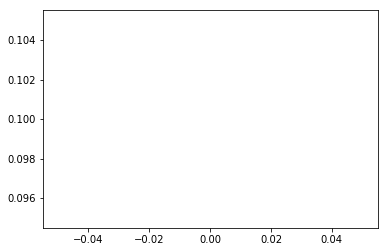

| Reward: 0 | Episode: 1| Epsilon:0.9803848316407074 


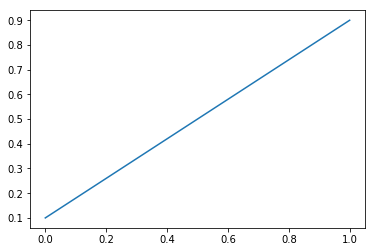

| Reward: 0 | Episode: 2| Epsilon:0.9709016067973192 


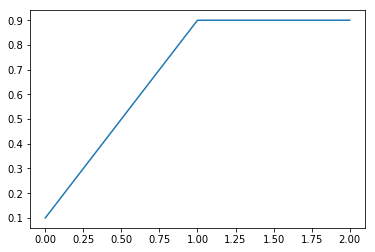

| Reward: 2 | Episode: 3| Epsilon:0.9615678054498122 


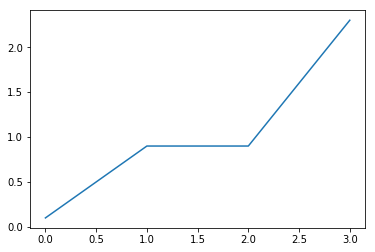

| Reward: 2 | Episode: 4| Epsilon:0.952390400302123 


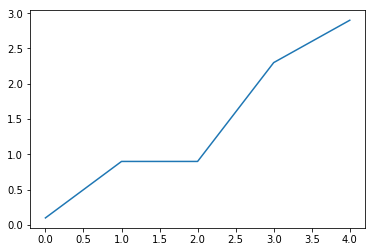

| Reward: 0 | Episode: 5| Epsilon:0.9435364420438017 


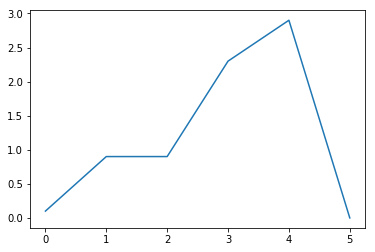

| Reward: 4 | Episode: 6| Epsilon:0.9347367525111785 


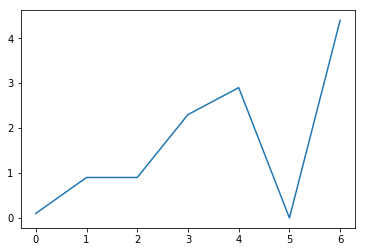

| Reward: 0 | Episode: 7| Epsilon:0.9260283916727852 


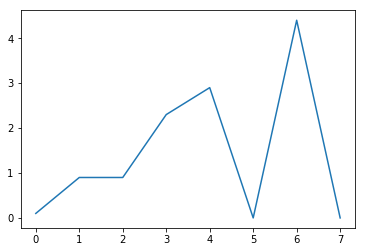

| Reward: 0 | Episode: 8| Epsilon:0.9175571334495259 


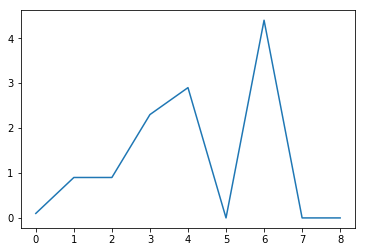

| Reward: 4 | Episode: 9| Epsilon:0.909190645290236 


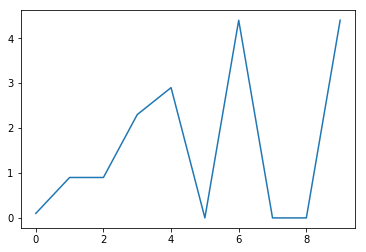

| Reward: 0 | Episode: 10| Epsilon:0.9009905396134507 


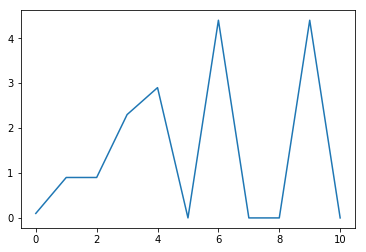

| Reward: 0 | Episode: 11| Epsilon:0.8929536830793134 


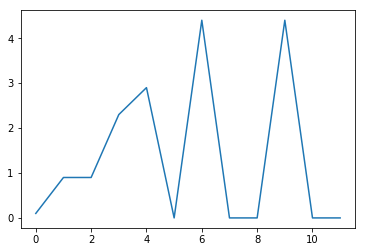

| Reward: 0 | Episode: 12| Epsilon:0.885156680125977 


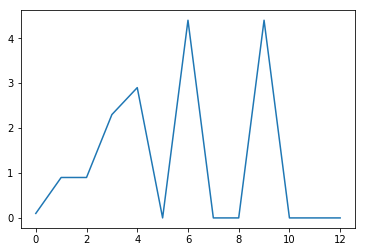

| Reward: 0 | Episode: 13| Epsilon:0.8774716309611148 


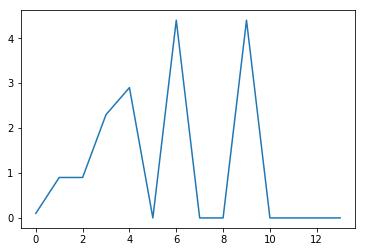

| Reward: 0 | Episode: 14| Epsilon:0.8697663230089223 


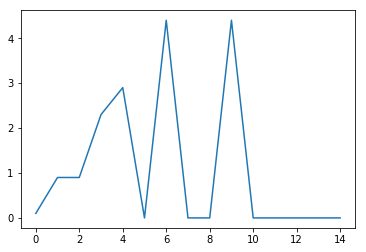

| Reward: 1 | Episode: 15| Epsilon:0.8621459202138793 


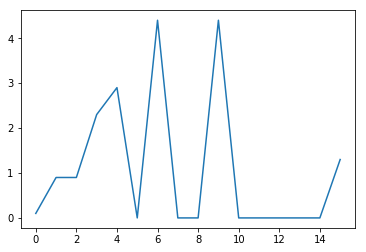

| Reward: 0 | Episode: 16| Epsilon:0.8548145070900083 


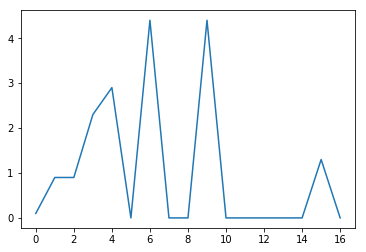

| Reward: 5 | Episode: 17| Epsilon:0.8474776366962278 


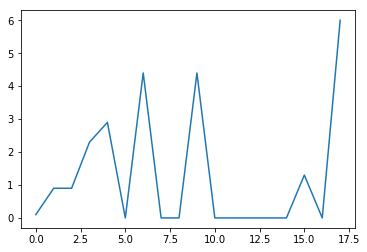

| Reward: 1 | Episode: 18| Epsilon:0.8403970086908442 


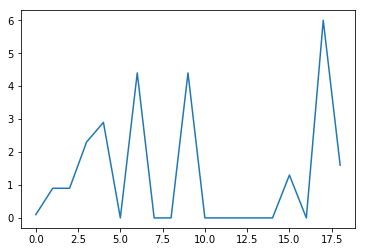

| Reward: 0 | Episode: 19| Epsilon:0.8332588739423019 


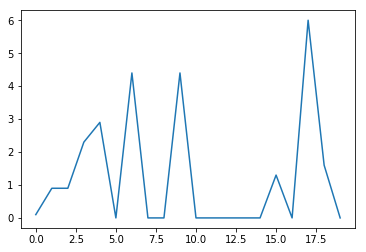

| Reward: 1 | Episode: 20| Epsilon:0.826363149638481 


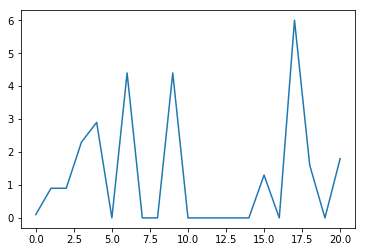

| Reward: 0 | Episode: 21| Epsilon:0.8194507373959903 


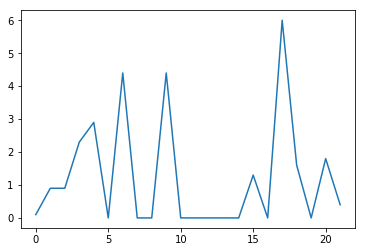

| Reward: 2 | Episode: 22| Epsilon:0.8129781583804083 


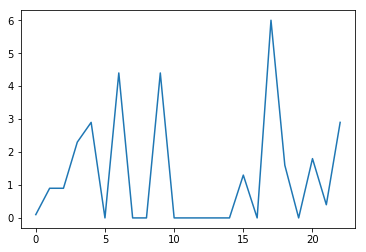

| Reward: 2 | Episode: 23| Epsilon:0.8064921819161579 


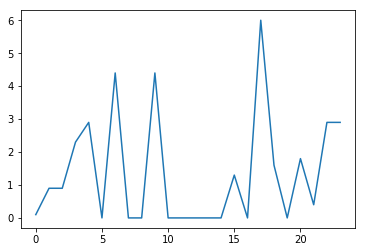

| Reward: 7 | Episode: 24| Epsilon:0.8002259815175046 


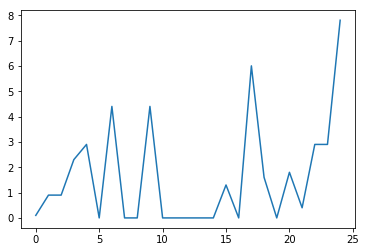

| Reward: 15 | Episode: 25| Epsilon:0.793944949147041 


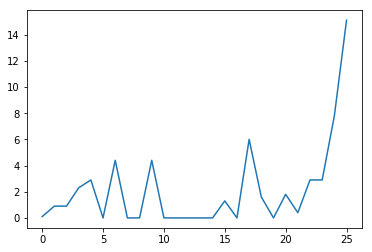

| Reward: 18 | Episode: 26| Epsilon:0.7877526039023863 


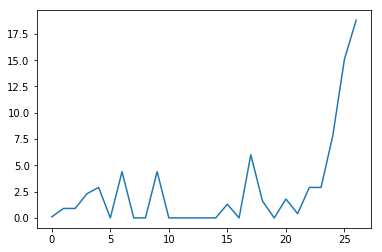

| Reward: 12 | Episode: 27| Epsilon:0.7815929235401171 


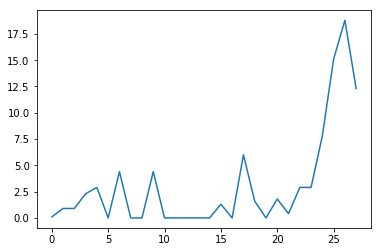

| Reward: 20 | Episode: 28| Epsilon:0.7756753031740742 


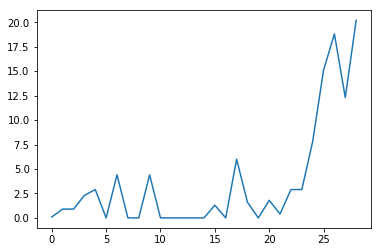

| Reward: 14 | Episode: 29| Epsilon:0.7695869708770308 


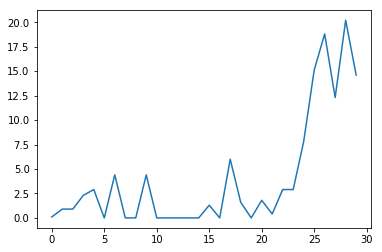

| Reward: 19 | Episode: 30| Epsilon:0.7637373377704263 


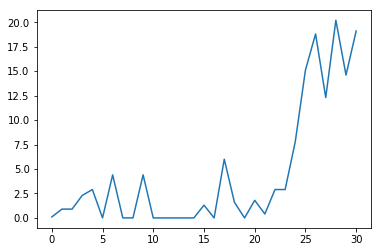

| Reward: 25 | Episode: 31| Epsilon:0.7579624857890358 


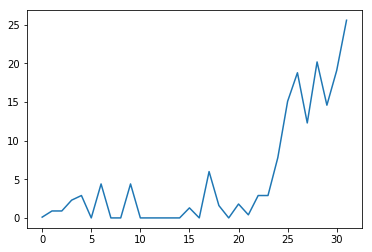

| Reward: 15 | Episode: 32| Epsilon:0.7522237769196076 


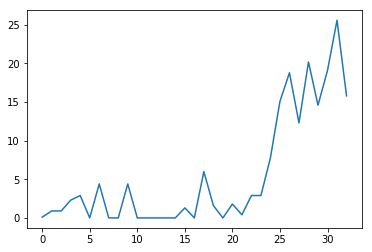

| Reward: 14 | Episode: 33| Epsilon:0.7464986564463866 


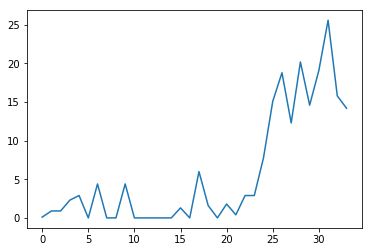

| Reward: 17 | Episode: 34| Epsilon:0.7410171580739688 


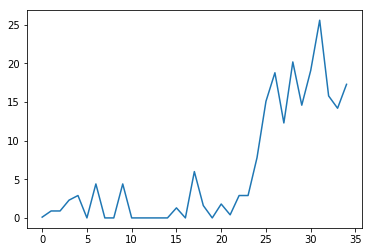

| Reward: 29 | Episode: 35| Epsilon:0.7355391319811814 


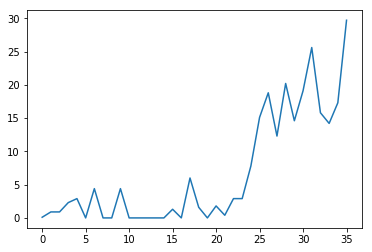

| Reward: 24 | Episode: 36| Epsilon:0.730145410245239 


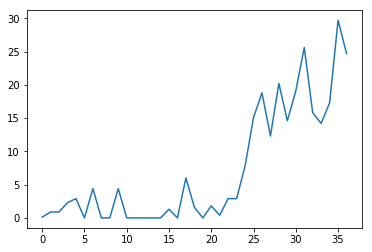

| Reward: 27 | Episode: 37| Epsilon:0.7247477543809013 


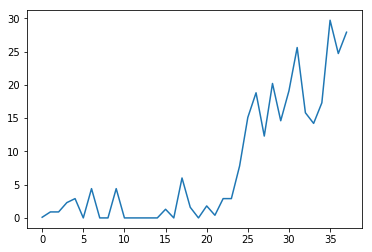

| Reward: 18 | Episode: 38| Epsilon:0.7195051132853936 


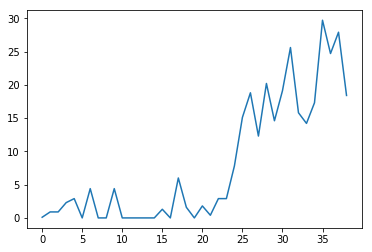

| Reward: 19 | Episode: 39| Epsilon:0.7143646863735287 


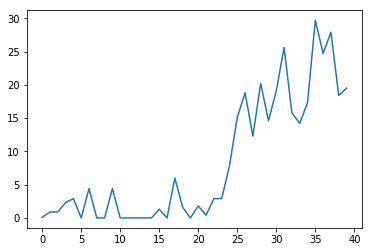

| Reward: 30 | Episode: 40| Epsilon:0.7093035418375414 


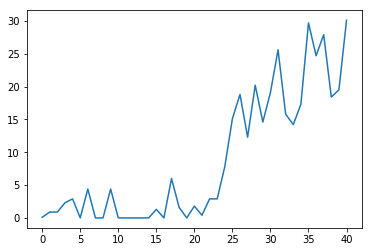

| Reward: 18 | Episode: 41| Epsilon:0.7041726202511734 


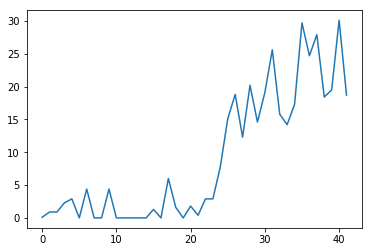

| Reward: 25 | Episode: 42| Epsilon:0.6990927962337992 


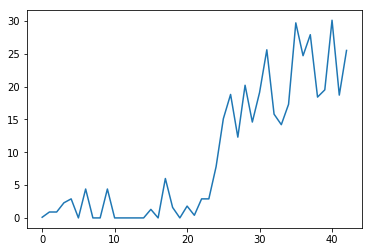

| Reward: 8 | Episode: 43| Epsilon:0.6943272942765433 


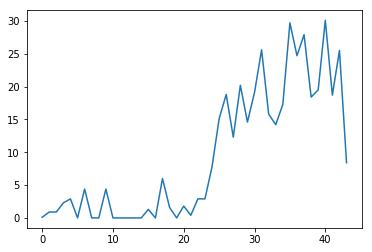

| Reward: 1 | Episode: 44| Epsilon:0.6895873813470738 


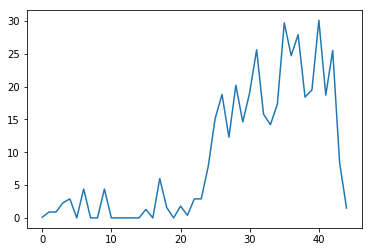

| Reward: 0 | Episode: 45| Epsilon:0.6850099662121797 


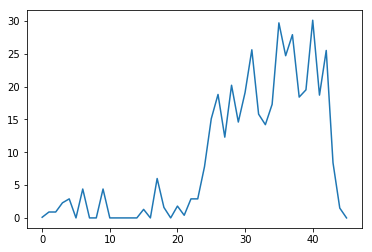

| Reward: 0 | Episode: 46| Epsilon:0.6804697402188999 


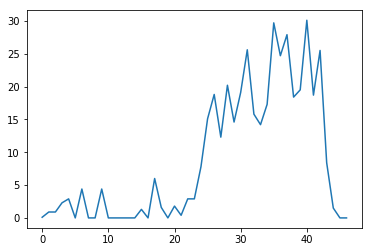

| Reward: 0 | Episode: 47| Epsilon:0.6759393281251129 


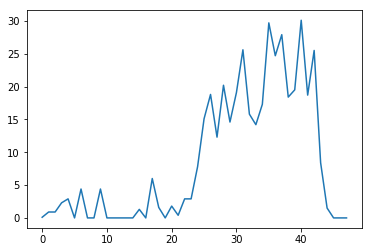

| Reward: 0 | Episode: 48| Epsilon:0.6713719375937338 


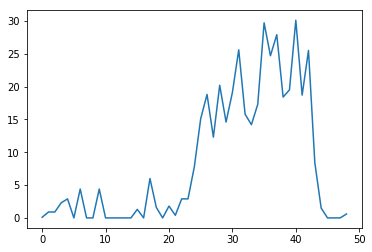

| Reward: 0 | Episode: 49| Epsilon:0.6669020965916551 


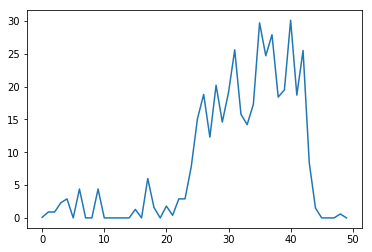

| Reward: 4 | Episode: 50| Epsilon:0.6624686394563387 


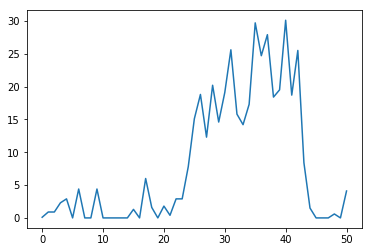

| Reward: 13 | Episode: 51| Epsilon:0.6580712359384315 


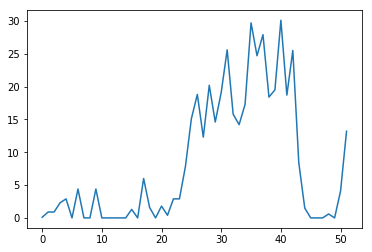

| Reward: 3 | Episode: 52| Epsilon:0.6539710964957275 


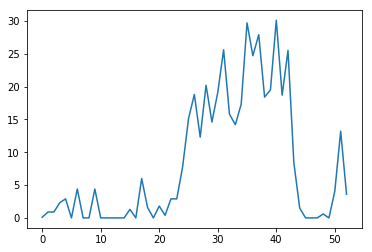

| Reward: 3 | Episode: 53| Epsilon:0.649675574781839 


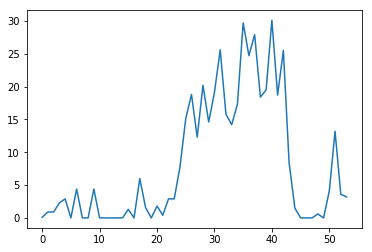

| Reward: 4 | Episode: 54| Epsilon:0.6454728120046829 


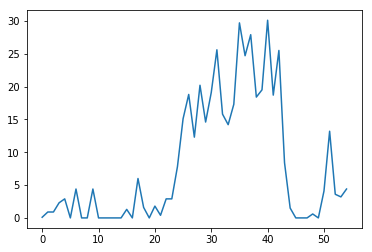

| Reward: 2 | Episode: 55| Epsilon:0.6413228895050112 


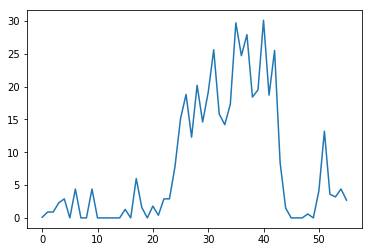

| Reward: 9 | Episode: 56| Epsilon:0.6371614169770634 


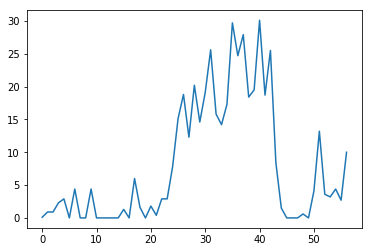

| Reward: 12 | Episode: 57| Epsilon:0.6332232175344856 


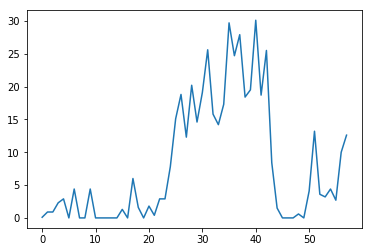

| Reward: 12 | Episode: 58| Epsilon:0.6292653091801395 


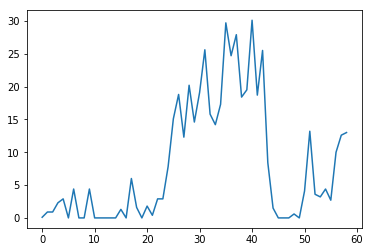

| Reward: 12 | Episode: 59| Epsilon:0.6253321393983973 


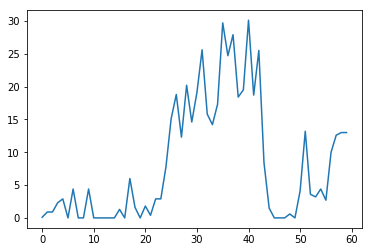

| Reward: 22 | Episode: 60| Epsilon:0.6214732696843794 


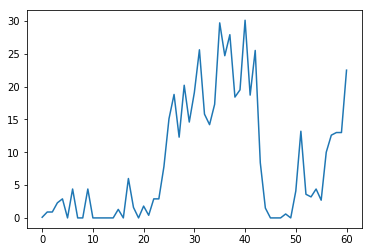

| Reward: 16 | Episode: 61| Epsilon:0.6175702759099818 


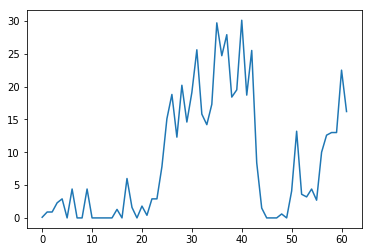

| Reward: 24 | Episode: 62| Epsilon:0.613875929903883 


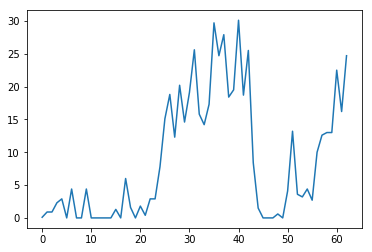

| Reward: 16 | Episode: 63| Epsilon:0.6100206491548263 


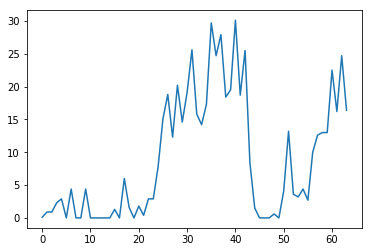

| Reward: 6 | Episode: 64| Epsilon:0.6063229574930566 


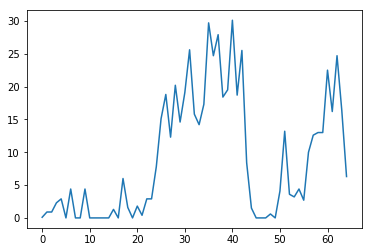

| Reward: 1 | Episode: 65| Epsilon:0.6028224737464445 


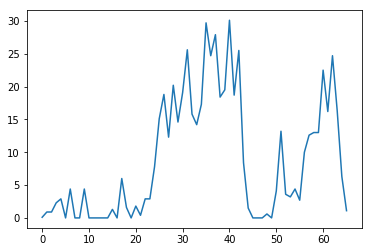

| Reward: 14 | Episode: 66| Epsilon:0.599294253641453 


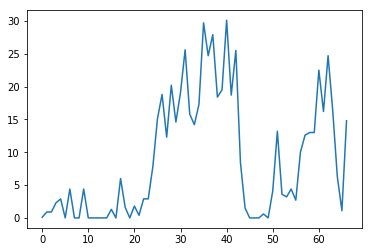

| Reward: 30 | Episode: 67| Epsilon:0.5956794511364233 


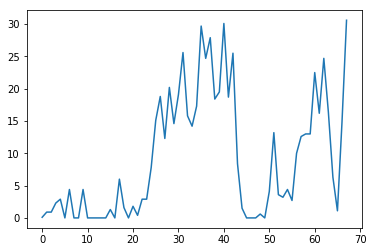

| Reward: 12 | Episode: 68| Epsilon:0.5920982941797198 


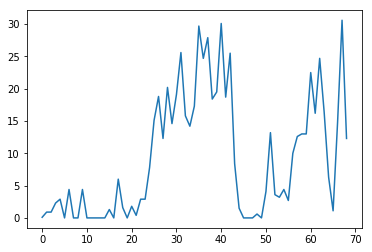

| Reward: 0 | Episode: 69| Epsilon:0.5885916378589366 


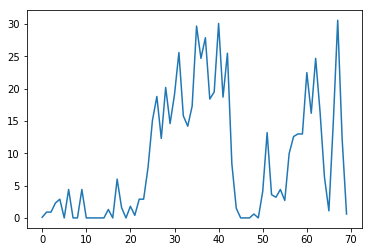

| Reward: 0 | Episode: 70| Epsilon:0.5850998983813152 


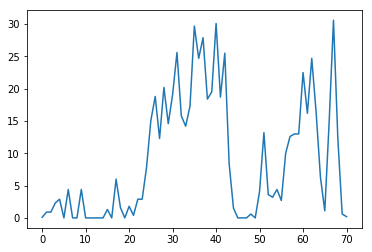

| Reward: 1 | Episode: 71| Epsilon:0.5816637721249424 


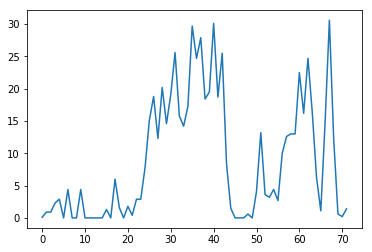

| Reward: 3 | Episode: 72| Epsilon:0.5783287860339147 


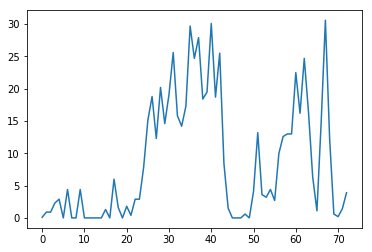

| Reward: 9 | Episode: 73| Epsilon:0.574903678559411 


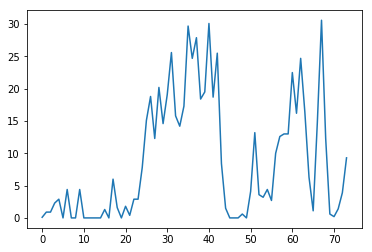

| Reward: 9 | Episode: 74| Epsilon:0.5716817658313186 


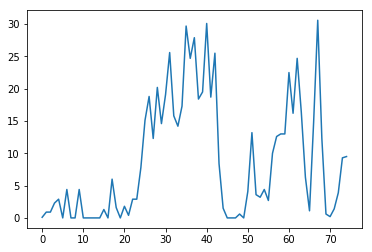

| Reward: 3 | Episode: 75| Epsilon:0.5683812760431669 


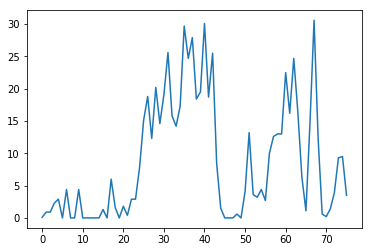

| Reward: 13 | Episode: 76| Epsilon:0.5651902646299042 


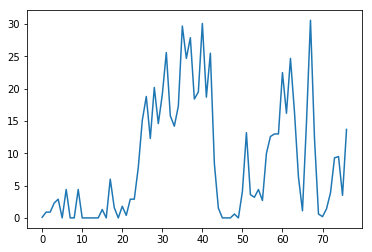

| Reward: 15 | Episode: 77| Epsilon:0.5619553494249091 


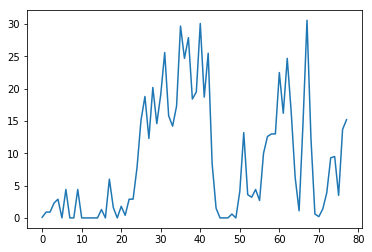

| Reward: 15 | Episode: 78| Epsilon:0.5587724750463301 


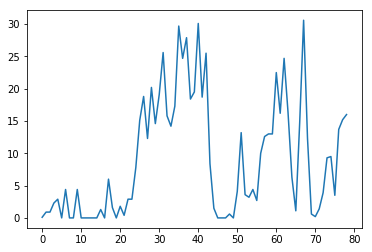

| Reward: 20 | Episode: 79| Epsilon:0.5556354094524336 


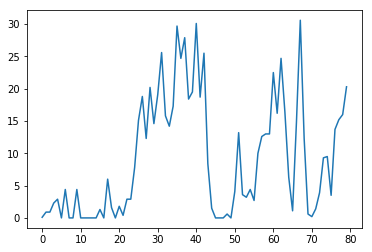

| Reward: 7 | Episode: 80| Epsilon:0.5524386087950441 


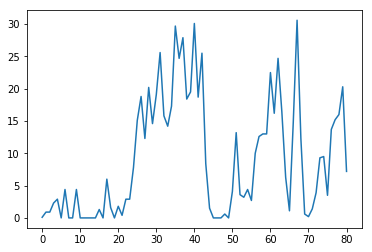

| Reward: 0 | Episode: 81| Epsilon:0.5494250042594864 


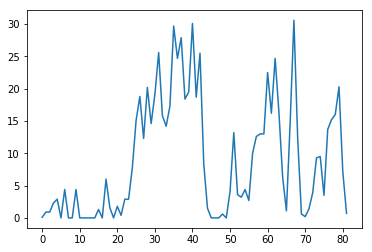

| Reward: 9 | Episode: 82| Epsilon:0.5464005183743859 


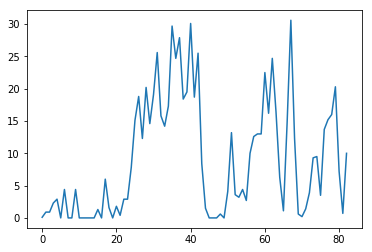

| Reward: 10 | Episode: 83| Epsilon:0.5433818139411124 


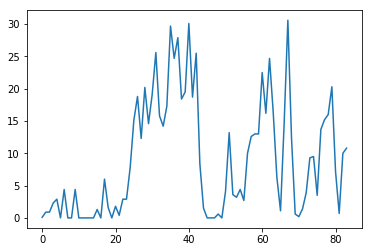

| Reward: 9 | Episode: 84| Epsilon:0.5403743831766786 


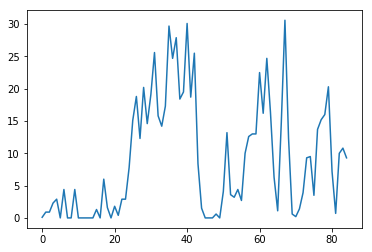

| Reward: 9 | Episode: 85| Epsilon:0.5374695861878144 


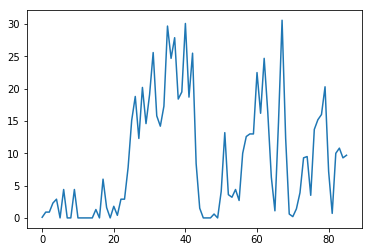

| Reward: 1 | Episode: 86| Epsilon:0.5345429845073874 


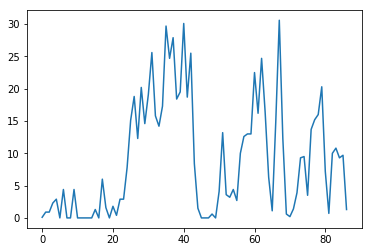

| Reward: 5 | Episode: 87| Epsilon:0.5316908016715148 


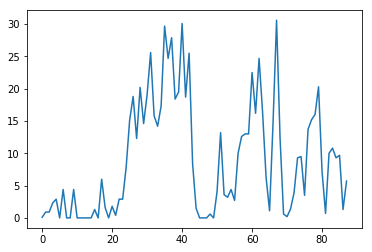

| Reward: 11 | Episode: 88| Epsilon:0.5288961475550223 


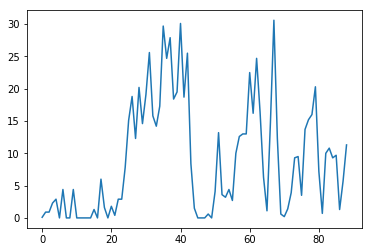

| Reward: 6 | Episode: 89| Epsilon:0.5260635733484329 


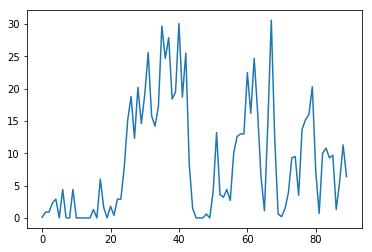

| Reward: 2 | Episode: 90| Epsilon:0.5232200075874319 


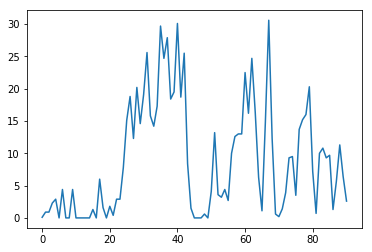

| Reward: 3 | Episode: 91| Epsilon:0.5204126285308903 


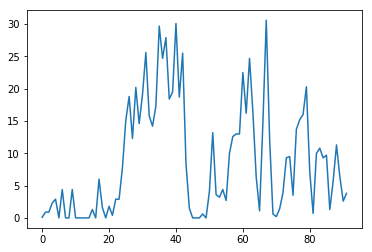

| Reward: 7 | Episode: 92| Epsilon:0.5177859785261112 


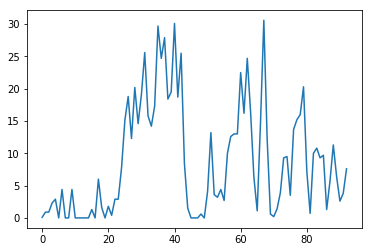

| Reward: 9 | Episode: 93| Epsilon:0.5152034973043129 


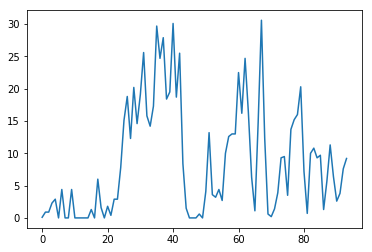

| Reward: 1 | Episode: 94| Epsilon:0.5125621322448799 


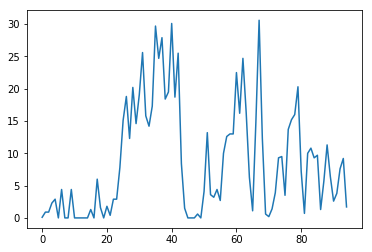

| Reward: 0 | Episode: 95| Epsilon:0.5099496073724259 


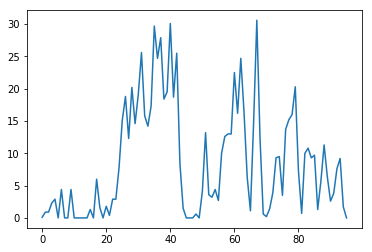

| Reward: 0 | Episode: 96| Epsilon:0.5073047388078004 


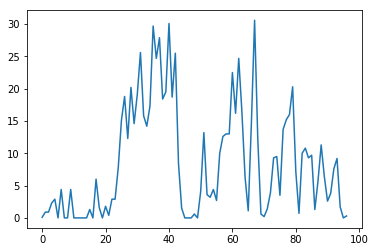

| Reward: 0 | Episode: 97| Epsilon:0.5047694855025766 


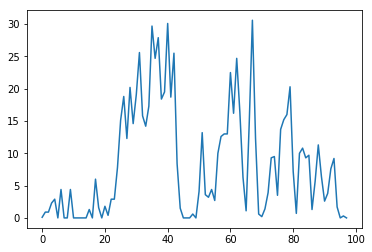

| Reward: 0 | Episode: 98| Epsilon:0.5021816139352246 


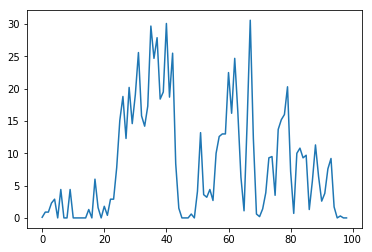

| Reward: 4 | Episode: 99| Epsilon:0.49978690176875495 


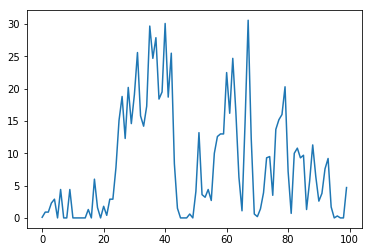

| Reward: 8 | Episode: 100| Epsilon:0.49732403046038304 


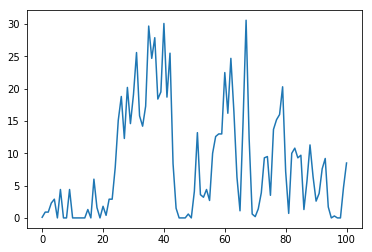

| Reward: 9 | Episode: 101| Epsilon:0.4948535011598593 


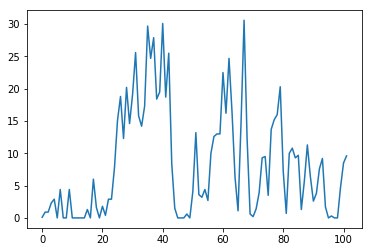

| Reward: 4 | Episode: 102| Epsilon:0.49241001672497603 


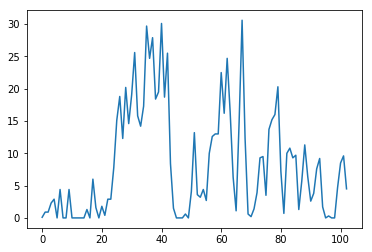

| Reward: 3 | Episode: 103| Epsilon:0.489939400795913 


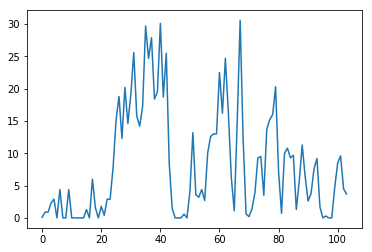

| Reward: 7 | Episode: 104| Epsilon:0.48748605578529014 


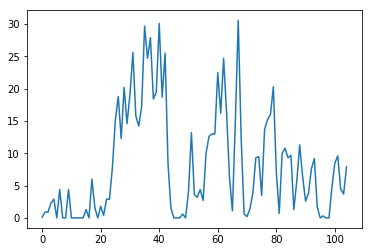

| Reward: 7 | Episode: 105| Epsilon:0.4851129071595668 


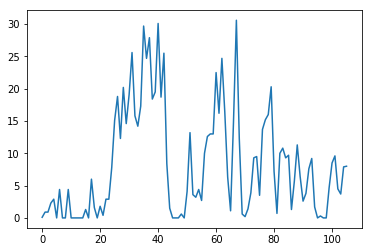

| Reward: 3 | Episode: 106| Epsilon:0.4826644234947739 


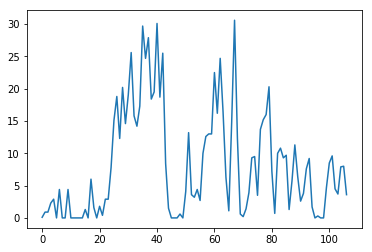

| Reward: 1 | Episode: 107| Epsilon:0.48039640808915035 


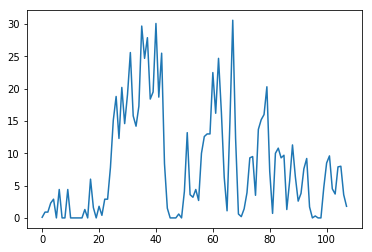

| Reward: 3 | Episode: 108| Epsilon:0.47814861289620164 


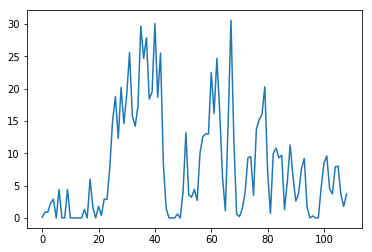

| Reward: 11 | Episode: 109| Epsilon:0.47591609439335447 


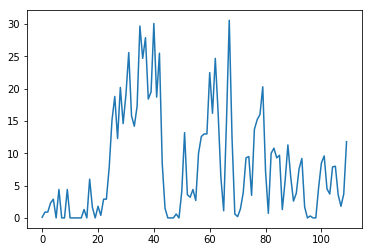

| Reward: 4 | Episode: 110| Epsilon:0.47368926277844026 


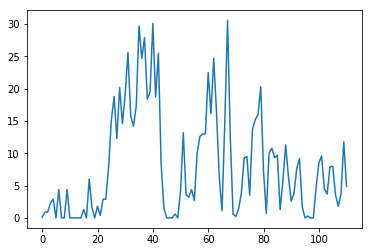

| Reward: 4 | Episode: 111| Epsilon:0.4713408560251731 


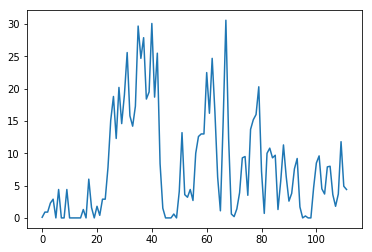

| Reward: 7 | Episode: 112| Epsilon:0.4690932116448213 


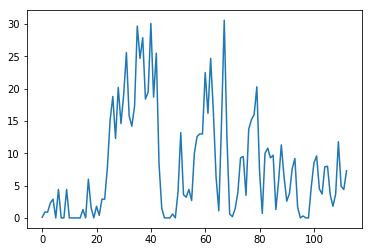

| Reward: 3 | Episode: 113| Epsilon:0.46688429777894525 


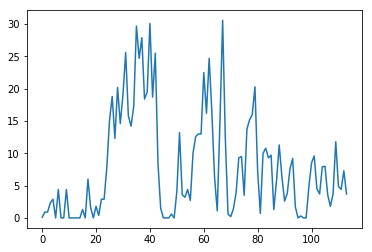

| Reward: 6 | Episode: 114| Epsilon:0.46468113861368004 


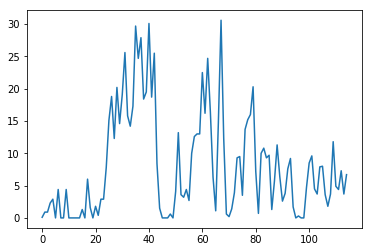

| Reward: 4 | Episode: 115| Epsilon:0.4625577546429579 


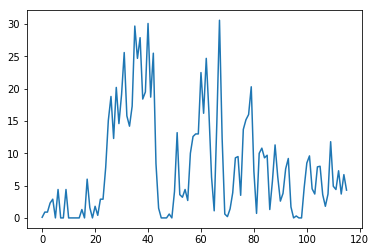

| Reward: 0 | Episode: 116| Epsilon:0.46051775089689706 


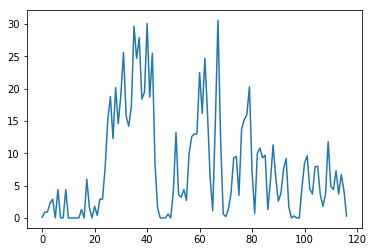

| Reward: 0 | Episode: 117| Epsilon:0.4583033851742347 


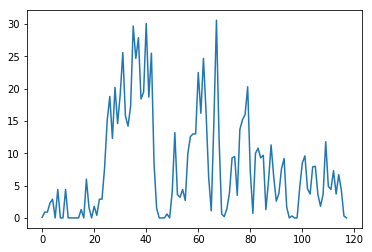

| Reward: 6 | Episode: 118| Epsilon:0.45622739349250363 


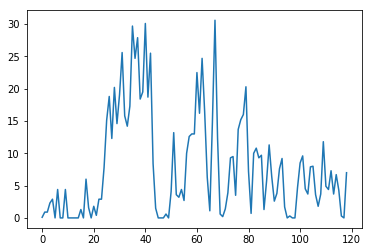

| Reward: 2 | Episode: 119| Epsilon:0.4540336576377574 


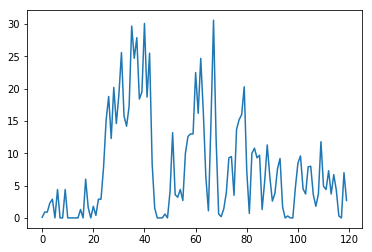

| Reward: 1 | Episode: 120| Epsilon:0.452090015621329 


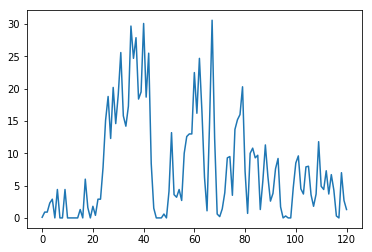

| Reward: 11 | Episode: 121| Epsilon:0.4500601709776291 


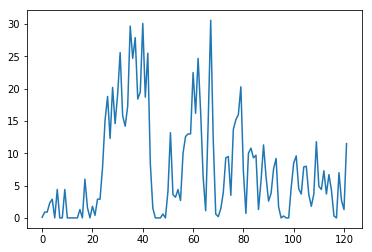

| Reward: 30 | Episode: 122| Epsilon:0.44820076420057253 


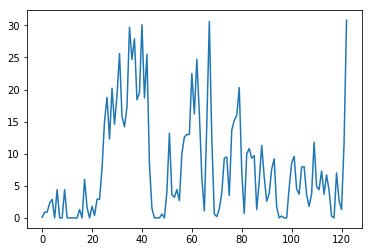

| Reward: 34 | Episode: 123| Epsilon:0.4462865546892124 


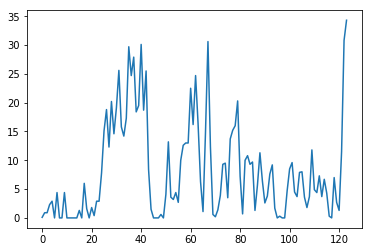

| Reward: 23 | Episode: 124| Epsilon:0.4442472257002992 


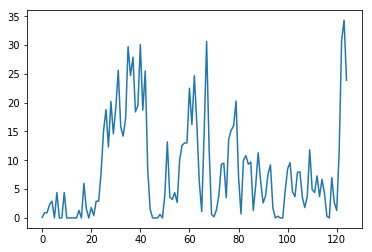

| Reward: 19 | Episode: 125| Epsilon:0.44218183938930966 


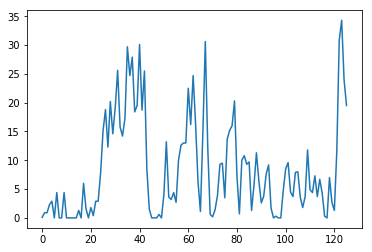

| Reward: 4 | Episode: 126| Epsilon:0.4403417711274433 


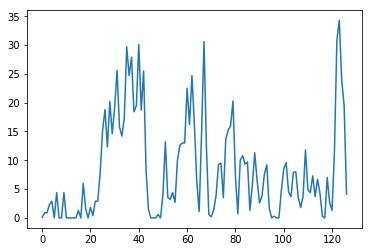

| Reward: 8 | Episode: 127| Epsilon:0.43836467507436666 


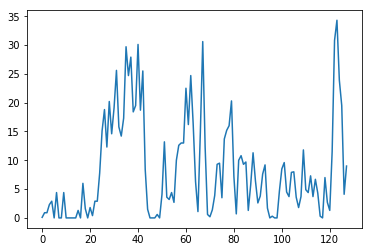

| Reward: 3 | Episode: 128| Epsilon:0.43657978193361324 


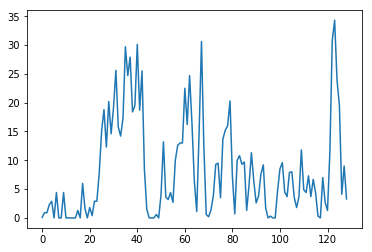

| Reward: 5 | Episode: 129| Epsilon:0.43472824590373227 


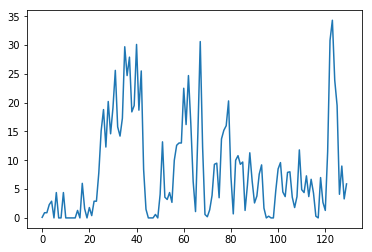

| Reward: 0 | Episode: 130| Epsilon:0.43281530590754924 


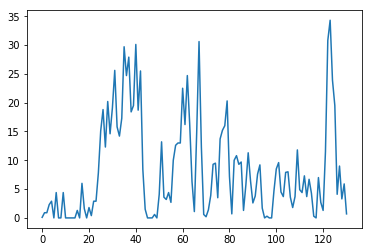

| Reward: 4 | Episode: 131| Epsilon:0.4308978562503045 


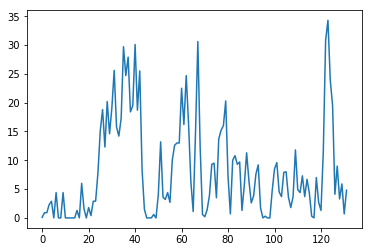

| Reward: 15 | Episode: 132| Epsilon:0.4290661265783622 


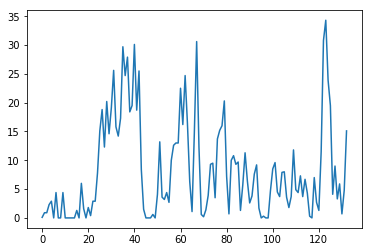

| Reward: 0 | Episode: 133| Epsilon:0.427220821834562 


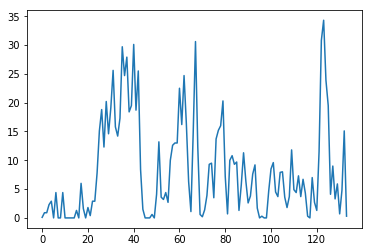

| Reward: 0 | Episode: 134| Epsilon:0.4253664381962153 


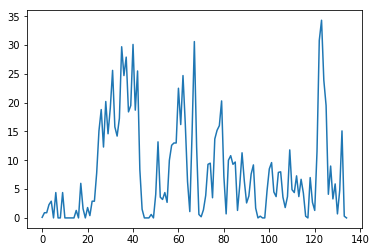

| Reward: 0 | Episode: 135| Epsilon:0.4234354076731479 


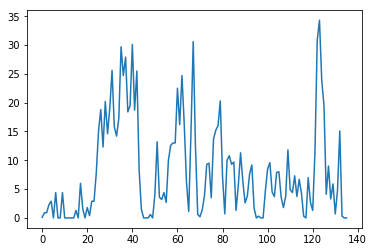

| Reward: 0 | Episode: 136| Epsilon:0.4217450405786361 


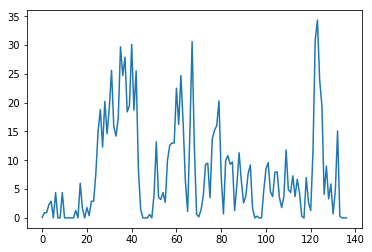

| Reward: 1 | Episode: 137| Epsilon:0.41992702265934084 


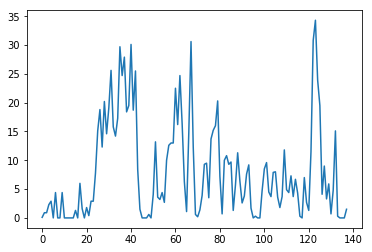

| Reward: 8 | Episode: 138| Epsilon:0.41813356676846214 


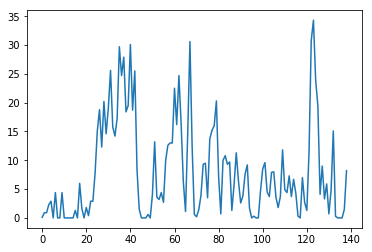

| Reward: 2 | Episode: 139| Epsilon:0.41640189950292106 


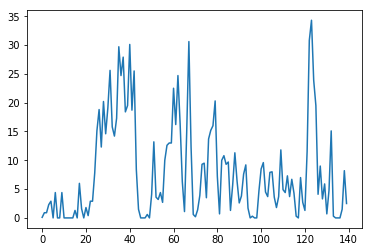

| Reward: 4 | Episode: 140| Epsilon:0.41474375782566125 


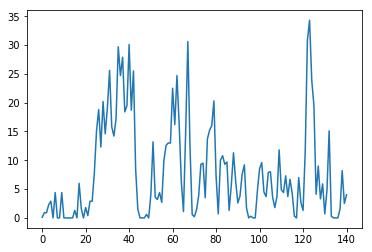

| Reward: 7 | Episode: 141| Epsilon:0.4130591727644054 


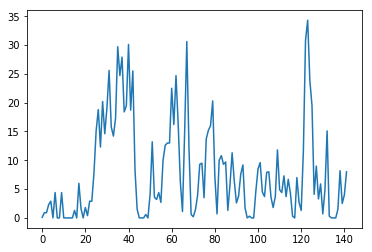

| Reward: 7 | Episode: 142| Epsilon:0.4114225704706032 


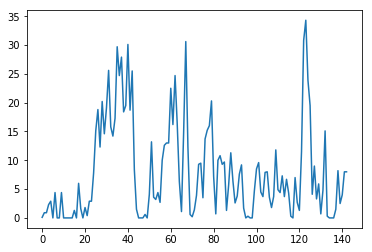

| Reward: 3 | Episode: 143| Epsilon:0.40964085672167055 


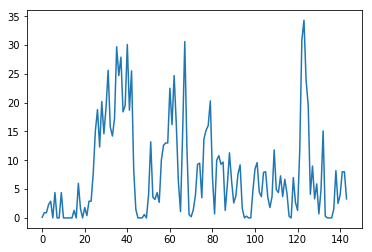

| Reward: 1 | Episode: 144| Epsilon:0.40794844083093945 


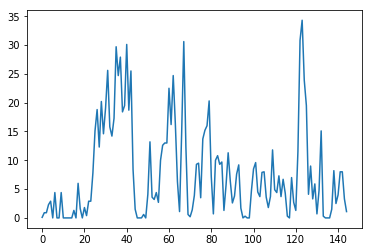

| Reward: 13 | Episode: 145| Epsilon:0.40630770870654515 


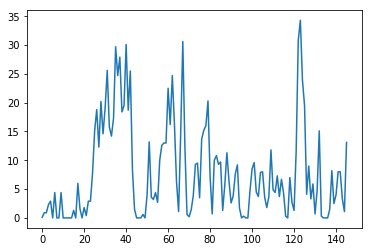

| Reward: 8 | Episode: 146| Epsilon:0.40457646496999905 


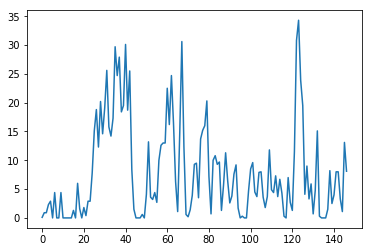

| Reward: 0 | Episode: 147| Epsilon:0.40287274115484534 


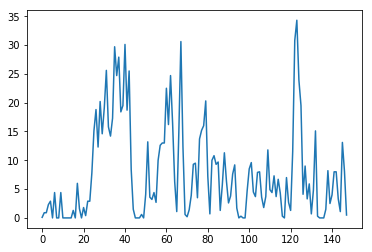

| Reward: 9 | Episode: 148| Epsilon:0.40123637318418637 


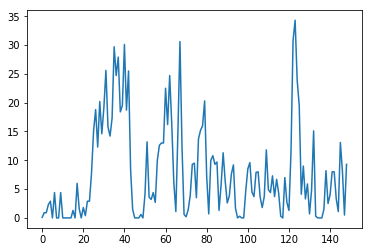

| Reward: 28 | Episode: 149| Epsilon:0.39960665172956544 


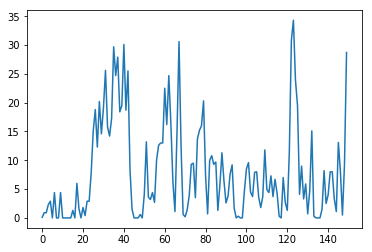

| Reward: 17 | Episode: 150| Epsilon:0.3979437532304009 


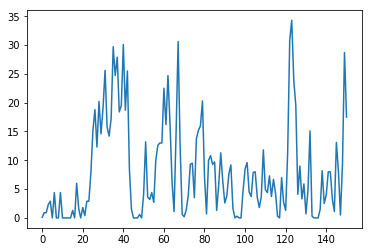

| Reward: 3 | Episode: 151| Epsilon:0.3963828955701644 


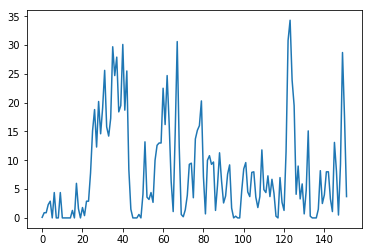

| Reward: 1 | Episode: 152| Epsilon:0.3949505763884656 


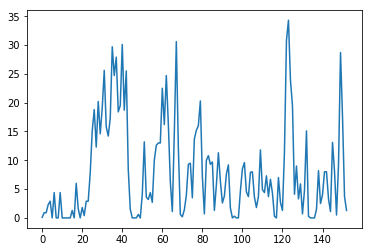

| Reward: 3 | Episode: 153| Epsilon:0.3934211295504556 


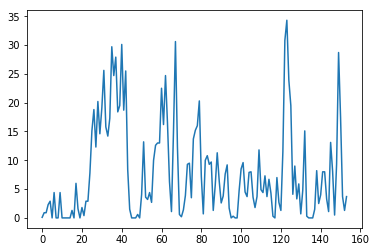

| Reward: 1 | Episode: 154| Epsilon:0.3918427433995122 


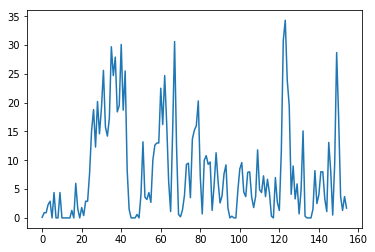

| Reward: 2 | Episode: 155| Epsilon:0.3902433715271699 


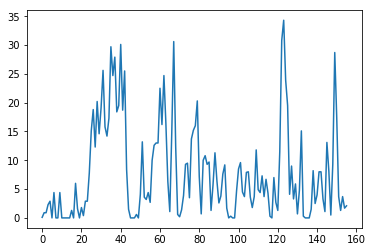

| Reward: 7 | Episode: 156| Epsilon:0.38876325332044703 


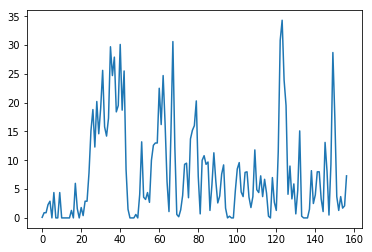

| Reward: 8 | Episode: 157| Epsilon:0.387323606648261 


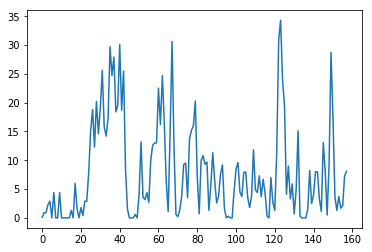

| Reward: 7 | Episode: 158| Epsilon:0.38588157344912144 


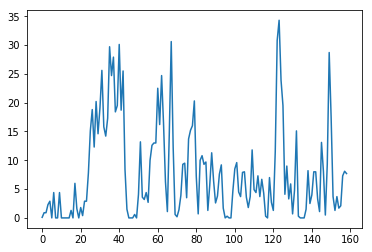

| Reward: 3 | Episode: 159| Epsilon:0.3844795108135162 


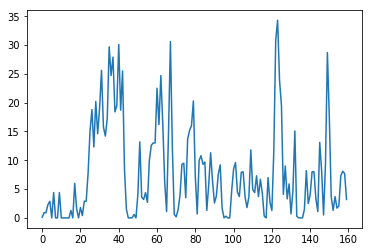

| Reward: 0 | Episode: 160| Epsilon:0.3829523158584163 


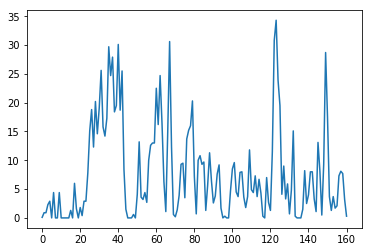

| Reward: 0 | Episode: 161| Epsilon:0.3813777901945424 


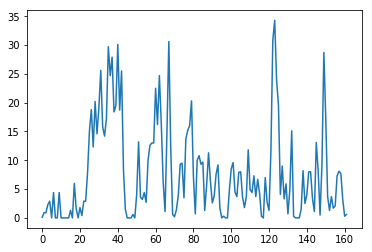

| Reward: 1 | Episode: 162| Epsilon:0.3799654929627186 


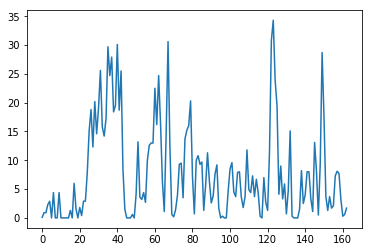

| Reward: 3 | Episode: 163| Epsilon:0.3785092160295446 


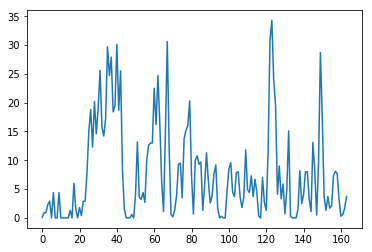

| Reward: 1 | Episode: 164| Epsilon:0.3771301687880479 


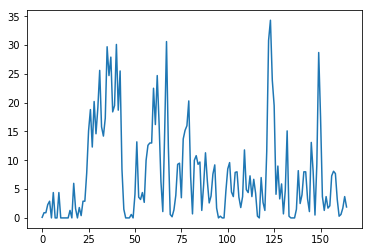

| Reward: 2 | Episode: 165| Epsilon:0.3757185719953127 


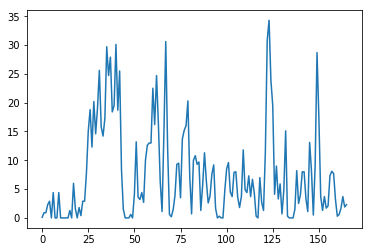

| Reward: 9 | Episode: 166| Epsilon:0.37430477259627887 


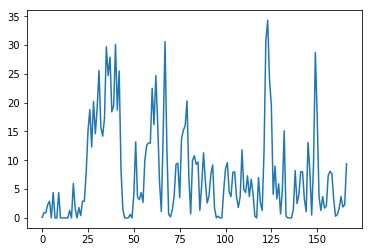

| Reward: 9 | Episode: 167| Epsilon:0.3728515481188974 


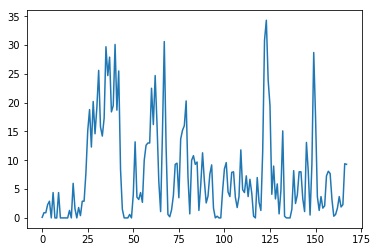

| Reward: 5 | Episode: 168| Epsilon:0.3714968287951098 


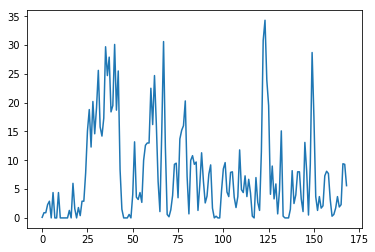

| Reward: 2 | Episode: 169| Epsilon:0.3700693086062988 


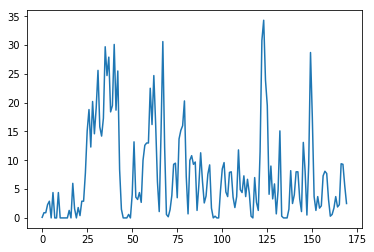

| Reward: 11 | Episode: 170| Epsilon:0.368750510036693 


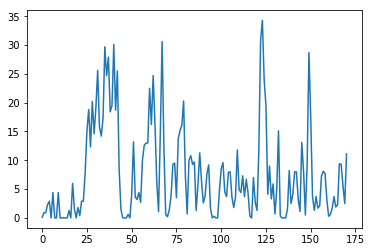

| Reward: 34 | Episode: 171| Epsilon:0.36738864733989346 


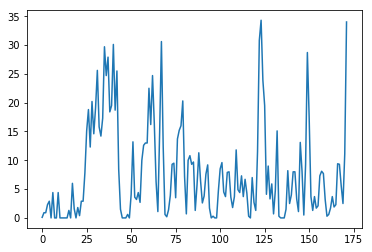

| Reward: 1 | Episode: 172| Epsilon:0.36612333410037656 


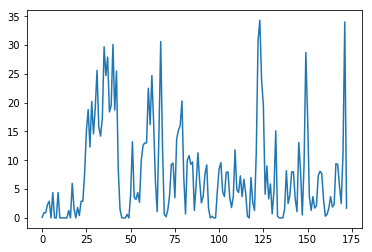

| Reward: 4 | Episode: 173| Epsilon:0.3647857652538441 


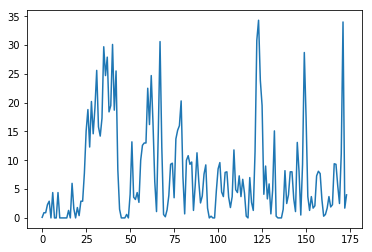

| Reward: 28 | Episode: 174| Epsilon:0.3635330518601849 


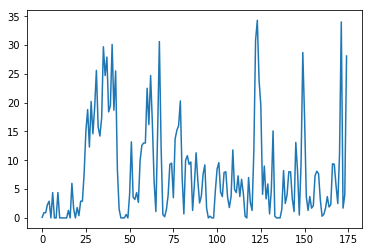

| Reward: 21 | Episode: 175| Epsilon:0.3622411686526587 


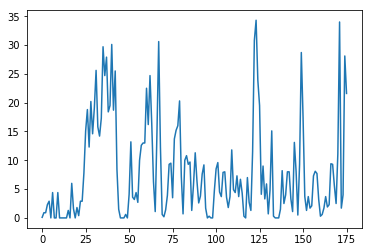

| Reward: 41 | Episode: 176| Epsilon:0.36091056431261437 


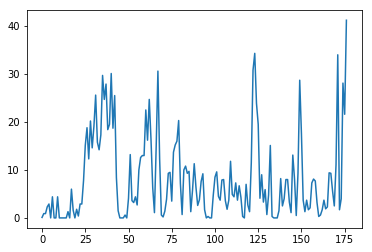

| Reward: 23 | Episode: 177| Epsilon:0.35961721187666507 


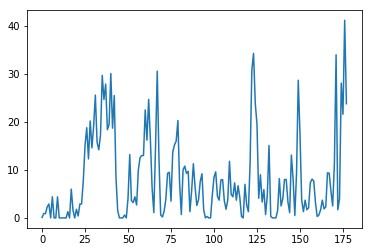

| Reward: 22 | Episode: 178| Epsilon:0.35833207759540664 


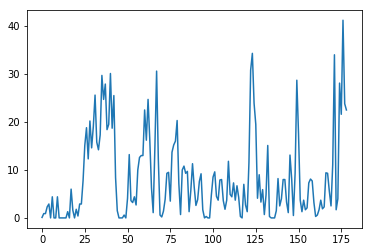

| Reward: 5 | Episode: 179| Epsilon:0.3570872430096692 


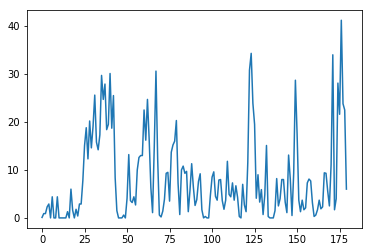

| Reward: 11 | Episode: 180| Epsilon:0.3557044220002429 


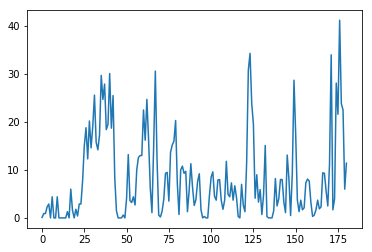

| Reward: 4 | Episode: 181| Epsilon:0.35445453727304754 


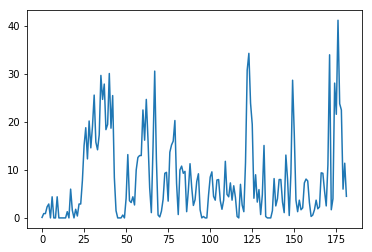

| Reward: 11 | Episode: 182| Epsilon:0.3531384093294884 


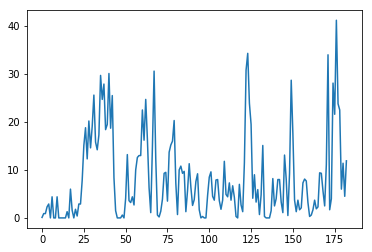

| Reward: 40 | Episode: 183| Epsilon:0.35189754113357147 


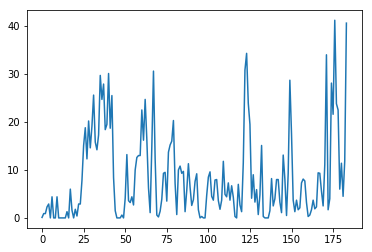

| Reward: 53 | Episode: 184| Epsilon:0.3507066222625347 


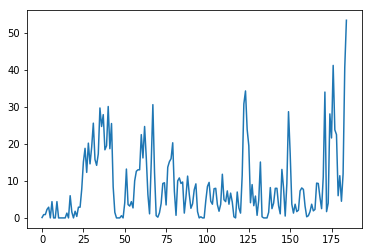

| Reward: 17 | Episode: 185| Epsilon:0.34955468768705006 


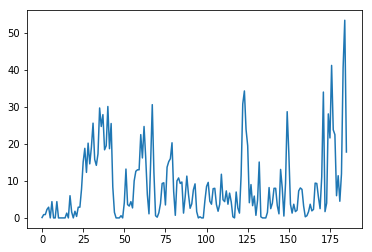

| Reward: 26 | Episode: 186| Epsilon:0.3483647302827048 


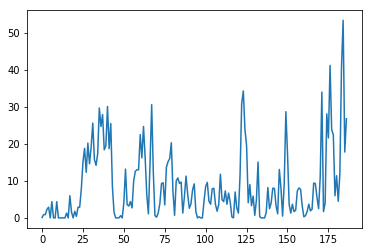

| Reward: 22 | Episode: 187| Epsilon:0.34712675056437187 


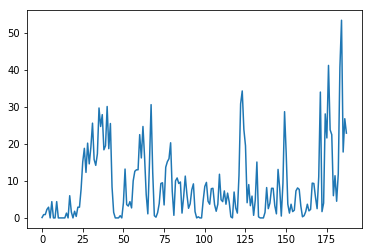

| Reward: 39 | Episode: 188| Epsilon:0.3459450583667541 


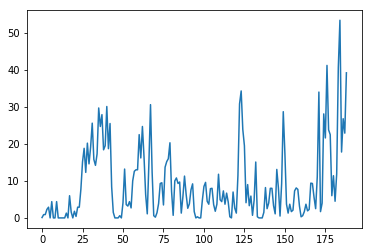

| Reward: 17 | Episode: 189| Epsilon:0.34473291370951653 


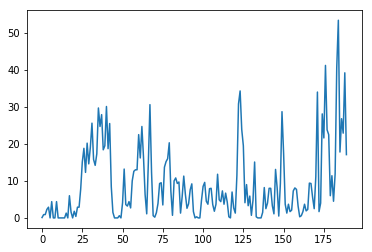

| Reward: 22 | Episode: 190| Epsilon:0.3435799849179005 


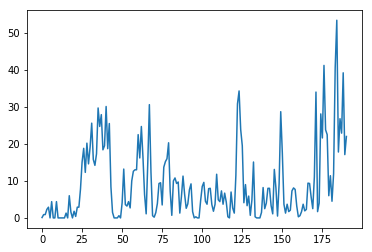

| Reward: 11 | Episode: 191| Epsilon:0.3424548831175052 


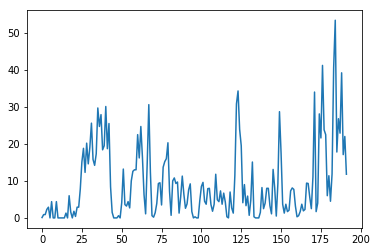

| Reward: 8 | Episode: 192| Epsilon:0.34129250786072224 


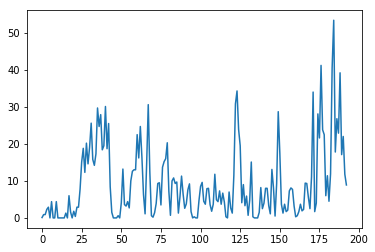

| Reward: 2 | Episode: 193| Epsilon:0.3401408807721854 


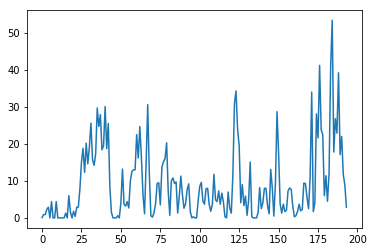

| Reward: 0 | Episode: 194| Epsilon:0.3389863598027929 


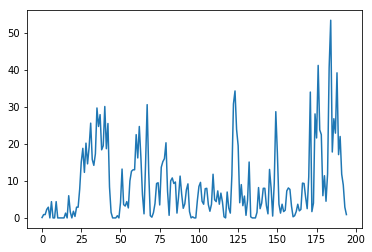

| Reward: 3 | Episode: 195| Epsilon:0.3378188661086362 


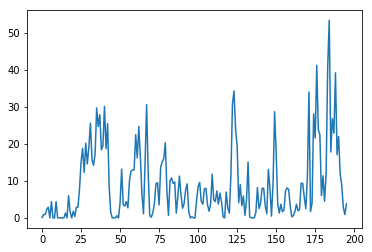

| Reward: 5 | Episode: 196| Epsilon:0.33669579462096677 


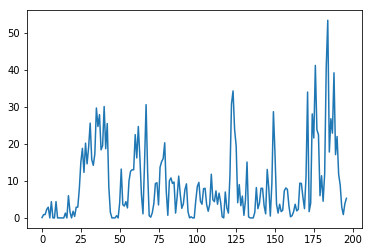

| Reward: 13 | Episode: 197| Epsilon:0.33561337238522554 


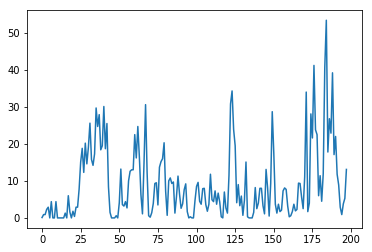

| Reward: 25 | Episode: 198| Epsilon:0.33440398631923873 


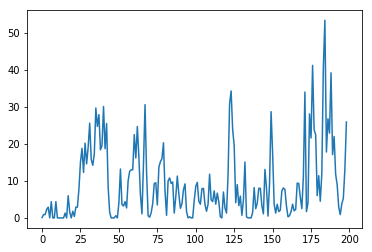

| Reward: 23 | Episode: 199| Epsilon:0.3332622724210528 


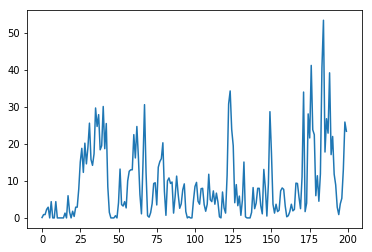

| Reward: 2 | Episode: 200| Epsilon:0.3321643140599656 


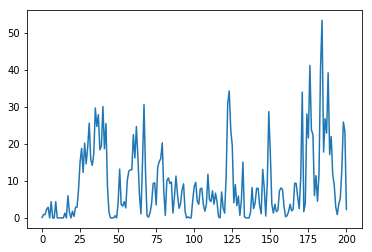

| Reward: 7 | Episode: 201| Epsilon:0.3310467988048388 


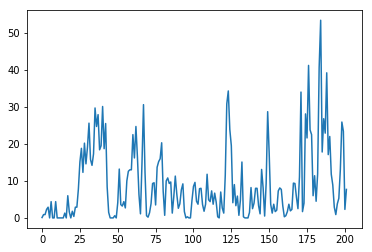

| Reward: 15 | Episode: 202| Epsilon:0.32993964201610304 


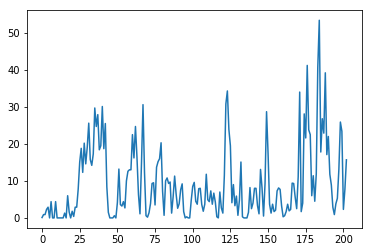

| Reward: 5 | Episode: 203| Epsilon:0.32892827550021886 


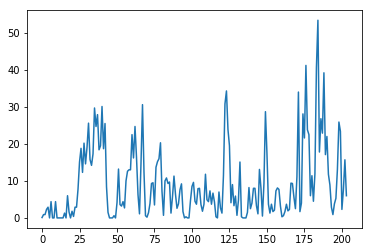

| Reward: 6 | Episode: 204| Epsilon:0.3278413173816119 


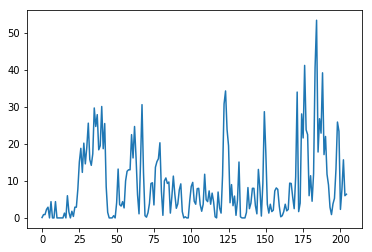

| Reward: 16 | Episode: 205| Epsilon:0.3267481485239523 


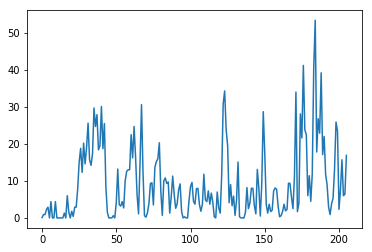

| Reward: 13 | Episode: 206| Epsilon:0.3257856570462854 


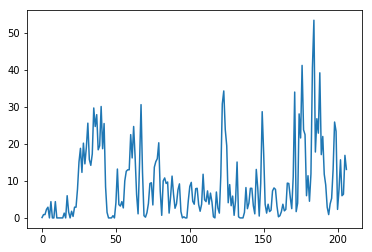

| Reward: 13 | Episode: 207| Epsilon:0.324666874201894 


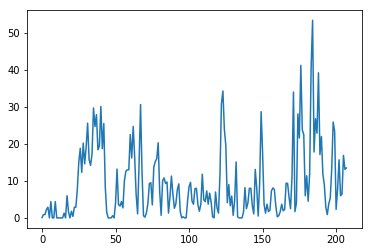

| Reward: 14 | Episode: 208| Epsilon:0.32370080224854786 


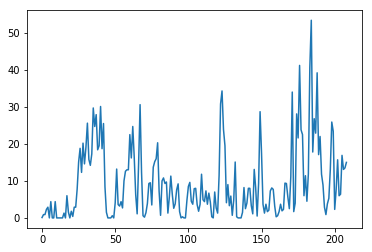

| Reward: 13 | Episode: 209| Epsilon:0.32266661010034015 


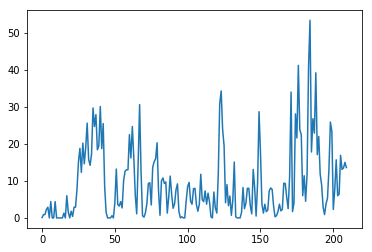

| Reward: 22 | Episode: 210| Epsilon:0.321561754014813 


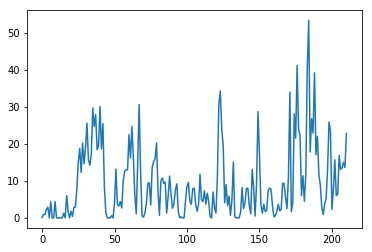

| Reward: 15 | Episode: 211| Epsilon:0.3205151643318544 


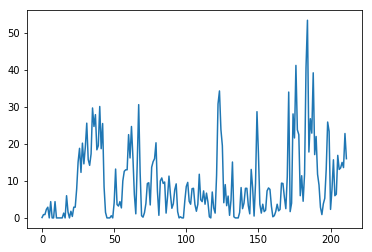

| Reward: 24 | Episode: 212| Epsilon:0.3194400352324232 


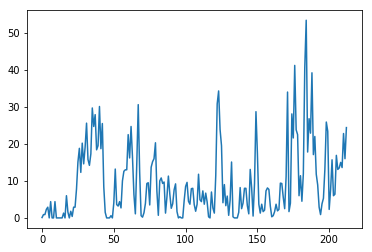

| Reward: 19 | Episode: 213| Epsilon:0.318483146393207 


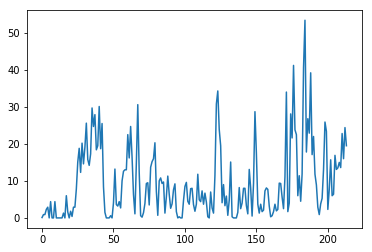

| Reward: 8 | Episode: 214| Epsilon:0.3175068975612465 


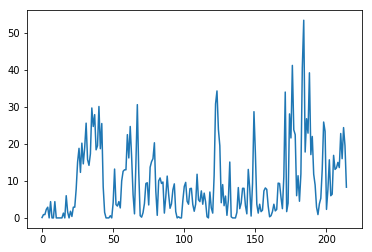

| Reward: 0 | Episode: 215| Epsilon:0.31651464968864035 


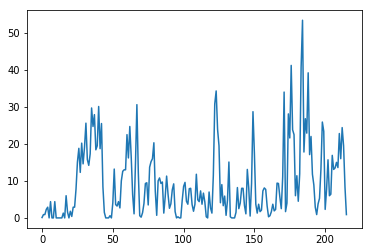

| Reward: 4 | Episode: 216| Epsilon:0.3154624036060296 


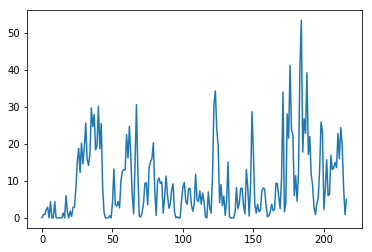

| Reward: 12 | Episode: 217| Epsilon:0.31440422337733376 


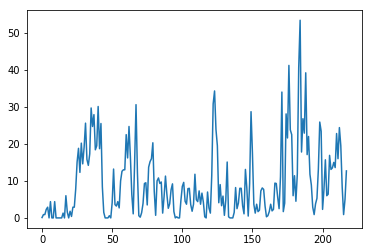

| Reward: 11 | Episode: 218| Epsilon:0.313506307440733 


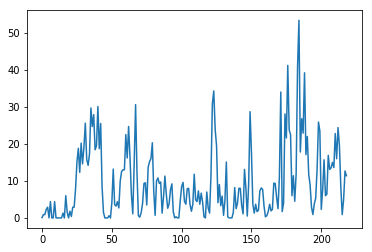

| Reward: 19 | Episode: 219| Epsilon:0.3125046856983189 


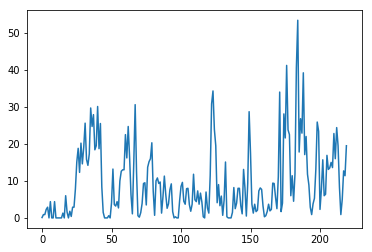

| Reward: 6 | Episode: 220| Epsilon:0.3115779190776364 


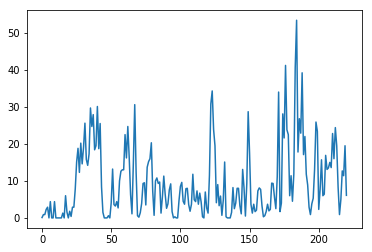

| Reward: 10 | Episode: 221| Epsilon:0.3106010939456565 


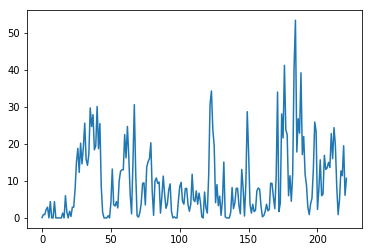

| Reward: 7 | Episode: 222| Epsilon:0.3096830694639679 


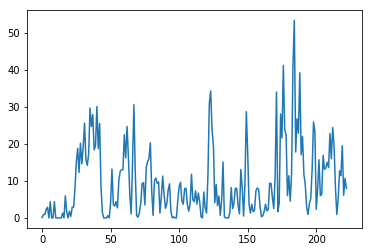

| Reward: 20 | Episode: 223| Epsilon:0.3086936625899412 


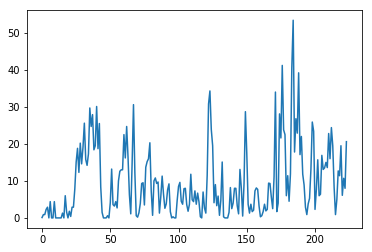

| Reward: 17 | Episode: 224| Epsilon:0.30779666531084704 


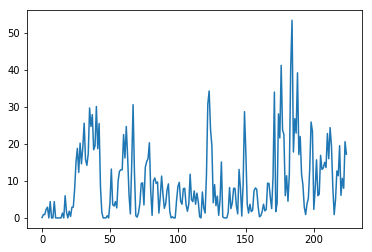

| Reward: 14 | Episode: 225| Epsilon:0.3067948769751967 


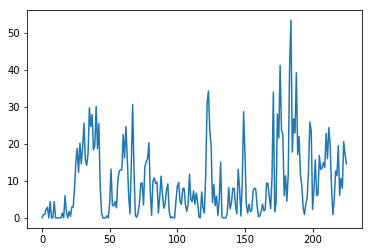

| Reward: 9 | Episode: 226| Epsilon:0.3059064562225909 


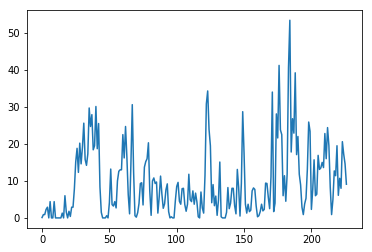

| Reward: 19 | Episode: 227| Epsilon:0.30501755796472957 


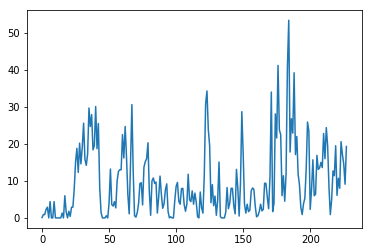

| Reward: 33 | Episode: 228| Epsilon:0.30410387193671173 


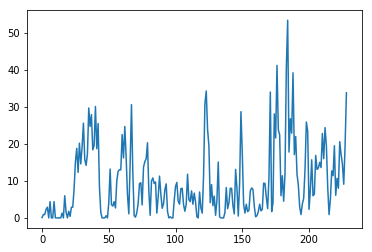

| Reward: 20 | Episode: 229| Epsilon:0.30313532140192356 


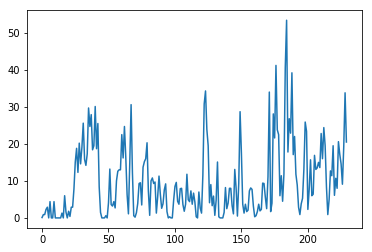

| Reward: 5 | Episode: 230| Epsilon:0.3021638122690467 


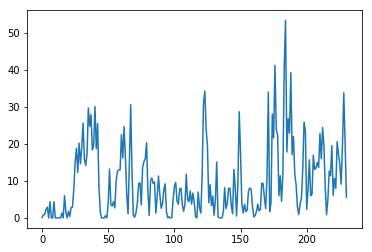

| Reward: 5 | Episode: 231| Epsilon:0.301156263641185 


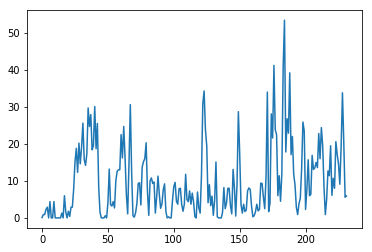

| Reward: 17 | Episode: 232| Epsilon:0.3002001030431105 


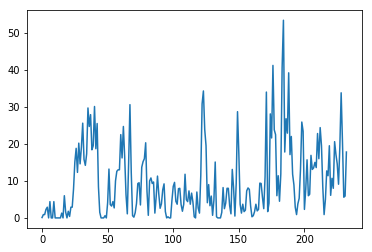

| Reward: 30 | Episode: 233| Epsilon:0.29935772064321353 


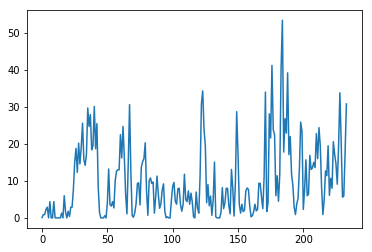

| Reward: 20 | Episode: 234| Epsilon:0.2984908365084638 


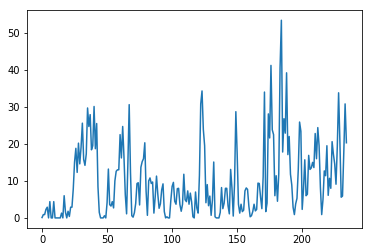

| Reward: 20 | Episode: 235| Epsilon:0.297513385573313 


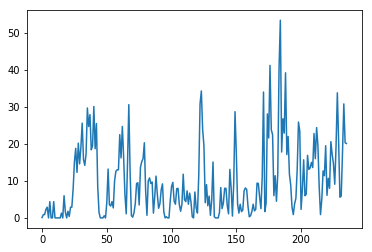

| Reward: 0 | Episode: 236| Epsilon:0.29663997639329254 


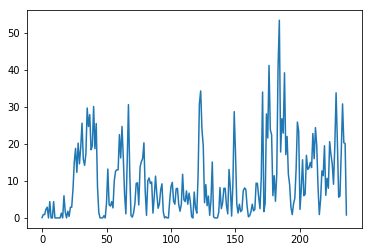

| Reward: 11 | Episode: 237| Epsilon:0.29580758395675916 


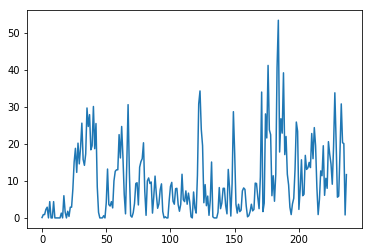

| Reward: 15 | Episode: 238| Epsilon:0.2948831490920795 


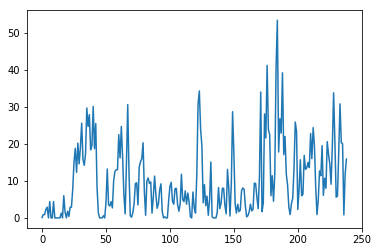

| Reward: 2 | Episode: 239| Epsilon:0.29401158116981285 


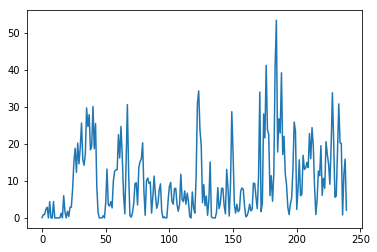

| Reward: 16 | Episode: 240| Epsilon:0.2931250011714079 


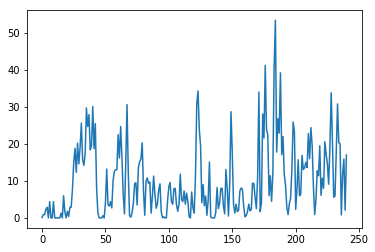

| Reward: 2 | Episode: 241| Epsilon:0.29231124124973096 


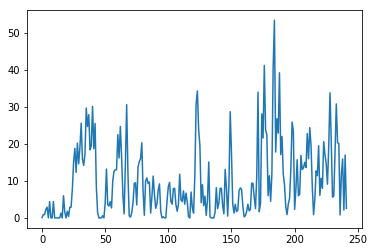

| Reward: 4 | Episode: 242| Epsilon:0.29148808063557774 


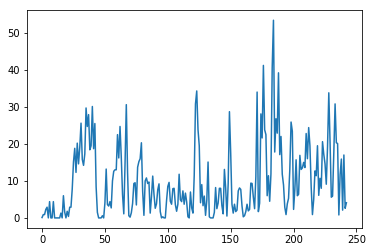

| Reward: 1 | Episode: 243| Epsilon:0.2906091101506848 


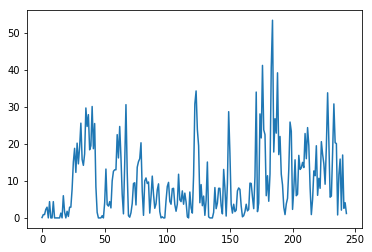

| Reward: 1 | Episode: 244| Epsilon:0.28974437976698497 


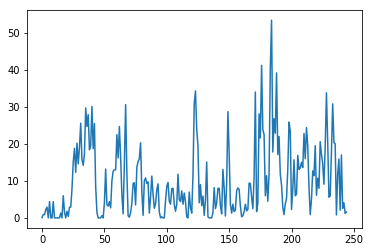

| Reward: 4 | Episode: 245| Epsilon:0.2888995559969259 


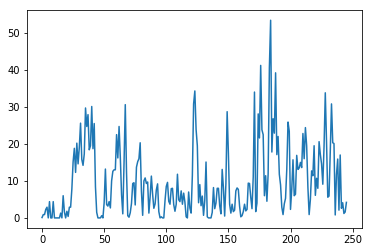

| Reward: 2 | Episode: 246| Epsilon:0.2881148130151741 


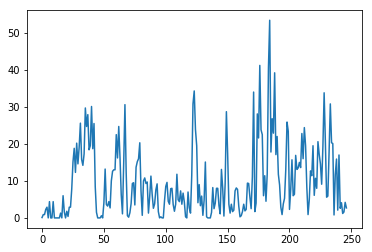

| Reward: 0 | Episode: 247| Epsilon:0.2872948506995808 


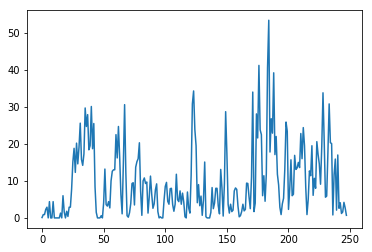

| Reward: 3 | Episode: 248| Epsilon:0.28648008676219494 


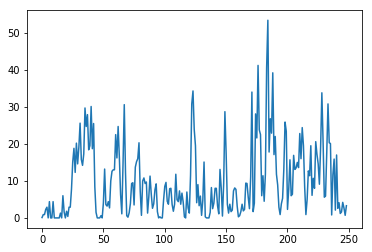

| Reward: 2 | Episode: 249| Epsilon:0.2856390680053784 


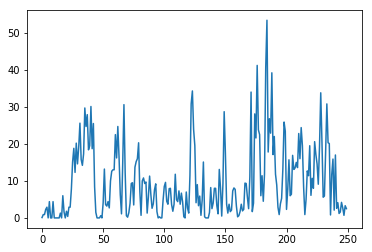

| Reward: 8 | Episode: 250| Epsilon:0.28483754488406154 


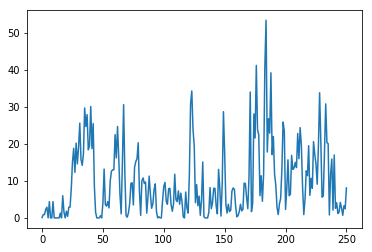

| Reward: 24 | Episode: 251| Epsilon:0.2839701095463217 


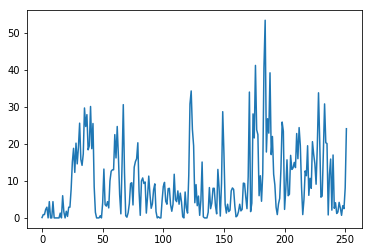

| Reward: 30 | Episode: 252| Epsilon:0.28315344810447285 


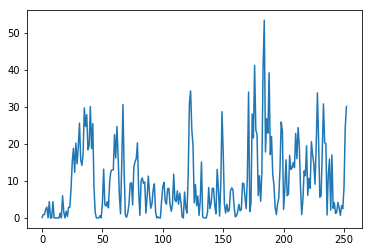

| Reward: 17 | Episode: 253| Epsilon:0.2823476056191586 


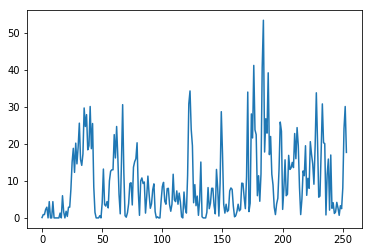

| Reward: 13 | Episode: 254| Epsilon:0.28159192332426325 


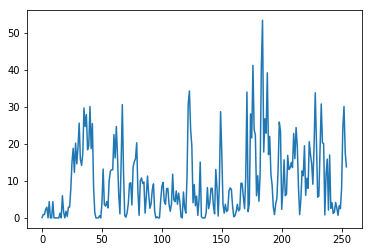

| Reward: 13 | Episode: 255| Epsilon:0.2807792934185171 


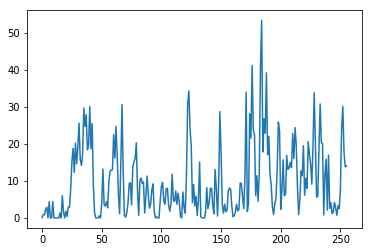

| Reward: 1 | Episode: 256| Epsilon:0.2799970070753457 


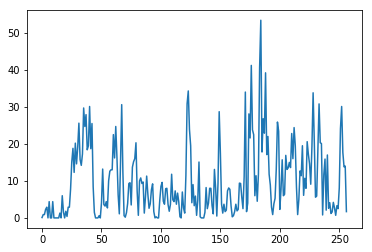

| Reward: 3 | Episode: 257| Epsilon:0.2792280692353197 


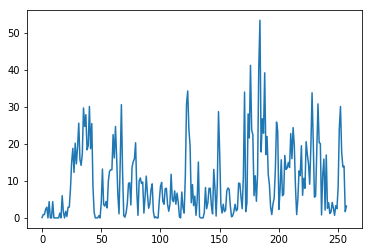

| Reward: 6 | Episode: 258| Epsilon:0.2784863058450135 


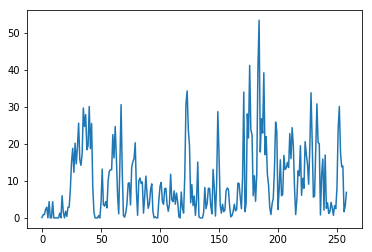

| Reward: 39 | Episode: 259| Epsilon:0.2776992998032447 


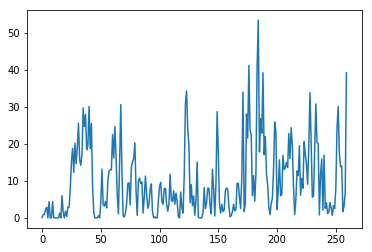

| Reward: 33 | Episode: 260| Epsilon:0.27690344143655743 


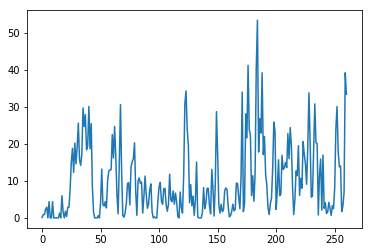

| Reward: 12 | Episode: 261| Epsilon:0.2762175683066419 


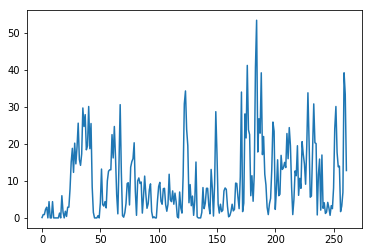

| Reward: 3 | Episode: 262| Epsilon:0.27547553781620376 


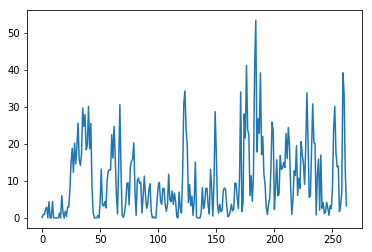

| Reward: 4 | Episode: 263| Epsilon:0.2747355007154415 


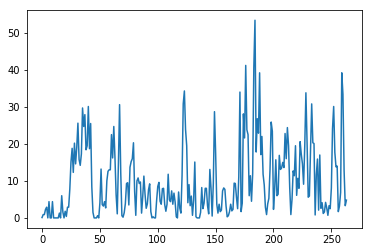

| Reward: 10 | Episode: 264| Epsilon:0.2739837520507267 


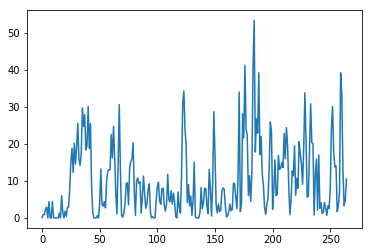

| Reward: 10 | Episode: 265| Epsilon:0.2732285957144015 


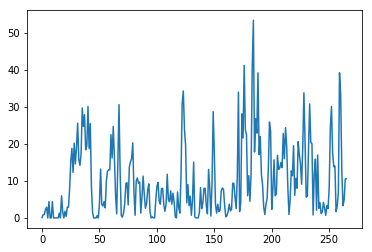

| Reward: 10 | Episode: 266| Epsilon:0.27247007126319467 


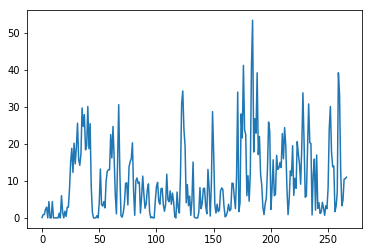

| Reward: 3 | Episode: 267| Epsilon:0.2717734364705762 


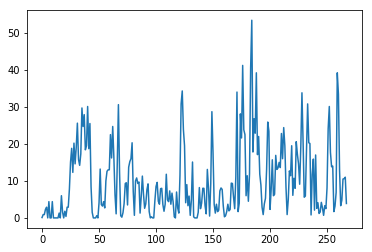

| Reward: 0 | Episode: 268| Epsilon:0.2710243722247608 


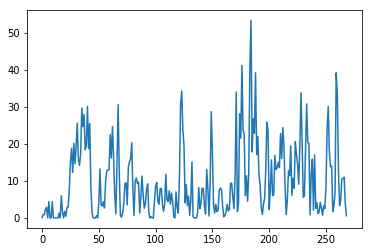

| Reward: 2 | Episode: 269| Epsilon:0.2702854810395051 


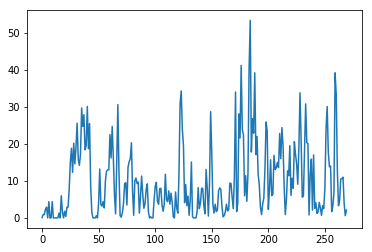

| Reward: 1 | Episode: 270| Epsilon:0.269508174825802 


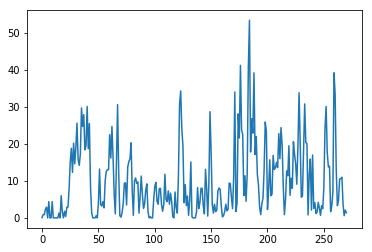

| Reward: 4 | Episode: 271| Epsilon:0.26878416844065806 


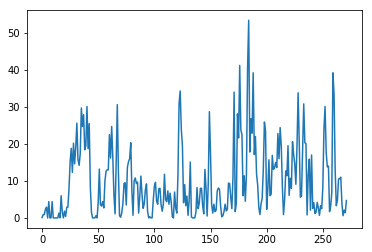

| Reward: 20 | Episode: 272| Epsilon:0.26809159562631724 


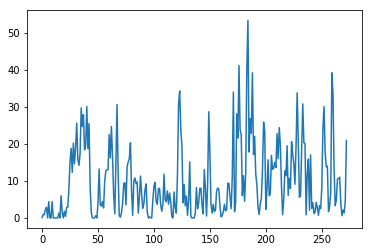

| Reward: 22 | Episode: 273| Epsilon:0.2673580264351918 


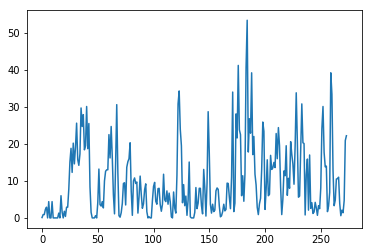

| Reward: 14 | Episode: 274| Epsilon:0.26663712980772497 


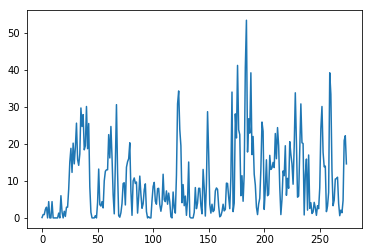

| Reward: 12 | Episode: 275| Epsilon:0.2659155178037835 


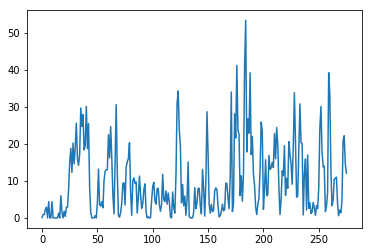

| Reward: 15 | Episode: 276| Epsilon:0.2651507790412203 


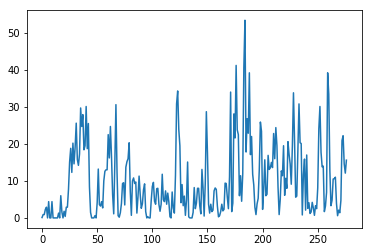

| Reward: 4 | Episode: 277| Epsilon:0.2643935274129007 


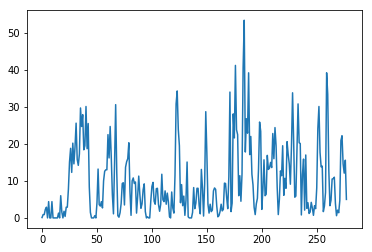

| Reward: 20 | Episode: 278| Epsilon:0.26368853475376264 


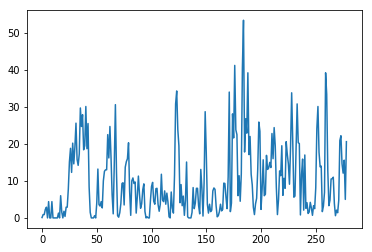

| Reward: 13 | Episode: 279| Epsilon:0.2630012016013346 


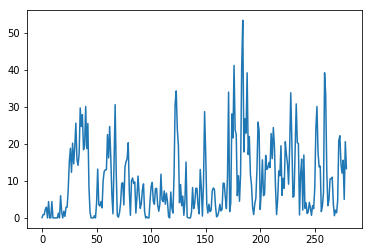

| Reward: 6 | Episode: 280| Epsilon:0.26232615294704786 


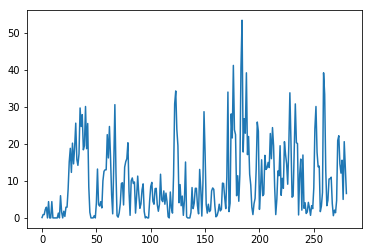

| Reward: 6 | Episode: 281| Epsilon:0.2615795840443239 


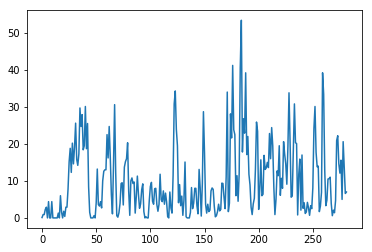

| Reward: 22 | Episode: 282| Epsilon:0.2608847034772413 


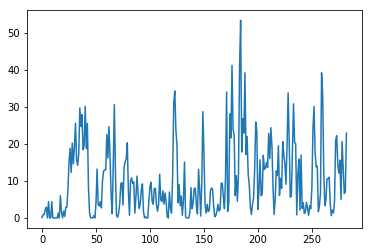

| Reward: 32 | Episode: 283| Epsilon:0.26022809841131134 


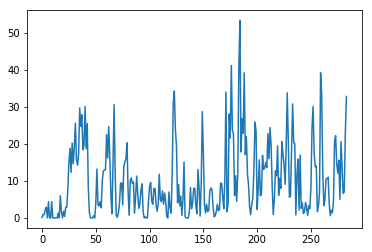

| Reward: 28 | Episode: 284| Epsilon:0.2595627631452036 


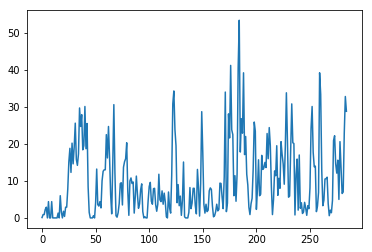

| Reward: 6 | Episode: 285| Epsilon:0.25895091423063427 


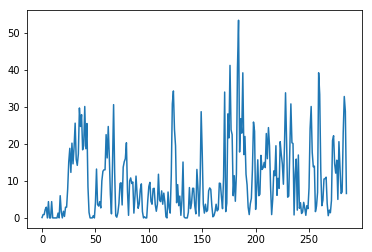

| Reward: 4 | Episode: 286| Epsilon:0.2582965932111344 


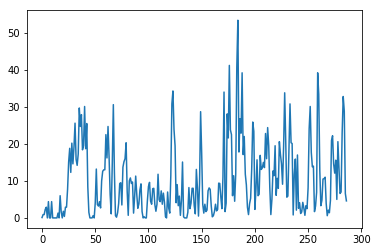

| Reward: 11 | Episode: 287| Epsilon:0.2575872498272732 


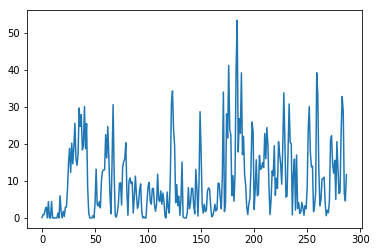

| Reward: 1 | Episode: 288| Epsilon:0.2569466522471826 


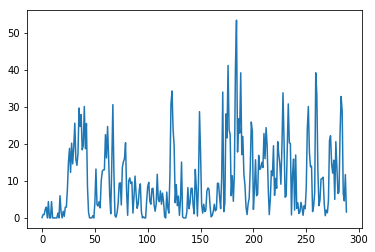

| Reward: 0 | Episode: 289| Epsilon:0.2562640789642727 


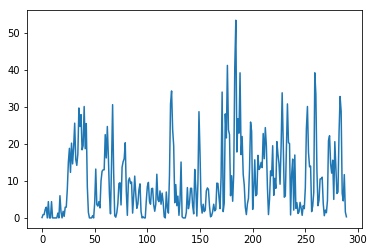

| Reward: 3 | Episode: 290| Epsilon:0.25559865445855584 


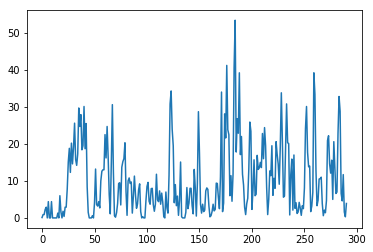

| Reward: 11 | Episode: 291| Epsilon:0.254947704948297 


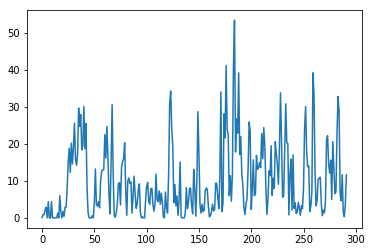

| Reward: 34 | Episode: 292| Epsilon:0.25428315572961396 


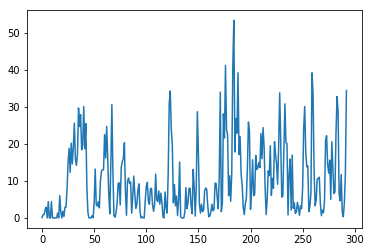

| Reward: 11 | Episode: 293| Epsilon:0.25365331168361693 


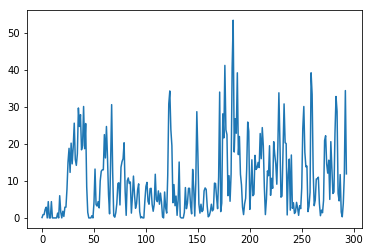

| Reward: 25 | Episode: 294| Epsilon:0.25300731650275154 


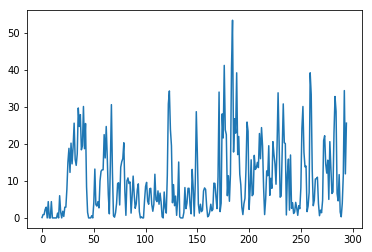

| Reward: 17 | Episode: 295| Epsilon:0.25240839616897276 


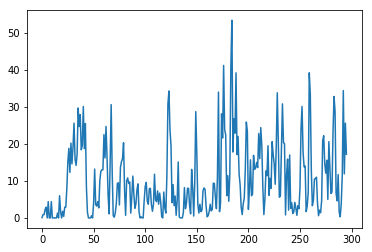

| Reward: 2 | Episode: 296| Epsilon:0.2517756423690388 


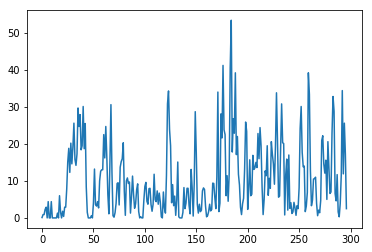

| Reward: 4 | Episode: 297| Epsilon:0.25113191782492666 


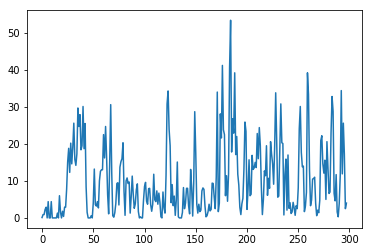

| Reward: 5 | Episode: 298| Epsilon:0.25053743694538017 


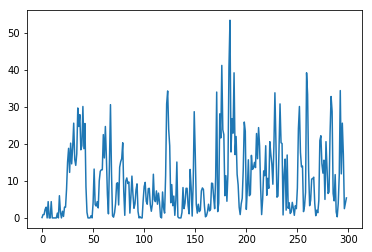

| Reward: 5 | Episode: 299| Epsilon:0.2498519005542176 


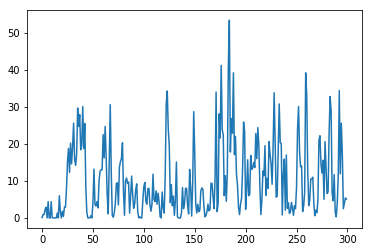

| Reward: 6 | Episode: 300| Epsilon:0.24921060238442572 


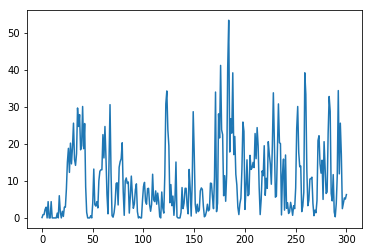

| Reward: 16 | Episode: 301| Epsilon:0.2485436088056804 


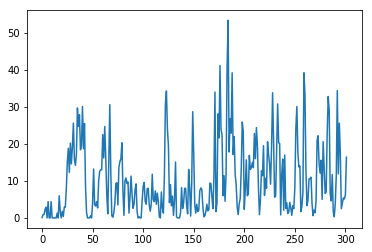

| Reward: 17 | Episode: 302| Epsilon:0.24789327361005245 


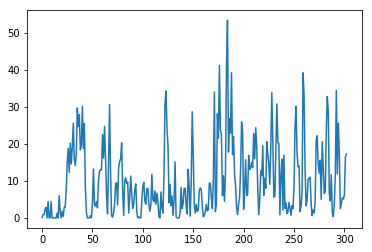

| Reward: 9 | Episode: 303| Epsilon:0.2473311912733601 


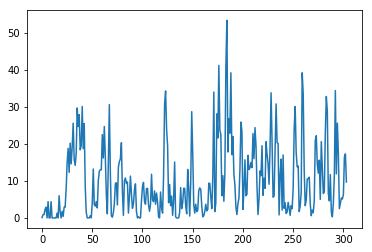

| Reward: 20 | Episode: 304| Epsilon:0.2466938960777081 


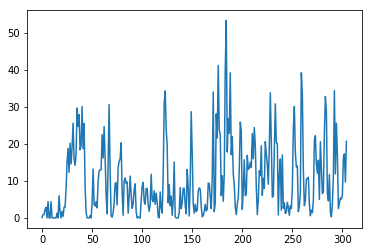

| Reward: 14 | Episode: 305| Epsilon:0.24611238203186775 


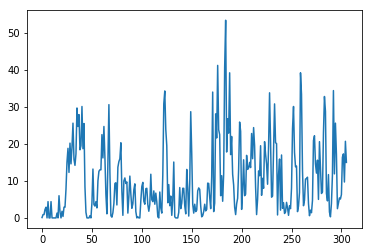

| Reward: 5 | Episode: 306| Epsilon:0.24553223874789423 


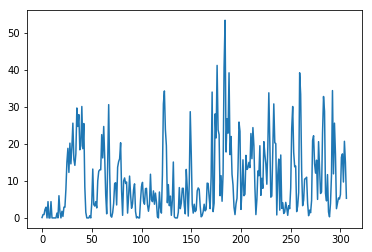

| Reward: 8 | Episode: 307| Epsilon:0.24496816071678312 


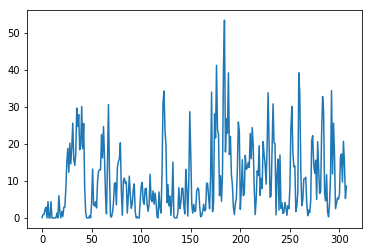

| Reward: 1 | Episode: 308| Epsilon:0.24438338297653908 


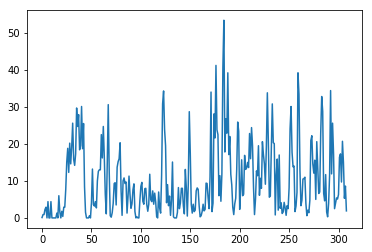

| Reward: 0 | Episode: 309| Epsilon:0.24380000119324105 


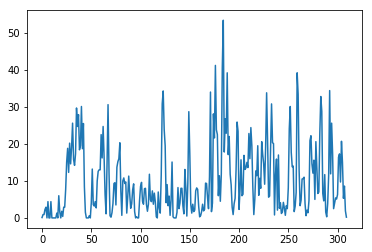

| Reward: 0 | Episode: 310| Epsilon:0.24318153188639247 


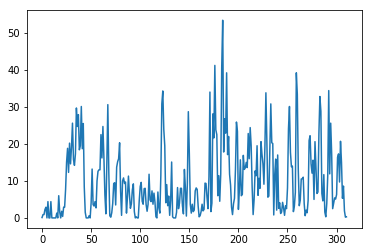

| Reward: 0 | Episode: 311| Epsilon:0.242588889303357 


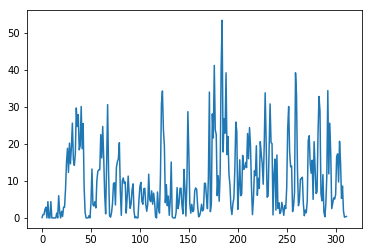

| Reward: 1 | Episode: 312| Epsilon:0.24201705169919424 


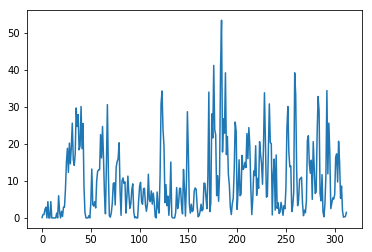

| Reward: 2 | Episode: 313| Epsilon:0.2414031053600746 


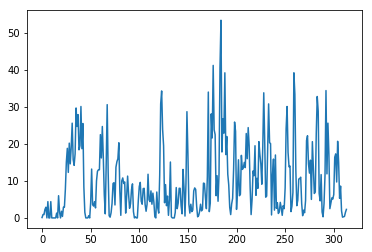

| Reward: 9 | Episode: 314| Epsilon:0.24078349282438422 


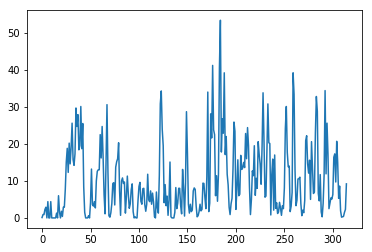

| Reward: 13 | Episode: 315| Epsilon:0.2402279221093297 


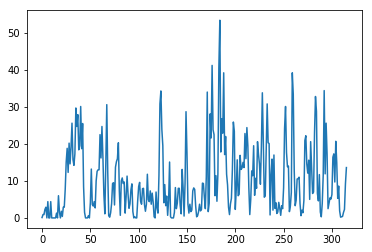

| Reward: 13 | Episode: 316| Epsilon:0.23964008116016178 


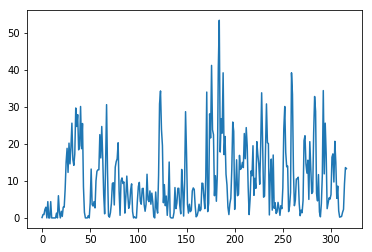

| Reward: 20 | Episode: 317| Epsilon:0.2390728038206003 


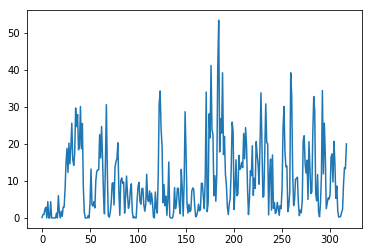

| Reward: 11 | Episode: 318| Epsilon:0.23848778946138618 


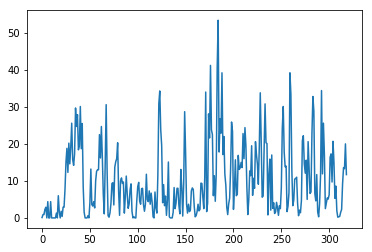

| Reward: 26 | Episode: 319| Epsilon:0.2378994485798175 


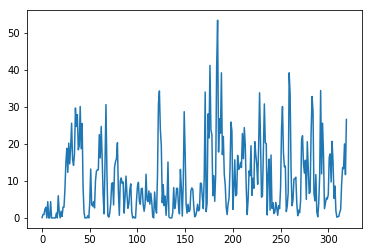

| Reward: 42 | Episode: 320| Epsilon:0.23735290588040792 


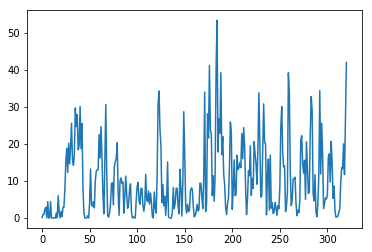

| Reward: 59 | Episode: 321| Epsilon:0.23678157125531613 


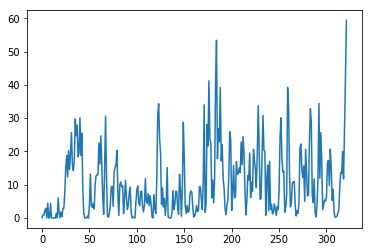

| Reward: 42 | Episode: 322| Epsilon:0.236183268061204 


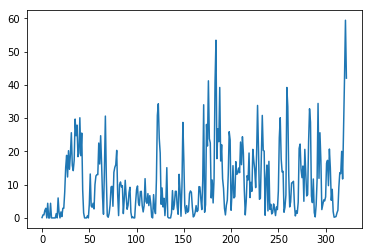

| Reward: 34 | Episode: 323| Epsilon:0.2356571635674368 


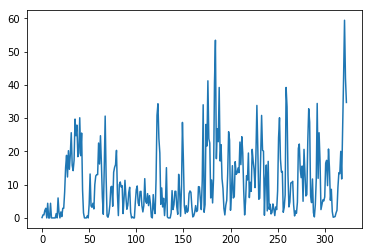

| Reward: 58 | Episode: 324| Epsilon:0.23519102168561432 


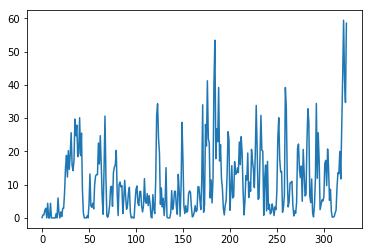

| Reward: 58 | Episode: 325| Epsilon:0.23462723722661302 


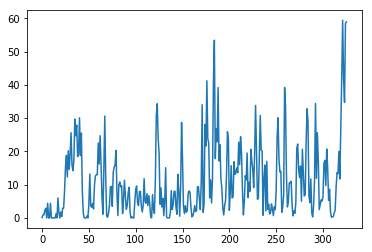

| Reward: 26 | Episode: 326| Epsilon:0.2341116221112297 


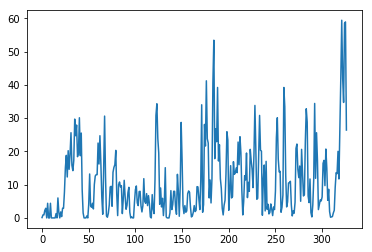

| Reward: 4 | Episode: 327| Epsilon:0.2335574317708297 


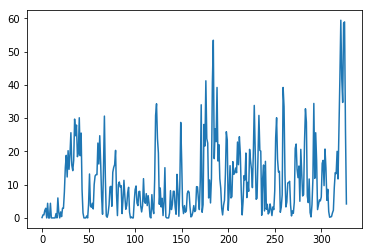

| Reward: 22 | Episode: 328| Epsilon:0.23299057338920445 


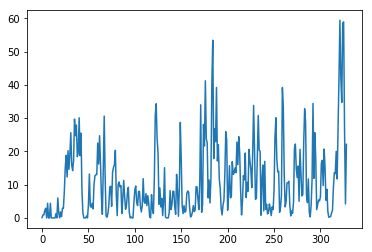

| Reward: 15 | Episode: 329| Epsilon:0.23242741508220177 


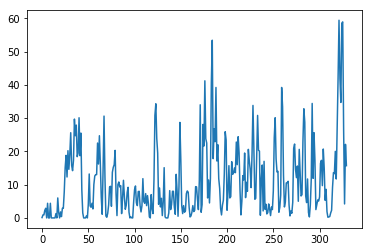

| Reward: 2 | Episode: 330| Epsilon:0.23189808159862427 


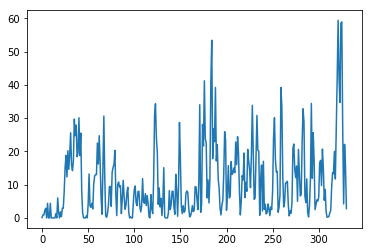

| Reward: 13 | Episode: 331| Epsilon:0.2313468176723862 


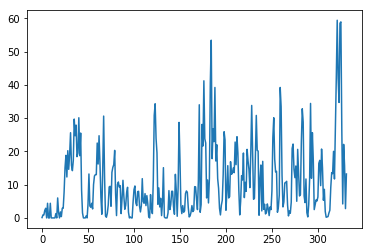

| Reward: 22 | Episode: 332| Epsilon:0.23077840109786743 


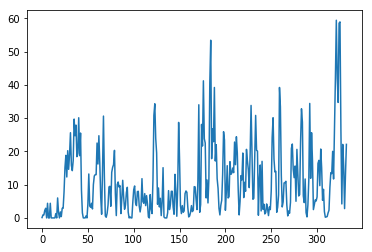

| Reward: 28 | Episode: 333| Epsilon:0.23021138111659148 


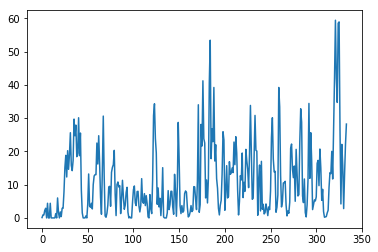

| Reward: 54 | Episode: 334| Epsilon:0.22966872013567508 


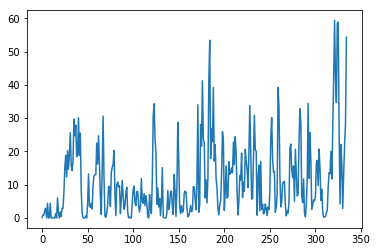

| Reward: 61 | Episode: 335| Epsilon:0.2291112998985242 


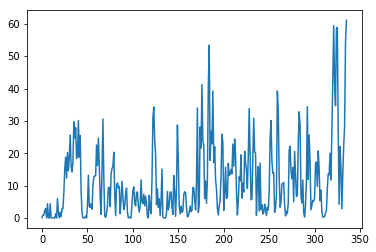

| Reward: 30 | Episode: 336| Epsilon:0.22860552048895455 


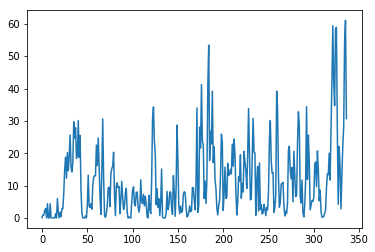

| Reward: 35 | Episode: 337| Epsilon:0.22806892557879488 


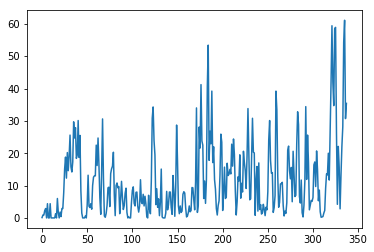

| Reward: 24 | Episode: 338| Epsilon:0.2275244889853632 


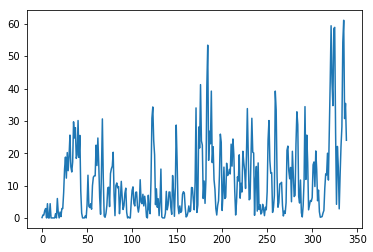

| Reward: 36 | Episode: 339| Epsilon:0.2269927014562628 


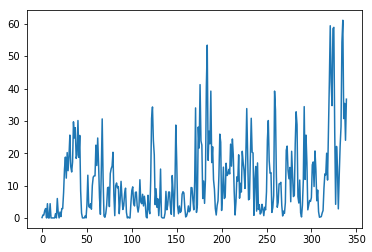

| Reward: 23 | Episode: 340| Epsilon:0.22646442150560975 


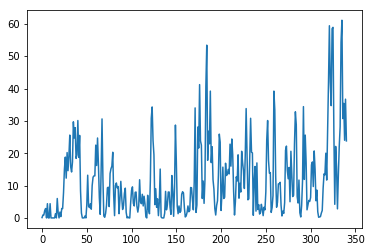

| Reward: 23 | Episode: 341| Epsilon:0.22600516273901997 


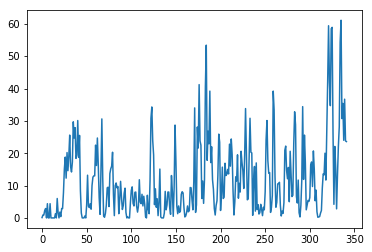

| Reward: 10 | Episode: 342| Epsilon:0.2254543796166915 


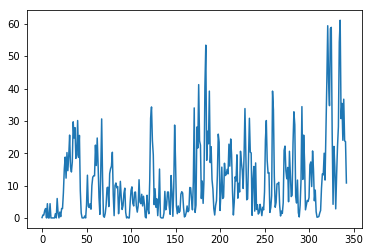

| Reward: 43 | Episode: 343| Epsilon:0.22496567160934344 


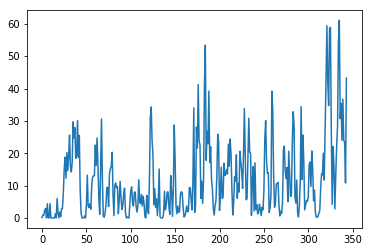

| Reward: 49 | Episode: 344| Epsilon:0.22440395705749608 


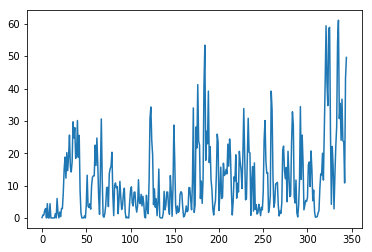

| Reward: 38 | Episode: 345| Epsilon:0.2238749855059259 


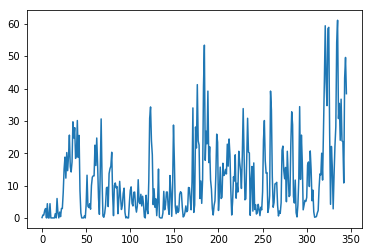

| Reward: 46 | Episode: 346| Epsilon:0.22337853182331482 


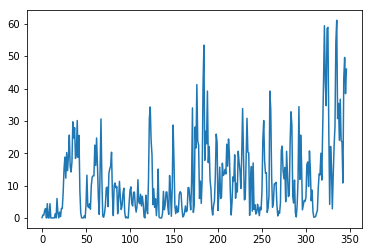

| Reward: 49 | Episode: 347| Epsilon:0.222883179050921 


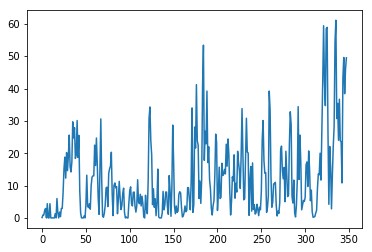

| Reward: 38 | Episode: 348| Epsilon:0.22235779232161657 


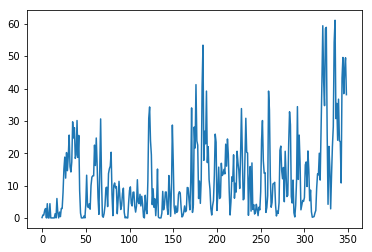

| Reward: 36 | Episode: 349| Epsilon:0.22189132858377164 


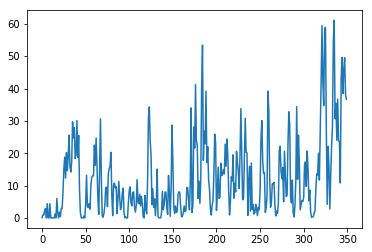

| Reward: 27 | Episode: 350| Epsilon:0.2214103440527798 


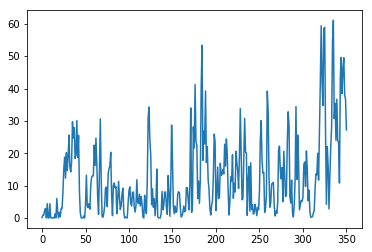

| Reward: 48 | Episode: 351| Epsilon:0.22087075867722802 


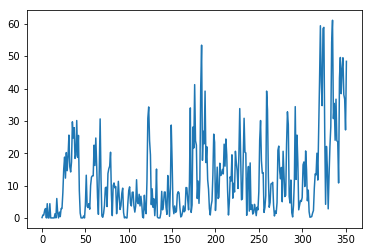

| Reward: 49 | Episode: 352| Epsilon:0.22037876320423908 


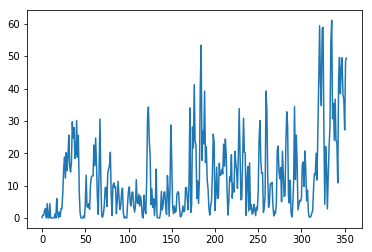

| Reward: 39 | Episode: 353| Epsilon:0.2198834659289304 


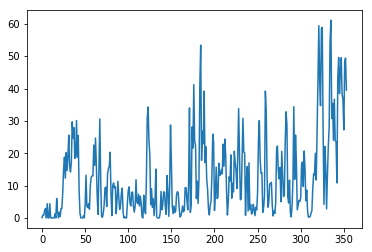

| Reward: 40 | Episode: 354| Epsilon:0.2194112219601412 


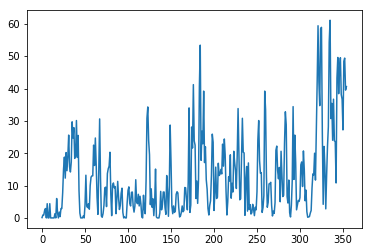

| Reward: 54 | Episode: 355| Epsilon:0.21898597468652847 


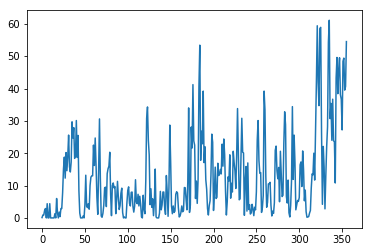

| Reward: 29 | Episode: 356| Epsilon:0.21856155159703033 


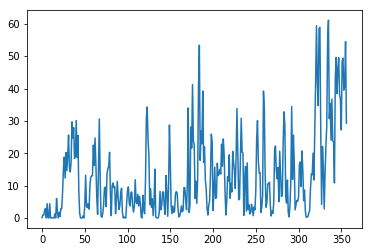

| Reward: 54 | Episode: 357| Epsilon:0.21809650861351138 


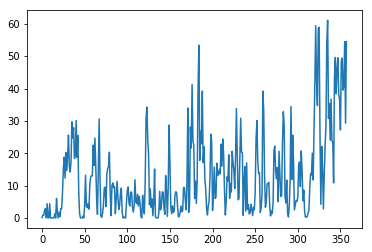

| Reward: 49 | Episode: 358| Epsilon:0.21758893276605587 


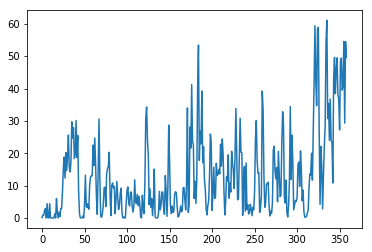

| Reward: 26 | Episode: 359| Epsilon:0.21710858979741104 


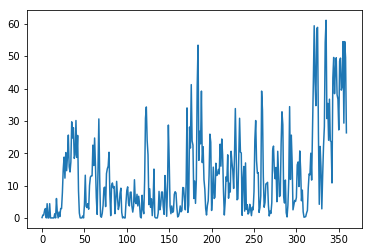

| Reward: 45 | Episode: 360| Epsilon:0.2166466383443343 


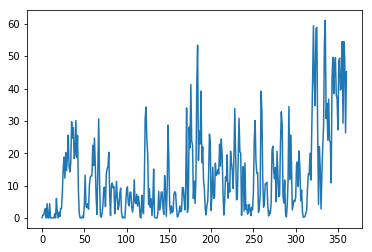

| Reward: 12 | Episode: 361| Epsilon:0.21616837555731502 


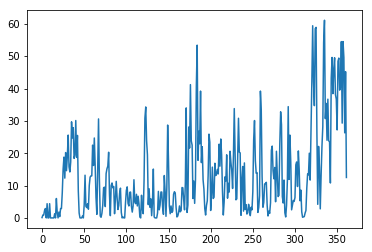

| Reward: 25 | Episode: 362| Epsilon:0.21573215398969361 


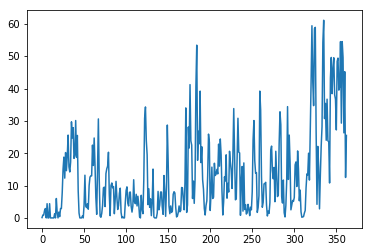

| Reward: 35 | Episode: 363| Epsilon:0.2152925067899312 


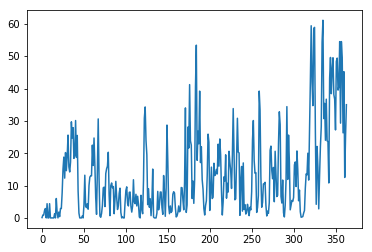

| Reward: 6 | Episode: 364| Epsilon:0.21482367799004812 


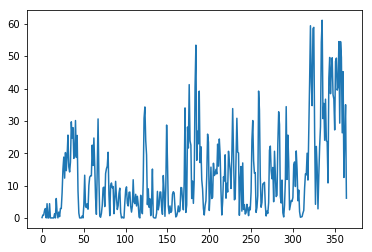

| Reward: 29 | Episode: 365| Epsilon:0.21436873193119318 


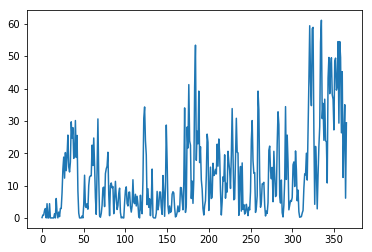

| Reward: 0 | Episode: 366| Epsilon:0.21389977575792193 


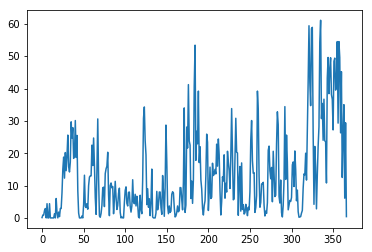

| Reward: 6 | Episode: 367| Epsilon:0.2133998329441498 


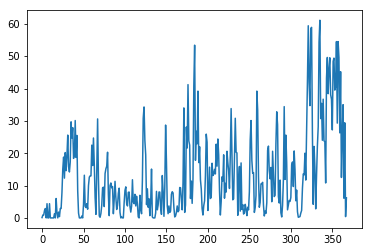

| Reward: 4 | Episode: 368| Epsilon:0.21293938446612573 


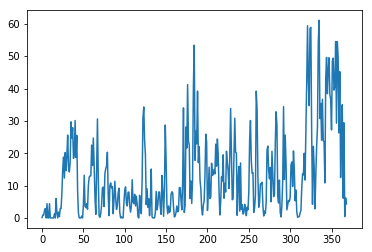

| Reward: 0 | Episode: 369| Epsilon:0.21247143041872285 


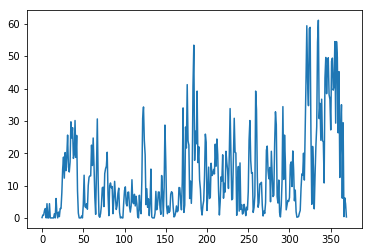

| Reward: 19 | Episode: 370| Epsilon:0.2120151052869928 


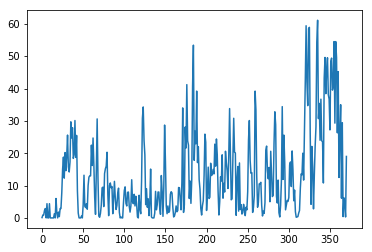

| Reward: 13 | Episode: 371| Epsilon:0.21155764460766302 


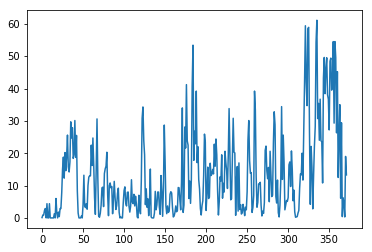

| Reward: 2 | Episode: 372| Epsilon:0.21112017103731254 


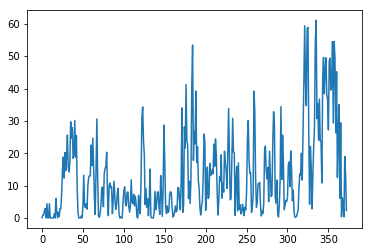

| Reward: 15 | Episode: 373| Epsilon:0.21067096140504726 


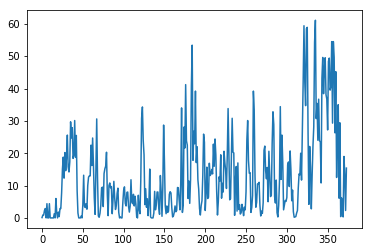

| Reward: 13 | Episode: 374| Epsilon:0.21018066702826296 


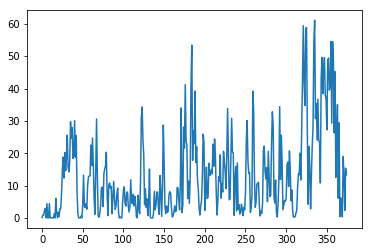

| Reward: 38 | Episode: 375| Epsilon:0.20972506720739853 


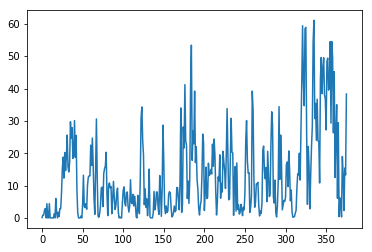

| Reward: 39 | Episode: 376| Epsilon:0.20924743637207258 


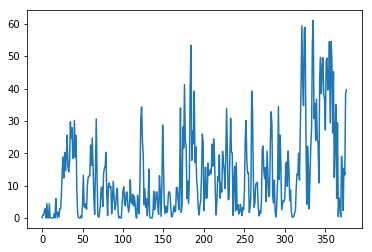

| Reward: 8 | Episode: 377| Epsilon:0.2088293576270385 


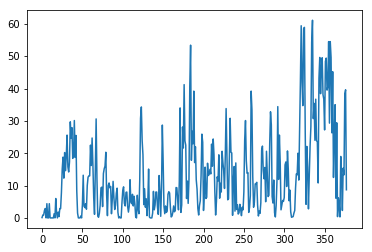

| Reward: 30 | Episode: 378| Epsilon:0.20834543266772734 


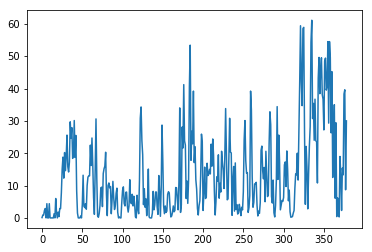

| Reward: 24 | Episode: 379| Epsilon:0.20793331478180088 


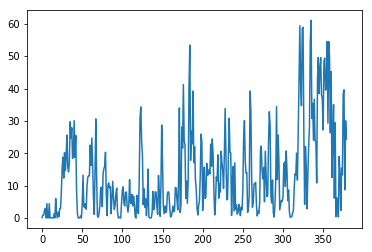

| Reward: 4 | Episode: 380| Epsilon:0.2075406900010309 


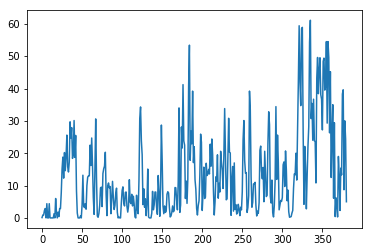

| Reward: 14 | Episode: 381| Epsilon:0.20711152296801688 


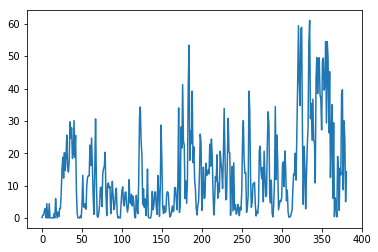

| Reward: 42 | Episode: 382| Epsilon:0.2067163155263631 


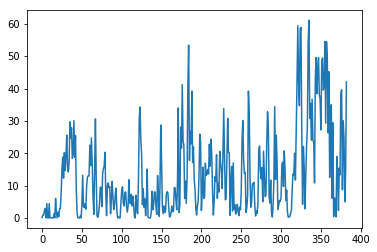

| Reward: 27 | Episode: 383| Epsilon:0.20624966183729615 


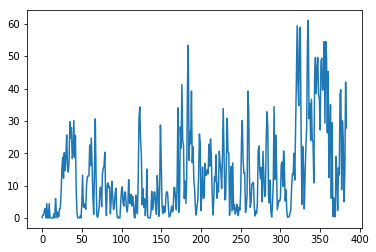

| Reward: 60 | Episode: 384| Epsilon:0.2058458063884444 


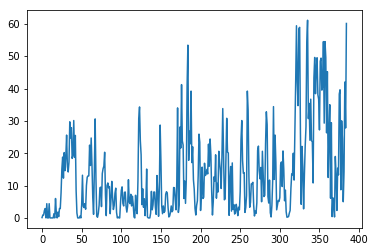

| Reward: 48 | Episode: 385| Epsilon:0.20540576517459952 


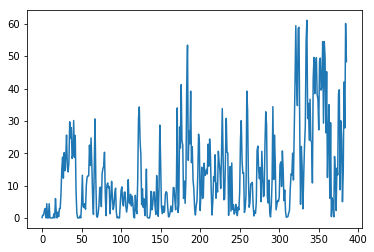

| Reward: 12 | Episode: 386| Epsilon:0.20500561220768465 


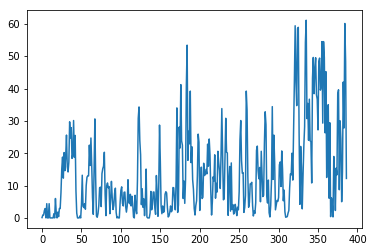

| Reward: 26 | Episode: 387| Epsilon:0.20458782495772732 


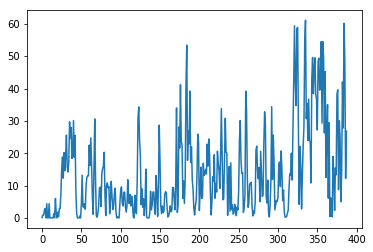

| Reward: 57 | Episode: 388| Epsilon:0.20416884742038072 


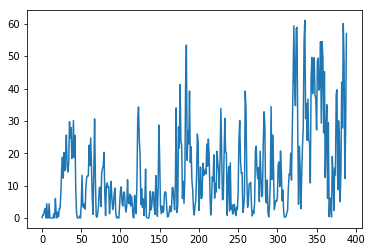

| Reward: 53 | Episode: 389| Epsilon:0.20374665291731306 


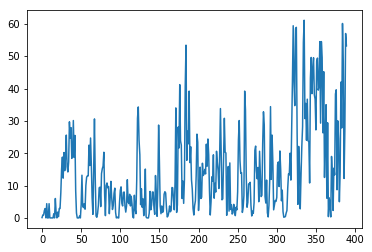

| Reward: 35 | Episode: 390| Epsilon:0.20332329820400577 


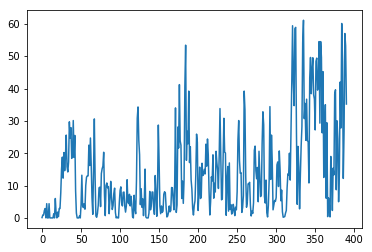

| Reward: 8 | Episode: 391| Epsilon:0.20290082315772995 


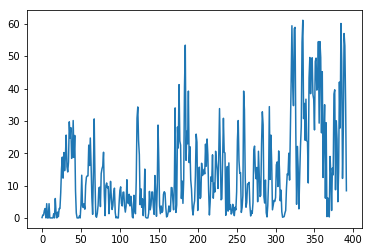

| Reward: 30 | Episode: 392| Epsilon:0.20244075835993822 


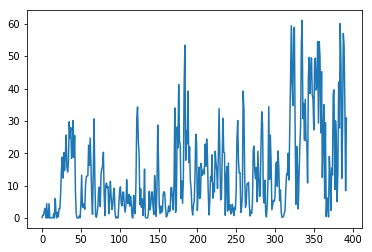

| Reward: 29 | Episode: 393| Epsilon:0.20205042253985322 


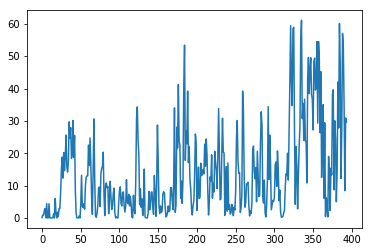

| Reward: 20 | Episode: 394| Epsilon:0.20168302336849414 


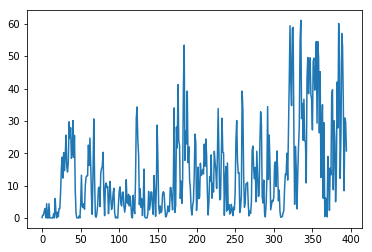

| Reward: 17 | Episode: 395| Epsilon:0.201302200541146 


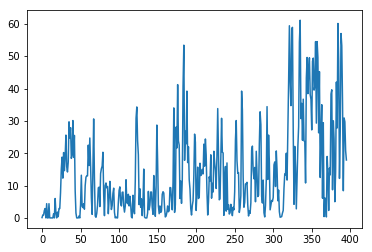

| Reward: 15 | Episode: 396| Epsilon:0.20088794276874242 


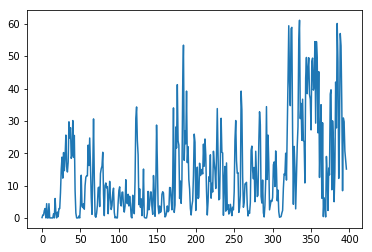

| Reward: 6 | Episode: 397| Epsilon:0.2004985960015129 


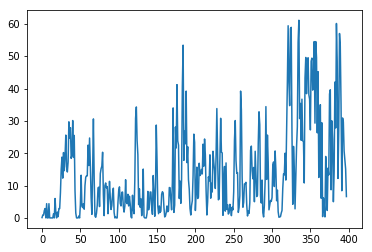

| Reward: 31 | Episode: 398| Epsilon:0.20009999853849805 


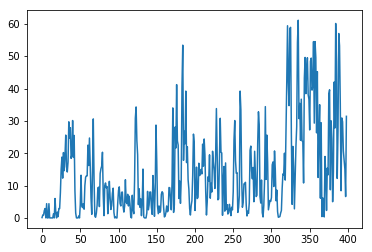

| Reward: 17 | Episode: 399| Epsilon:0.1996922085896983 


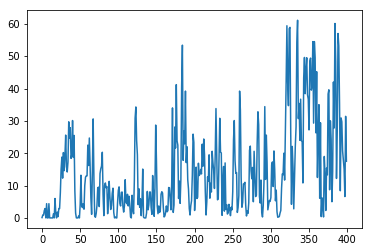

| Reward: 39 | Episode: 400| Epsilon:0.19931713803898451 


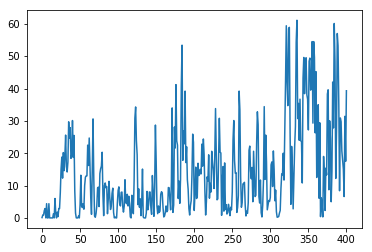

| Reward: 9 | Episode: 401| Epsilon:0.1989049762370716 


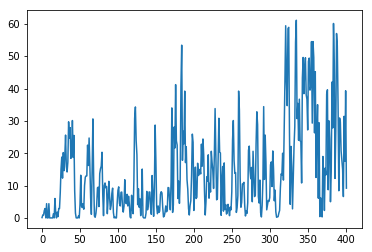

| Reward: 0 | Episode: 402| Epsilon:0.1985254284182714 


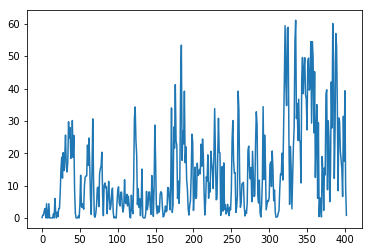

| Reward: 18 | Episode: 403| Epsilon:0.19810896038074338 


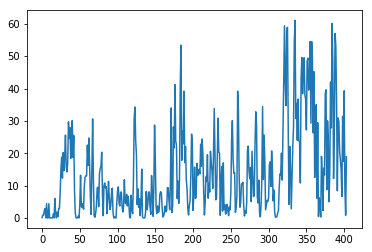

| Reward: 16 | Episode: 404| Epsilon:0.19777245957231884 


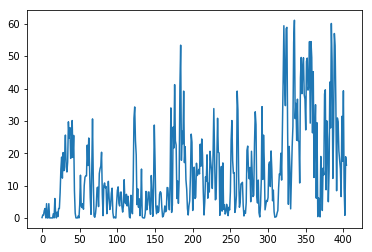

| Reward: 39 | Episode: 405| Epsilon:0.1973871771222149 


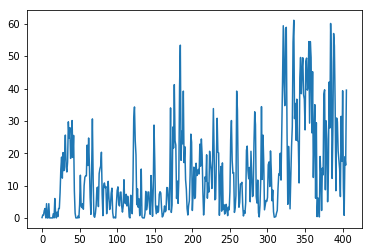

| Reward: 25 | Episode: 406| Epsilon:0.196992795309334 


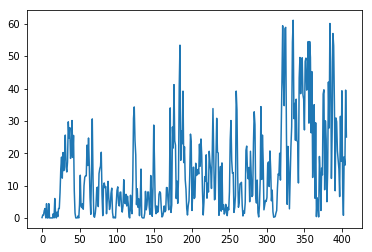

| Reward: 1 | Episode: 407| Epsilon:0.19663066002192225 


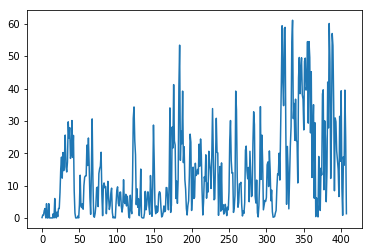

| Reward: 0 | Episode: 408| Epsilon:0.1962260157657344 


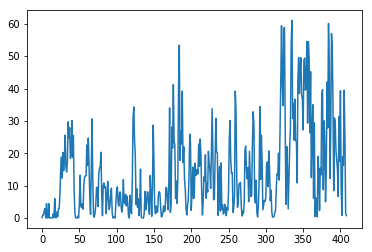

| Reward: 0 | Episode: 409| Epsilon:0.1958515799035218 


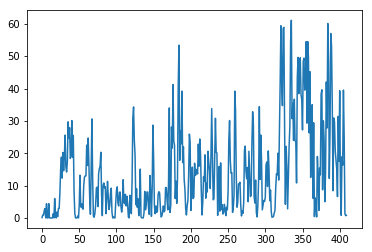

| Reward: 0 | Episode: 410| Epsilon:0.19543485792117998 


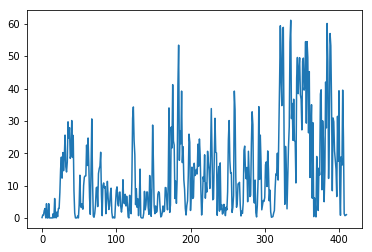

| Reward: 0 | Episode: 411| Epsilon:0.1950209728261754 


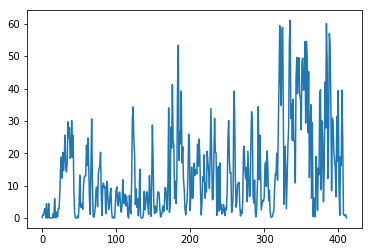

| Reward: 0 | Episode: 412| Epsilon:0.1946138025982182 


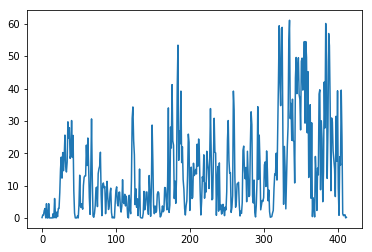

| Reward: 1 | Episode: 413| Epsilon:0.19420554039679802 


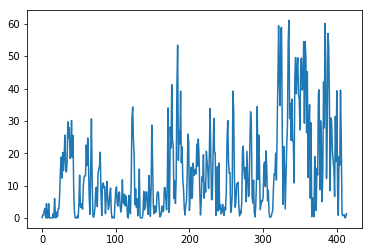

| Reward: 5 | Episode: 414| Epsilon:0.1938194537246248 


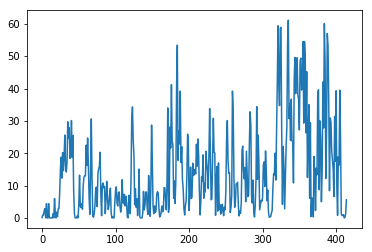

| Reward: 25 | Episode: 415| Epsilon:0.193414792061769 


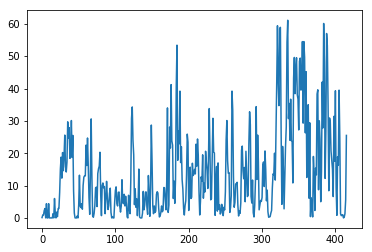

| Reward: 17 | Episode: 416| Epsilon:0.19302641683570632 


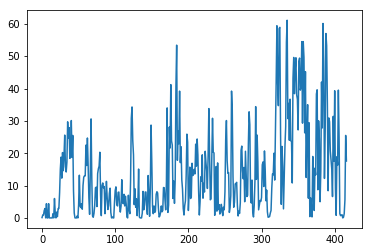

| Reward: 31 | Episode: 417| Epsilon:0.1926311160264555 


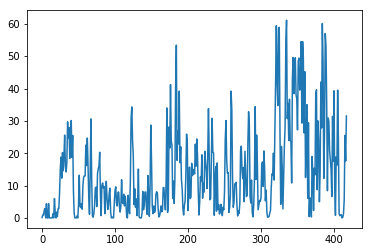

| Reward: 21 | Episode: 418| Epsilon:0.19227699889005403 


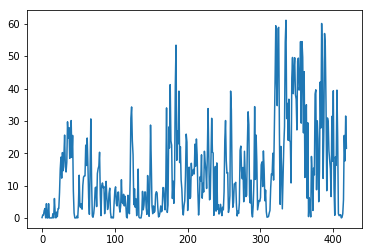

| Reward: 45 | Episode: 419| Epsilon:0.19182183970357258 


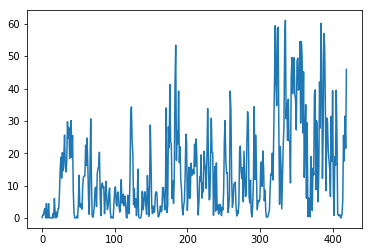

| Reward: 37 | Episode: 420| Epsilon:0.19143092006957596 


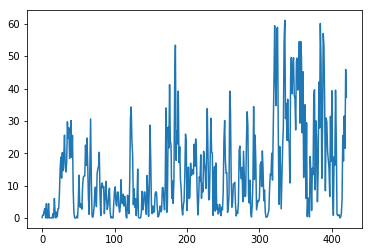

| Reward: 4 | Episode: 421| Epsilon:0.1910962072450322 


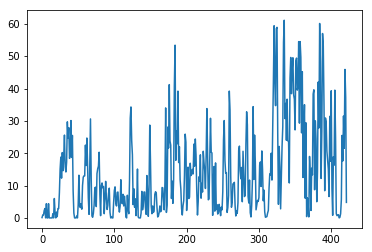

| Reward: 11 | Episode: 422| Epsilon:0.19072774540279042 


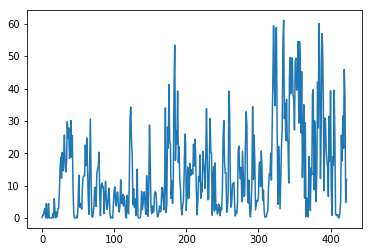

| Reward: 31 | Episode: 423| Epsilon:0.190382838693811 


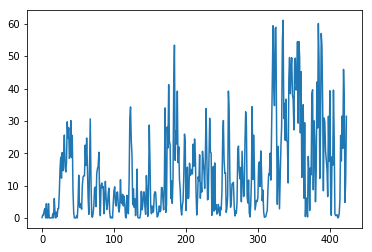

| Reward: 26 | Episode: 424| Epsilon:0.19001765250851024 


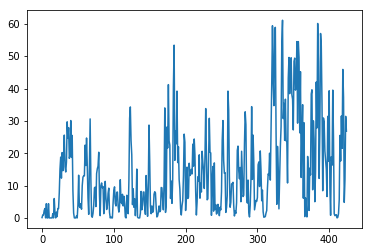

| Reward: 33 | Episode: 425| Epsilon:0.18971196870104676 


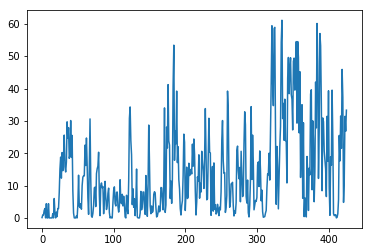

| Reward: 39 | Episode: 426| Epsilon:0.18939730650157371 


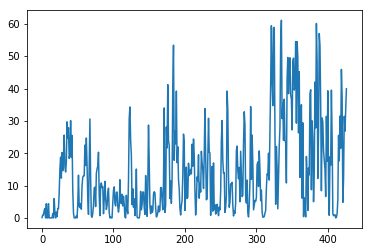

| Reward: 11 | Episode: 427| Epsilon:0.1890472436422165 


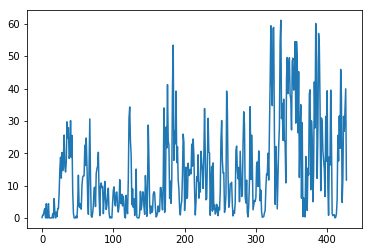

| Reward: 38 | Episode: 428| Epsilon:0.18870726297814894 


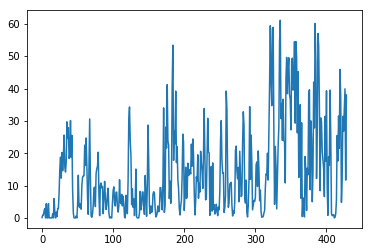

| Reward: 71 | Episode: 429| Epsilon:0.18835847552557194 


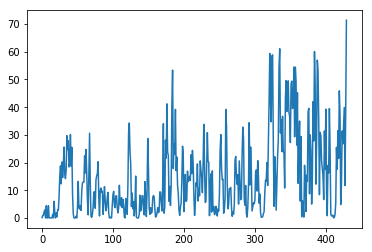

| Reward: 40 | Episode: 430| Epsilon:0.18798589285967895 


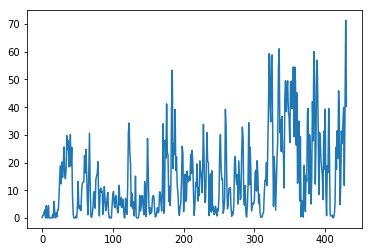

| Reward: 51 | Episode: 431| Epsilon:0.18763468596478722 


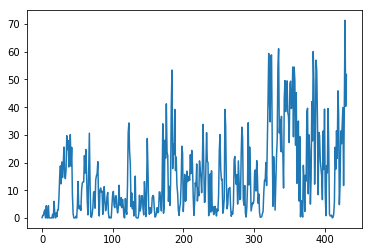

| Reward: 63 | Episode: 432| Epsilon:0.18728226237502957 


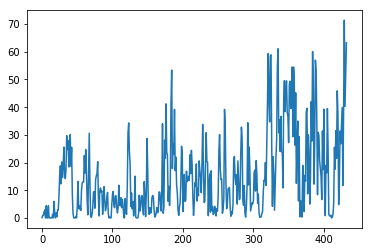

| Reward: 52 | Episode: 433| Epsilon:0.18691180851360703 


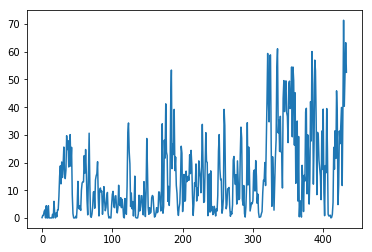

| Reward: 23 | Episode: 434| Epsilon:0.18660925500555664 


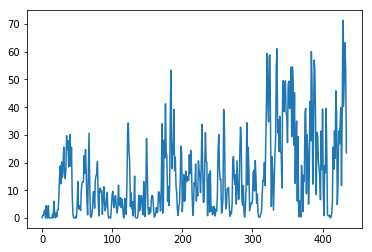

| Reward: 38 | Episode: 435| Epsilon:0.1862438572455369 


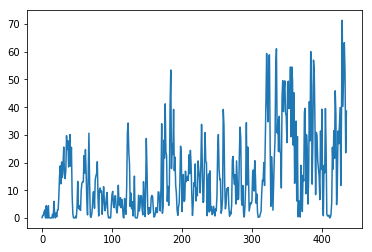

| Reward: 47 | Episode: 436| Epsilon:0.18592936937145596 


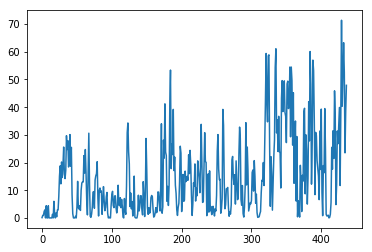

| Reward: 41 | Episode: 437| Epsilon:0.18560427588935088 


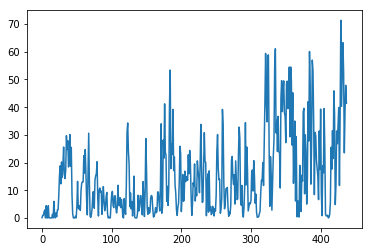

| Reward: 9 | Episode: 438| Epsilon:0.18526863431903653 


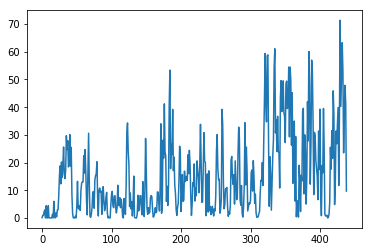

| Reward: 19 | Episode: 439| Epsilon:0.18488737186118503 


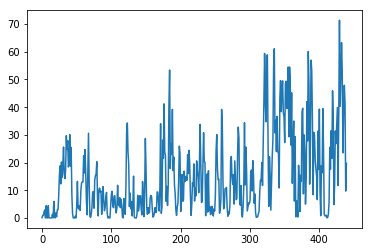

| Reward: 1 | Episode: 440| Epsilon:0.18454379925323683 


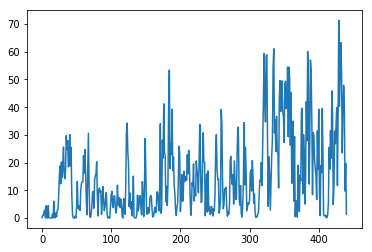

| Reward: 2 | Episode: 441| Epsilon:0.18426534700845548 


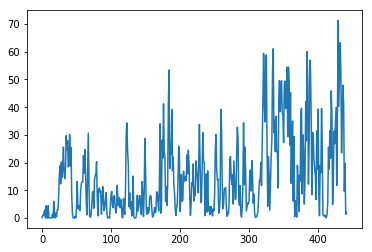

| Reward: 7 | Episode: 442| Epsilon:0.1839137343346019 


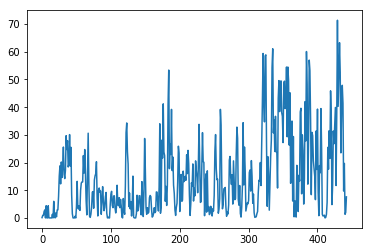

| Reward: 9 | Episode: 443| Epsilon:0.18353158942494285 


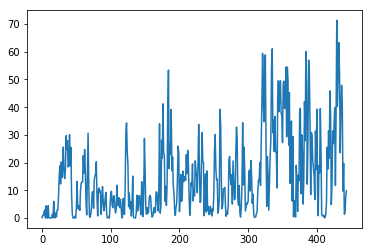

| Reward: 3 | Episode: 444| Epsilon:0.18320702421378154 


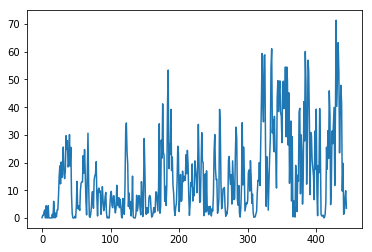

| Reward: 9 | Episode: 445| Epsilon:0.1828793753354247 


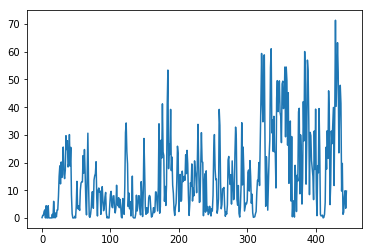

| Reward: 4 | Episode: 446| Epsilon:0.1825541379682704 


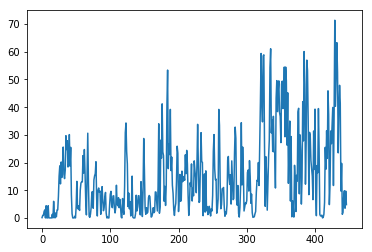

| Reward: 6 | Episode: 447| Epsilon:0.18223130132459664 


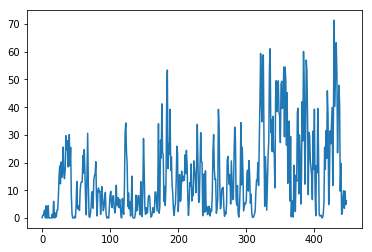

| Reward: 12 | Episode: 448| Epsilon:0.18192904679379268 


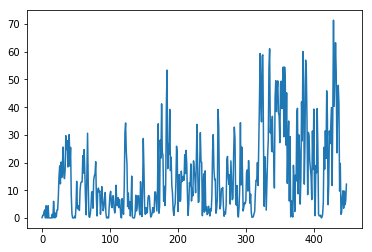

| Reward: 10 | Episode: 449| Epsilon:0.18157462905006147 


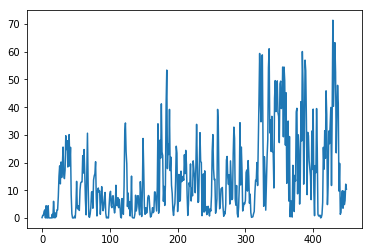

| Reward: 29 | Episode: 450| Epsilon:0.1811991564387888 


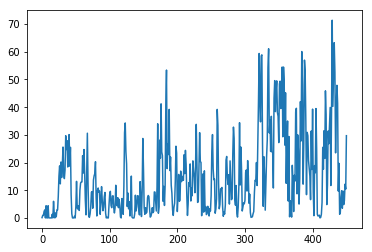

| Reward: 11 | Episode: 451| Epsilon:0.1808642462123039 


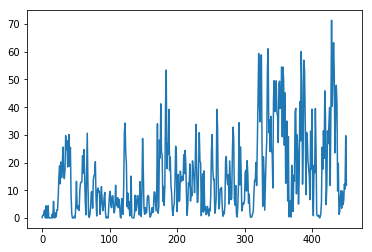

| Reward: 12 | Episode: 452| Epsilon:0.1805588422482228 


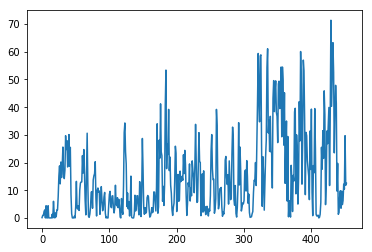

| Reward: 8 | Episode: 453| Epsilon:0.1802269177830181 


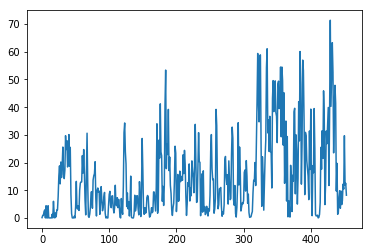

| Reward: 15 | Episode: 454| Epsilon:0.17987581597335128 


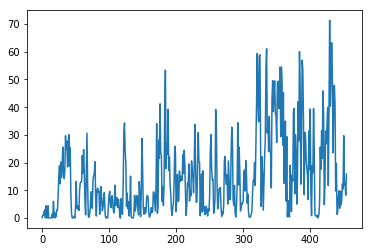

| Reward: 14 | Episode: 455| Epsilon:0.17955951138540063 


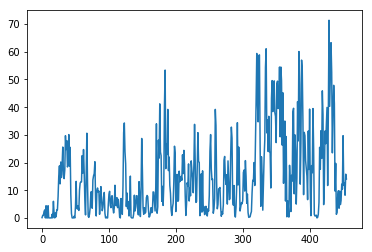

| Reward: 3 | Episode: 456| Epsilon:0.17925810315303756 


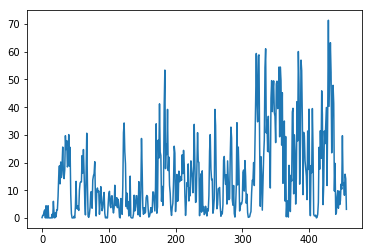

| Reward: 10 | Episode: 457| Epsilon:0.1789715180842596 


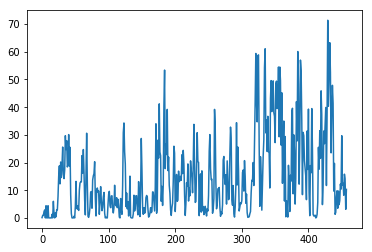

| Reward: 21 | Episode: 458| Epsilon:0.17866395011958922 


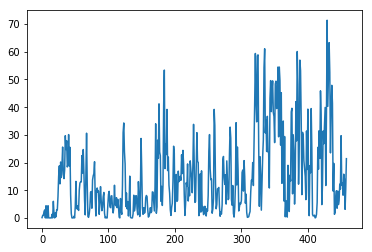

| Reward: 8 | Episode: 459| Epsilon:0.17832124272619918 


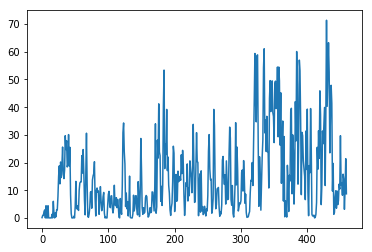

| Reward: 4 | Episode: 460| Epsilon:0.17797563313695786 


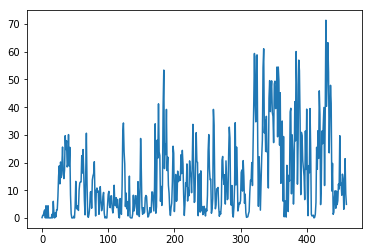

| Reward: 31 | Episode: 461| Epsilon:0.17763246970841473 


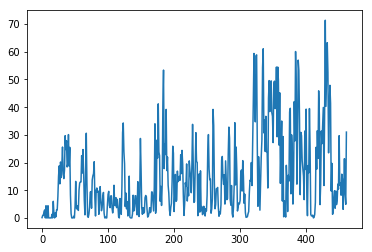

| Reward: 16 | Episode: 462| Epsilon:0.1773059248448298 


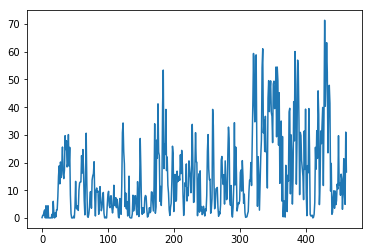

| Reward: 16 | Episode: 463| Epsilon:0.1770047593299833 


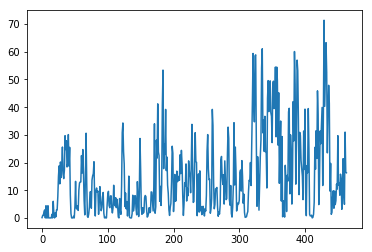

| Reward: 16 | Episode: 464| Epsilon:0.17670410536413012 


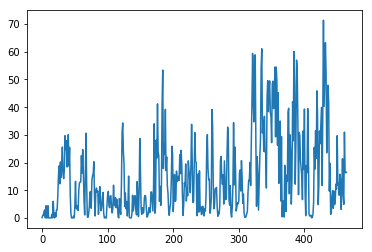

| Reward: 33 | Episode: 465| Epsilon:0.17637044834191332 


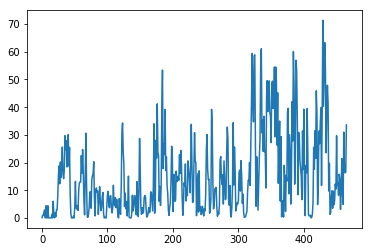

| Reward: 26 | Episode: 466| Epsilon:0.17604974445147611 


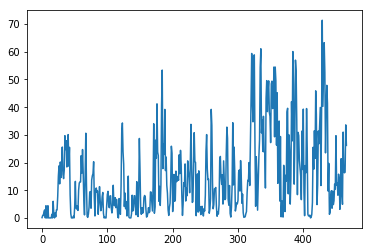

| Reward: 39 | Episode: 467| Epsilon:0.17571908020037327 


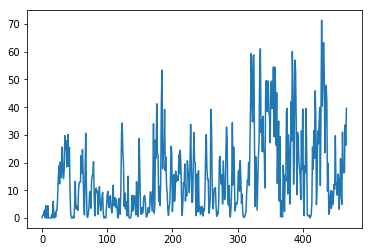

| Reward: 39 | Episode: 468| Epsilon:0.17541710164853758 


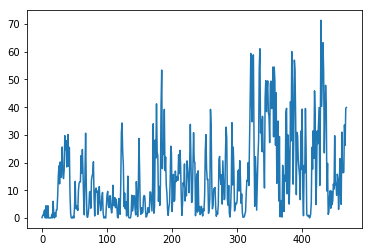

| Reward: 10 | Episode: 469| Epsilon:0.17512264685677414 


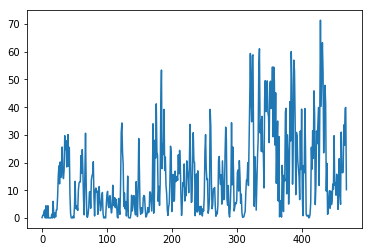

| Reward: 9 | Episode: 470| Epsilon:0.17480595997061843 


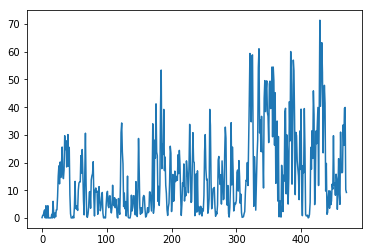

| Reward: 44 | Episode: 471| Epsilon:0.1745334739050245 


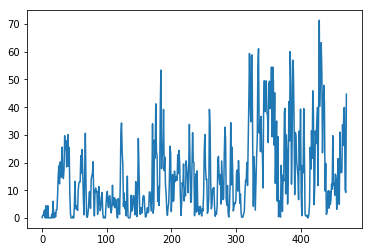

| Reward: 27 | Episode: 472| Epsilon:0.17423701757637947 


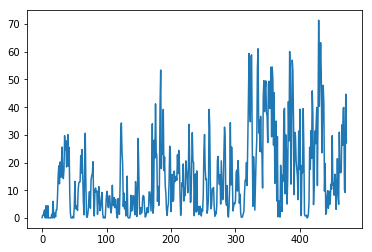

| Reward: 27 | Episode: 473| Epsilon:0.17389062895045254 


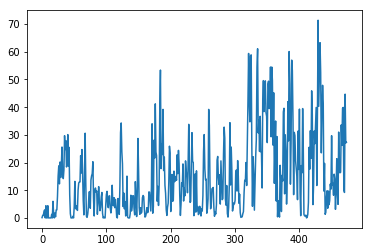

| Reward: 41 | Episode: 474| Epsilon:0.17357617001094686 


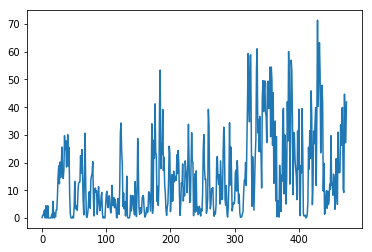

| Reward: 43 | Episode: 475| Epsilon:0.1732882711513982 


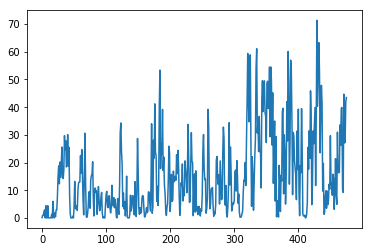

| Reward: 30 | Episode: 476| Epsilon:0.1729956598363002 


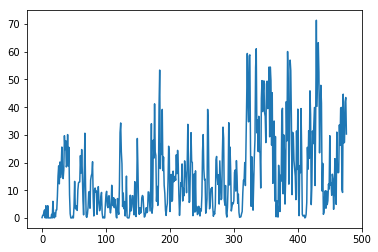

| Reward: 27 | Episode: 477| Epsilon:0.17266209853520462 


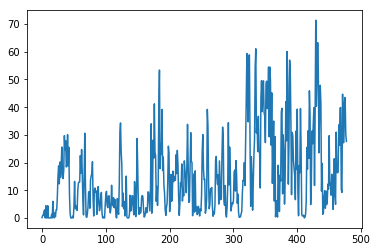

| Reward: 25 | Episode: 478| Epsilon:0.1723653734987821 


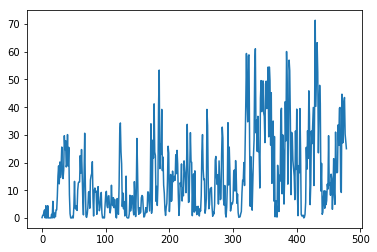

| Reward: 3 | Episode: 479| Epsilon:0.17206743770172173 


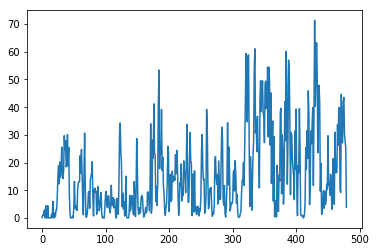

| Reward: 19 | Episode: 480| Epsilon:0.1717614285614975 


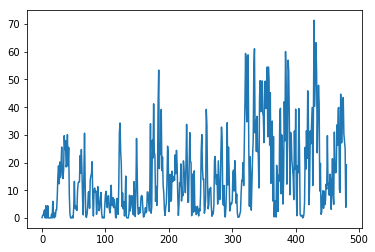

| Reward: 7 | Episode: 481| Epsilon:0.1714885435267514 


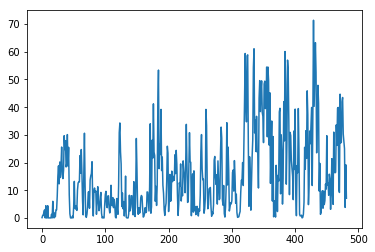

| Reward: 13 | Episode: 482| Epsilon:0.17120410726972424 


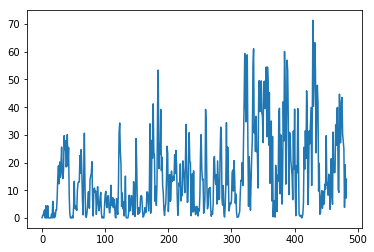

| Reward: 17 | Episode: 483| Epsilon:0.17087400034780573 


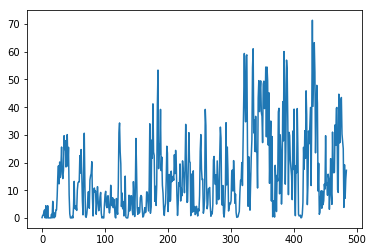

| Reward: 35 | Episode: 484| Epsilon:0.17057523085290519 


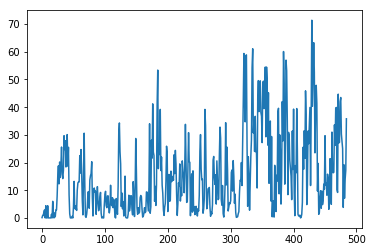

| Reward: 40 | Episode: 485| Epsilon:0.17030423038331252 


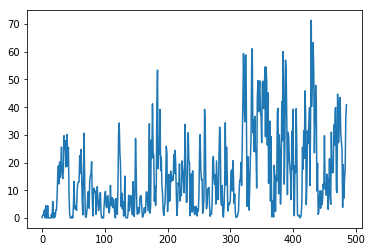

| Reward: 9 | Episode: 486| Epsilon:0.1700574669621543 


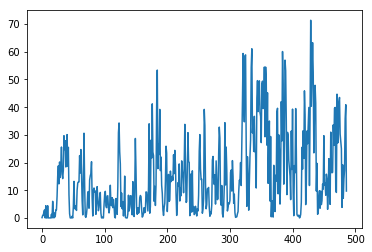

| Reward: 20 | Episode: 487| Epsilon:0.1697652180638358 


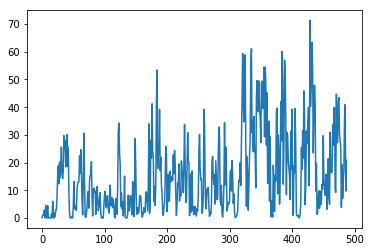

| Reward: 17 | Episode: 488| Epsilon:0.16945991400088856 


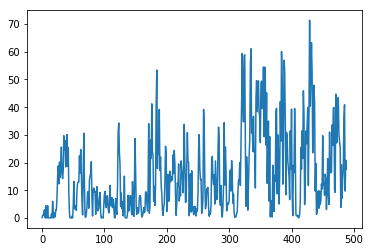

| Reward: 25 | Episode: 489| Epsilon:0.16920422134881935 


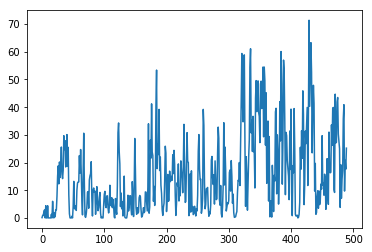

| Reward: 14 | Episode: 490| Epsilon:0.16894215664801515 


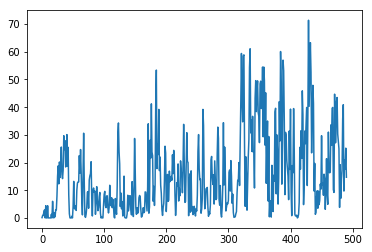

| Reward: 17 | Episode: 491| Epsilon:0.16864170558769845 


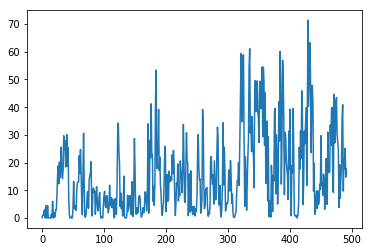

| Reward: 9 | Episode: 492| Epsilon:0.16836030756512418 


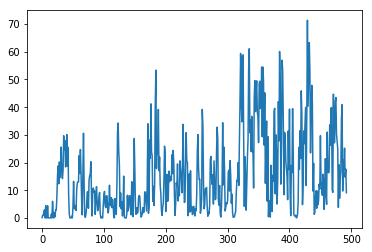

| Reward: 22 | Episode: 493| Epsilon:0.16813653607822895 


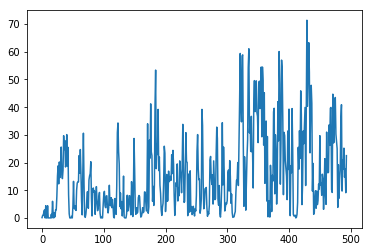

| Reward: 28 | Episode: 494| Epsilon:0.16783919614613796 


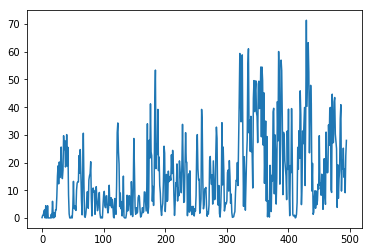

| Reward: 23 | Episode: 495| Epsilon:0.16753735582166146 


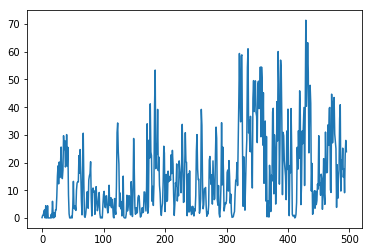

| Reward: 10 | Episode: 496| Epsilon:0.16724776531615038 


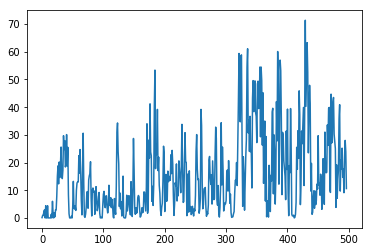

| Reward: 7 | Episode: 497| Epsilon:0.1669486581015188 


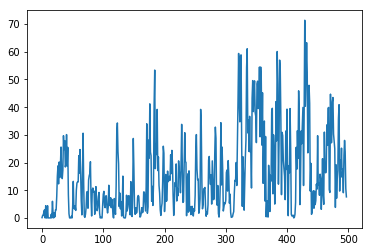

| Reward: 3 | Episode: 498| Epsilon:0.16665175233009802 


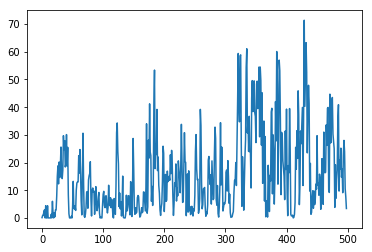

| Reward: 2 | Episode: 499| Epsilon:0.16635870174090803 


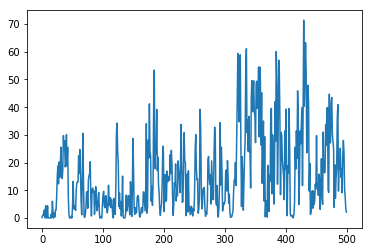

| Reward: 14 | Episode: 500| Epsilon:0.16606616646971886 


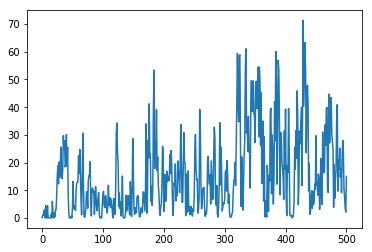

| Reward: 10 | Episode: 501| Epsilon:0.1657890660294797 


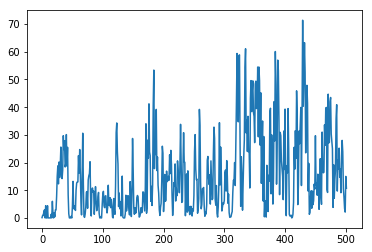

| Reward: 22 | Episode: 502| Epsilon:0.1654991874322862 


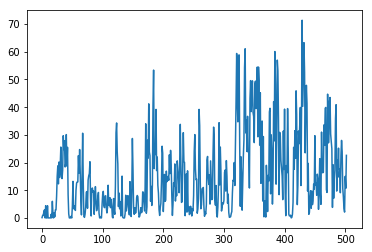

| Reward: 8 | Episode: 503| Epsilon:0.16524286111434888 


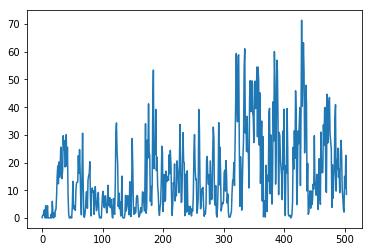

| Reward: 12 | Episode: 504| Epsilon:0.16496383512730464 


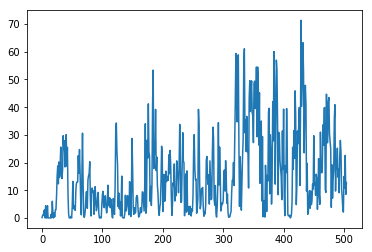

| Reward: 9 | Episode: 505| Epsilon:0.16470339676609608 


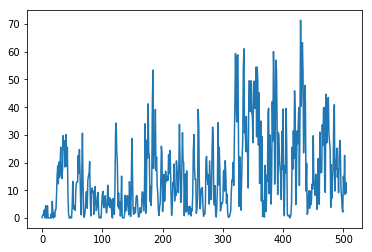

| Reward: 41 | Episode: 506| Epsilon:0.16444172514094862 


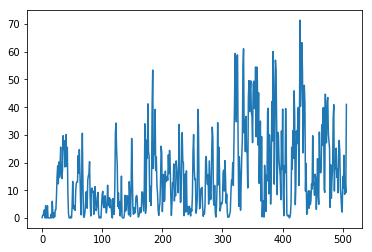

| Reward: 1 | Episode: 507| Epsilon:0.1641755438803482 


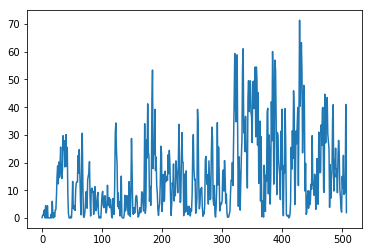

| Reward: 3 | Episode: 508| Epsilon:0.16391635004210053 


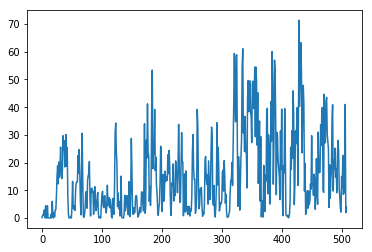

| Reward: 9 | Episode: 509| Epsilon:0.1636461097229028 


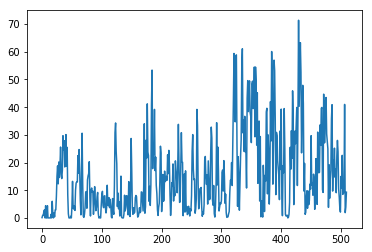

| Reward: 8 | Episode: 510| Epsilon:0.16337141369436 


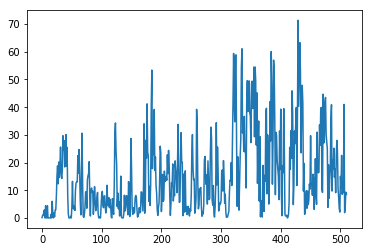

| Reward: 7 | Episode: 511| Epsilon:0.16310859602921426 


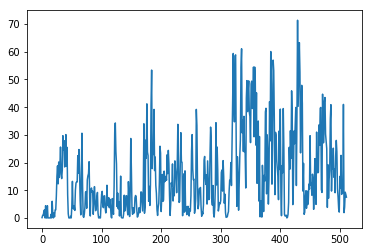

| Reward: 2 | Episode: 512| Epsilon:0.1628559722762357 


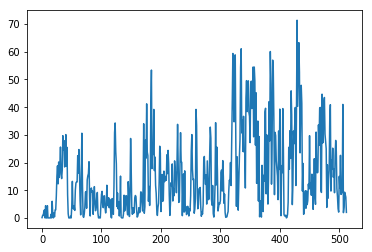

| Reward: 0 | Episode: 513| Epsilon:0.16257284785852788 


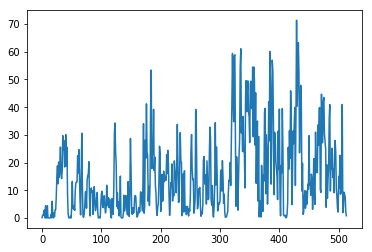

| Reward: 4 | Episode: 514| Epsilon:0.16228210130292667 


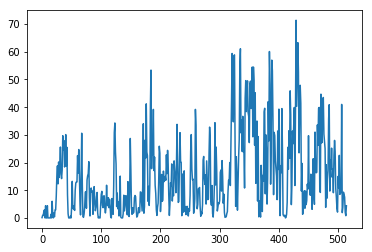

| Reward: 1 | Episode: 515| Epsilon:0.16202751703190546 


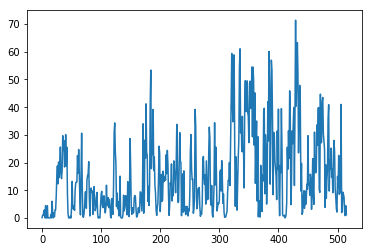

| Reward: 11 | Episode: 516| Epsilon:0.16178951036959036 


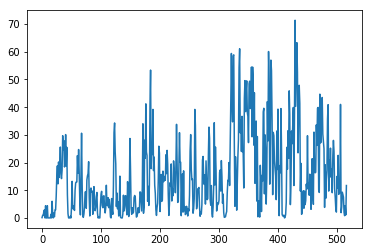

| Reward: 3 | Episode: 517| Epsilon:0.16154377589067145 


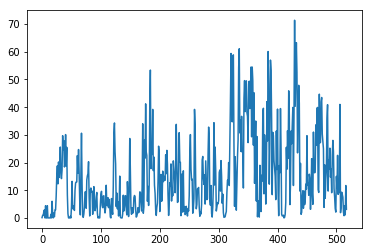

| Reward: 3 | Episode: 518| Epsilon:0.1612742215776597 


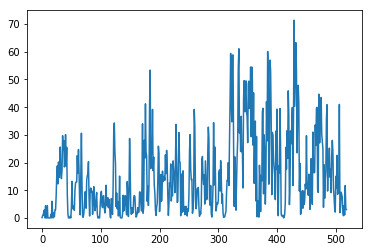

| Reward: 7 | Episode: 519| Epsilon:0.16101155741261716 


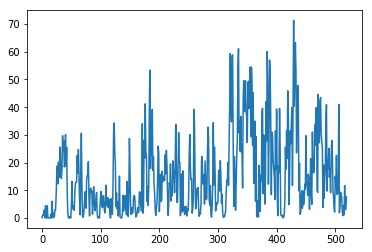

| Reward: 13 | Episode: 520| Epsilon:0.16077182763645795 


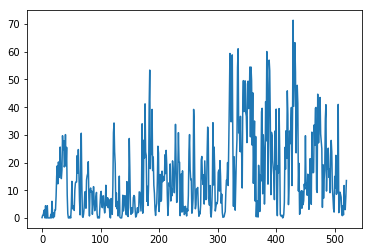

| Reward: 1 | Episode: 521| Epsilon:0.1604907215721101 


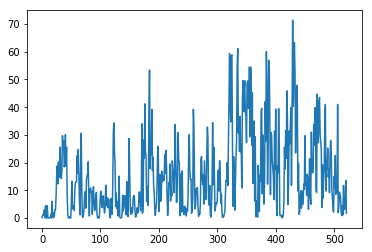

| Reward: 6 | Episode: 522| Epsilon:0.16025817749830673 


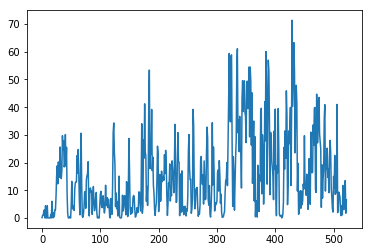

| Reward: 9 | Episode: 523| Epsilon:0.1600051682427588 


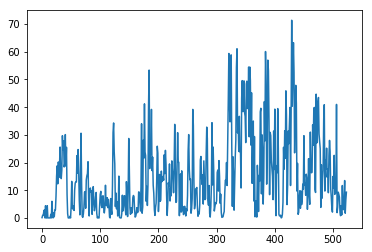

| Reward: 15 | Episode: 524| Epsilon:0.15975255842819025 


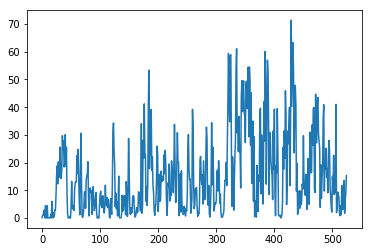

| Reward: 4 | Episode: 525| Epsilon:0.1594748292823066 


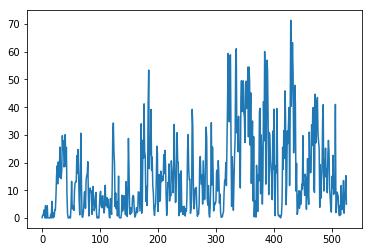

| Reward: 6 | Episode: 526| Epsilon:0.15921031934713406 


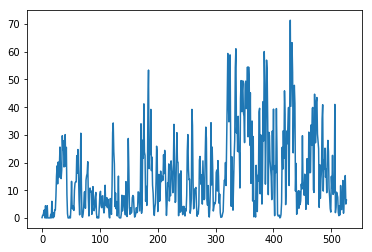

| Reward: 15 | Episode: 527| Epsilon:0.15897486117923187 


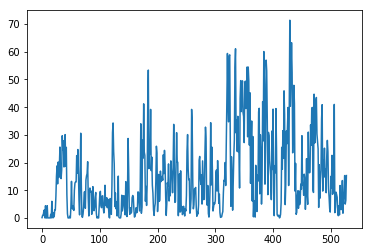

| Reward: 15 | Episode: 528| Epsilon:0.15871118050677818 


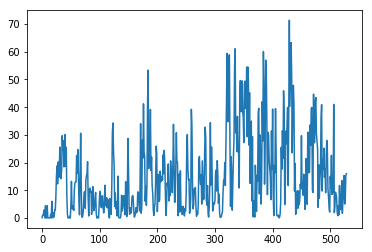

| Reward: 14 | Episode: 529| Epsilon:0.15847329100829796 


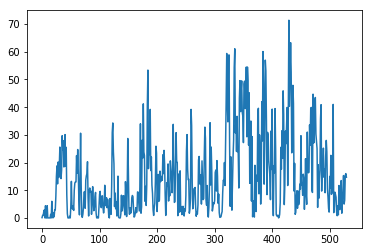

| Reward: 13 | Episode: 530| Epsilon:0.15826899124307767 


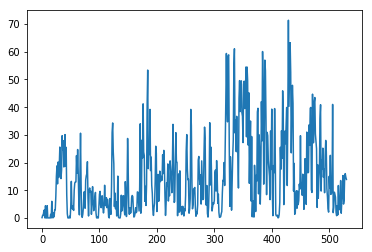

| Reward: 13 | Episode: 531| Epsilon:0.15801754224468328 


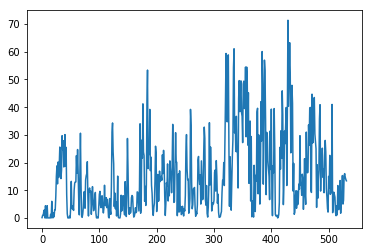

| Reward: 6 | Episode: 532| Epsilon:0.15778858170013582 


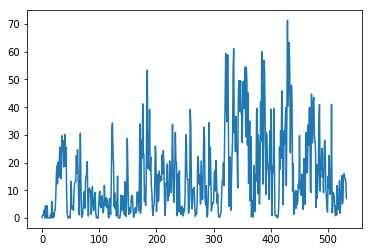

| Reward: 1 | Episode: 533| Epsilon:0.1575378959497879 


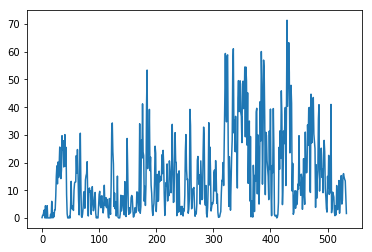

| Reward: 0 | Episode: 534| Epsilon:0.1572907542744178 


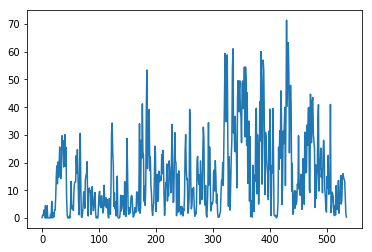

| Reward: 3 | Episode: 535| Epsilon:0.15702515606540357 


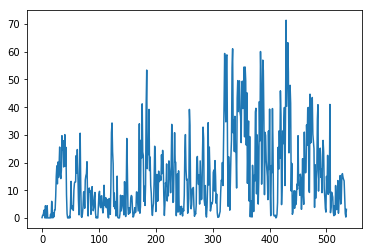

| Reward: 6 | Episode: 536| Epsilon:0.1567678445759915 


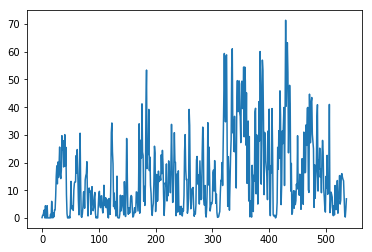

| Reward: 4 | Episode: 537| Epsilon:0.15652347617352214 


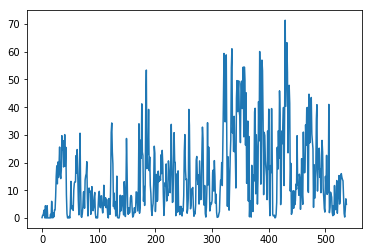

| Reward: 8 | Episode: 538| Epsilon:0.1562716748723142 


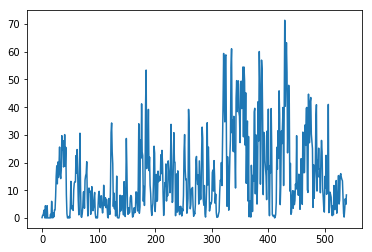

| Reward: 2 | Episode: 539| Epsilon:0.1560265196142221 


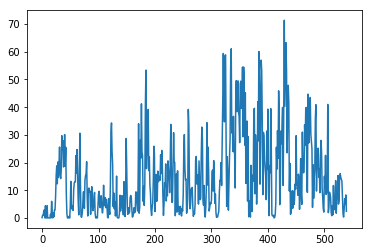

| Reward: 2 | Episode: 540| Epsilon:0.15577084455453316 


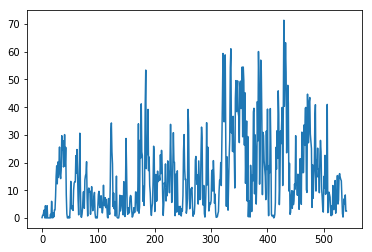

| Reward: 3 | Episode: 541| Epsilon:0.15553114087460707 


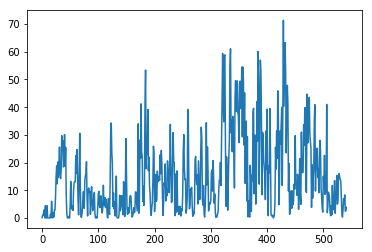

| Reward: 20 | Episode: 542| Epsilon:0.15530888917973248 


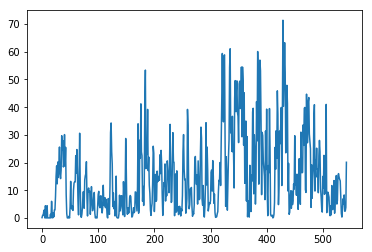

| Reward: 14 | Episode: 543| Epsilon:0.15506679498470935 


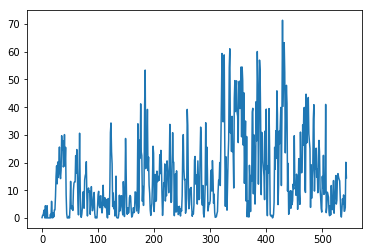

| Reward: 9 | Episode: 544| Epsilon:0.15484985228234224 


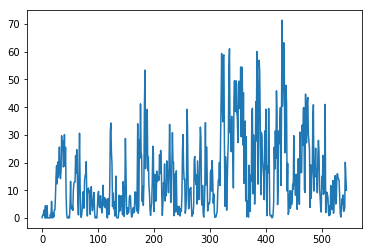

| Reward: 12 | Episode: 545| Epsilon:0.15462548158274741 


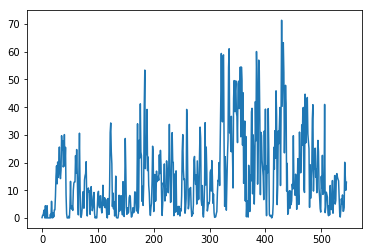

| Reward: 2 | Episode: 546| Epsilon:0.15436747123705435 


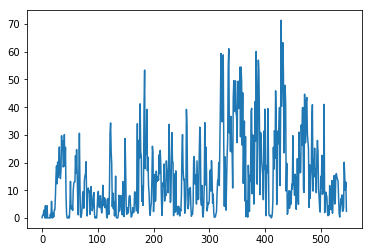

| Reward: 30 | Episode: 547| Epsilon:0.15414842389308195 


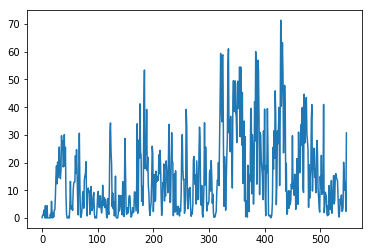

| Reward: 23 | Episode: 548| Epsilon:0.15389890436416534 


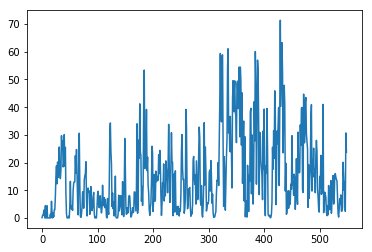

| Reward: 11 | Episode: 549| Epsilon:0.1537051128899757 


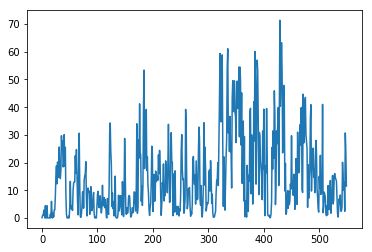

| Reward: 10 | Episode: 550| Epsilon:0.15344250043151497 


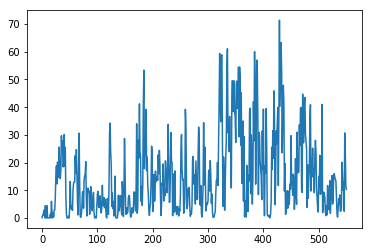

| Reward: 10 | Episode: 551| Epsilon:0.1531925916372662 


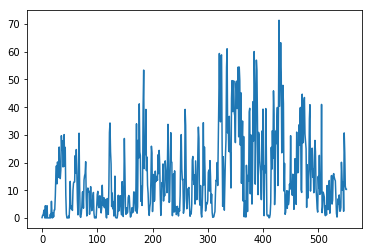

| Reward: 11 | Episode: 552| Epsilon:0.15294308986457447 


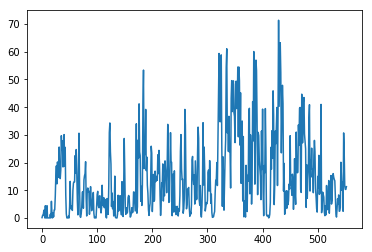

| Reward: 17 | Episode: 553| Epsilon:0.15270162937930049 


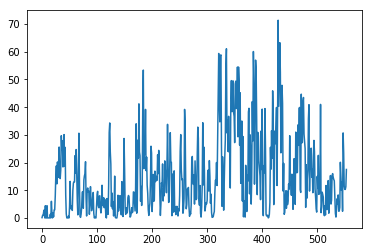

| Reward: 24 | Episode: 554| Epsilon:0.15244225584245932 


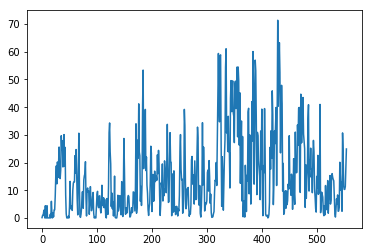

| Reward: 21 | Episode: 555| Epsilon:0.15224420867817598 


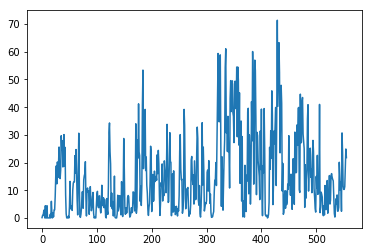

| Reward: 22 | Episode: 556| Epsilon:0.15200841176555538 


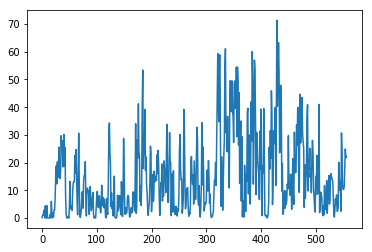

| Reward: 13 | Episode: 557| Epsilon:0.1517729800568693 


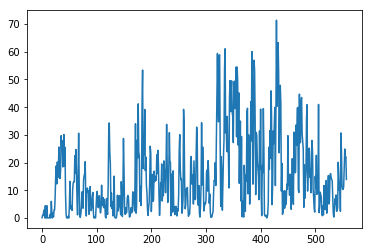

| Reward: 16 | Episode: 558| Epsilon:0.1515136687387794 


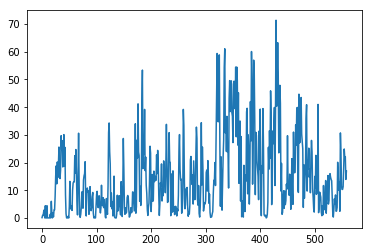

| Reward: 36 | Episode: 559| Epsilon:0.15128505460302347 


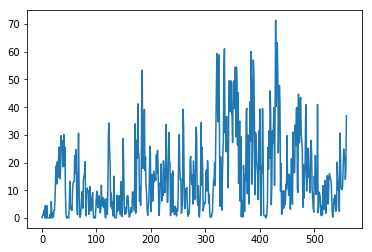

| Reward: 19 | Episode: 560| Epsilon:0.15107038120630345 


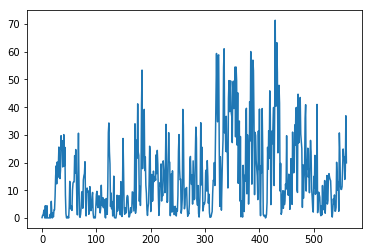

| Reward: 6 | Episode: 561| Epsilon:0.1508635554579082 


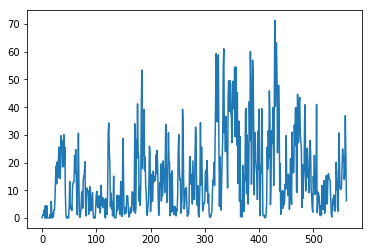

| Reward: 2 | Episode: 562| Epsilon:0.150625378059091 


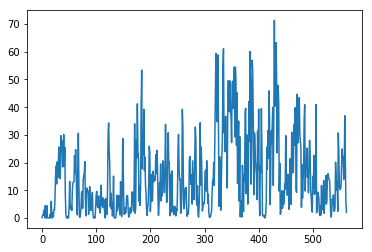

| Reward: 2 | Episode: 563| Epsilon:0.1503890805761118 


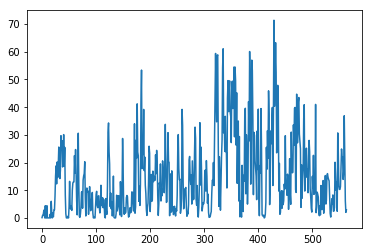

| Reward: 2 | Episode: 564| Epsilon:0.15018168574329024 


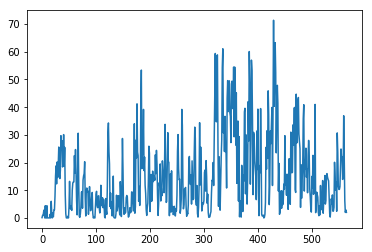

| Reward: 0 | Episode: 565| Epsilon:0.14995808054075072 


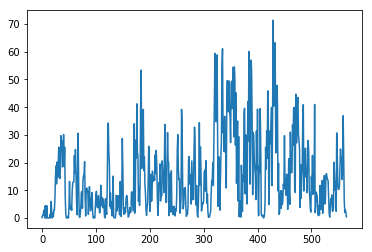

| Reward: 7 | Episode: 566| Epsilon:0.14971234961444466 


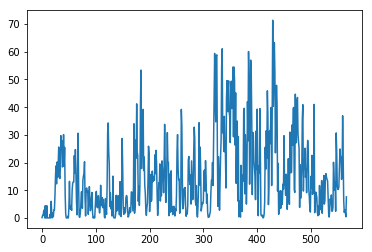

| Reward: 26 | Episode: 567| Epsilon:0.14949841288602922 


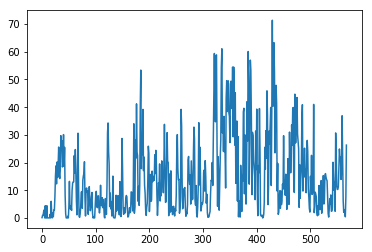

| Reward: 15 | Episode: 568| Epsilon:0.149313148815192 


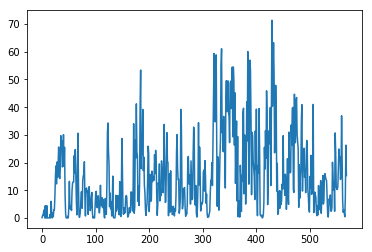

| Reward: 14 | Episode: 569| Epsilon:0.14910723775158302 


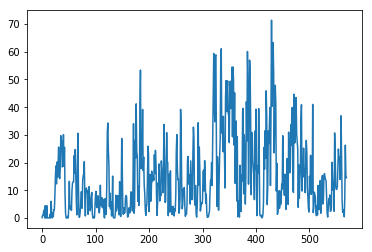

| Reward: 36 | Episode: 570| Epsilon:0.14888523229244513 


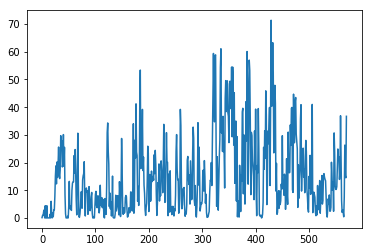

| Reward: 16 | Episode: 571| Epsilon:0.14868585869444828 


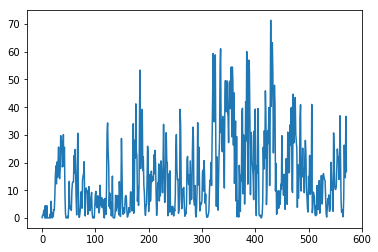

| Reward: 20 | Episode: 572| Epsilon:0.14846151135095467 


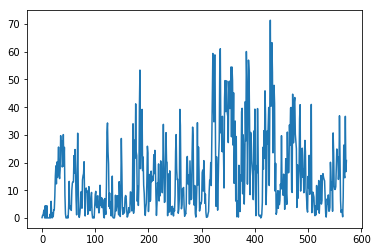

| Reward: 13 | Episode: 573| Epsilon:0.1482197149960351 


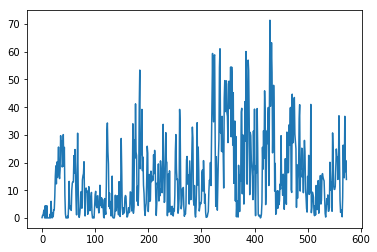

| Reward: 8 | Episode: 574| Epsilon:0.14799015124783735 


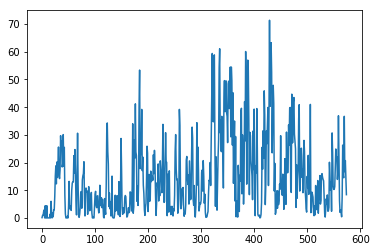

| Reward: 1 | Episode: 575| Epsilon:0.14776833131840364 


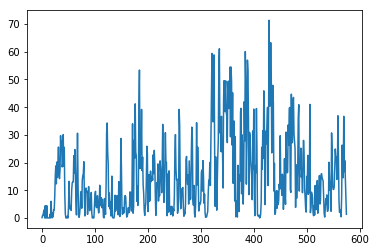

| Reward: 13 | Episode: 576| Epsilon:0.14755422143462146 


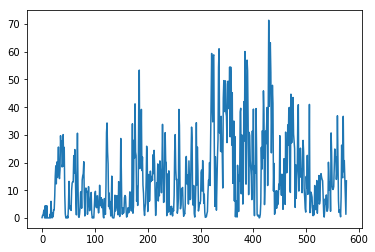

| Reward: 10 | Episode: 577| Epsilon:0.147334528258279 


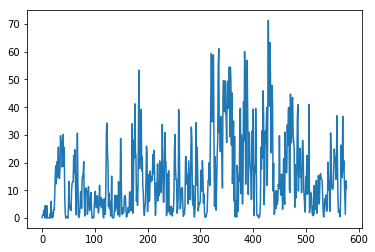

| Reward: 12 | Episode: 578| Epsilon:0.14711663334898759 


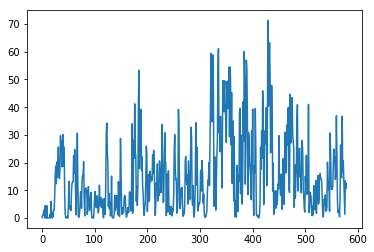

| Reward: 17 | Episode: 579| Epsilon:0.1469210973092425 


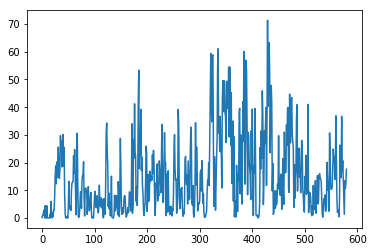

| Reward: 32 | Episode: 580| Epsilon:0.14672141943024675 


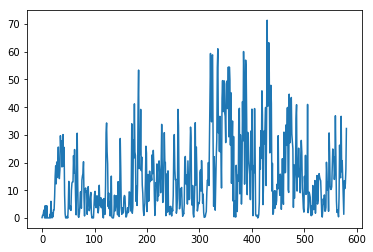

| Reward: 15 | Episode: 581| Epsilon:0.14649564120928382 


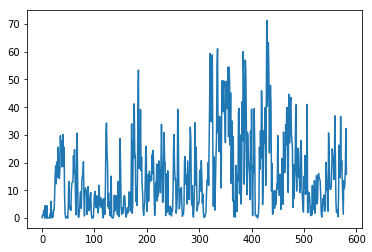

| Reward: 13 | Episode: 582| Epsilon:0.14627606137561663 


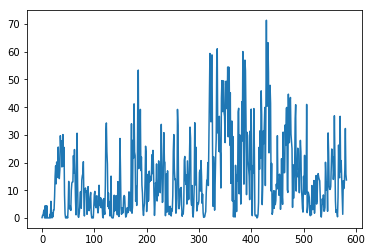

| Reward: 58 | Episode: 583| Epsilon:0.14606703505215843 


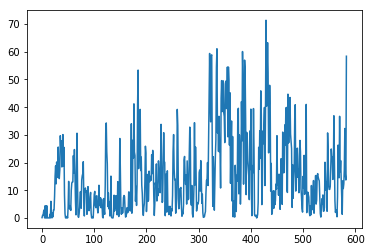

| Reward: 38 | Episode: 584| Epsilon:0.1458437222498205 


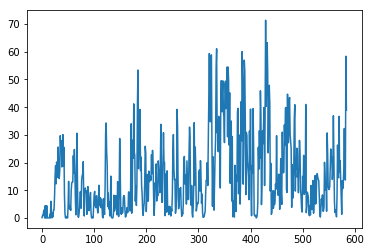

| Reward: 40 | Episode: 585| Epsilon:0.14560182129472157 


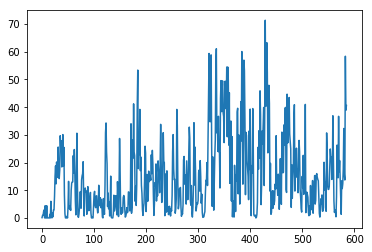

| Reward: 21 | Episode: 586| Epsilon:0.1453443327281916 


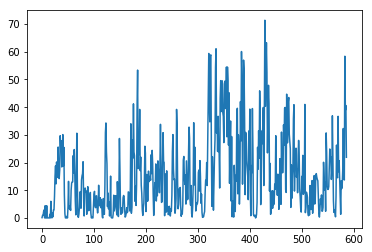

| Reward: 5 | Episode: 587| Epsilon:0.14510616218489159 


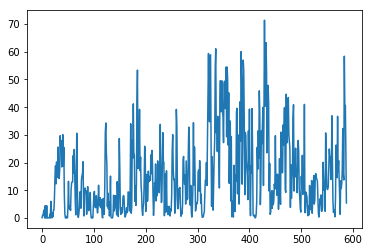

| Reward: 8 | Episode: 588| Epsilon:0.1449031546812051 


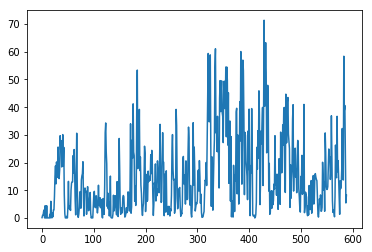

| Reward: 5 | Episode: 589| Epsilon:0.14469174938176463 


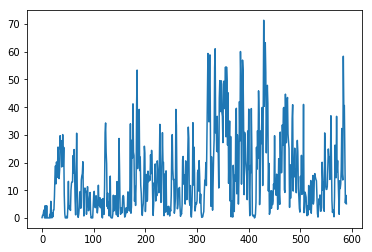

| Reward: 3 | Episode: 590| Epsilon:0.14449221148274458 


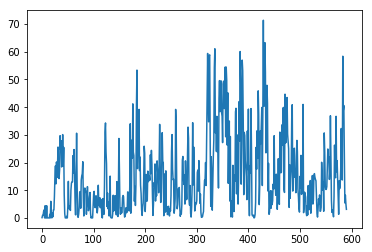

| Reward: 1 | Episode: 591| Epsilon:0.14428862001231257 


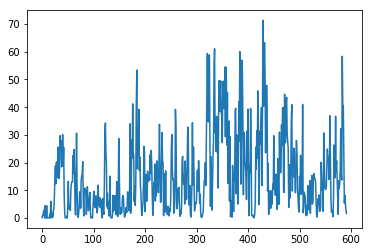

| Reward: 4 | Episode: 592| Epsilon:0.144072348245311 


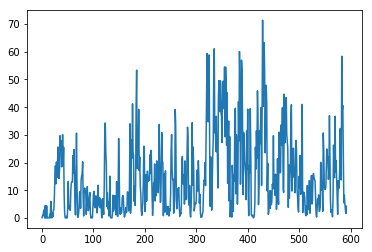

| Reward: 4 | Episode: 593| Epsilon:0.14386215504428043 


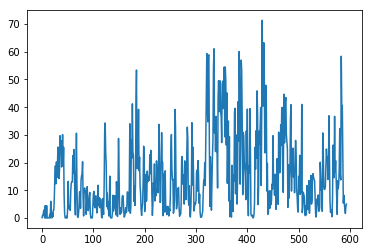

| Reward: 9 | Episode: 594| Epsilon:0.1436508319802555 


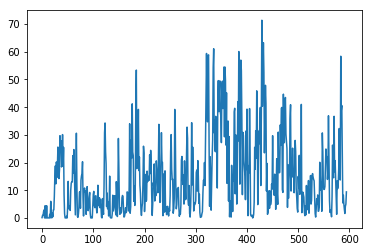

| Reward: 6 | Episode: 595| Epsilon:0.1434498605234703 


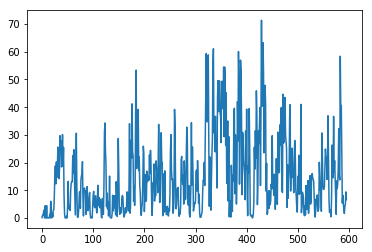

| Reward: 4 | Episode: 596| Epsilon:0.14321479438380133 


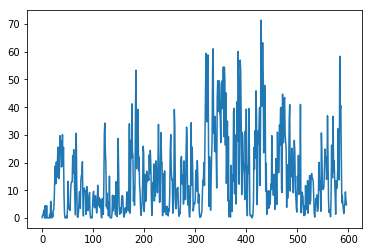

| Reward: 4 | Episode: 597| Epsilon:0.1430072823769471 


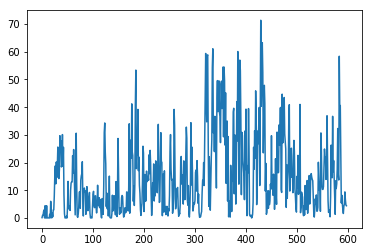

| Reward: 2 | Episode: 598| Epsilon:0.14280149906095396 


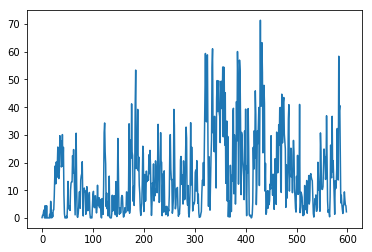

| Reward: 3 | Episode: 599| Epsilon:0.14259458590104304 


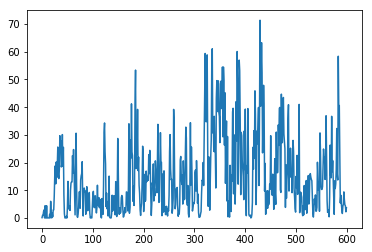

| Reward: 7 | Episode: 600| Epsilon:0.14241360481935494 


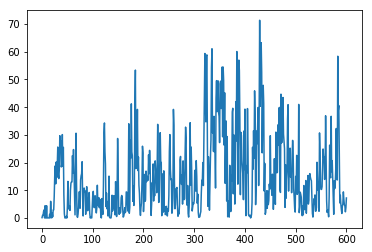

| Reward: 1 | Episode: 601| Epsilon:0.14222289743784133 


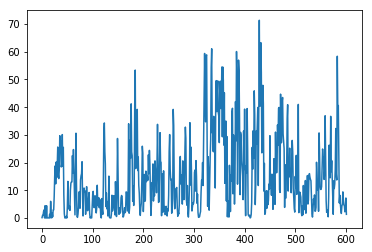

| Reward: 5 | Episode: 602| Epsilon:0.14201114205881535 


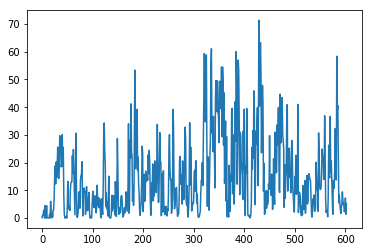

| Reward: 5 | Episode: 603| Epsilon:0.14178977628057435 


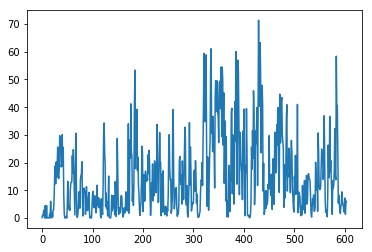

| Reward: 3 | Episode: 604| Epsilon:0.14158999257770943 


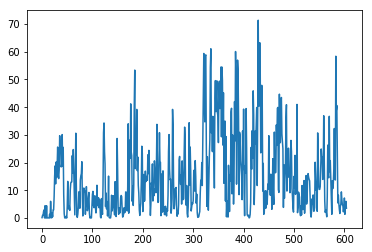

| Reward: 3 | Episode: 605| Epsilon:0.14138342098964055 


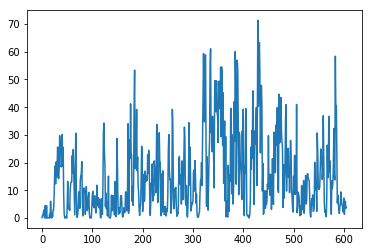

| Reward: 22 | Episode: 606| Epsilon:0.14119832904437743 


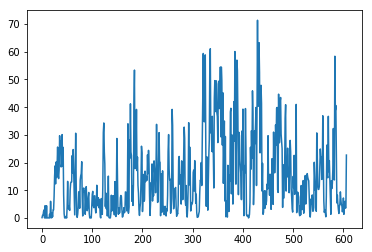

| Reward: 19 | Episode: 607| Epsilon:0.14100078870651453 


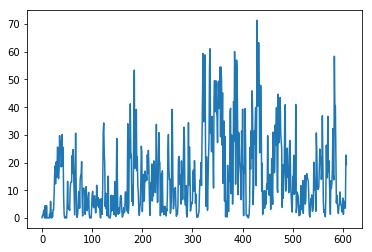

| Reward: 28 | Episode: 608| Epsilon:0.14079789267649853 


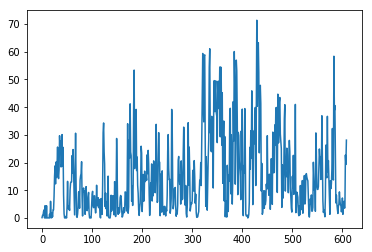

| Reward: 4 | Episode: 609| Epsilon:0.1406065367372113 


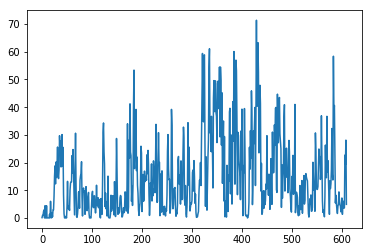

| Reward: 28 | Episode: 610| Epsilon:0.1403985919402222 


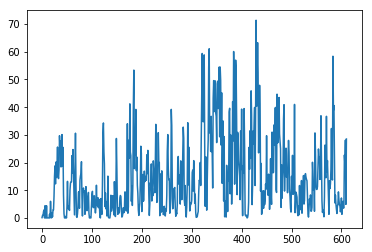

| Reward: 10 | Episode: 611| Epsilon:0.14020637660575494 


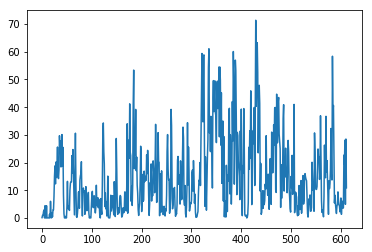

| Reward: 6 | Episode: 612| Epsilon:0.14000042361491424 


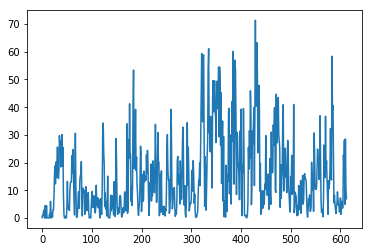

| Reward: 4 | Episode: 613| Epsilon:0.13980875340028595 


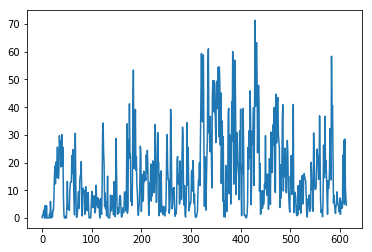

| Reward: 28 | Episode: 614| Epsilon:0.139614553262422 


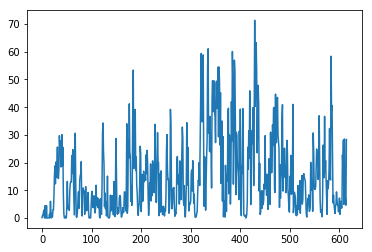

| Reward: 5 | Episode: 615| Epsilon:0.13941086372575434 


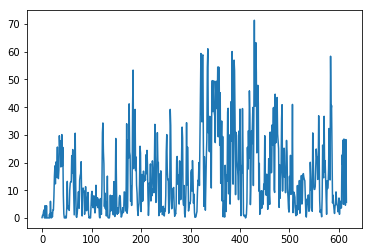

| Reward: 28 | Episode: 616| Epsilon:0.13921025555149838 


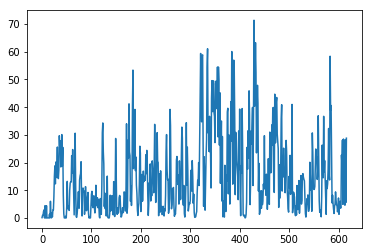

| Reward: 20 | Episode: 617| Epsilon:0.1390154965830193 


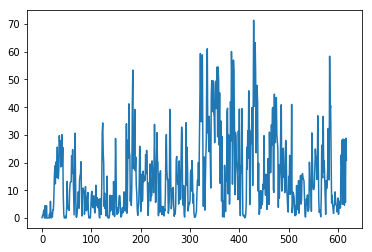

| Reward: 6 | Episode: 618| Epsilon:0.13879741240383944 


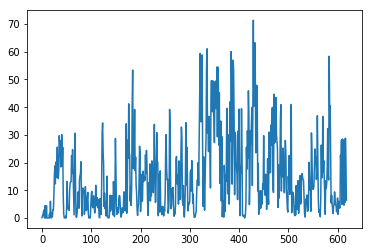

| Reward: 12 | Episode: 619| Epsilon:0.1385782845531894 


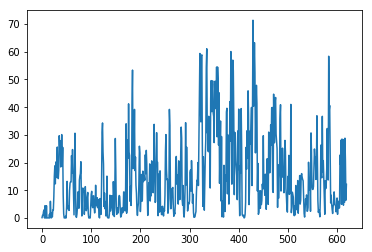

| Reward: 26 | Episode: 620| Epsilon:0.13837472311140445 


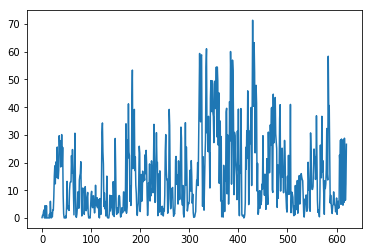

| Reward: 16 | Episode: 621| Epsilon:0.1382046259826705 


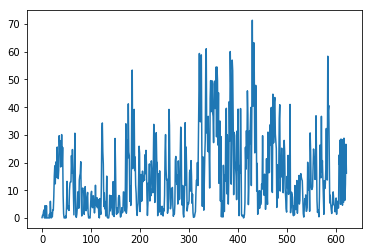

| Reward: 13 | Episode: 622| Epsilon:0.13803059694510433 


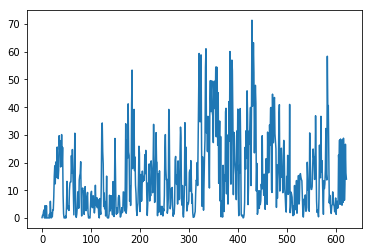

| Reward: 22 | Episode: 623| Epsilon:0.13783335326809498 


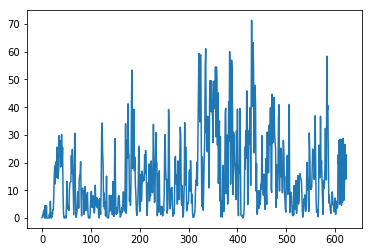

| Reward: 47 | Episode: 624| Epsilon:0.137640520623703 


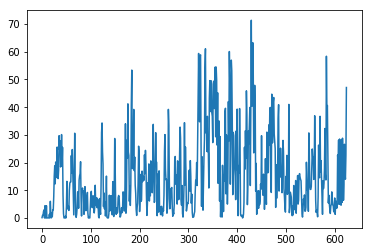

| Reward: 14 | Episode: 625| Epsilon:0.13745757949938198 


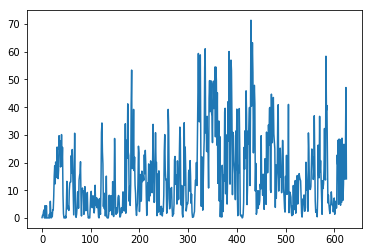

| Reward: 27 | Episode: 626| Epsilon:0.13726389992008076 


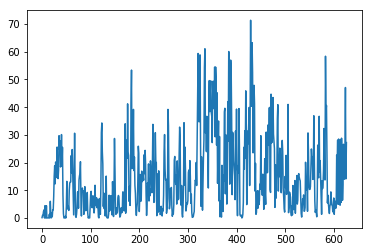

| Reward: 2 | Episode: 627| Epsilon:0.13707597619471565 


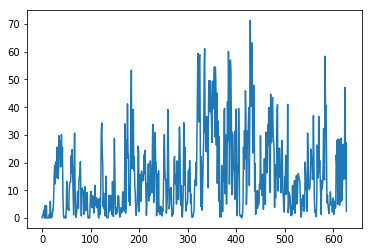

| Reward: 22 | Episode: 628| Epsilon:0.1369280133149476 


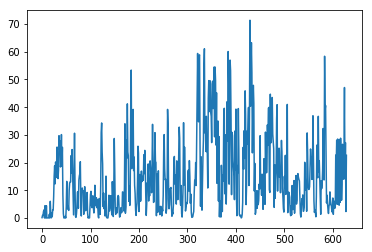

| Reward: 44 | Episode: 629| Epsilon:0.1367487541615897 


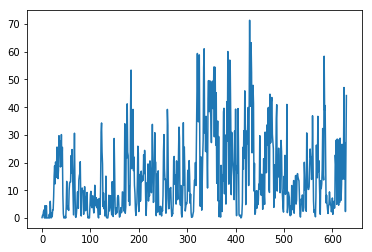

| Reward: 50 | Episode: 630| Epsilon:0.1365697296851491 


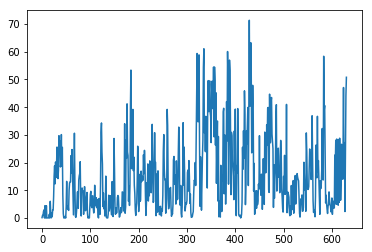

| Reward: 45 | Episode: 631| Epsilon:0.13638275632660785 


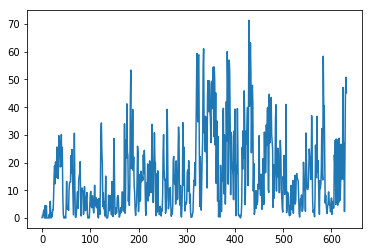

| Reward: 59 | Episode: 632| Epsilon:0.1362042109958182 


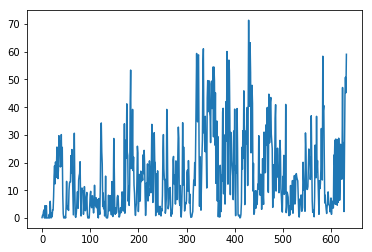

| Reward: 76 | Episode: 633| Epsilon:0.13603542160128795 


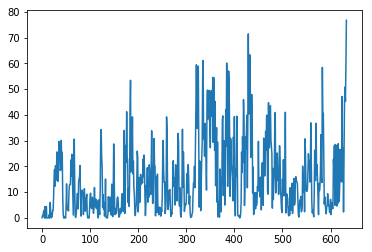

| Reward: 33 | Episode: 634| Epsilon:0.13585461385032577 


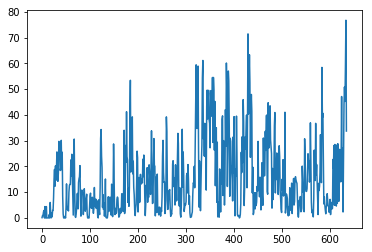

| Reward: 27 | Episode: 635| Epsilon:0.13563606281006715 


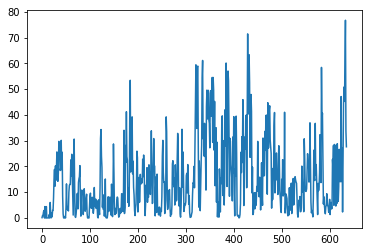

| Reward: 14 | Episode: 636| Epsilon:0.13545984961074375 


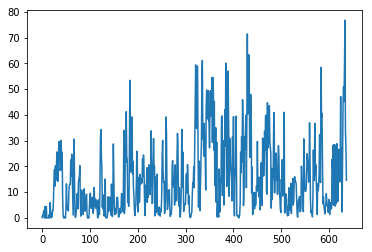

| Reward: 11 | Episode: 637| Epsilon:0.1352716902800176 


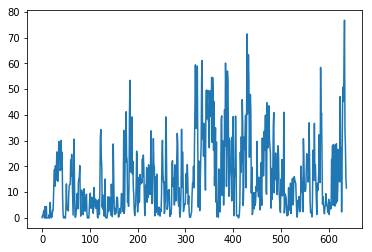

| Reward: 12 | Episode: 638| Epsilon:0.13507028453901 


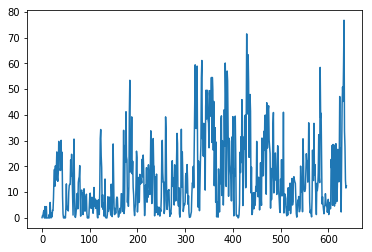

| Reward: 19 | Episode: 639| Epsilon:0.13486513263569583 


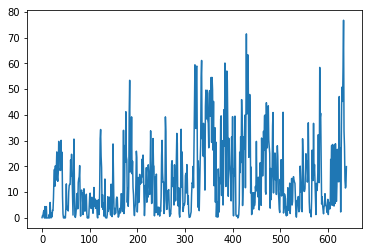

| Reward: 63 | Episode: 640| Epsilon:0.1346872272144989 


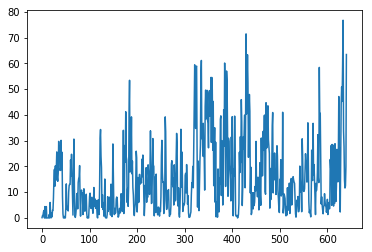

| Reward: 23 | Episode: 641| Epsilon:0.1345041761731539 


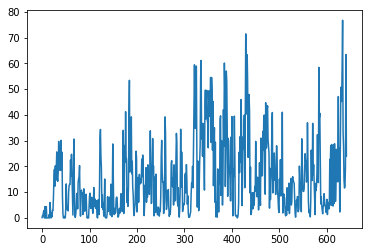

| Reward: 6 | Episode: 642| Epsilon:0.13429316924530785 


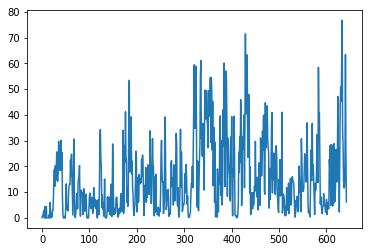

| Reward: 26 | Episode: 643| Epsilon:0.13410260732315477 


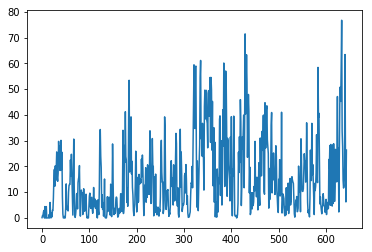

| Reward: 10 | Episode: 644| Epsilon:0.13393910108377505 


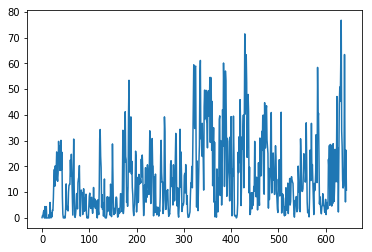

| Reward: 41 | Episode: 645| Epsilon:0.1337557292368265 


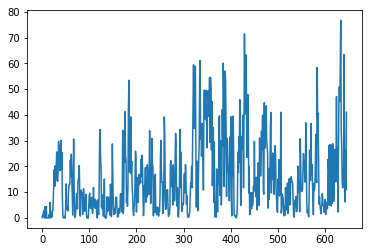

| Reward: 48 | Episode: 646| Epsilon:0.13358329472810831 


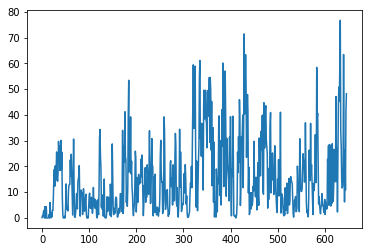

| Reward: 50 | Episode: 647| Epsilon:0.13338840444787708 


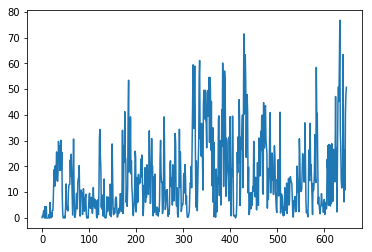

| Reward: 20 | Episode: 648| Epsilon:0.1332364275502124 


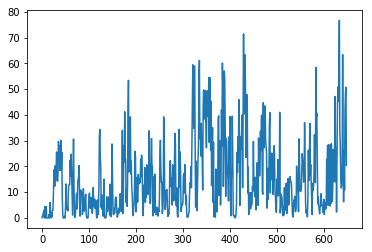

| Reward: 10 | Episode: 649| Epsilon:0.13307530816416563 


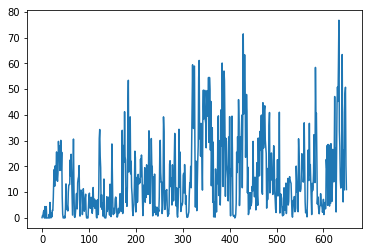

| Reward: 11 | Episode: 650| Epsilon:0.132907738029382 


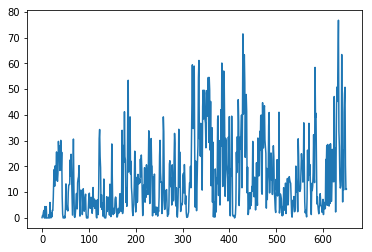

| Reward: 14 | Episode: 651| Epsilon:0.1327576363583162 


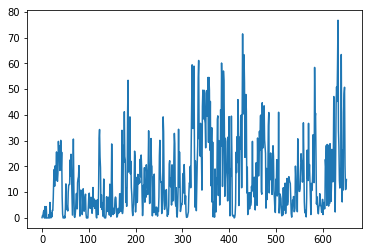

| Reward: 2 | Episode: 652| Epsilon:0.13256129940000774 


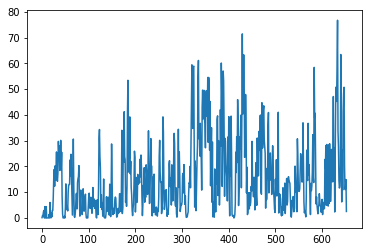

| Reward: 3 | Episode: 653| Epsilon:0.1323811376697601 


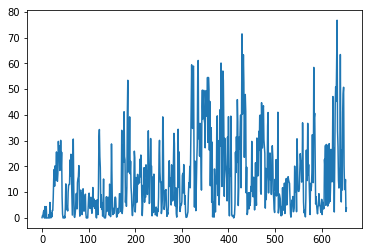

| Reward: 11 | Episode: 654| Epsilon:0.13220650897518643 


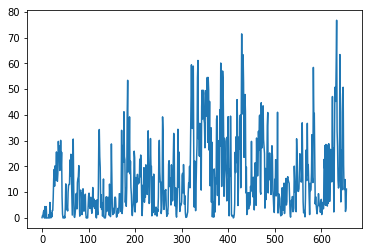

| Reward: 23 | Episode: 655| Epsilon:0.13200438666883557 


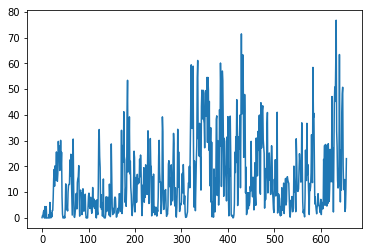

| Reward: 52 | Episode: 656| Epsilon:0.13185266812045912 


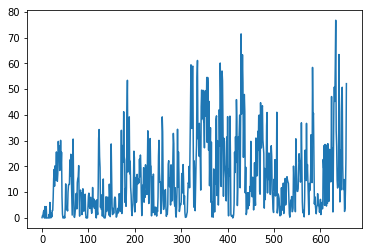

| Reward: 25 | Episode: 657| Epsilon:0.13166030272408552 


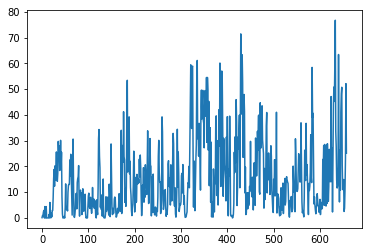

| Reward: 16 | Episode: 658| Epsilon:0.13148399518932685 


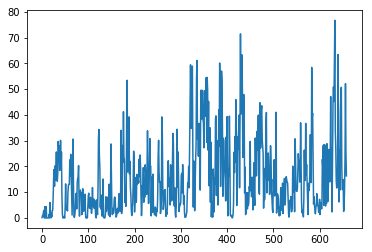

| Reward: 32 | Episode: 659| Epsilon:0.13131054994749425 


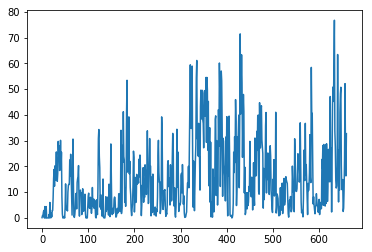

| Reward: 15 | Episode: 660| Epsilon:0.13113077676794588 


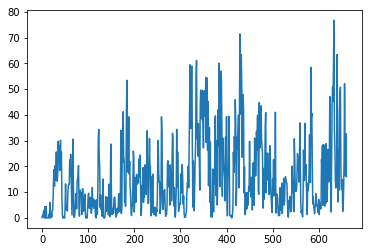

| Reward: 9 | Episode: 661| Epsilon:0.13092637121194653 


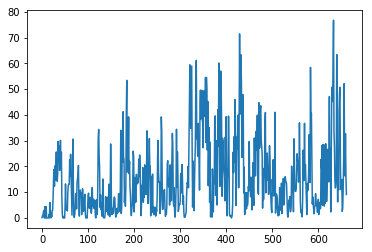

| Reward: 14 | Episode: 662| Epsilon:0.1307471239995259 


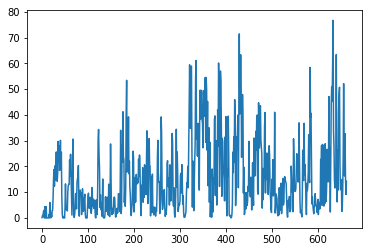

| Reward: 3 | Episode: 663| Epsilon:0.13056028829739294 


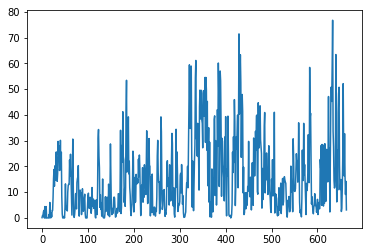

| Reward: 3 | Episode: 664| Epsilon:0.1304284883174063 


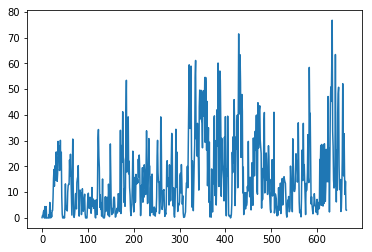

| Reward: 4 | Episode: 665| Epsilon:0.1302733699544477 


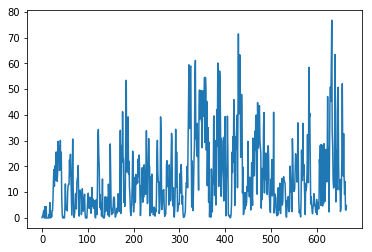

| Reward: 5 | Episode: 666| Epsilon:0.13009761868505126 


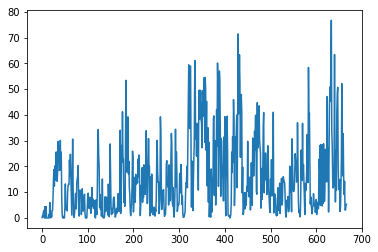

| Reward: 17 | Episode: 667| Epsilon:0.1298935246589781 


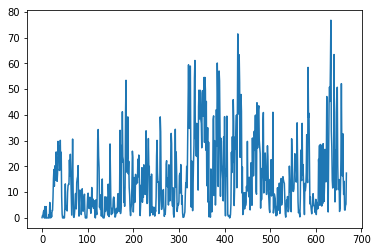

| Reward: 0 | Episode: 668| Epsilon:0.129705314592446 


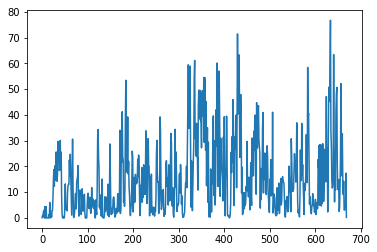

| Reward: 3 | Episode: 669| Epsilon:0.12954069257690956 


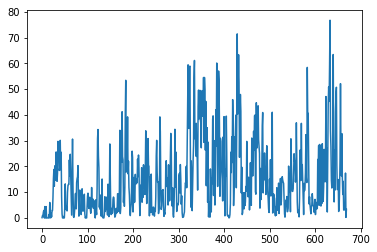

| Reward: 12 | Episode: 670| Epsilon:0.12939309959339146 


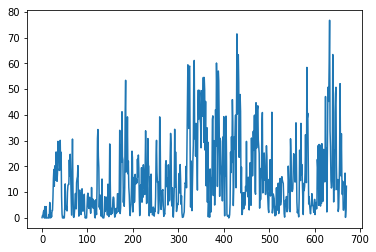

| Reward: 8 | Episode: 671| Epsilon:0.12922887384120454 


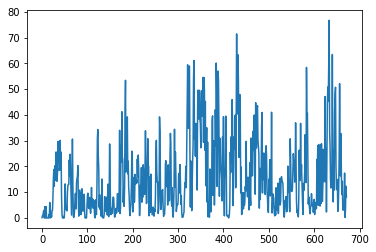

| Reward: 4 | Episode: 672| Epsilon:0.1290958359622276 


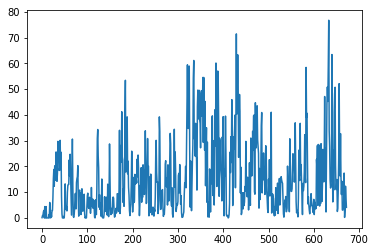

| Reward: 0 | Episode: 673| Epsilon:0.1289435919562004 


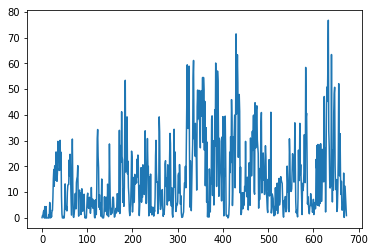

| Reward: 12 | Episode: 674| Epsilon:0.12874517065609653 


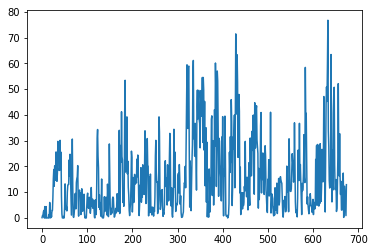

| Reward: 41 | Episode: 675| Epsilon:0.1285663382920088 


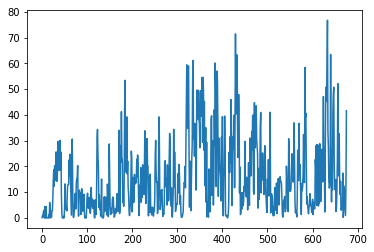

| Reward: 26 | Episode: 676| Epsilon:0.12840829812033866 


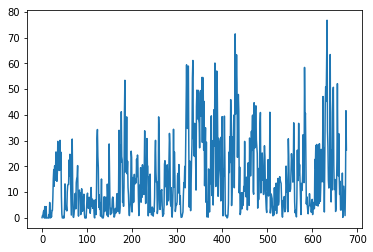

| Reward: 44 | Episode: 677| Epsilon:0.1282401925424666 


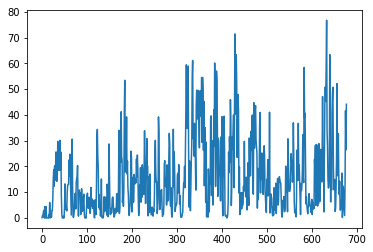

| Reward: 44 | Episode: 678| Epsilon:0.1280863958389095 


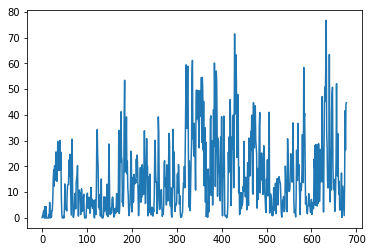

| Reward: 38 | Episode: 679| Epsilon:0.12794173923470215 


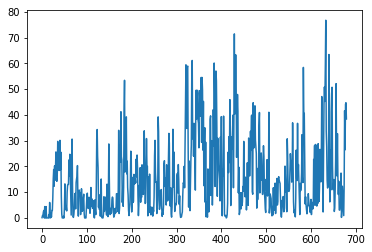

| Reward: 12 | Episode: 680| Epsilon:0.12778702257909774 


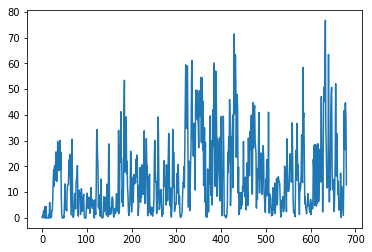

| Reward: 51 | Episode: 681| Epsilon:0.12759931271790634 


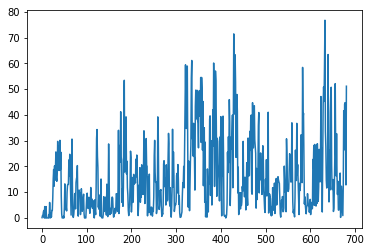

| Reward: 1 | Episode: 682| Epsilon:0.1274462846127305 


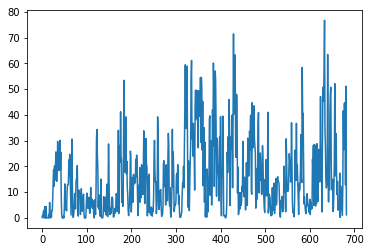

| Reward: 1 | Episode: 683| Epsilon:0.12731126245031843 


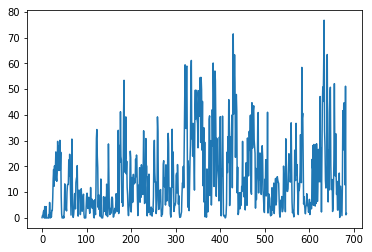

| Reward: 3 | Episode: 684| Epsilon:0.12715095047582378 


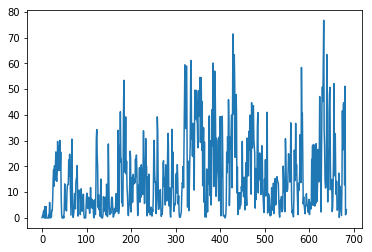

| Reward: 3 | Episode: 685| Epsilon:0.12699338022312856 


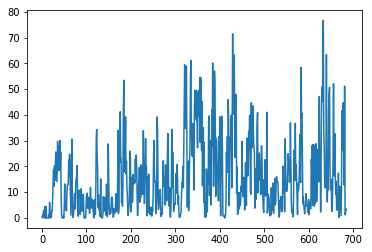

| Reward: 4 | Episode: 686| Epsilon:0.1268233222076556 


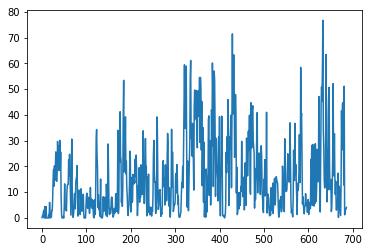

| Reward: 1 | Episode: 687| Epsilon:0.12663322887951545 


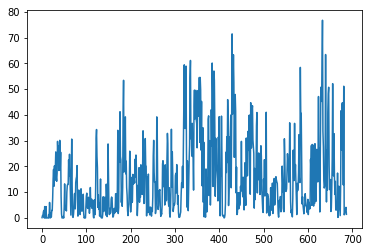

| Reward: 32 | Episode: 688| Epsilon:0.12646997651841063 


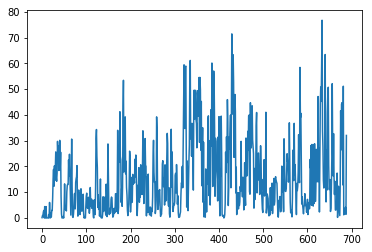

| Reward: 29 | Episode: 689| Epsilon:0.12631198702182145 


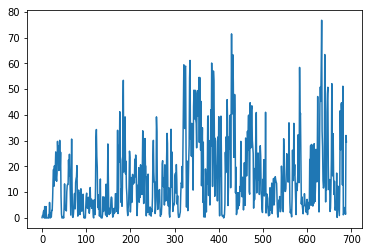

| Reward: 25 | Episode: 690| Epsilon:0.12615671801145598 


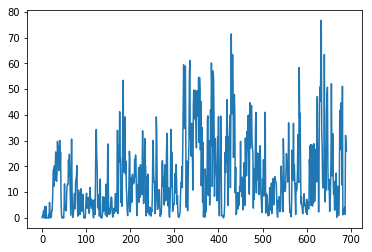

| Reward: 9 | Episode: 691| Epsilon:0.12602054162360699 


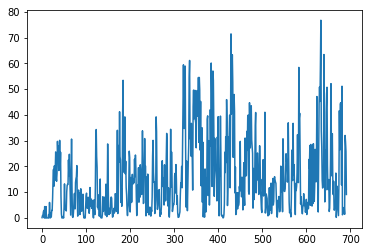

| Reward: 45 | Episode: 692| Epsilon:0.1258517863453422 


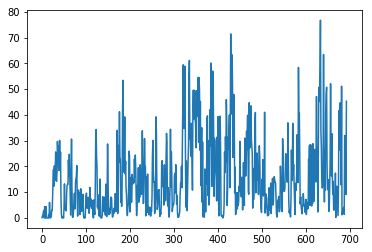

| Reward: 34 | Episode: 693| Epsilon:0.1257159391075653 


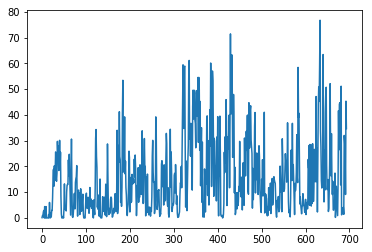

| Reward: 63 | Episode: 694| Epsilon:0.1255639140548245 


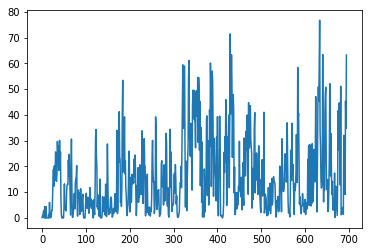

| Reward: 81 | Episode: 695| Epsilon:0.1254158352795049 


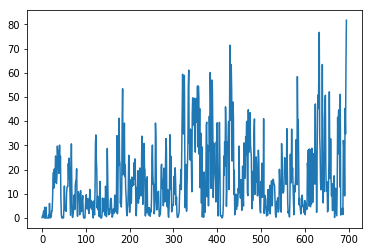

| Reward: 32 | Episode: 696| Epsilon:0.12526793113496099 


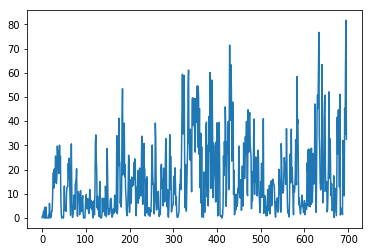

| Reward: 11 | Episode: 697| Epsilon:0.12509017601997363 


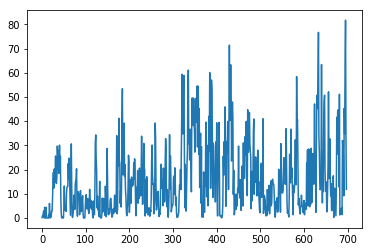

| Reward: 5 | Episode: 698| Epsilon:0.1249501527503826 


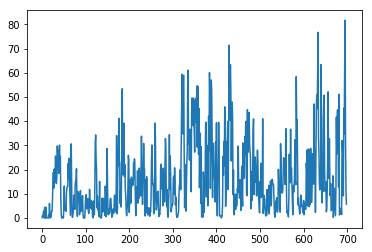

| Reward: 2 | Episode: 699| Epsilon:0.12478532653385621 


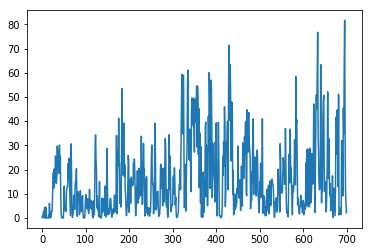

| Reward: 4 | Episode: 700| Epsilon:0.1246406587552713 


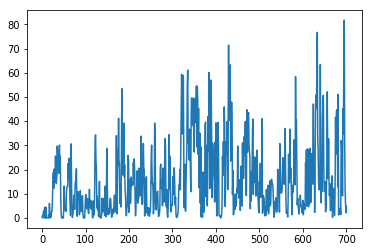

| Reward: 19 | Episode: 701| Epsilon:0.12449242384744058 


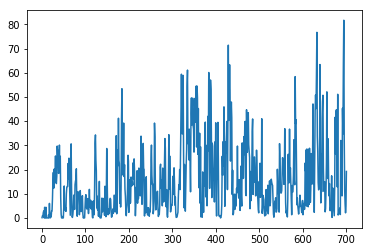

| Reward: 5 | Episode: 702| Epsilon:0.12431701234692678 


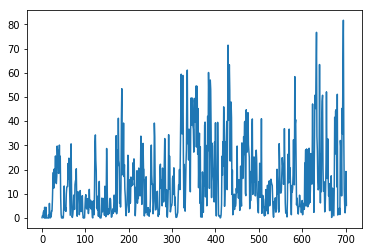

| Reward: 2 | Episode: 703| Epsilon:0.12416295401722881 


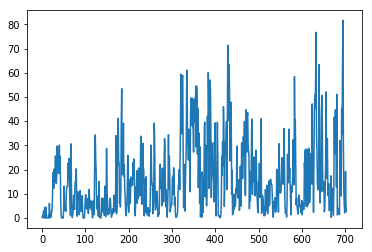

| Reward: 22 | Episode: 704| Epsilon:0.12402024797827811 


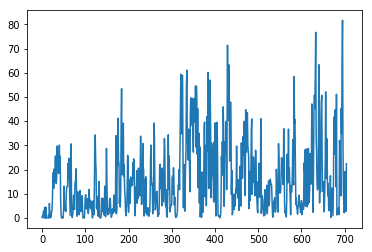

| Reward: 14 | Episode: 705| Epsilon:0.12384178645201825 


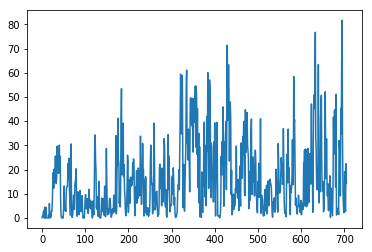

| Reward: 57 | Episode: 706| Epsilon:0.12368584328619818 


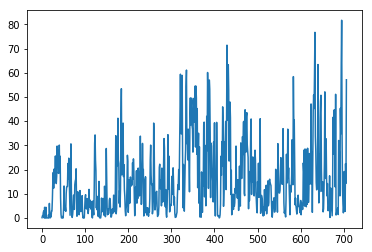

| Reward: 20 | Episode: 707| Epsilon:0.12353503781340448 


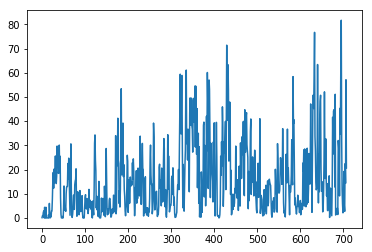

| Reward: 72 | Episode: 708| Epsilon:0.12337084460483329 


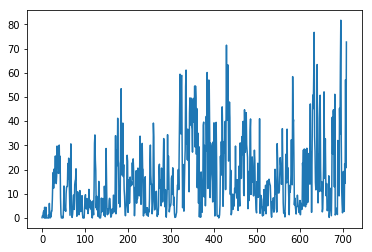

| Reward: 72 | Episode: 709| Epsilon:0.12323151359062333 


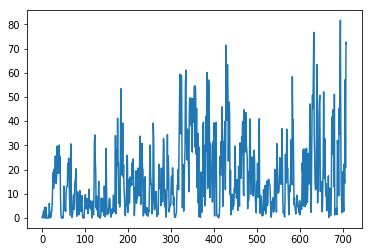

| Reward: 53 | Episode: 710| Epsilon:0.12308495457656349 


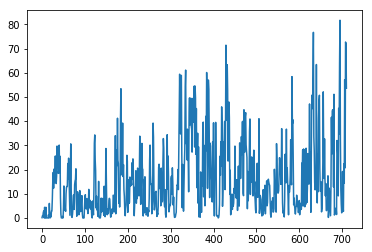

| Reward: 24 | Episode: 711| Epsilon:0.12294225809573173 


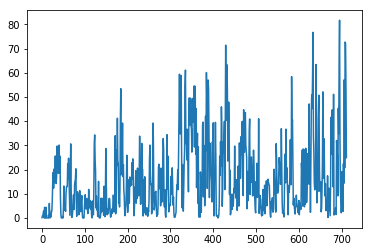

| Reward: 2 | Episode: 712| Epsilon:0.12278621975307841 


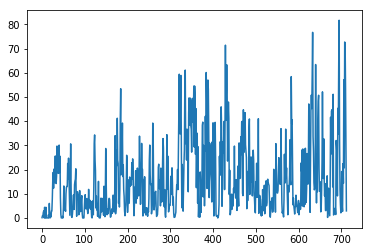

| Reward: 35 | Episode: 713| Epsilon:0.12261811696820259 


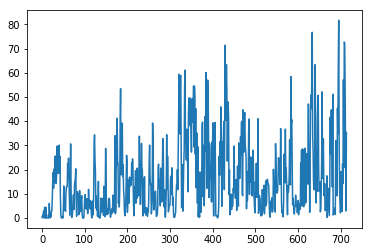

| Reward: 78 | Episode: 714| Epsilon:0.1224735122007476 


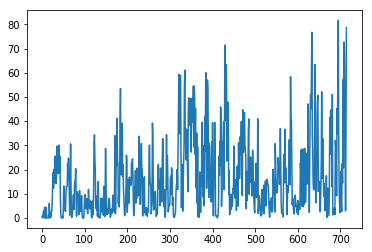

| Reward: 70 | Episode: 715| Epsilon:0.12234253497311927 


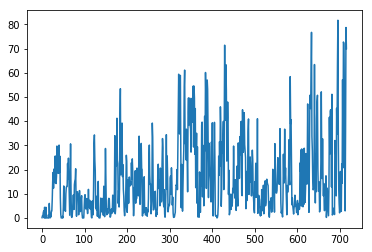

| Reward: 4 | Episode: 716| Epsilon:0.1222080315026023 


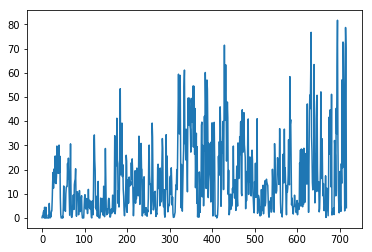

| Reward: 0 | Episode: 717| Epsilon:0.12205536613562941 


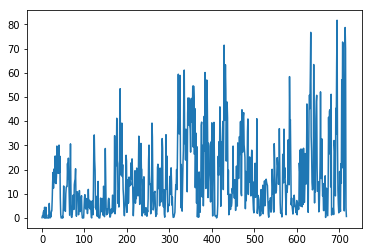

| Reward: 9 | Episode: 718| Epsilon:0.12189557749146104 


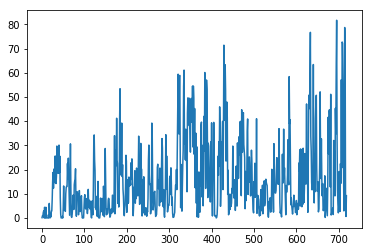

| Reward: 1 | Episode: 719| Epsilon:0.12175791259588545 


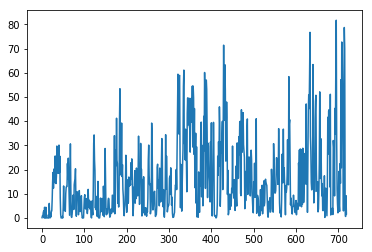

| Reward: 9 | Episode: 720| Epsilon:0.12161310613279741 


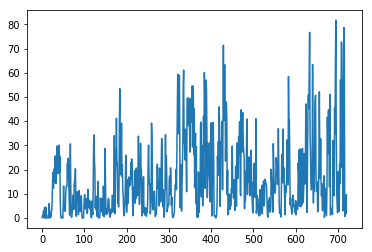

| Reward: 0 | Episode: 721| Epsilon:0.12146482787005536 


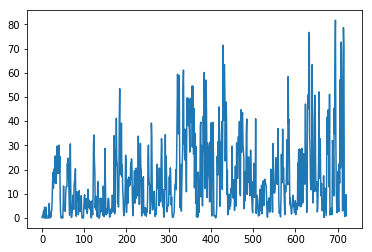

| Reward: 1 | Episode: 722| Epsilon:0.1213179435768292 


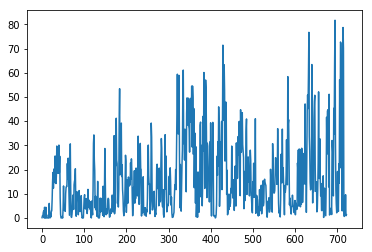

| Reward: 2 | Episode: 723| Epsilon:0.12116760180624613 


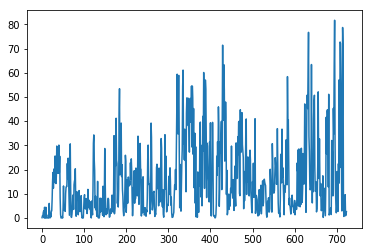

| Reward: 3 | Episode: 724| Epsilon:0.12100171502073134 


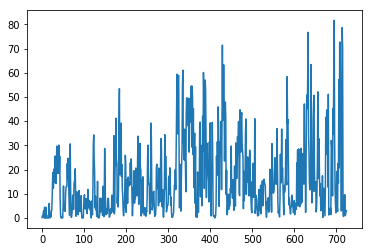

| Reward: 0 | Episode: 725| Epsilon:0.12087472926421931 


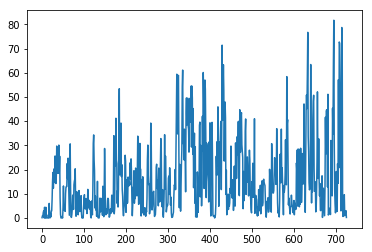

| Reward: 1 | Episode: 726| Epsilon:0.12073821728138674 


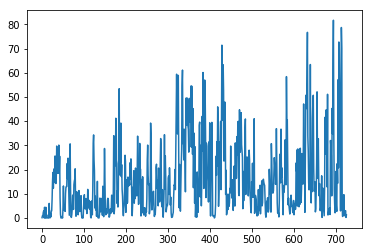

| Reward: 0 | Episode: 727| Epsilon:0.12059944744561267 


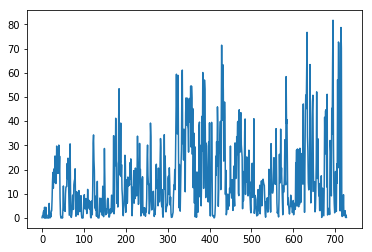

| Reward: 0 | Episode: 728| Epsilon:0.1204632463571012 


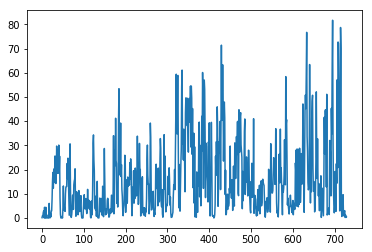

| Reward: 0 | Episode: 729| Epsilon:0.12029712089943059 


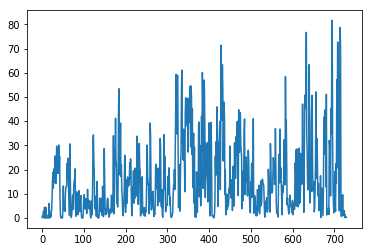

| Reward: 0 | Episode: 730| Epsilon:0.12014443976552383 


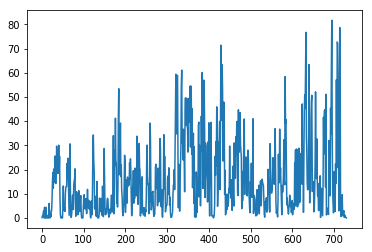

| Reward: 0 | Episode: 731| Epsilon:0.12000875254786857 


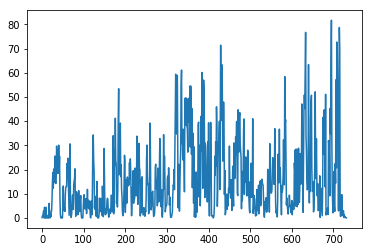

| Reward: 0 | Episode: 732| Epsilon:0.11986123178849611 


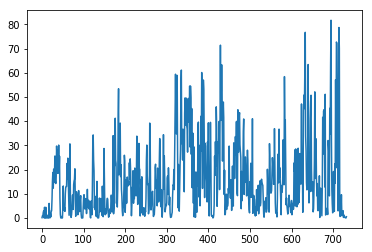

| Reward: 13 | Episode: 733| Epsilon:0.11971269523009381 


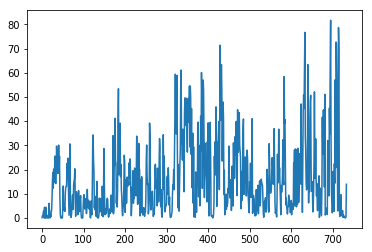

| Reward: 11 | Episode: 734| Epsilon:0.11959304177329554 


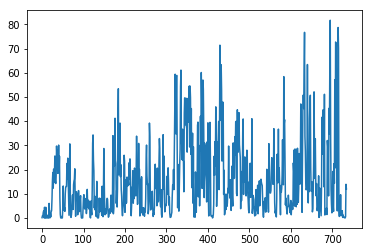

| Reward: 0 | Episode: 735| Epsilon:0.11946753435482176 


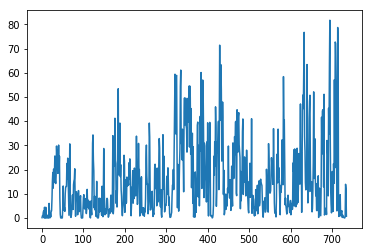

| Reward: 0 | Episode: 736| Epsilon:0.1193111335676948 


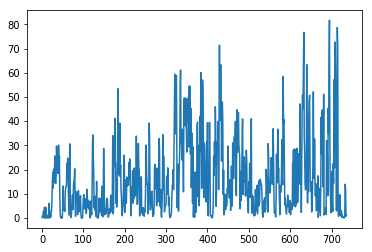

| Reward: 0 | Episode: 737| Epsilon:0.11918353829244645 


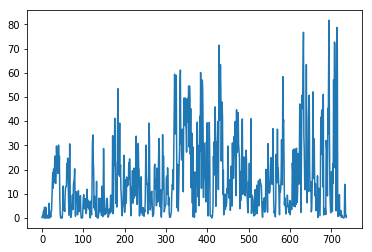

| Reward: 2 | Episode: 738| Epsilon:0.11905250782514123 


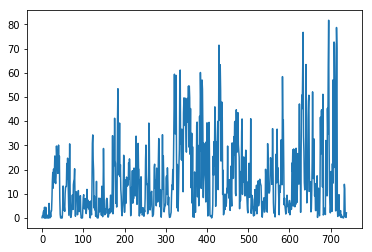

| Reward: 0 | Episode: 739| Epsilon:0.11892994625931488 


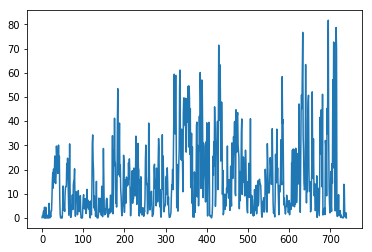

| Reward: 1 | Episode: 740| Epsilon:0.11879800659932645 


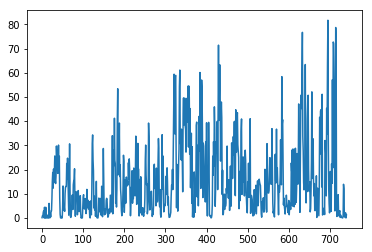

| Reward: 0 | Episode: 741| Epsilon:0.11865434722449339 


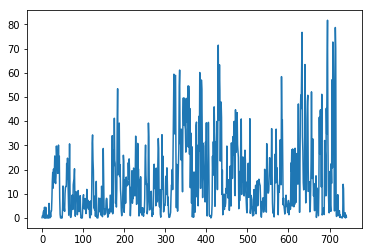

| Reward: 4 | Episode: 742| Epsilon:0.11851560212622464 


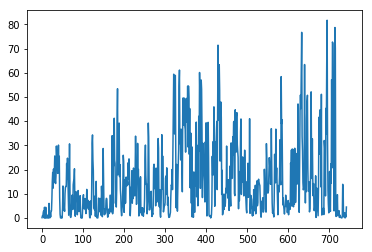

| Reward: 2 | Episode: 743| Epsilon:0.11839122543130016 


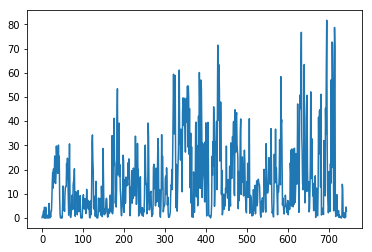

| Reward: 1 | Episode: 744| Epsilon:0.11824687548589478 


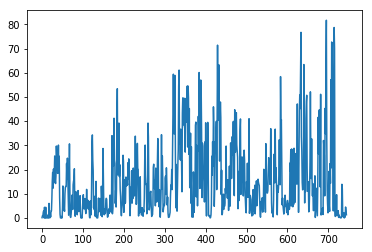

| Reward: 0 | Episode: 745| Epsilon:0.11809561555597979 


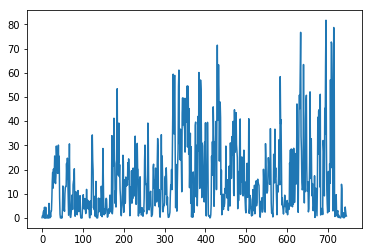

| Reward: 0 | Episode: 746| Epsilon:0.11795752379475315 


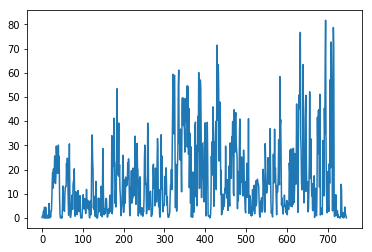

| Reward: 9 | Episode: 747| Epsilon:0.11782077171493116 


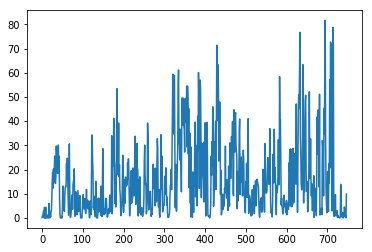

| Reward: 20 | Episode: 748| Epsilon:0.11768182450454769 


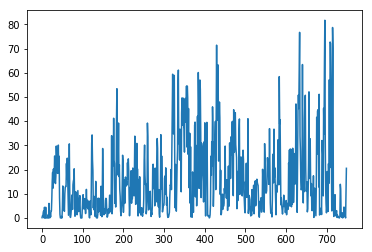

| Reward: 0 | Episode: 749| Epsilon:0.11753011206793444 


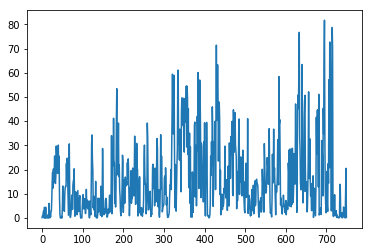

| Reward: 33 | Episode: 750| Epsilon:0.11737742142921165 


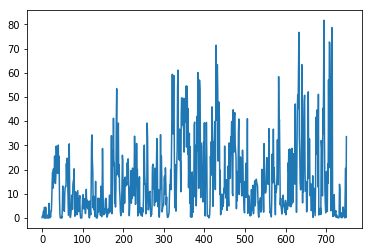

| Reward: 17 | Episode: 751| Epsilon:0.11724485919195482 


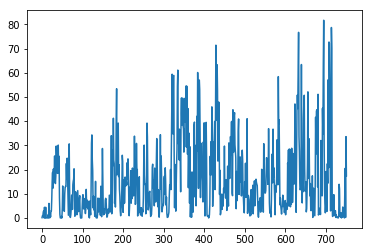

| Reward: 28 | Episode: 752| Epsilon:0.11711361780234976 


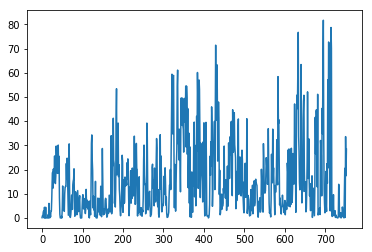

| Reward: 1 | Episode: 753| Epsilon:0.11697199531557963 


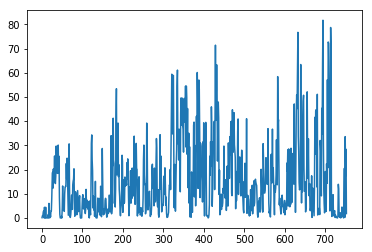

| Reward: 17 | Episode: 754| Epsilon:0.11683755416723732 


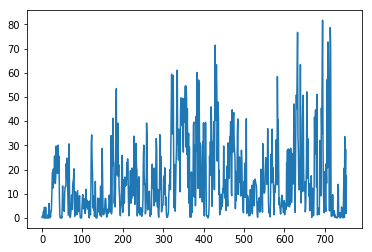

| Reward: 7 | Episode: 755| Epsilon:0.11670210050544728 


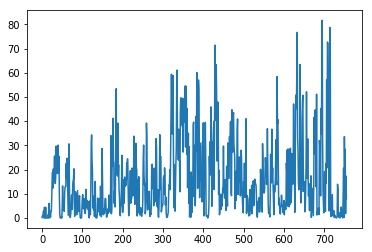

| Reward: 36 | Episode: 756| Epsilon:0.11657263239463993 


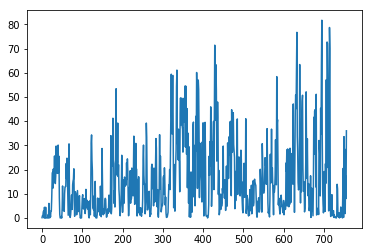

| Reward: 6 | Episode: 757| Epsilon:0.11642118567698807 


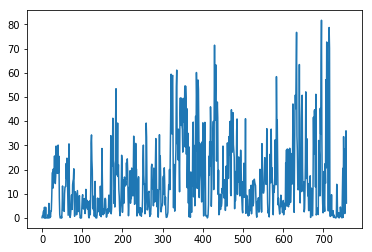

| Reward: 2 | Episode: 758| Epsilon:0.11630016997787616 


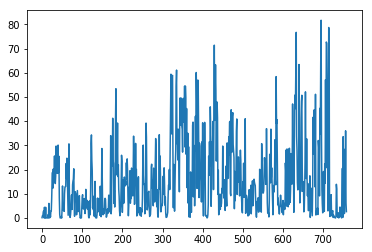

| Reward: 5 | Episode: 759| Epsilon:0.11615836957733298 


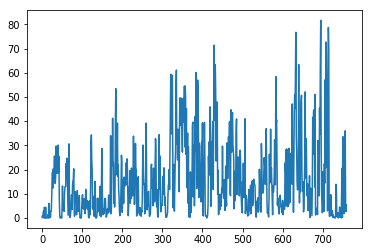

| Reward: 13 | Episode: 760| Epsilon:0.11602718409753807 


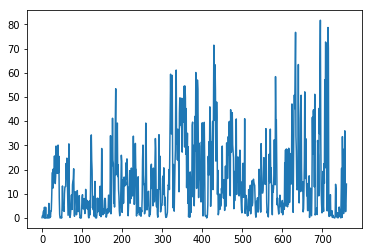

| Reward: 26 | Episode: 761| Epsilon:0.1159007827361213 


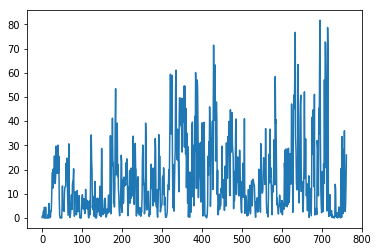

| Reward: 12 | Episode: 762| Epsilon:0.11575599654399212 


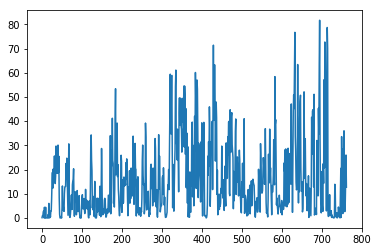

| Reward: 15 | Episode: 763| Epsilon:0.11561717196542207 


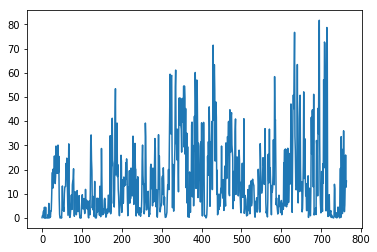

| Reward: 1 | Episode: 764| Epsilon:0.11547620431853481 


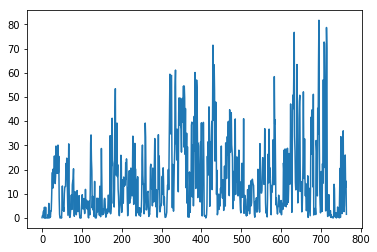

| Reward: 20 | Episode: 765| Epsilon:0.11533194852051427 


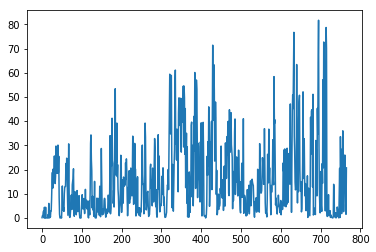

| Reward: 20 | Episode: 766| Epsilon:0.115198240357417 


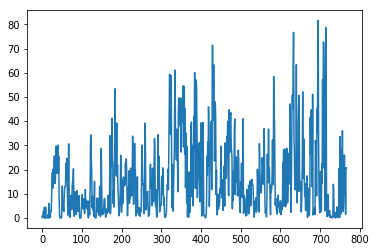

| Reward: 33 | Episode: 767| Epsilon:0.11505548235383764 


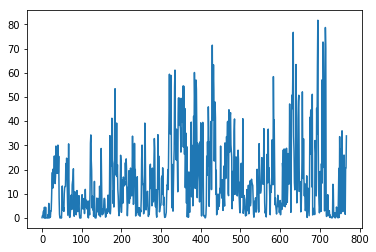

| Reward: 14 | Episode: 768| Epsilon:0.11493243821285276 


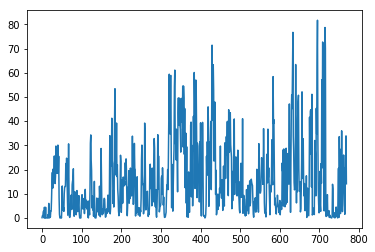

| Reward: 11 | Episode: 769| Epsilon:0.11477394004451753 


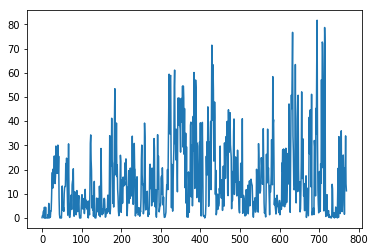

| Reward: 31 | Episode: 770| Epsilon:0.11464087879920212 


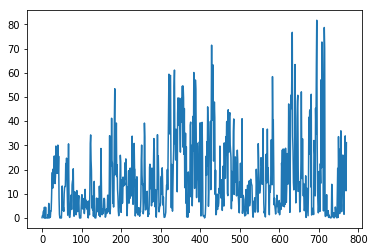

| Reward: 0 | Episode: 771| Epsilon:0.1145022465321292 


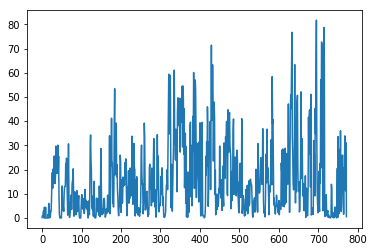

| Reward: 59 | Episode: 772| Epsilon:0.11436606921944006 


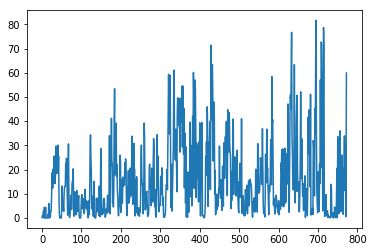

| Reward: 27 | Episode: 773| Epsilon:0.11423690790530147 


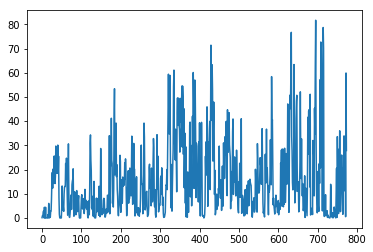

| Reward: 41 | Episode: 774| Epsilon:0.11410789246174483 


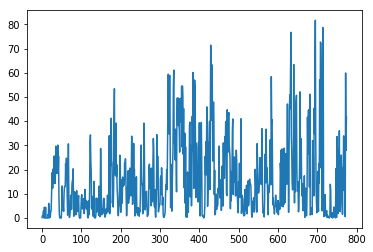

| Reward: 9 | Episode: 775| Epsilon:0.11396192706734788 


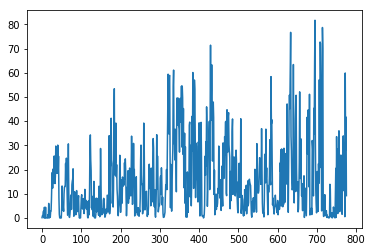

| Reward: 25 | Episode: 776| Epsilon:0.1138320838459728 


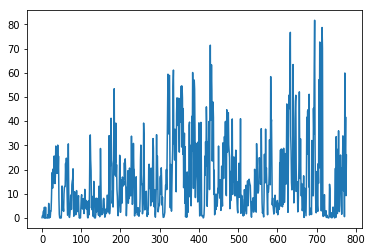

| Reward: 22 | Episode: 777| Epsilon:0.1136978405349478 


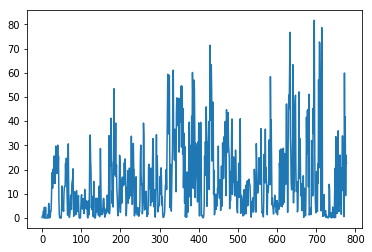

| Reward: 20 | Episode: 778| Epsilon:0.11357851986009924 


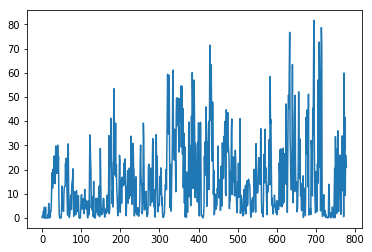

| Reward: 38 | Episode: 779| Epsilon:0.1134525170175548 


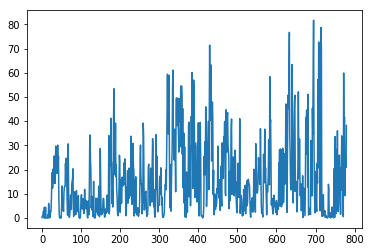

| Reward: 40 | Episode: 780| Epsilon:0.11332665396126881 


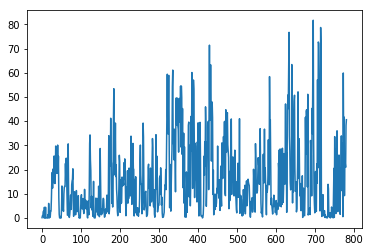

| Reward: 65 | Episode: 781| Epsilon:0.11319979852685852 


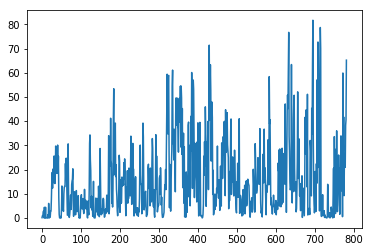

| Reward: 8 | Episode: 782| Epsilon:0.113076477352108 


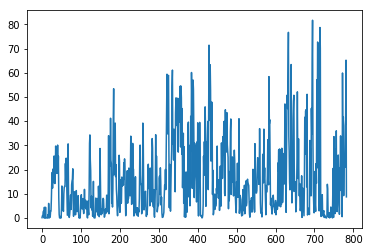

| Reward: 38 | Episode: 783| Epsilon:0.11294651349687328 


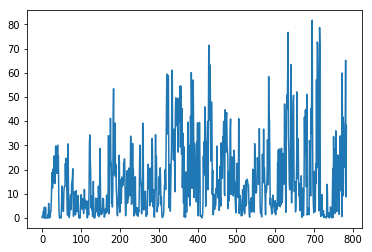

| Reward: 23 | Episode: 784| Epsilon:0.11280880208289289 


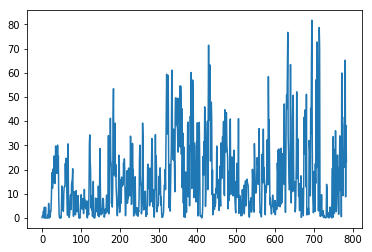

| Reward: 24 | Episode: 785| Epsilon:0.1126712585752334 


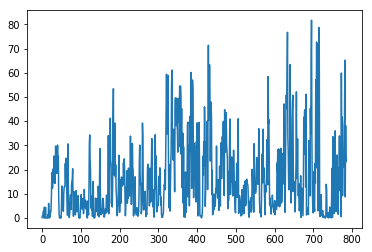

| Reward: 25 | Episode: 786| Epsilon:0.11253613348058902 


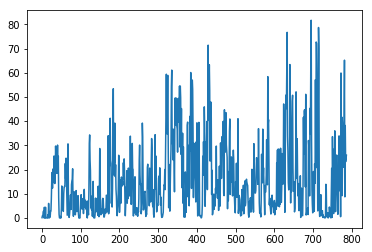

| Reward: 19 | Episode: 787| Epsilon:0.11240229446256146 


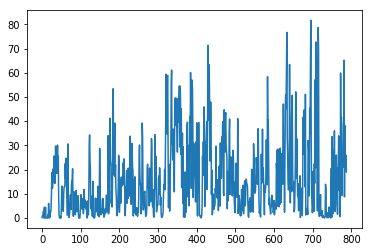

| Reward: 4 | Episode: 788| Epsilon:0.11228770200133738 


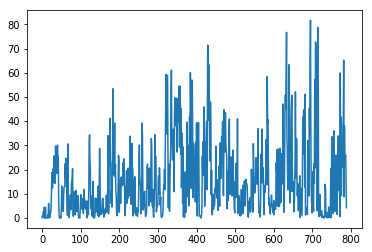

| Reward: 10 | Episode: 789| Epsilon:0.11217546986359651 


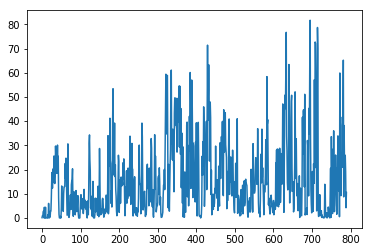

| Reward: 1 | Episode: 790| Epsilon:0.11205438514823554 


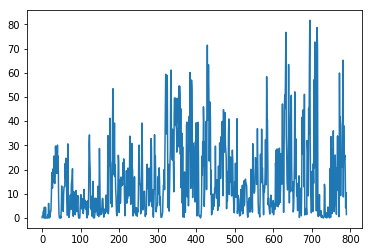

| Reward: 8 | Episode: 791| Epsilon:0.11192783457480479 


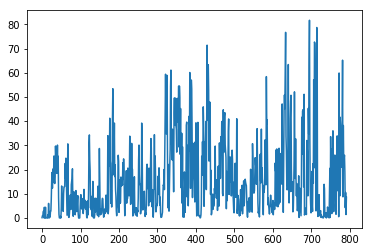

| Reward: 39 | Episode: 792| Epsilon:0.11180589909235103 


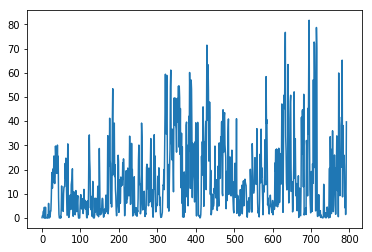

| Reward: 3 | Episode: 793| Epsilon:0.11169414851910459 


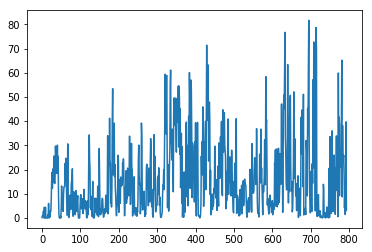

| Reward: 0 | Episode: 794| Epsilon:0.11157135189227683 


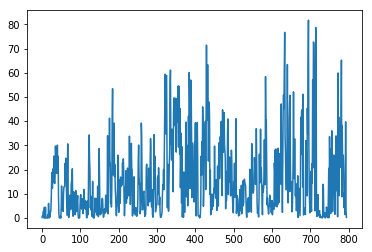

| Reward: 1 | Episode: 795| Epsilon:0.11145314832721011 


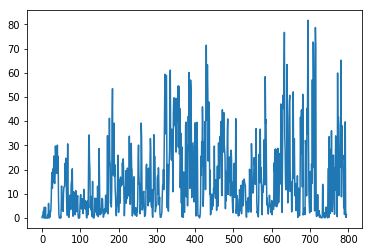

| Reward: 11 | Episode: 796| Epsilon:0.11132505023666252 


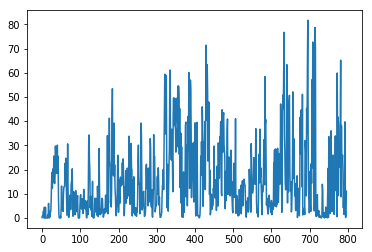

| Reward: 3 | Episode: 797| Epsilon:0.11119709937498233 


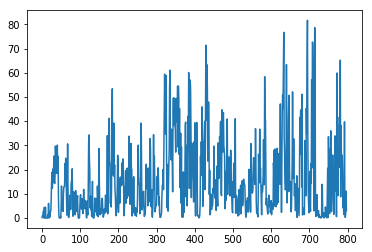

| Reward: 19 | Episode: 798| Epsilon:0.11108262475480252 


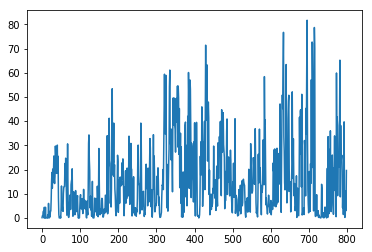

| Reward: 15 | Episode: 799| Epsilon:0.11098047522526863 


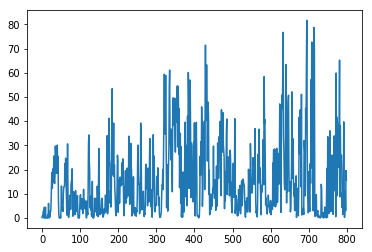

| Reward: 13 | Episode: 800| Epsilon:0.11086289766075999 


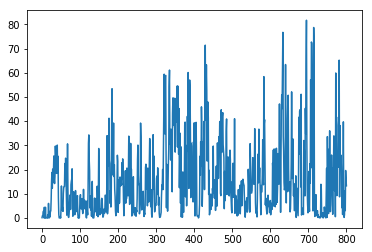

| Reward: 20 | Episode: 801| Epsilon:0.11075319715428342 


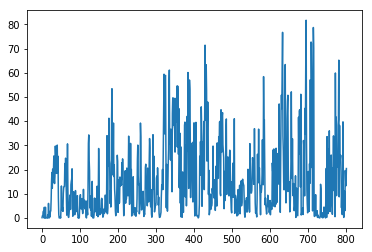

| Reward: 65 | Episode: 802| Epsilon:0.1106314350100596 


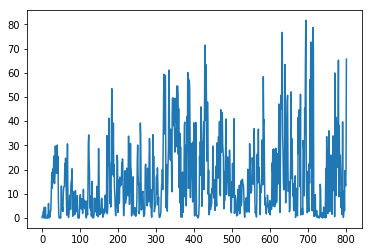

| Reward: 72 | Episode: 803| Epsilon:0.11050538640526049 


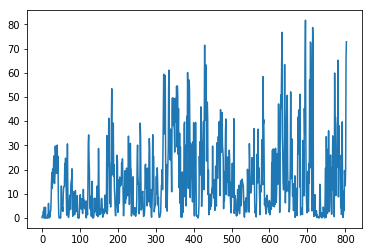

| Reward: 22 | Episode: 804| Epsilon:0.11038389670435153 


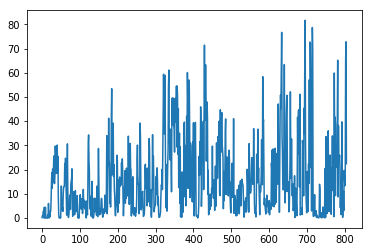

| Reward: 13 | Episode: 805| Epsilon:0.11025702755253963 


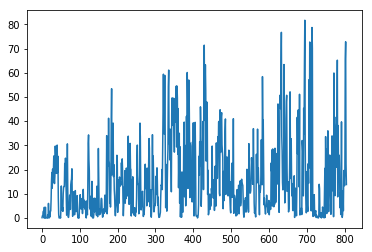

| Reward: 9 | Episode: 806| Epsilon:0.11012149410114233 


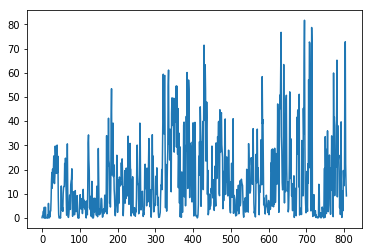

| Reward: 2 | Episode: 807| Epsilon:0.11001032698510795 


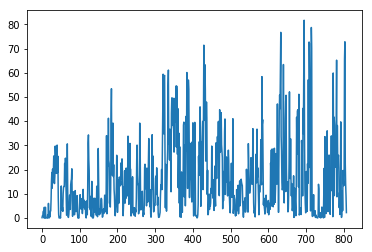

| Reward: 3 | Episode: 808| Epsilon:0.10990476722019717 


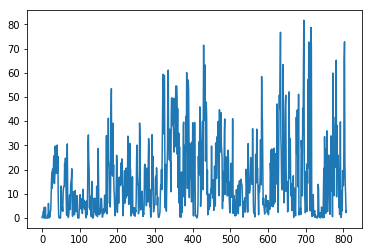

| Reward: 10 | Episode: 809| Epsilon:0.1097982107514531 


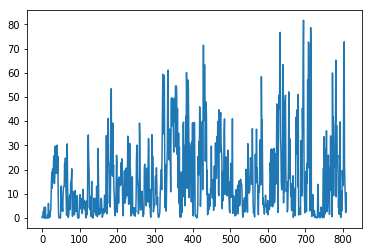

| Reward: 4 | Episode: 810| Epsilon:0.10968078891072726 


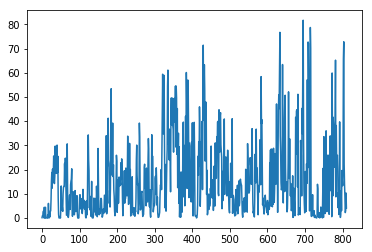

| Reward: 8 | Episode: 811| Epsilon:0.10955472787216446 


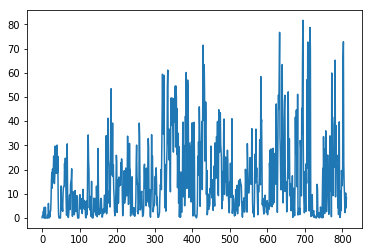

| Reward: 29 | Episode: 812| Epsilon:0.10944084961274479 


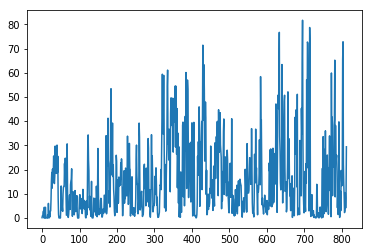

| Reward: 14 | Episode: 813| Epsilon:0.10934567700380628 


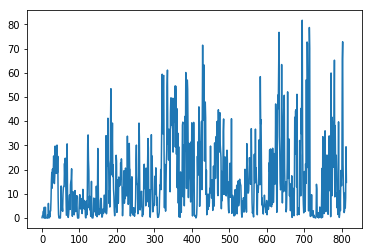

| Reward: 11 | Episode: 814| Epsilon:0.10922546228824337 


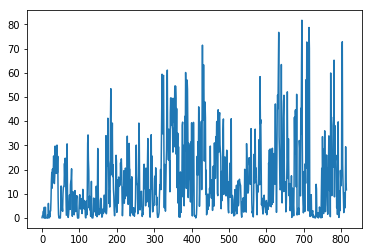

| Reward: 13 | Episode: 815| Epsilon:0.10910101558709806 


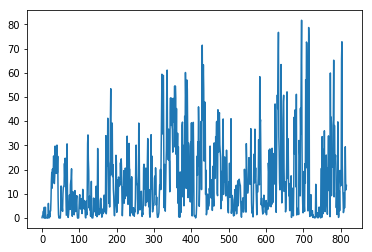

| Reward: 4 | Episode: 816| Epsilon:0.10898433934995706 


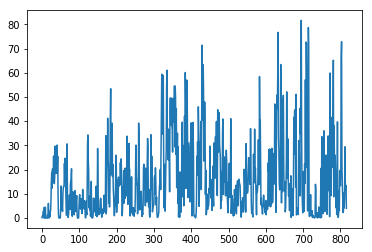

| Reward: 11 | Episode: 817| Epsilon:0.1088590787720383 


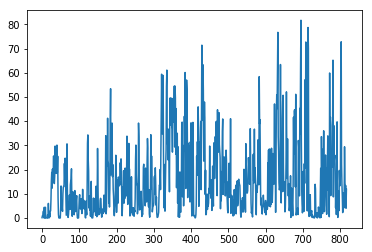

| Reward: 3 | Episode: 818| Epsilon:0.10875353613437061 


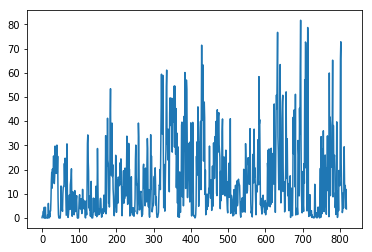

| Reward: 8 | Episode: 819| Epsilon:0.10862745454350702 


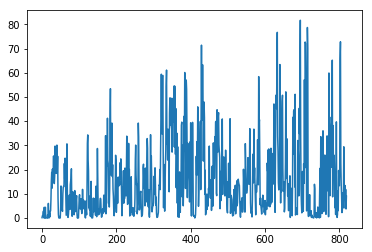

| Reward: 7 | Episode: 820| Epsilon:0.10849283930549267 


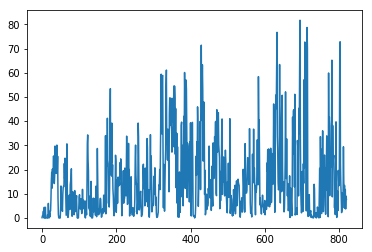

| Reward: 6 | Episode: 821| Epsilon:0.10839090344422654 


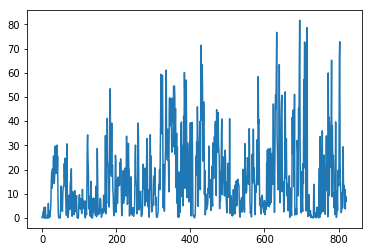

| Reward: 48 | Episode: 822| Epsilon:0.10828473186056617 


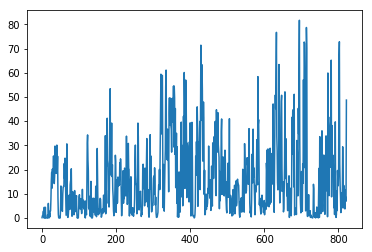

| Reward: 39 | Episode: 823| Epsilon:0.1081602753728403 


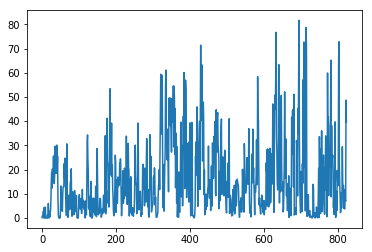

| Reward: 21 | Episode: 824| Epsilon:0.10804244431312206 


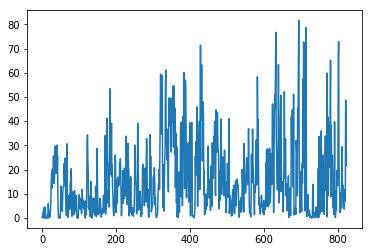

| Reward: 10 | Episode: 825| Epsilon:0.10792366237251207 


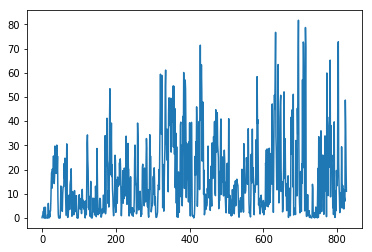

| Reward: 17 | Episode: 826| Epsilon:0.1077942310048602 


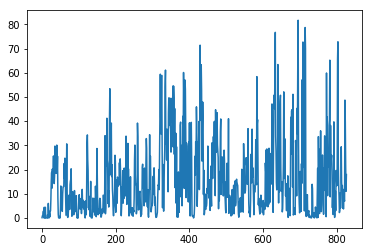

| Reward: 12 | Episode: 827| Epsilon:0.10765526540411904 


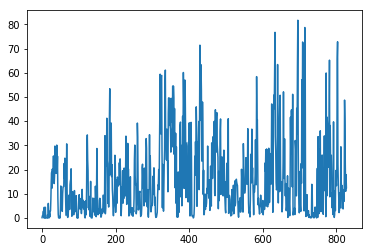

| Reward: 6 | Episode: 828| Epsilon:0.10752723119358107 


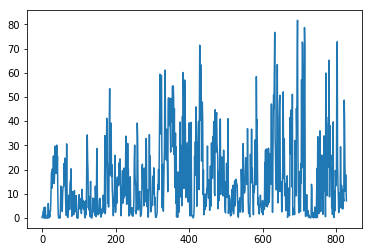

| Reward: 3 | Episode: 829| Epsilon:0.10743479706495598 


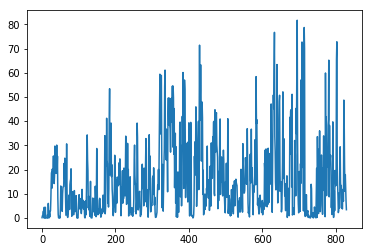

| Reward: 3 | Episode: 830| Epsilon:0.10732848871563523 


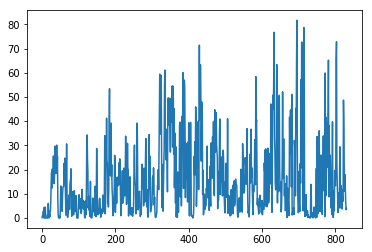

| Reward: 0 | Episode: 831| Epsilon:0.1072276468351419 


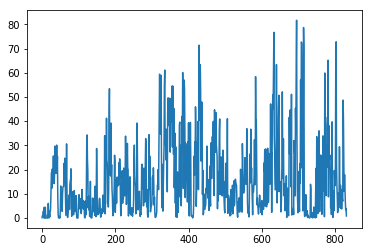

| Reward: 1 | Episode: 832| Epsilon:0.10710333425848387 


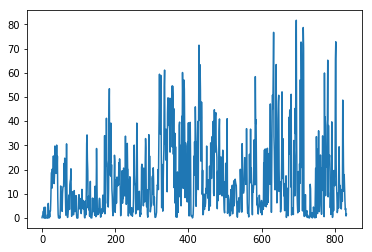

| Reward: 2 | Episode: 833| Epsilon:0.10698130541694 


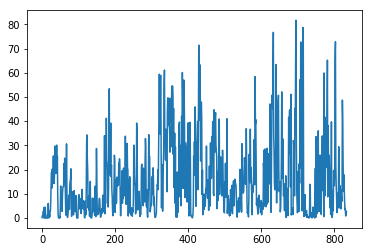

| Reward: 1 | Episode: 834| Epsilon:0.10686903343799585 


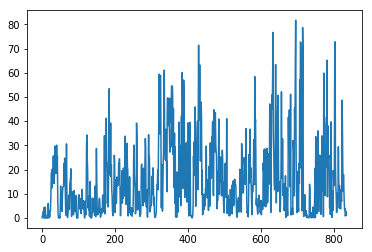

| Reward: 0 | Episode: 835| Epsilon:0.1067504740307264 


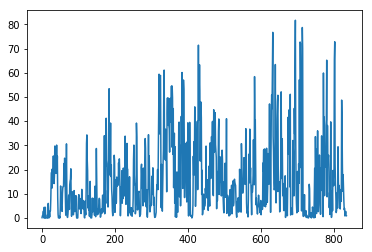

| Reward: 2 | Episode: 836| Epsilon:0.10664164351606029 


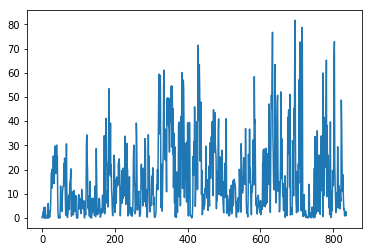

| Reward: 0 | Episode: 837| Epsilon:0.10651374965603465 


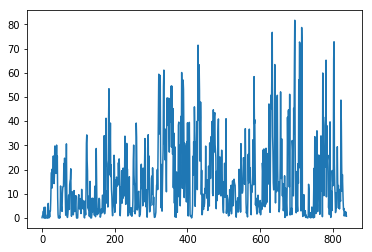

| Reward: 1 | Episode: 838| Epsilon:0.1064083526969931 


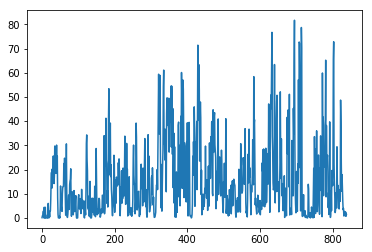

| Reward: 2 | Episode: 839| Epsilon:0.10629561903885996 


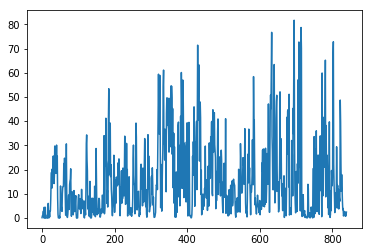

| Reward: 4 | Episode: 840| Epsilon:0.10618406665635659 


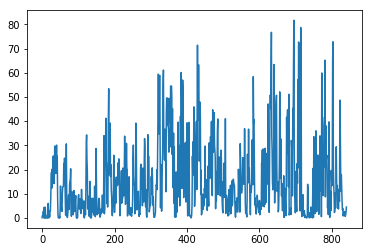

| Reward: 2 | Episode: 841| Epsilon:0.10608111753534975 


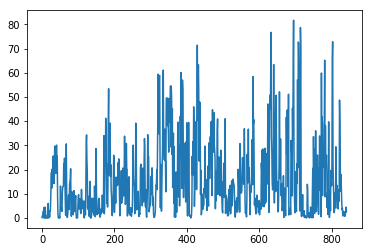

| Reward: 8 | Episode: 842| Epsilon:0.10597190968994401 


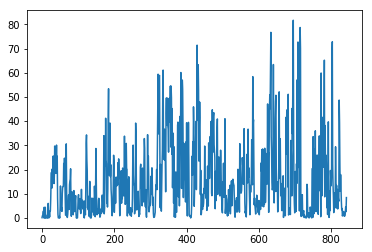

| Reward: 6 | Episode: 843| Epsilon:0.1058617556431288 


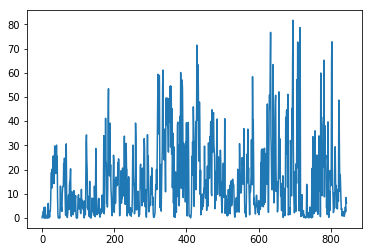

| Reward: 15 | Episode: 844| Epsilon:0.10575806142259417 


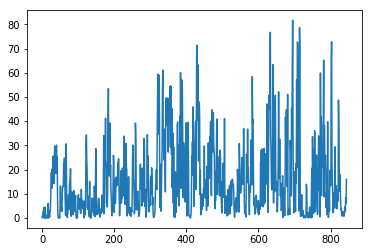

| Reward: 73 | Episode: 845| Epsilon:0.10563333988668556 


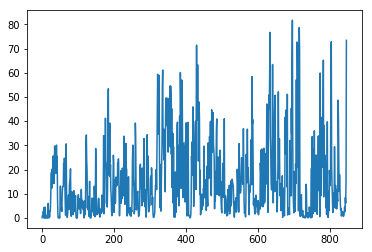

| Reward: 42 | Episode: 846| Epsilon:0.10553198003410837 


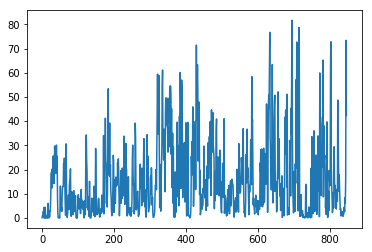

| Reward: 37 | Episode: 847| Epsilon:0.10544020667980933 


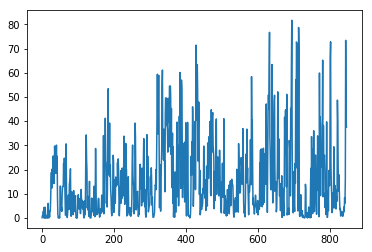

| Reward: 34 | Episode: 848| Epsilon:0.10531901953215725 


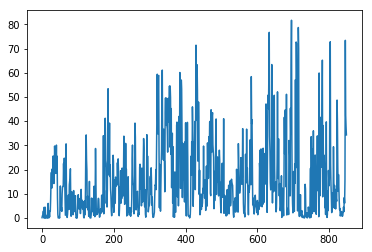

| Reward: 59 | Episode: 849| Epsilon:0.1052042837695384 


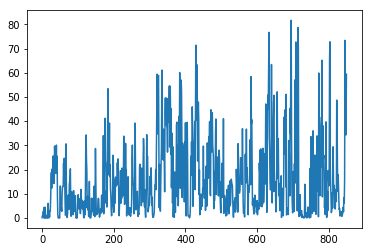

| Reward: 65 | Episode: 850| Epsilon:0.10508652034272822 


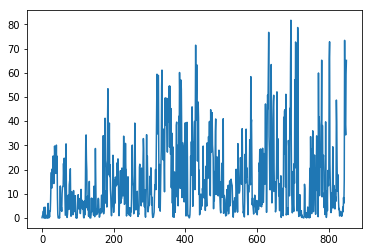

| Reward: 80 | Episode: 851| Epsilon:0.1049793862040068 


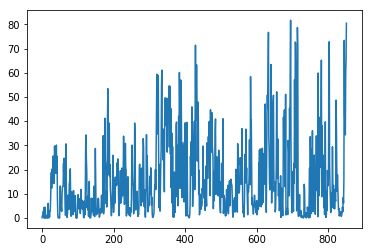

| Reward: 30 | Episode: 852| Epsilon:0.10486606910256983 


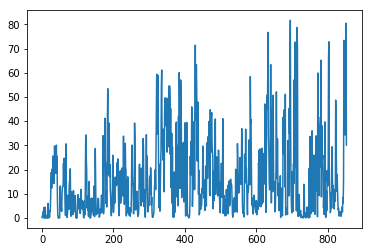

| Reward: 42 | Episode: 853| Epsilon:0.10476649314511104 


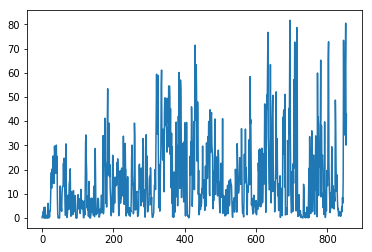

| Reward: 61 | Episode: 854| Epsilon:0.10465759208610081 


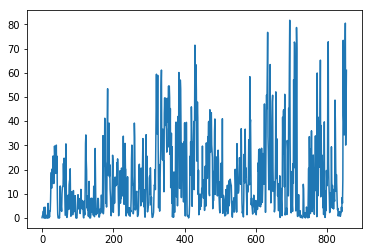

| Reward: 67 | Episode: 855| Epsilon:0.10453939520987098 


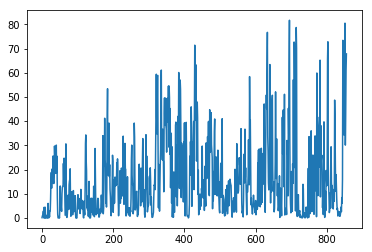

| Reward: 38 | Episode: 856| Epsilon:0.10441924340514969 


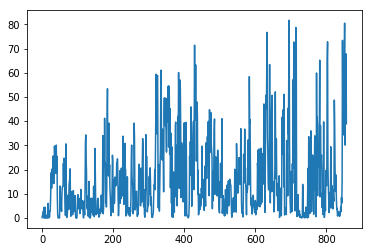

| Reward: 44 | Episode: 857| Epsilon:0.10430861709631031 


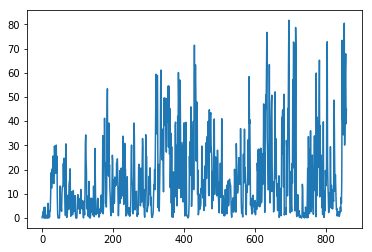

| Reward: 75 | Episode: 858| Epsilon:0.10420227601833587 


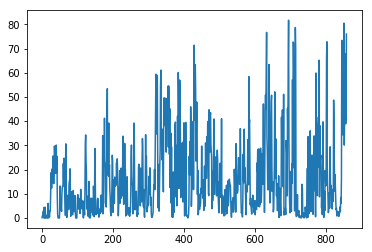

| Reward: 48 | Episode: 859| Epsilon:0.1040877159614978 


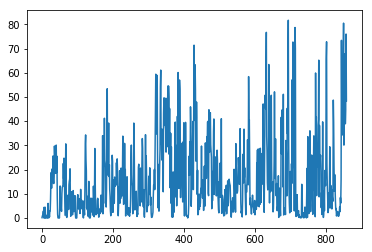

| Reward: 66 | Episode: 860| Epsilon:0.10397744088731763 


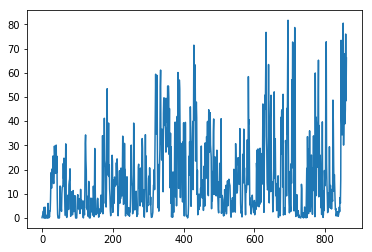

| Reward: 57 | Episode: 861| Epsilon:0.10388701940068788 


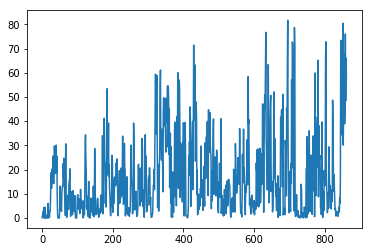

| Reward: 37 | Episode: 862| Epsilon:0.10377799473316057 


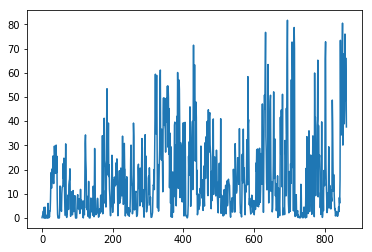

| Reward: 34 | Episode: 863| Epsilon:0.10367945196067796 


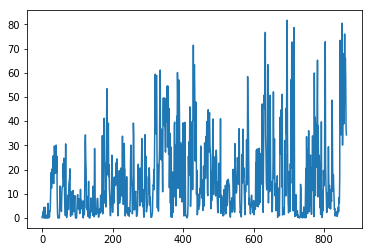

| Reward: 38 | Episode: 864| Epsilon:0.10356546669698305 


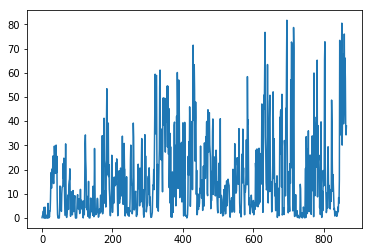

| Reward: 21 | Episode: 865| Epsilon:0.1034743687197883 


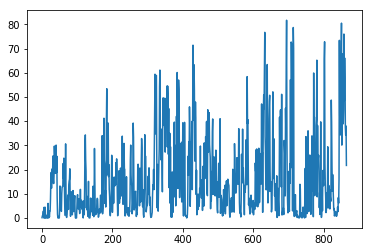

| Reward: 35 | Episode: 866| Epsilon:0.10335130684204154 


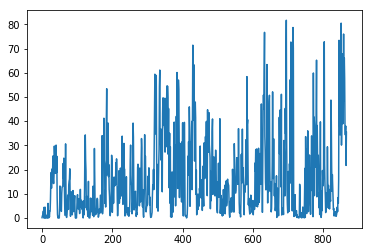

| Reward: 41 | Episode: 867| Epsilon:0.10323664996450156 


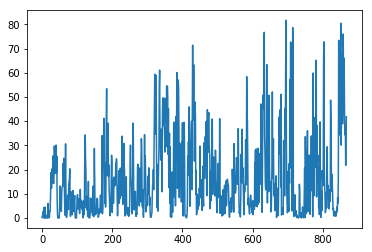

| Reward: 32 | Episode: 868| Epsilon:0.10312727654682409 


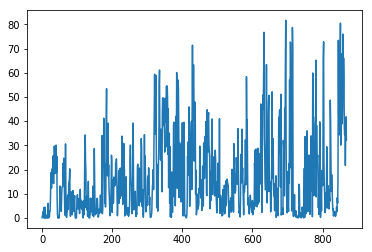

| Reward: 41 | Episode: 869| Epsilon:0.10300874775327004 


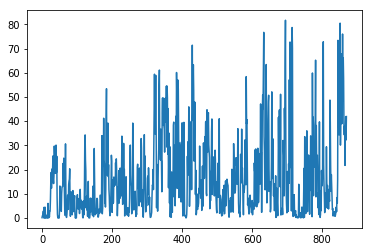

| Reward: 31 | Episode: 870| Epsilon:0.1029078481248666 


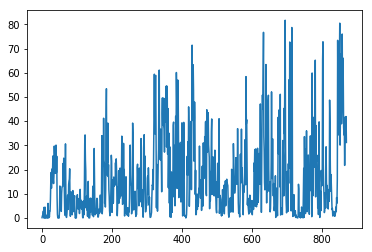

| Reward: 44 | Episode: 871| Epsilon:0.10282144139631452 


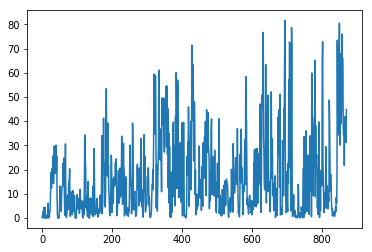

| Reward: 31 | Episode: 872| Epsilon:0.1027155893056005 


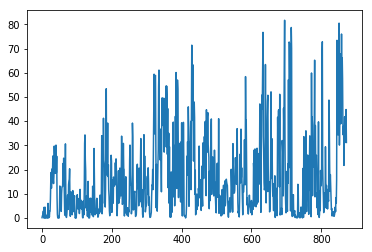

| Reward: 34 | Episode: 873| Epsilon:0.1026170291635037 


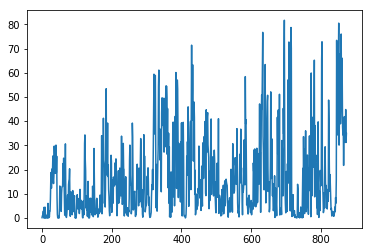

| Reward: 64 | Episode: 874| Epsilon:0.10250933729254877 


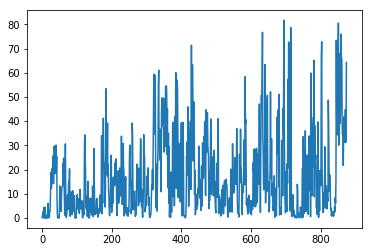

| Reward: 35 | Episode: 875| Epsilon:0.10240278246710341 


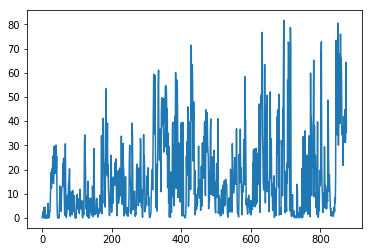

| Reward: 36 | Episode: 876| Epsilon:0.10229429248508677 


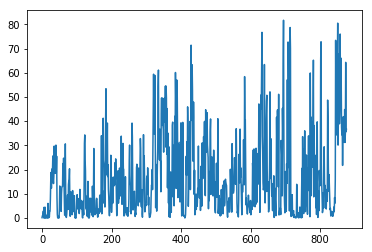

| Reward: 28 | Episode: 877| Epsilon:0.10219102689125183 


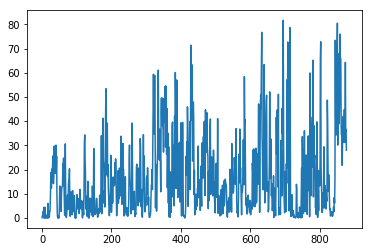

| Reward: 26 | Episode: 878| Epsilon:0.10208888643239905 


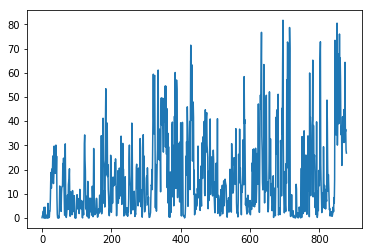

| Reward: 33 | Episode: 879| Epsilon:0.10197766961428055 


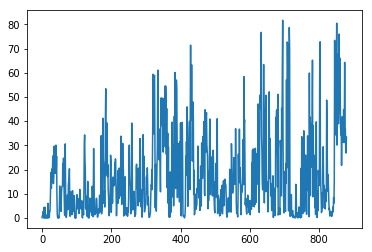

| Reward: 17 | Episode: 880| Epsilon:0.1018757424071273 


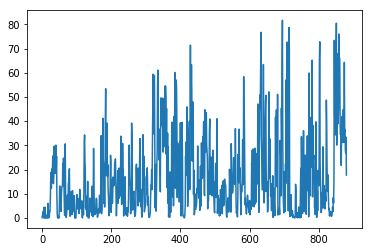

| Reward: 20 | Episode: 881| Epsilon:0.10177391707674384 


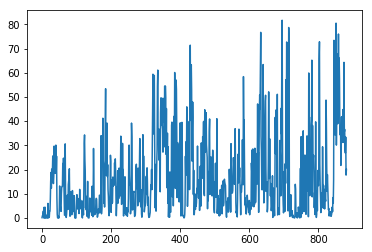

| Reward: 1 | Episode: 882| Epsilon:0.1016569437597873 


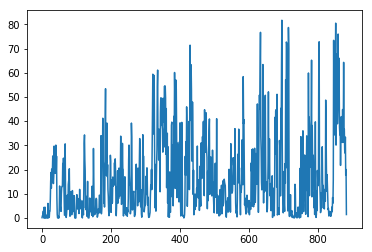

| Reward: 65 | Episode: 883| Epsilon:0.10155229049013413 


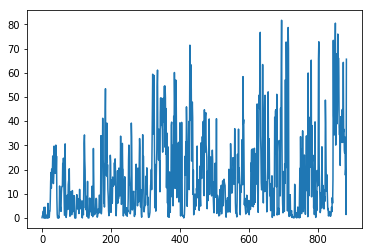

| Reward: 41 | Episode: 884| Epsilon:0.10144977394372677 


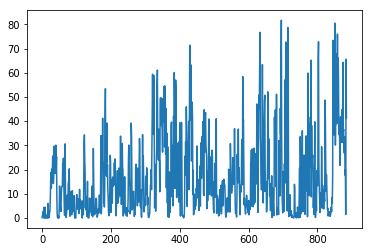

| Reward: 14 | Episode: 885| Epsilon:0.10134938786489976 


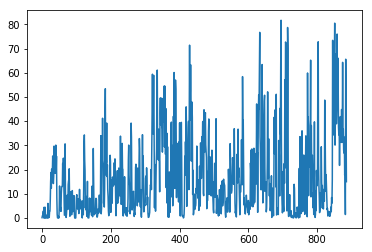

| Reward: 12 | Episode: 886| Epsilon:0.10125618884019363 


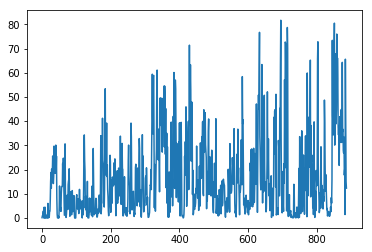

| Reward: 2 | Episode: 887| Epsilon:0.10114385626503083 


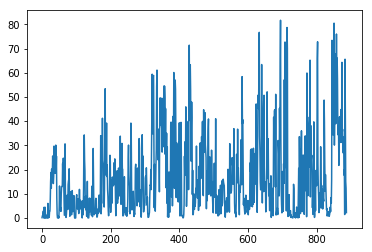

| Reward: 8 | Episode: 888| Epsilon:0.10104074161347927 


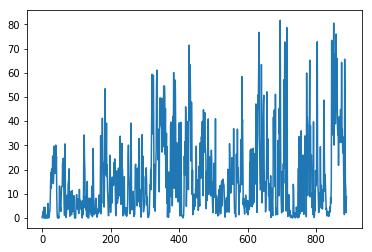

| Reward: 10 | Episode: 889| Epsilon:0.10094479800965571 


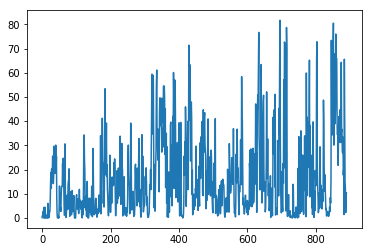

| Reward: 42 | Episode: 890| Epsilon:0.10081163811534816 


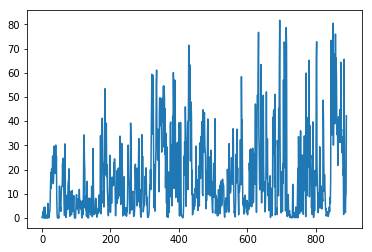

| Reward: 83 | Episode: 891| Epsilon:0.10070181274637495 


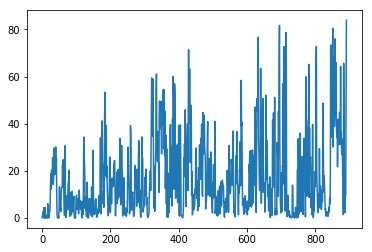

| Reward: 47 | Episode: 892| Epsilon:0.1005870775176738 


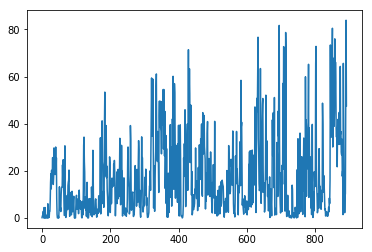

| Reward: 78 | Episode: 893| Epsilon:0.10049256961793918 


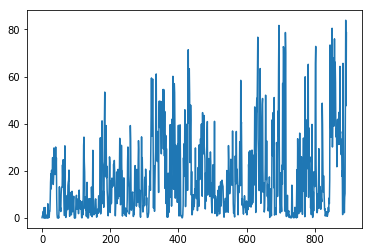

| Reward: 57 | Episode: 894| Epsilon:0.10037606524026325 


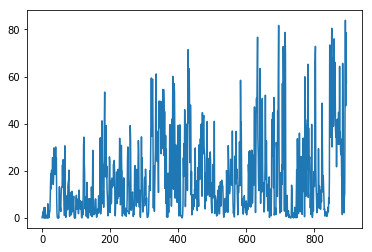

| Reward: 74 | Episode: 895| Epsilon:0.10027273060286612 


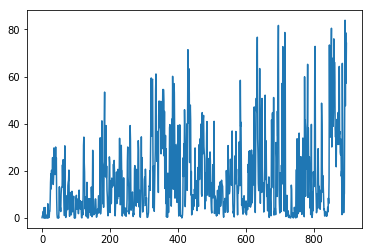

| Reward: 63 | Episode: 896| Epsilon:0.10018452897333606 


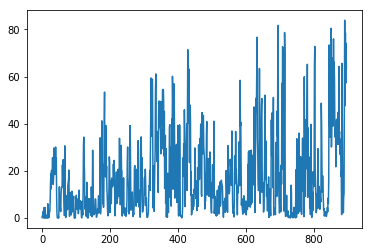

| Reward: 60 | Episode: 897| Epsilon:0.10009240113134646 


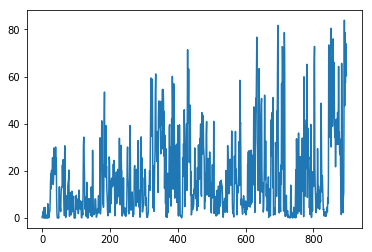

| Reward: 64 | Episode: 898| Epsilon:0.09999535809051731 


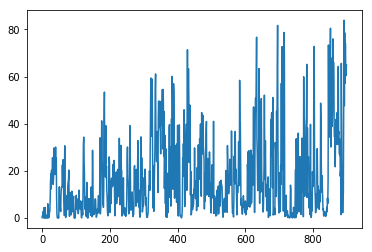

| Reward: 15 | Episode: 899| Epsilon:0.09990640136864597 


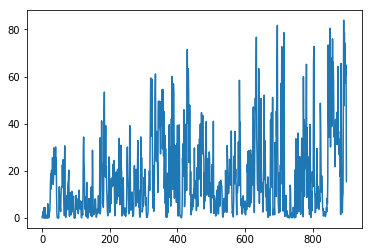

| Reward: 52 | Episode: 900| Epsilon:0.09980953866101261 


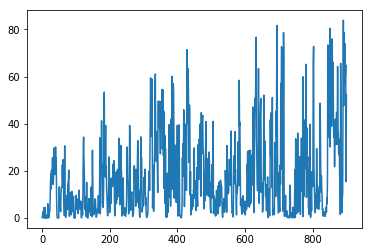

| Reward: 82 | Episode: 901| Epsilon:0.09971276986512062 


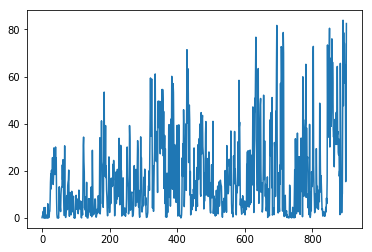

| Reward: 74 | Episode: 902| Epsilon:0.09961111418478999 


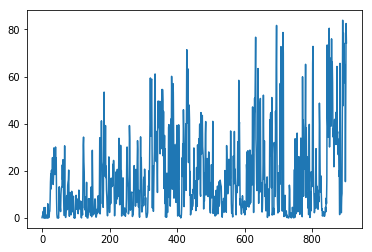

| Reward: 57 | Episode: 903| Epsilon:0.09951354262290504 


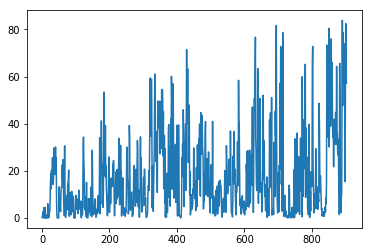

| Reward: 6 | Episode: 904| Epsilon:0.0994180549859477 


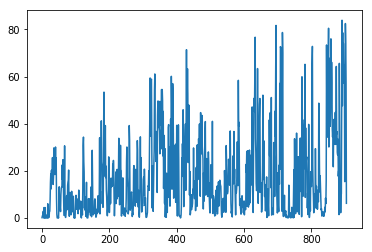

| Reward: 2 | Episode: 905| Epsilon:0.09932365221011528 


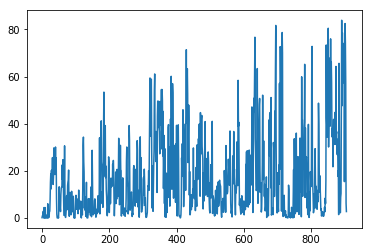

| Reward: 0 | Episode: 906| Epsilon:0.09922140100549276 


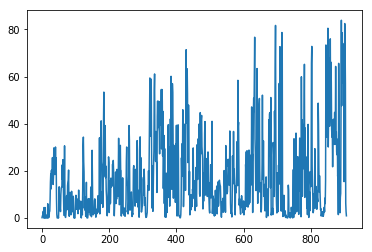

| Reward: 2 | Episode: 907| Epsilon:0.0991380896077766 


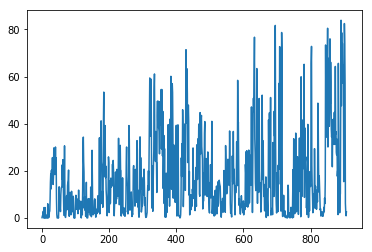

| Reward: 9 | Episode: 908| Epsilon:0.09904197180493851 


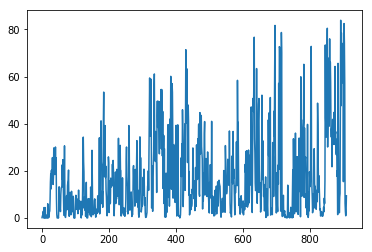

| Reward: 5 | Episode: 909| Epsilon:0.09893209565939627 


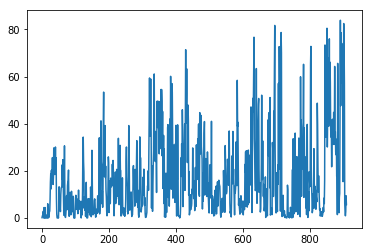

| Reward: 4 | Episode: 910| Epsilon:0.09883420086113981 


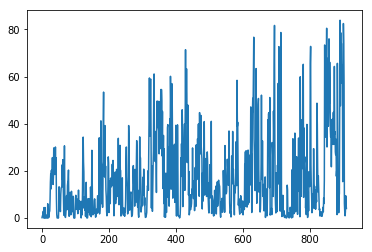

| Reward: 0 | Episode: 911| Epsilon:0.09871764470300018 


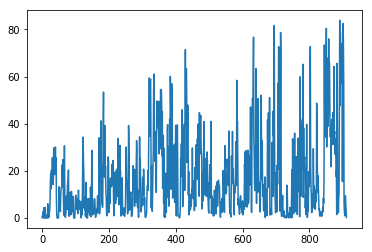

| Reward: 0 | Episode: 912| Epsilon:0.09862489325323281 


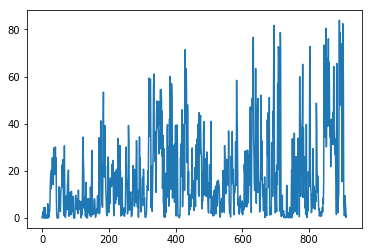

| Reward: 24 | Episode: 913| Epsilon:0.09853518497528772 


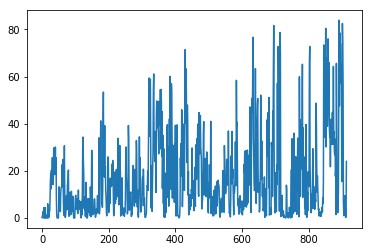

| Reward: 16 | Episode: 914| Epsilon:0.09844752723585087 


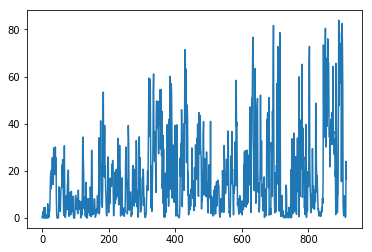

| Reward: 32 | Episode: 915| Epsilon:0.09834519451809853 


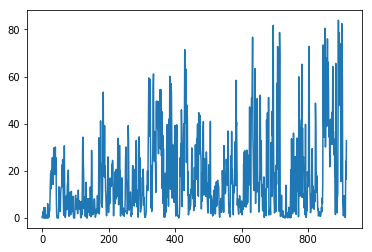

| Reward: 38 | Episode: 916| Epsilon:0.09824591551957375 


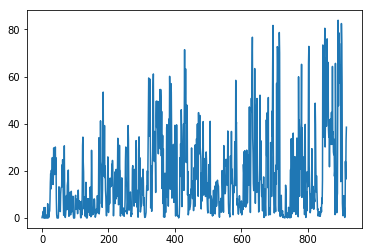

| Reward: 60 | Episode: 917| Epsilon:0.09816047831645772 


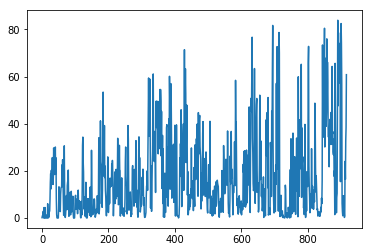

| Reward: 58 | Episode: 918| Epsilon:0.09806138578804569 


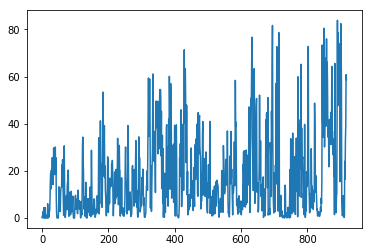

| Reward: 41 | Episode: 919| Epsilon:0.09797414954439958 


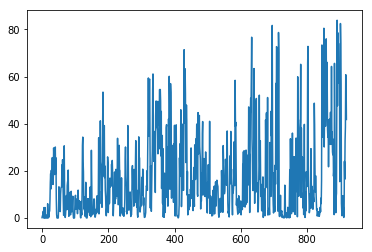

| Reward: 78 | Episode: 920| Epsilon:0.09787426636153122 


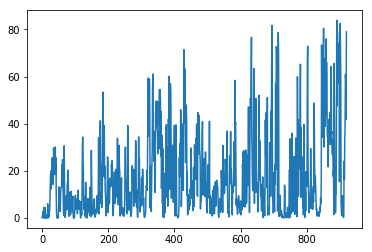

| Reward: 81 | Episode: 921| Epsilon:0.09778719658092003 


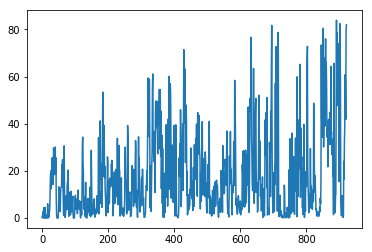

| Reward: 67 | Episode: 922| Epsilon:0.09768457339799337 


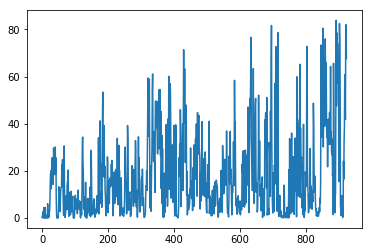

| Reward: 38 | Episode: 923| Epsilon:0.09756839731324911 


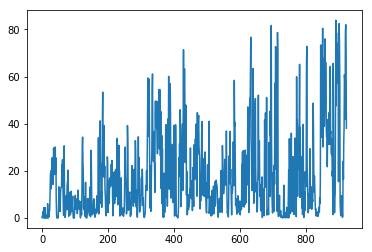

| Reward: 22 | Episode: 924| Epsilon:0.09747087719652003 


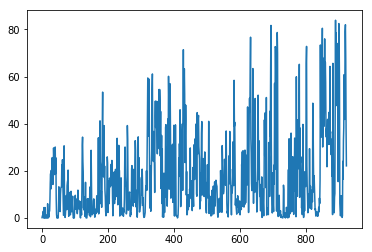

| Reward: 36 | Episode: 925| Epsilon:0.09738611398688538 


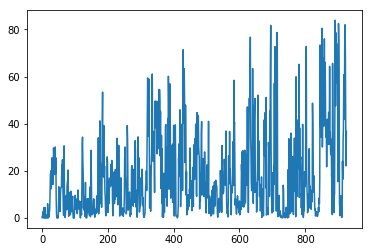

| Reward: 38 | Episode: 926| Epsilon:0.09728293888264923 


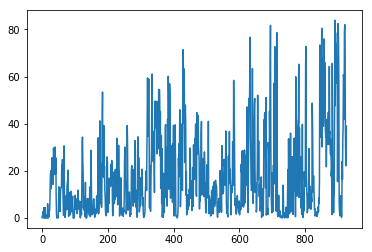

| Reward: 63 | Episode: 927| Epsilon:0.09720708739698819 


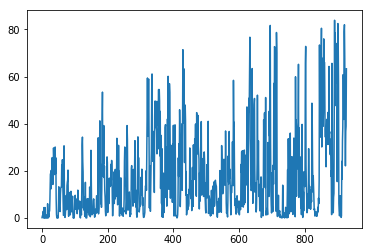

| Reward: 72 | Episode: 928| Epsilon:0.0971176975552656 


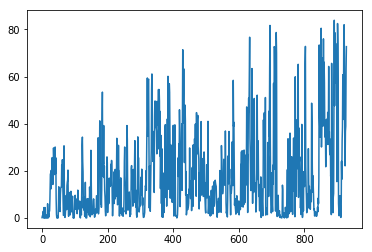

| Reward: 76 | Episode: 929| Epsilon:0.09701674714836643 


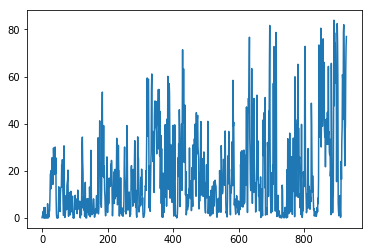

| Reward: 71 | Episode: 930| Epsilon:0.09691784002294832 


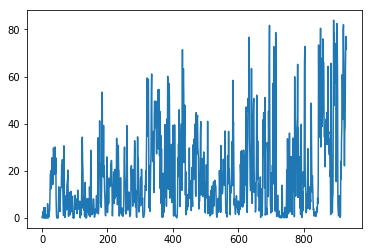

| Reward: 77 | Episode: 931| Epsilon:0.09681612918990172 


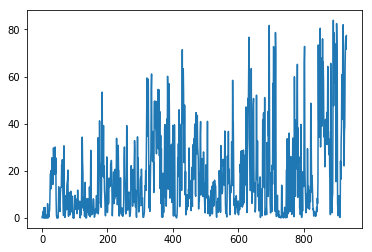

| Reward: 20 | Episode: 932| Epsilon:0.0967193609690448 


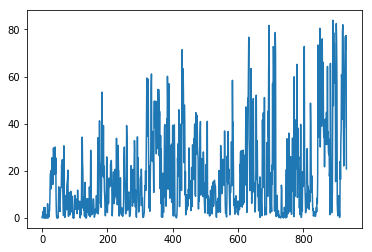

| Reward: 32 | Episode: 933| Epsilon:0.09663331860210296 


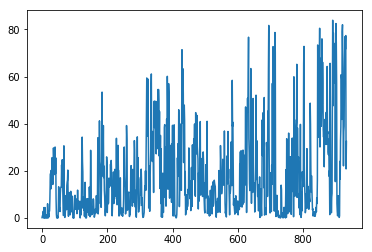

| Reward: 55 | Episode: 934| Epsilon:0.09654542184178248 


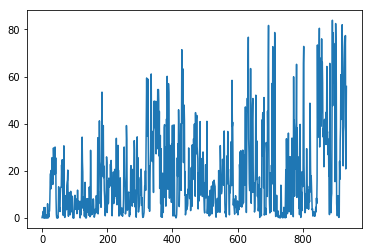

| Reward: 68 | Episode: 935| Epsilon:0.09646339269039908 


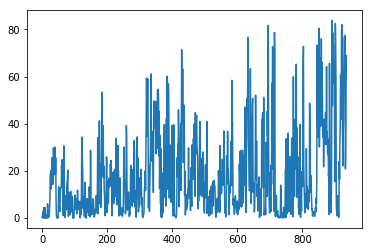

| Reward: 65 | Episode: 936| Epsilon:0.09637372298972194 


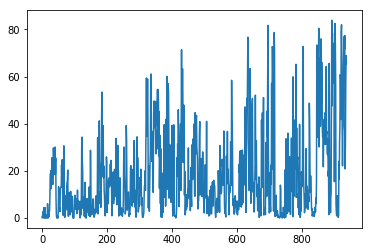

| Reward: 58 | Episode: 937| Epsilon:0.09627739695614566 


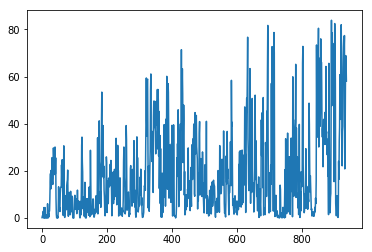

| Reward: 60 | Episode: 938| Epsilon:0.09617058780152564 


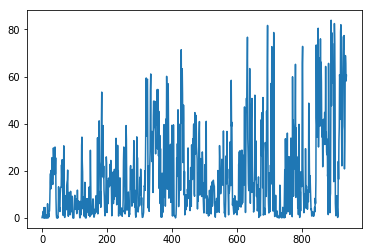

| Reward: 60 | Episode: 939| Epsilon:0.09607734709420825 


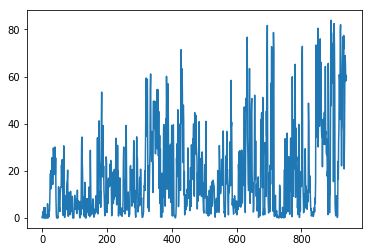

| Reward: 55 | Episode: 940| Epsilon:0.0959832369450099 


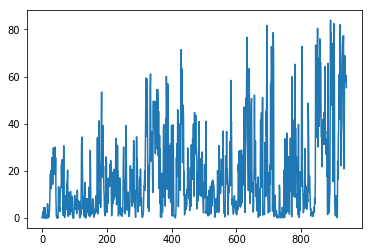

| Reward: 20 | Episode: 941| Epsilon:0.09589497253355295 


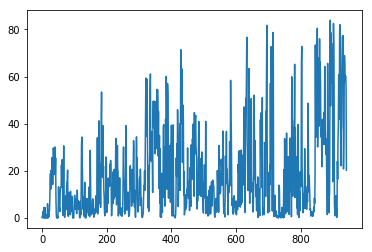

| Reward: 24 | Episode: 942| Epsilon:0.09579816702227864 


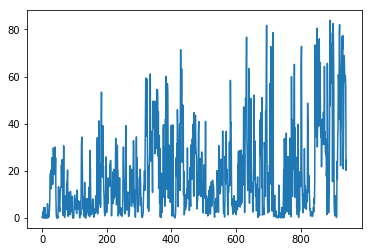

| Reward: 27 | Episode: 943| Epsilon:0.09571102990800263 


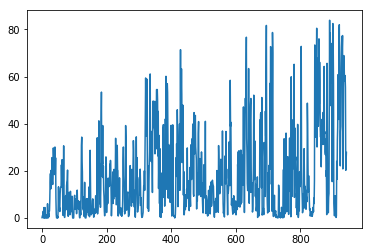

| Reward: 2 | Episode: 944| Epsilon:0.09561345394181885 


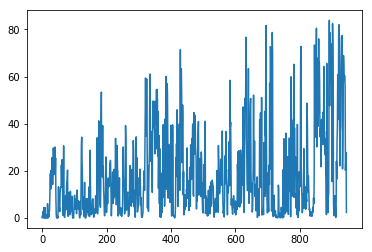

| Reward: 25 | Episode: 945| Epsilon:0.09552744011522962 


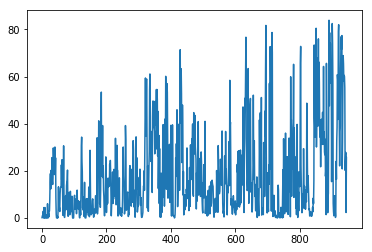

| Reward: 73 | Episode: 946| Epsilon:0.09542623417130397 


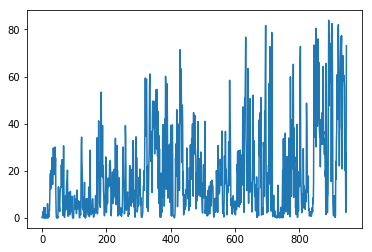

| Reward: 67 | Episode: 947| Epsilon:0.09532894855012221 


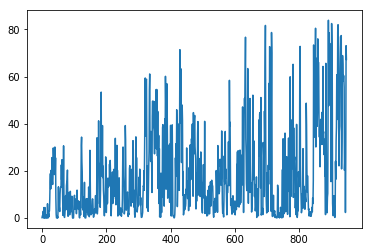

| Reward: 19 | Episode: 948| Epsilon:0.09524128581018564 


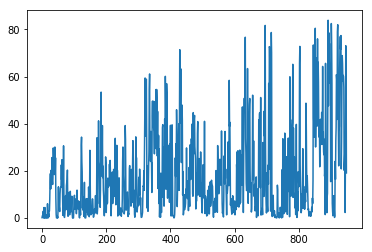

| Reward: 26 | Episode: 949| Epsilon:0.09514514019249902 


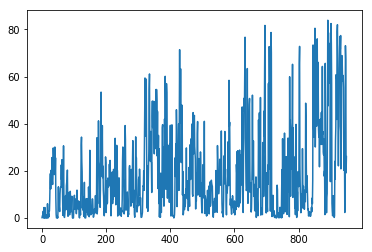

| Reward: 24 | Episode: 950| Epsilon:0.09505004213377018 


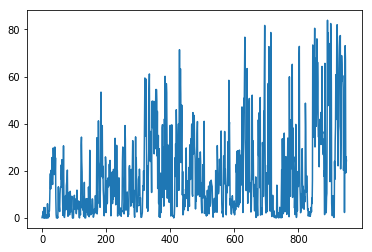

| Reward: 3 | Episode: 951| Epsilon:0.09495314003475479 


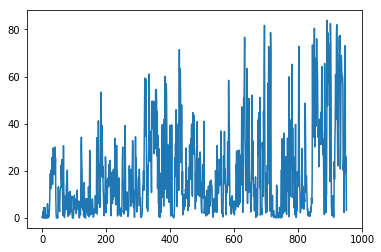

| Reward: 0 | Episode: 952| Epsilon:0.09485823388117458 


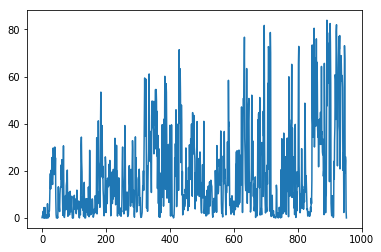

| Reward: 2 | Episode: 953| Epsilon:0.09478522078966801 


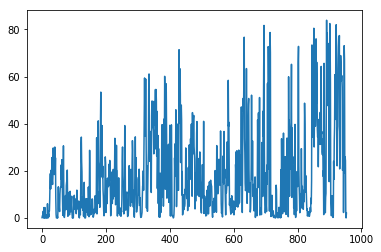

| Reward: 13 | Episode: 954| Epsilon:0.09468858867205956 


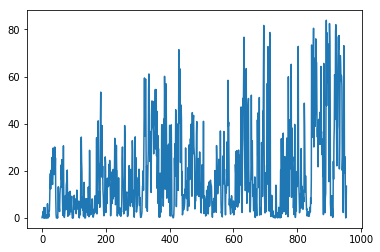

| Reward: 5 | Episode: 955| Epsilon:0.09459205506945255 


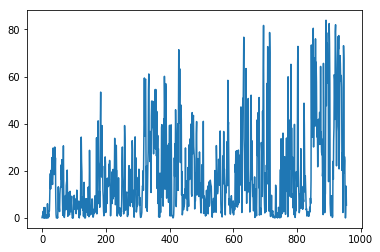

| Reward: 0 | Episode: 956| Epsilon:0.094498454806707 


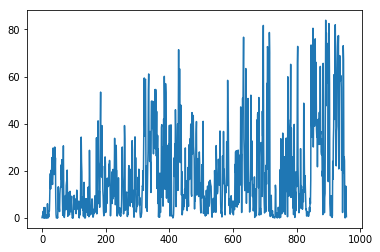

| Reward: 13 | Episode: 957| Epsilon:0.0944106116579162 


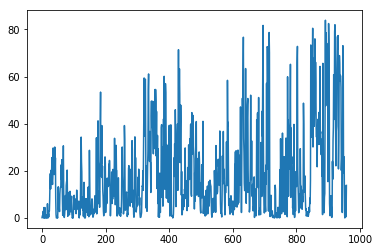

| Reward: 45 | Episode: 958| Epsilon:0.094338886493445 


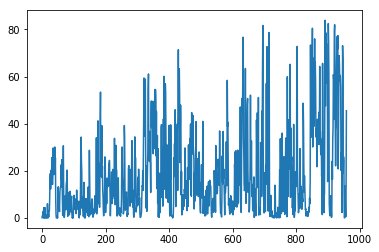

| Reward: 24 | Episode: 959| Epsilon:0.09425401926724489 


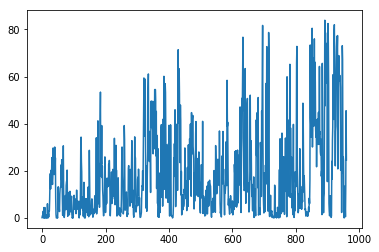

| Reward: 21 | Episode: 960| Epsilon:0.0941560455525004 


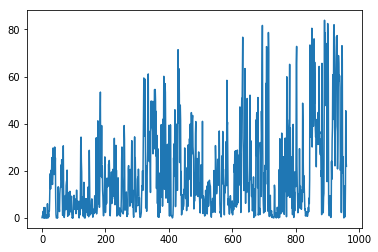

| Reward: 23 | Episode: 961| Epsilon:0.09406569867047727 


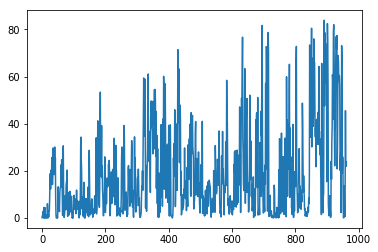

| Reward: 28 | Episode: 962| Epsilon:0.09399235566628916 


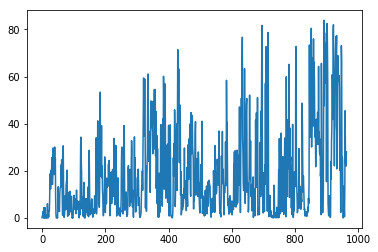

| Reward: 35 | Episode: 963| Epsilon:0.09390592203247576 


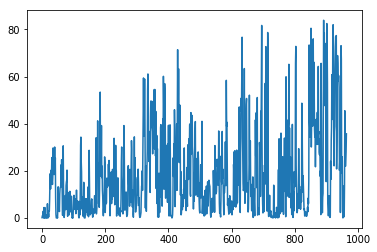

| Reward: 71 | Episode: 964| Epsilon:0.09380737206937644 


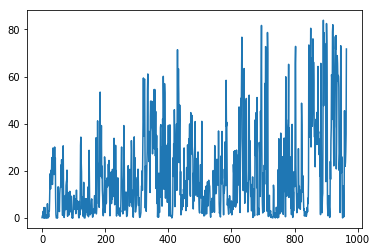

| Reward: 67 | Episode: 965| Epsilon:0.09371642258135425 


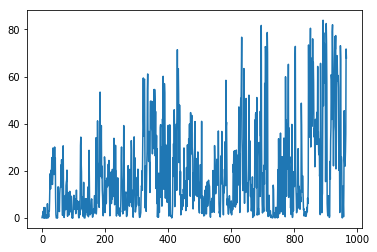

| Reward: 39 | Episode: 966| Epsilon:0.09362462501639007 


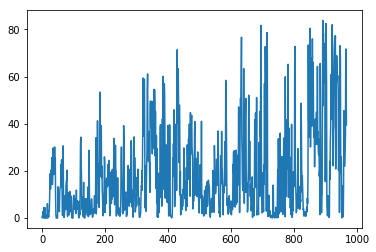

| Reward: 68 | Episode: 967| Epsilon:0.09354320660767673 


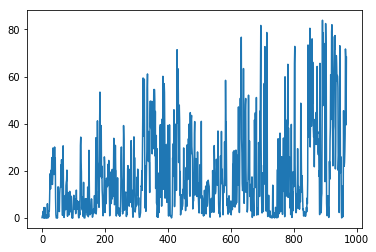

| Reward: 56 | Episode: 968| Epsilon:0.09344410284742585 


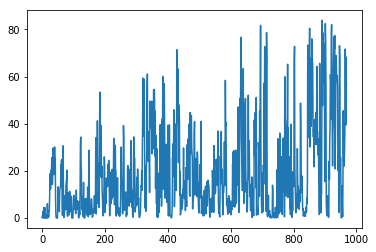

| Reward: 63 | Episode: 969| Epsilon:0.09335537265958206 


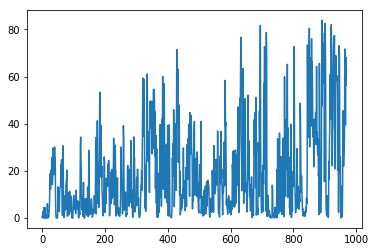

| Reward: 21 | Episode: 970| Epsilon:0.09326672672581098 


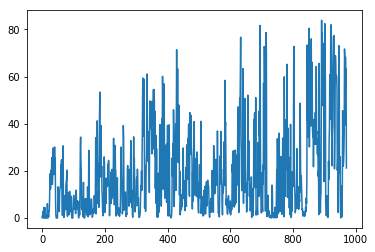

| Reward: 13 | Episode: 971| Epsilon:0.09318841517925756 


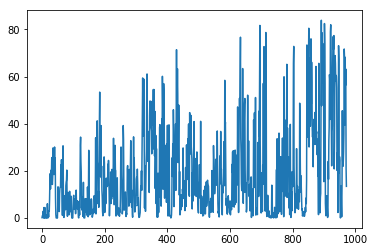

| Reward: 9 | Episode: 972| Epsilon:0.0931138938869988 


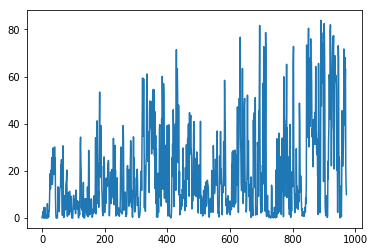

| Reward: 0 | Episode: 973| Epsilon:0.09302175628699969 


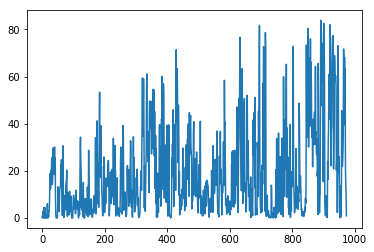

| Reward: 4 | Episode: 974| Epsilon:0.09293063916493464 


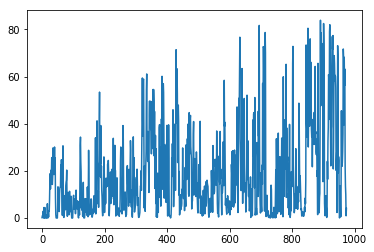

| Reward: 1 | Episode: 975| Epsilon:0.09285353835018773 


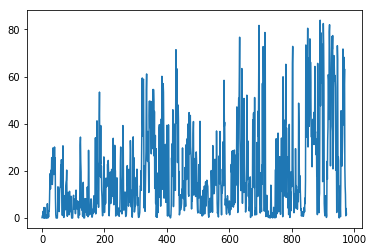

| Reward: 13 | Episode: 976| Epsilon:0.09274496269658246 


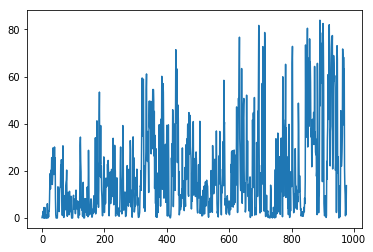

| Reward: 8 | Episode: 977| Epsilon:0.09265967614229906 


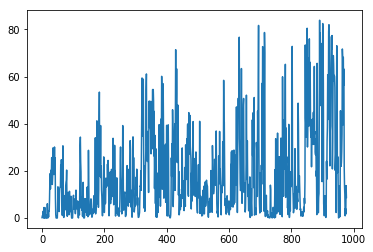

| Reward: 2 | Episode: 978| Epsilon:0.0925781710872523 


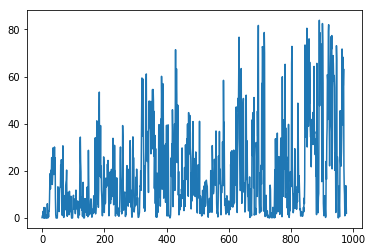

| Reward: 2 | Episode: 979| Epsilon:0.0924967377254628 


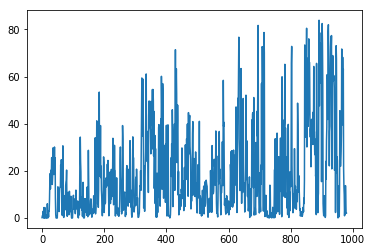

| Reward: 21 | Episode: 980| Epsilon:0.09239504674580218 


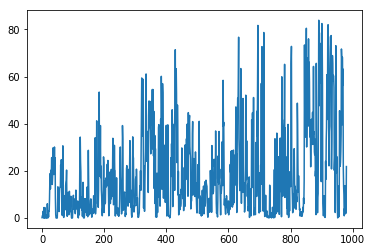

| Reward: 2 | Episode: 981| Epsilon:0.09230915886694288 


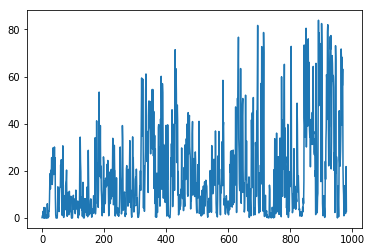

| Reward: 5 | Episode: 982| Epsilon:0.09223072902716063 


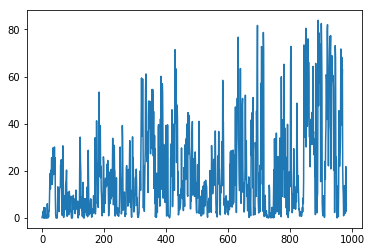

| Reward: 23 | Episode: 983| Epsilon:0.09214867978540847 


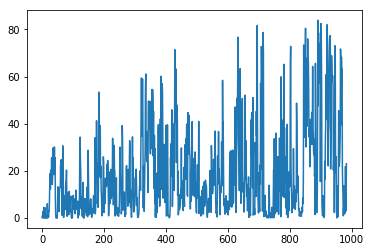

| Reward: 8 | Episode: 984| Epsilon:0.09204829194381574 


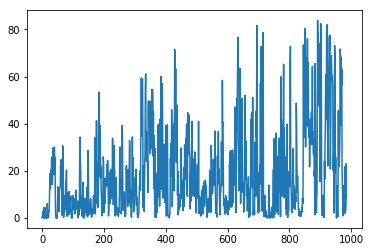

| Reward: 22 | Episode: 985| Epsilon:0.09195261100450157 


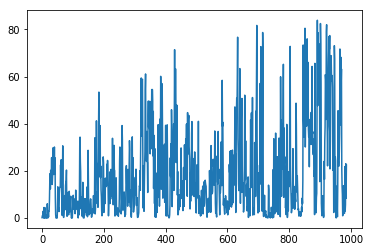

| Reward: 19 | Episode: 986| Epsilon:0.09187080917891015 


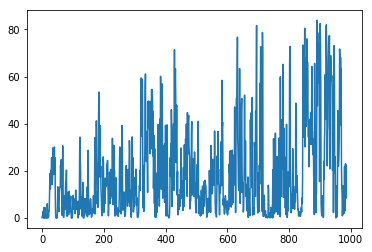

| Reward: 23 | Episode: 987| Epsilon:0.09177347722956712 


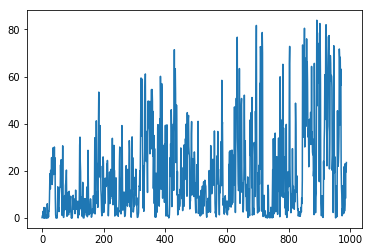

| Reward: 2 | Episode: 988| Epsilon:0.09168725026285969 


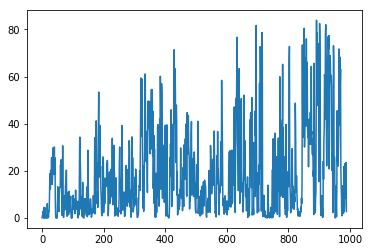

| Reward: 71 | Episode: 989| Epsilon:0.09160751664561538 


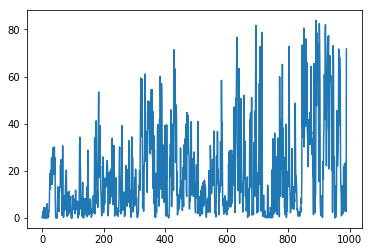

| Reward: 87 | Episode: 990| Epsilon:0.09152785236679813 


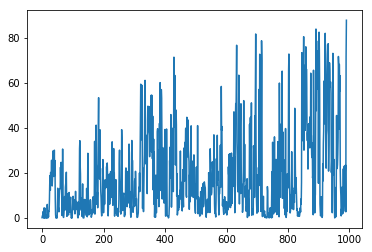

| Reward: 36 | Episode: 991| Epsilon:0.09145008635869166 


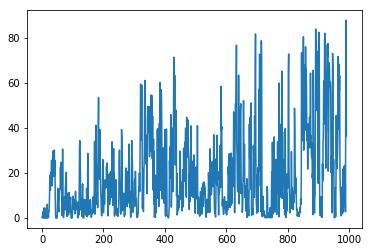

| Reward: 23 | Episode: 992| Epsilon:0.09136873158330344 


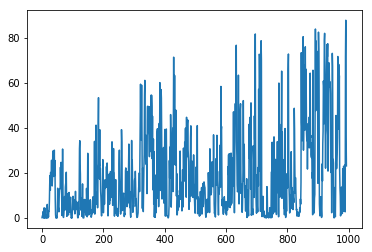

| Reward: 62 | Episode: 993| Epsilon:0.09128288490064346 


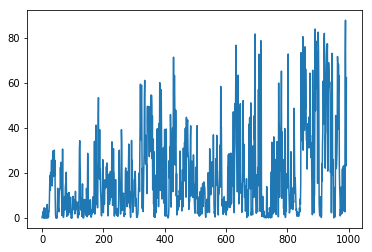

| Reward: 42 | Episode: 994| Epsilon:0.09120350293003396 


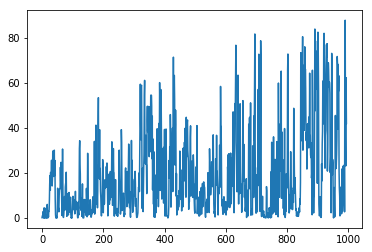

| Reward: 55 | Episode: 995| Epsilon:0.09111234455809433 


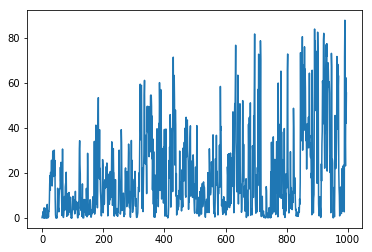

| Reward: 73 | Episode: 996| Epsilon:0.09103129024068726 


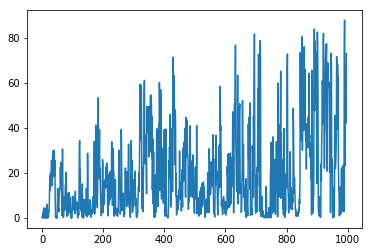

| Reward: 23 | Episode: 997| Epsilon:0.0909439416993214 


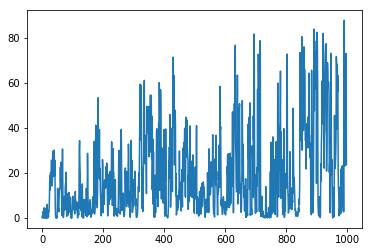

| Reward: 40 | Episode: 998| Epsilon:0.0908748502162614 


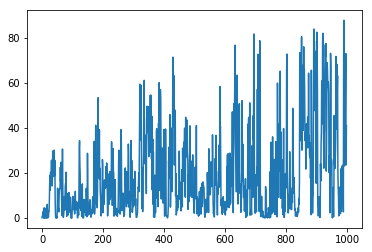

| Reward: 26 | Episode: 999| Epsilon:0.09078765178600468 


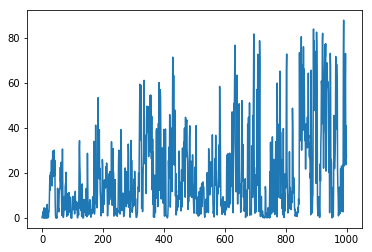

| Reward: 13 | Episode: 1000| Epsilon:0.09070688631805189 


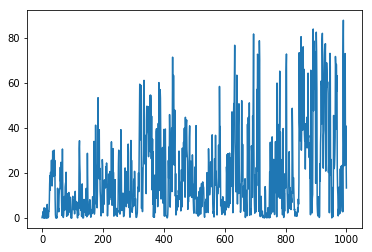

| Reward: 45 | Episode: 1001| Epsilon:0.09062438018495561 


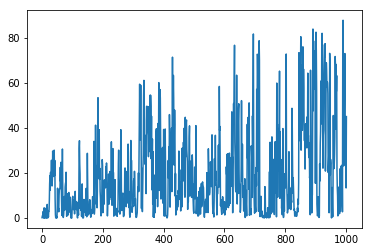

| Reward: 22 | Episode: 1002| Epsilon:0.09054375996480923 


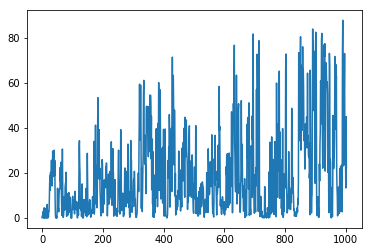

| Reward: 57 | Episode: 1003| Epsilon:0.09045416555102413 


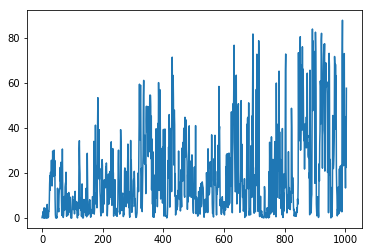

| Reward: 18 | Episode: 1004| Epsilon:0.09036194887957599 


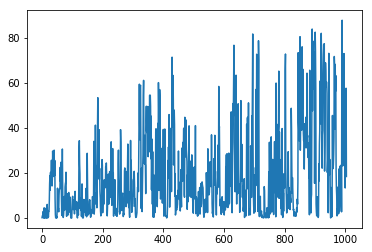

| Reward: 38 | Episode: 1005| Epsilon:0.09027975649833879 


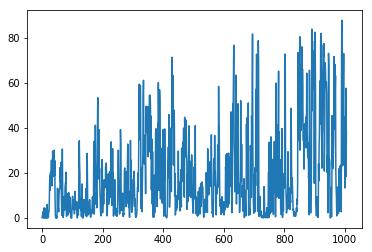

| Reward: 67 | Episode: 1006| Epsilon:0.09020846329876053 


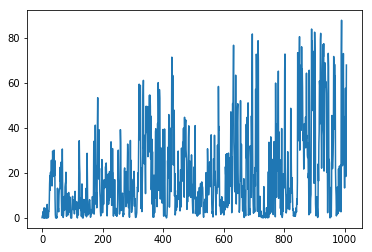

| Reward: 37 | Episode: 1007| Epsilon:0.09010928804964245 


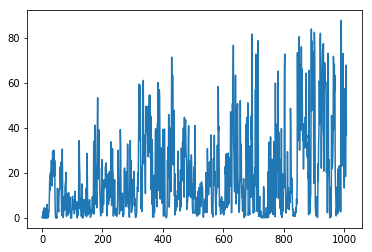

| Reward: 53 | Episode: 1008| Epsilon:0.0900354283507581 


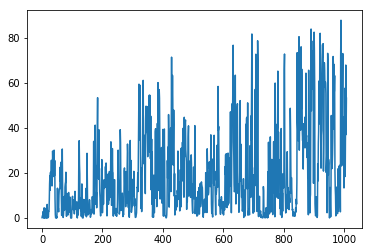

| Reward: 8 | Episode: 1009| Epsilon:0.08995982996871695 


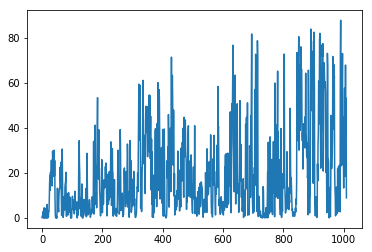

| Reward: 38 | Episode: 1010| Epsilon:0.08988249738605747 


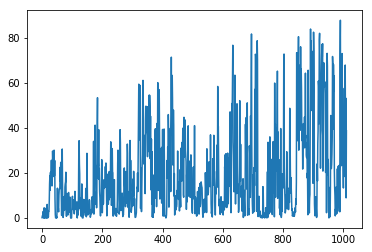

| Reward: 17 | Episode: 1011| Epsilon:0.0898034351855168 


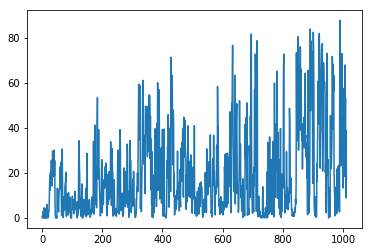

| Reward: 37 | Episode: 1012| Epsilon:0.08971277905175258 


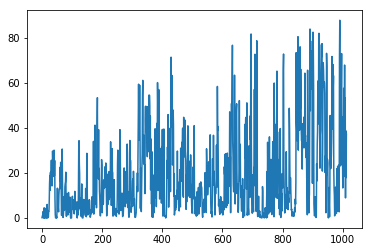

| Reward: 69 | Episode: 1013| Epsilon:0.0896293845347227 


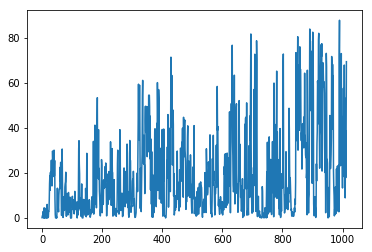

| Reward: 73 | Episode: 1014| Epsilon:0.08956218736242505 


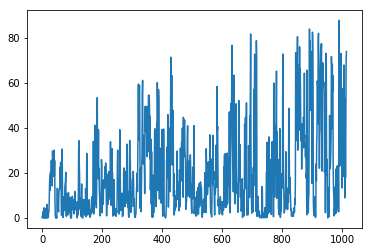

| Reward: 71 | Episode: 1015| Epsilon:0.08948251207805663 


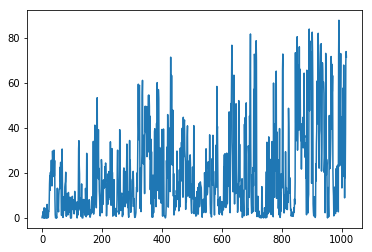

| Reward: 7 | Episode: 1016| Epsilon:0.08940111962428635 


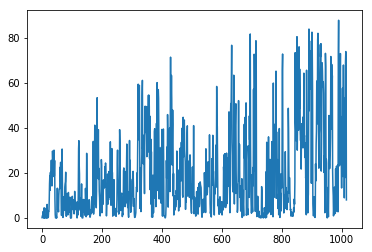

| Reward: 0 | Episode: 1017| Epsilon:0.08930729724493769 


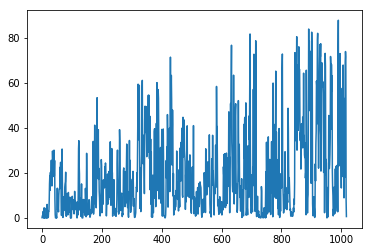

| Reward: 2 | Episode: 1018| Epsilon:0.08923052560198666 


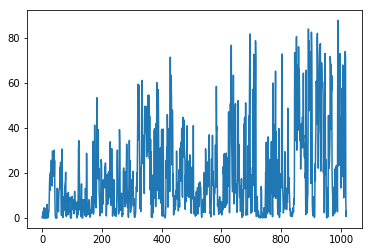

| Reward: 28 | Episode: 1019| Epsilon:0.08915916937102168 


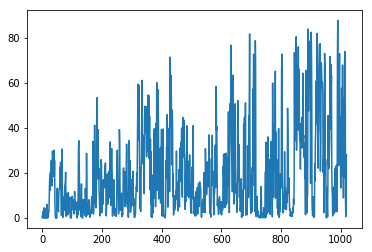

| Reward: 0 | Episode: 1020| Epsilon:0.08907718024603495 


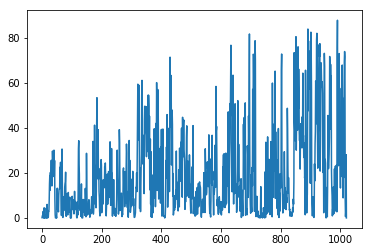

| Reward: 59 | Episode: 1021| Epsilon:0.0890014964345831 


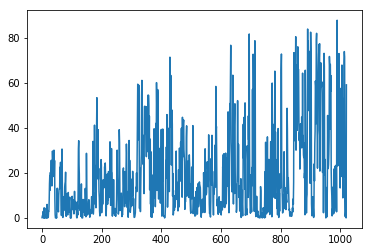

| Reward: 37 | Episode: 1022| Epsilon:0.08891698473982247 


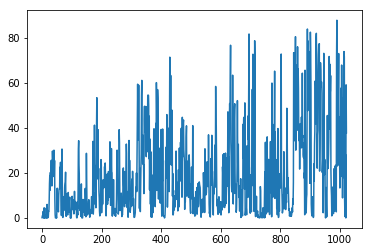

| Reward: 5 | Episode: 1023| Epsilon:0.08882900004461658 


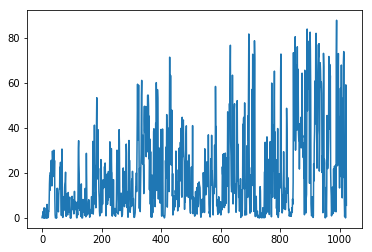

| Reward: 35 | Episode: 1024| Epsilon:0.08876506586398034 


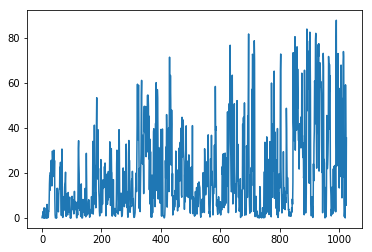

| Reward: 2 | Episode: 1025| Epsilon:0.08868166548938317 


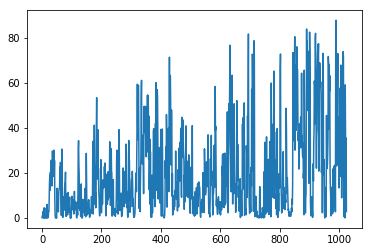

| Reward: 16 | Episode: 1026| Epsilon:0.08859479959411465 


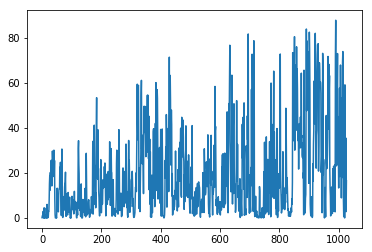

| Reward: 3 | Episode: 1027| Epsilon:0.08852129605112363 


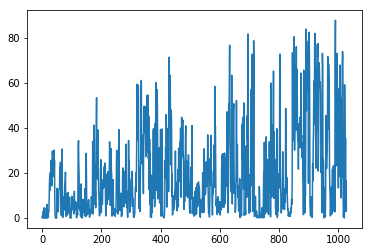

| Reward: 6 | Episode: 1028| Epsilon:0.08845669876289838 


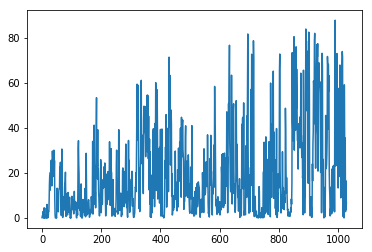

| Reward: 0 | Episode: 1029| Epsilon:0.08837712315053038 


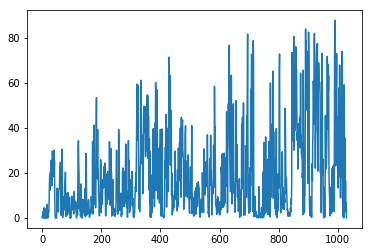

| Reward: 0 | Episode: 1030| Epsilon:0.08829143847643606 


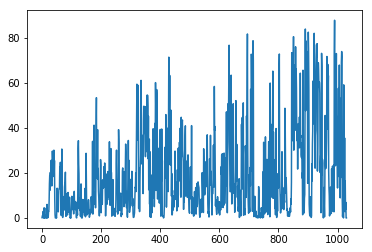

| Reward: 0 | Episode: 1031| Epsilon:0.08820142667295455 


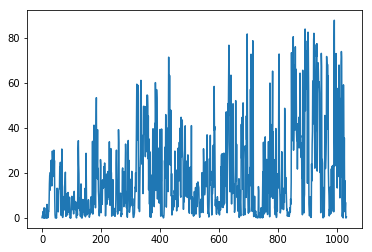

| Reward: 1 | Episode: 1032| Epsilon:0.08811855587290579 


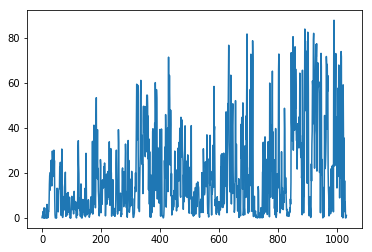

| Reward: 0 | Episode: 1033| Epsilon:0.08803840406090778 


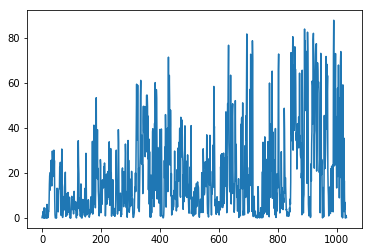

| Reward: 2 | Episode: 1034| Epsilon:0.08794513232899552 


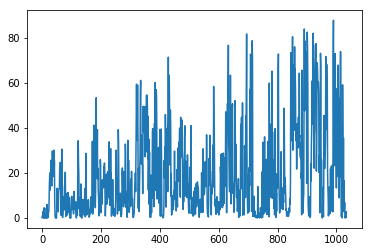

| Reward: 0 | Episode: 1035| Epsilon:0.08786162370861483 


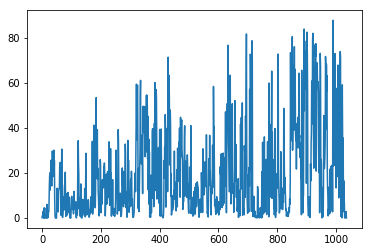

| Reward: 3 | Episode: 1036| Epsilon:0.08779926378437464 


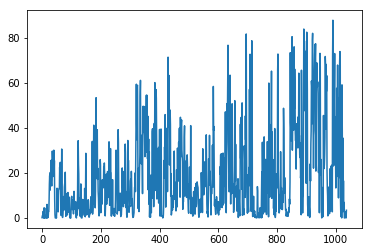

| Reward: 0 | Episode: 1037| Epsilon:0.08771326222350566 


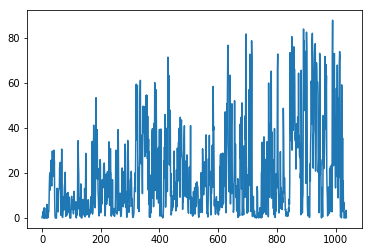

| Reward: 0 | Episode: 1038| Epsilon:0.08762383986208286 


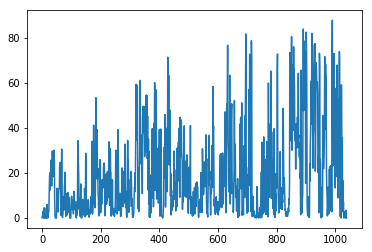

| Reward: 0 | Episode: 1039| Epsilon:0.08753801013330542 


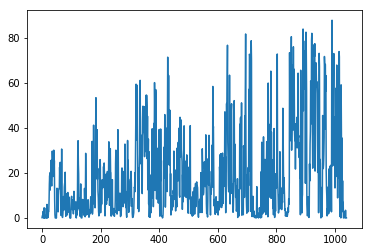

| Reward: 0 | Episode: 1040| Epsilon:0.08745926097287714 


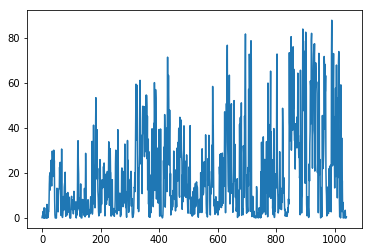

| Reward: 0 | Episode: 1041| Epsilon:0.08738757341635646 


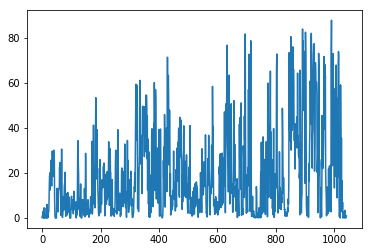

| Reward: 0 | Episode: 1042| Epsilon:0.087315944619831 


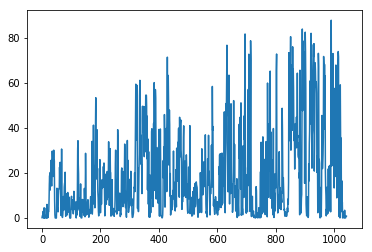

| Reward: 1 | Episode: 1043| Epsilon:0.08724262965637085 


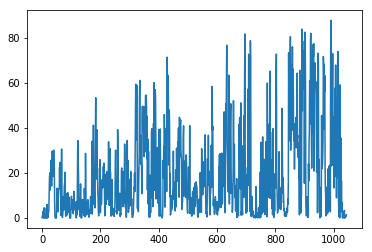

| Reward: 2 | Episode: 1044| Epsilon:0.08717286311415061 


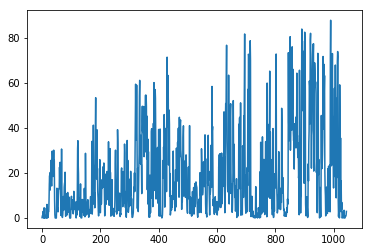

| Reward: 1 | Episode: 1045| Epsilon:0.0870918296326961 


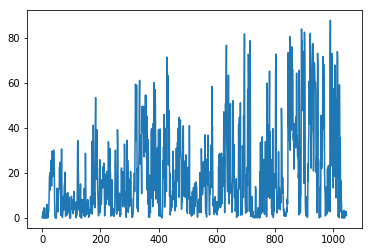

| Reward: 1 | Episode: 1046| Epsilon:0.08702914577083926 


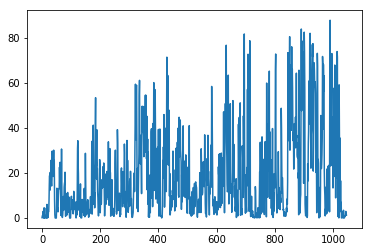

| Reward: 0 | Episode: 1047| Epsilon:0.08694911537620409 


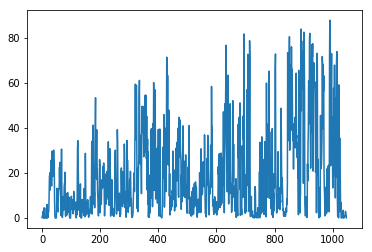

| Reward: 0 | Episode: 1048| Epsilon:0.08688305882290497 


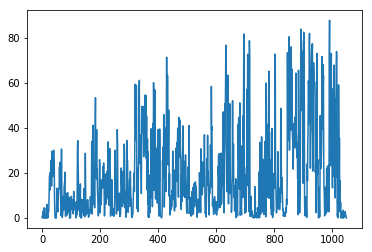

| Reward: 0 | Episode: 1049| Epsilon:0.08680403080743633 


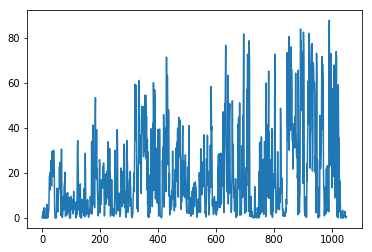

| Reward: 0 | Episode: 1050| Epsilon:0.08672854376482328 


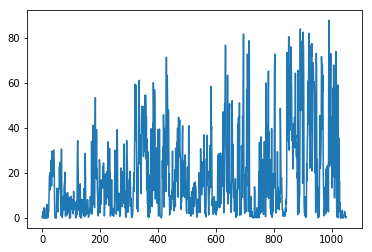

| Reward: 16 | Episode: 1051| Epsilon:0.08665398890759467 


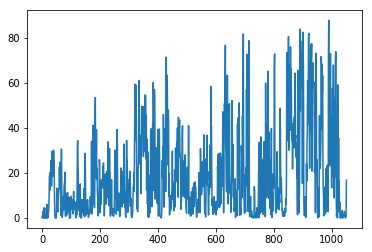

| Reward: 16 | Episode: 1052| Epsilon:0.08657343775724524 


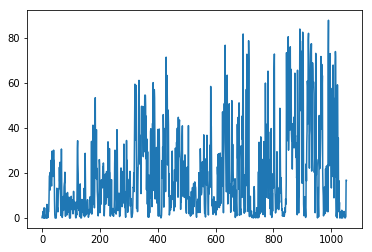

| Reward: 40 | Episode: 1053| Epsilon:0.08649815124434553 


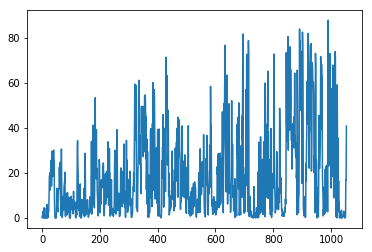

| Reward: 50 | Episode: 1054| Epsilon:0.08643416596996945 


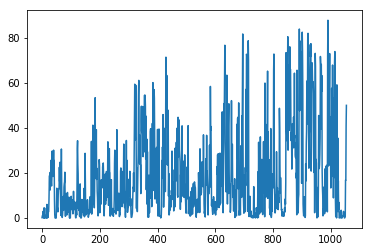

| Reward: 16 | Episode: 1055| Epsilon:0.08635640982732819 


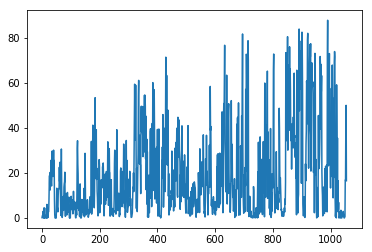

| Reward: 13 | Episode: 1056| Epsilon:0.08627440978417936 


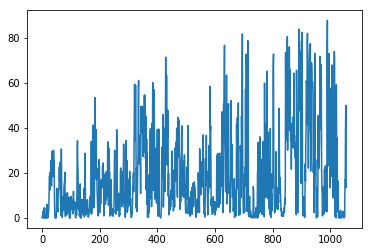

| Reward: 43 | Episode: 1057| Epsilon:0.08618473059087116 


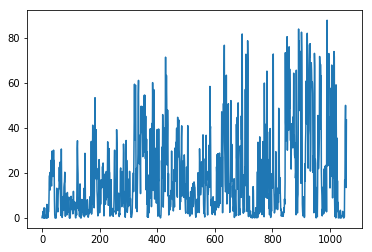

| Reward: 70 | Episode: 1058| Epsilon:0.08610719884020153 


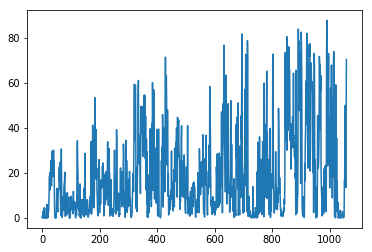

| Reward: 60 | Episode: 1059| Epsilon:0.08603145745761119 


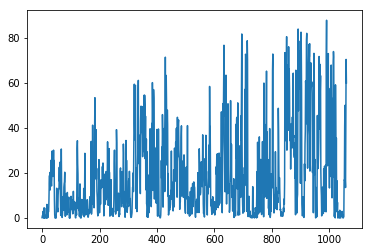

| Reward: 84 | Episode: 1060| Epsilon:0.08596437874949749 


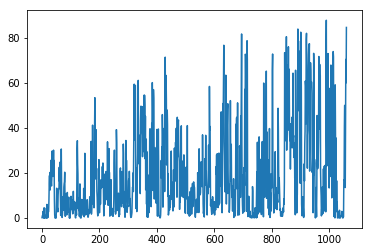

| Reward: 51 | Episode: 1061| Epsilon:0.08587759812464967 


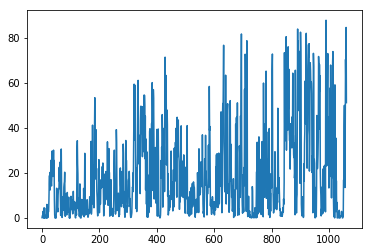

| Reward: 24 | Episode: 1062| Epsilon:0.08580463281606615 


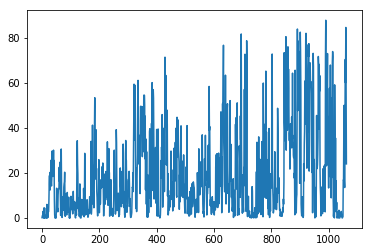

| Reward: 32 | Episode: 1063| Epsilon:0.08573944574341566 


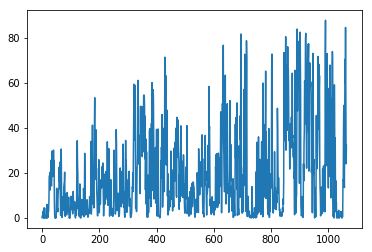

| Reward: 36 | Episode: 1064| Epsilon:0.08565717496044196 


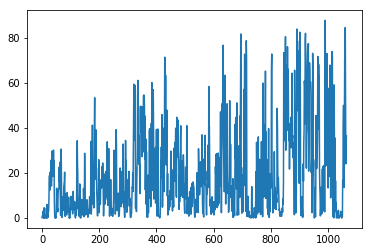

| Reward: 72 | Episode: 1065| Epsilon:0.08558867628110498 


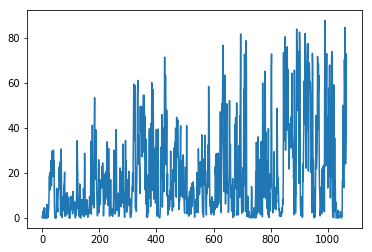

| Reward: 79 | Episode: 1066| Epsilon:0.085518521982976 


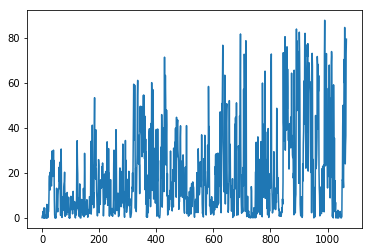

| Reward: 37 | Episode: 1067| Epsilon:0.08544415285226752 


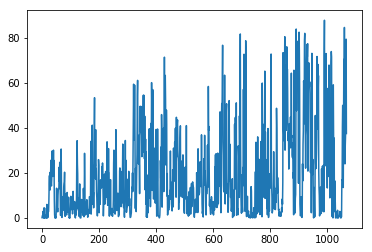

| Reward: 64 | Episode: 1068| Epsilon:0.08538180107009567 


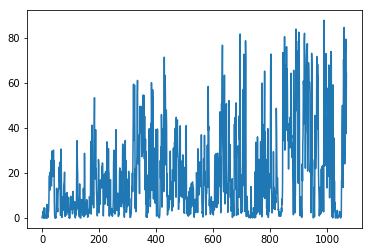

| Reward: 29 | Episode: 1069| Epsilon:0.08530840391948782 


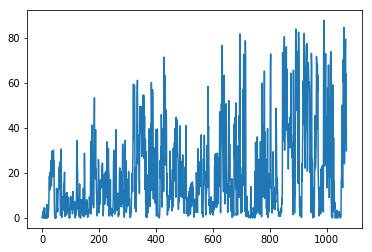

| Reward: 4 | Episode: 1070| Epsilon:0.08523506986361039 


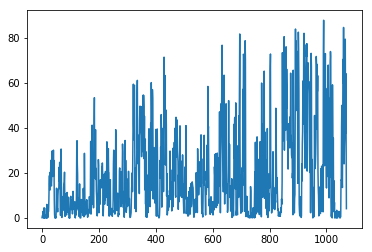

| Reward: 2 | Episode: 1071| Epsilon:0.08516605706591303 


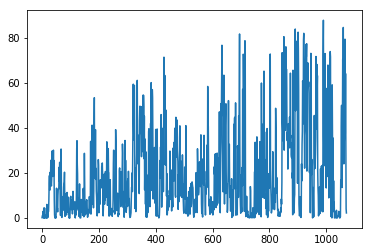

| Reward: 0 | Episode: 1072| Epsilon:0.08509624917522607 


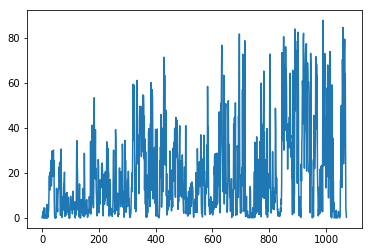

| Reward: 0 | Episode: 1073| Epsilon:0.08503245059680899 


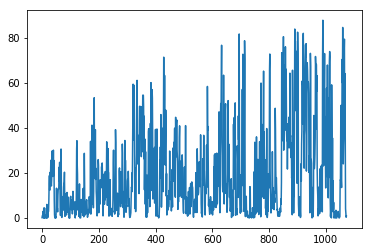

| Reward: 4 | Episode: 1074| Epsilon:0.08496275221906774 


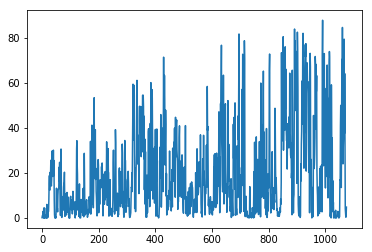

| Reward: 22 | Episode: 1075| Epsilon:0.08488971529735236 


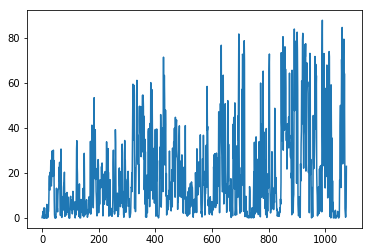

| Reward: 23 | Episode: 1076| Epsilon:0.08481165228345589 


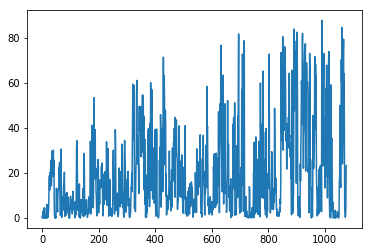

| Reward: 31 | Episode: 1077| Epsilon:0.08474044005280058 


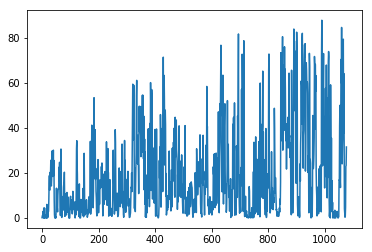

| Reward: 31 | Episode: 1078| Epsilon:0.08467606146343 


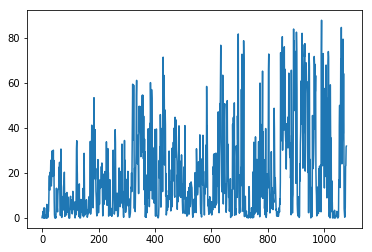

| Reward: 24 | Episode: 1079| Epsilon:0.0846151163373287 


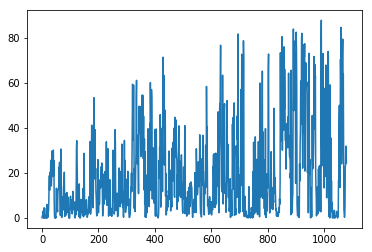

| Reward: 64 | Episode: 1080| Epsilon:0.08454237825544625 


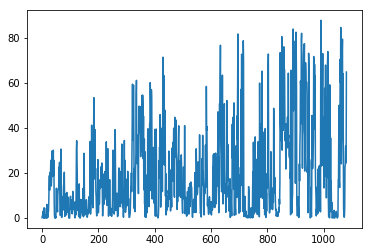

| Reward: 11 | Episode: 1081| Epsilon:0.0844730815743153 


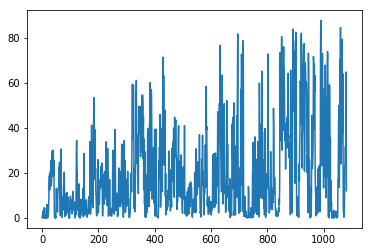

| Reward: 5 | Episode: 1082| Epsilon:0.08440130960352589 


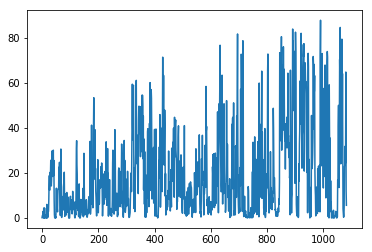

| Reward: 41 | Episode: 1083| Epsilon:0.08434056222855348 


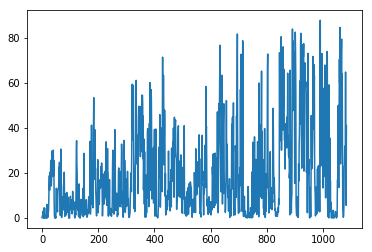

| Reward: 37 | Episode: 1084| Epsilon:0.08425879113972572 


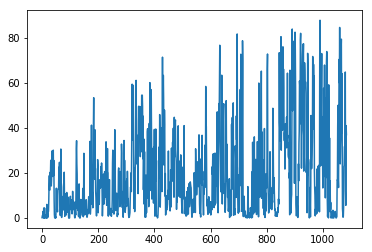

| Reward: 18 | Episode: 1085| Epsilon:0.08418467564854414 


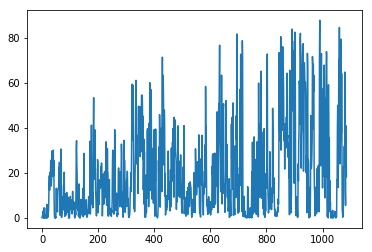

| Reward: 76 | Episode: 1086| Epsilon:0.0841139898597578 


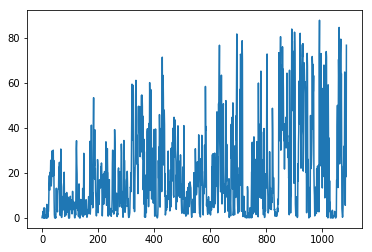

| Reward: 65 | Episode: 1087| Epsilon:0.08404756571663877 


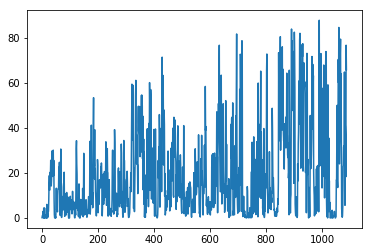

| Reward: 84 | Episode: 1088| Epsilon:0.08398287367720804 


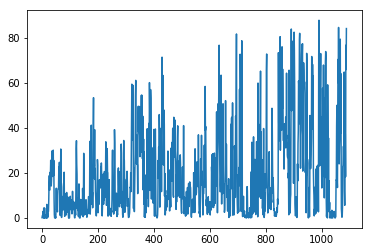

| Reward: 85 | Episode: 1089| Epsilon:0.08392494519235379 


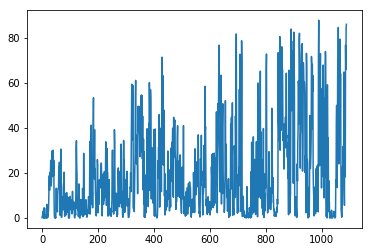

| Reward: 90 | Episode: 1090| Epsilon:0.08385699317127146 


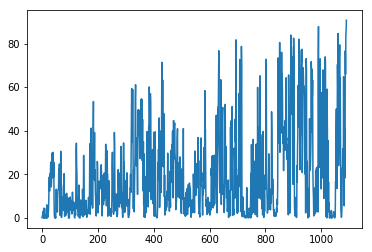

| Reward: 81 | Episode: 1091| Epsilon:0.08377904203076493 


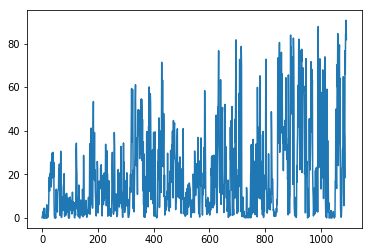

| Reward: 35 | Episode: 1092| Epsilon:0.08370953392819153 


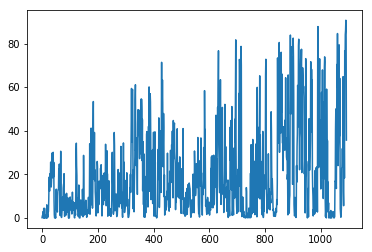

| Reward: 49 | Episode: 1093| Epsilon:0.0836359015731606 


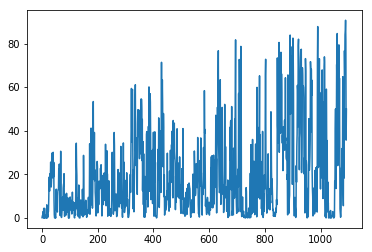

| Reward: 7 | Episode: 1094| Epsilon:0.08355230705783845 


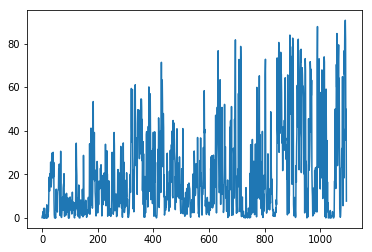

| Reward: 77 | Episode: 1095| Epsilon:0.08348298706815553 


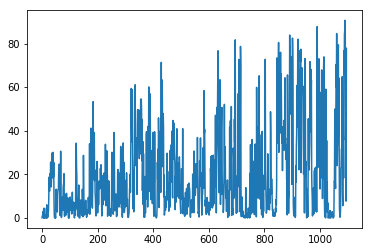

| Reward: 60 | Episode: 1096| Epsilon:0.0834145587360681 


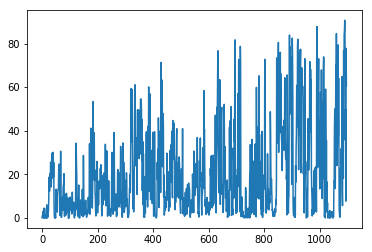

| Reward: 7 | Episode: 1097| Epsilon:0.08333951903093932 


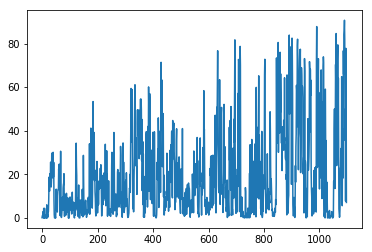

| Reward: 8 | Episode: 1098| Epsilon:0.08326288154889042 


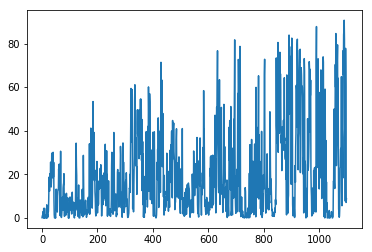

| Reward: 7 | Episode: 1099| Epsilon:0.08318465082328201 


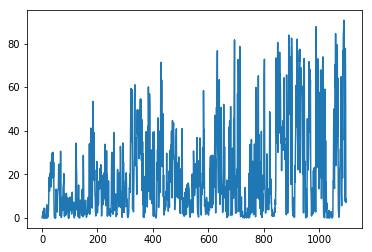

| Reward: 22 | Episode: 1100| Epsilon:0.0831164670278644 


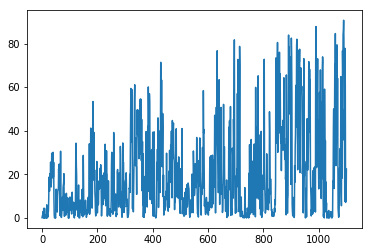

| Reward: 30 | Episode: 1101| Epsilon:0.08303173103052101 


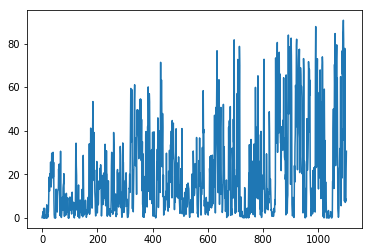

| Reward: 4 | Episode: 1102| Epsilon:0.08296284294183653 


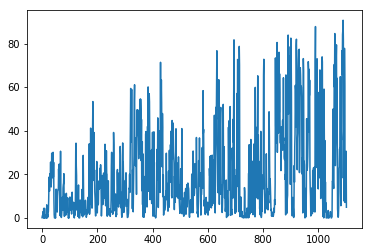

| Reward: 3 | Episode: 1103| Epsilon:0.08288903849044833 


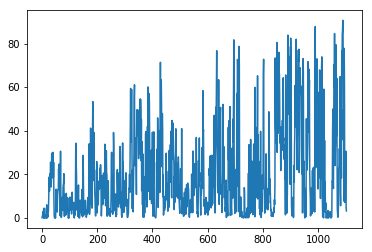

| Reward: 3 | Episode: 1104| Epsilon:0.08281612785740707 


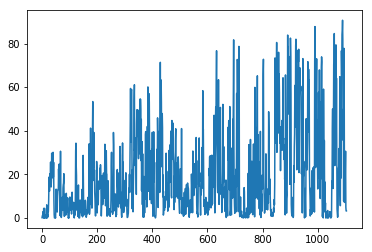

| Reward: 0 | Episode: 1105| Epsilon:0.08274162650046785 


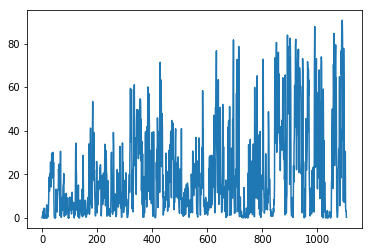

| Reward: 77 | Episode: 1106| Epsilon:0.08267793965221128 


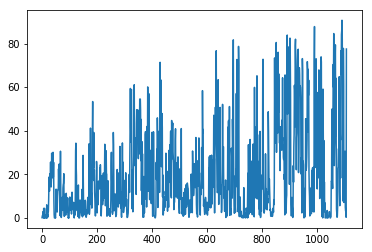

| Reward: 52 | Episode: 1107| Epsilon:0.08262173748313982 


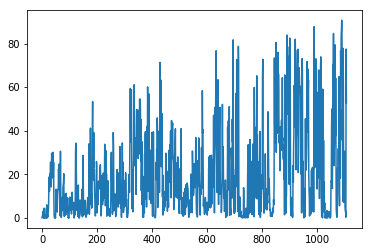

| Reward: 2 | Episode: 1108| Epsilon:0.08255236401772102 


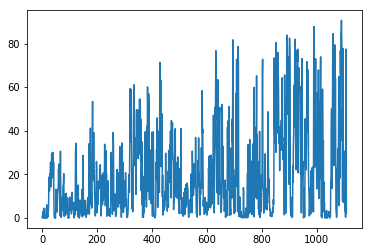

| Reward: 37 | Episode: 1109| Epsilon:0.08250037214758912 


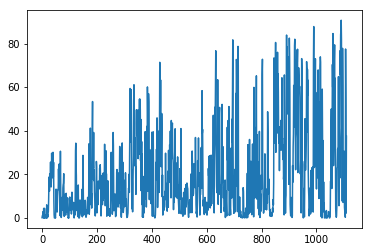

| Reward: 57 | Episode: 1110| Epsilon:0.08244346624107306 


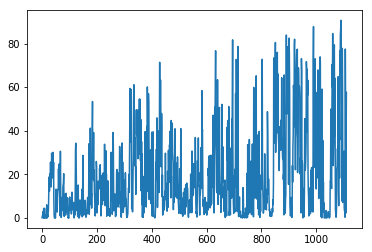

| Reward: 27 | Episode: 1111| Epsilon:0.08236847643737996 


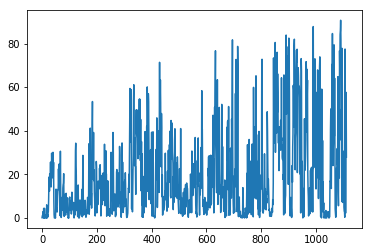

| Reward: 20 | Episode: 1112| Epsilon:0.08229849262982074 


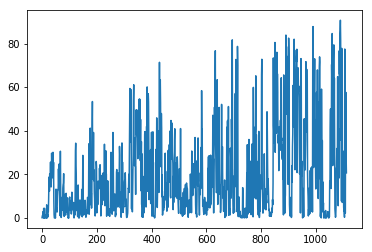

| Reward: 19 | Episode: 1113| Epsilon:0.08223021287955513 


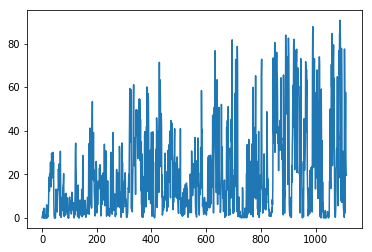

| Reward: 40 | Episode: 1114| Epsilon:0.08215952494320812 


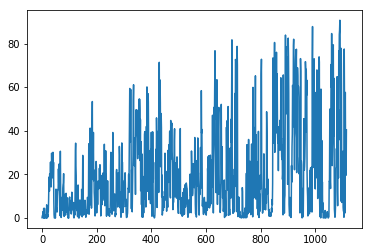

| Reward: 27 | Episode: 1115| Epsilon:0.08210531727620493 


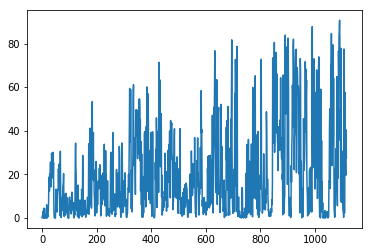

| Reward: 35 | Episode: 1116| Epsilon:0.0820380181759448 


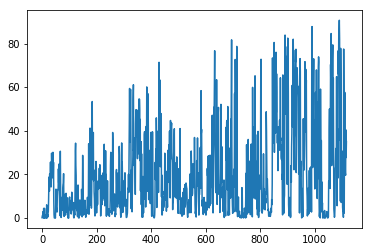

| Reward: 39 | Episode: 1117| Epsilon:0.08196175790426238 


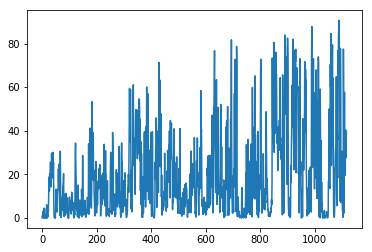

| Reward: 35 | Episode: 1118| Epsilon:0.08188884402664641 


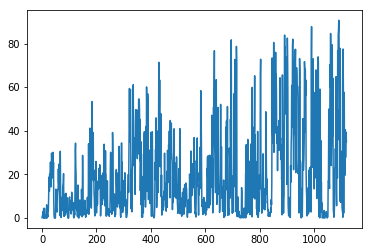

| Reward: 20 | Episode: 1119| Epsilon:0.08180781378249755 


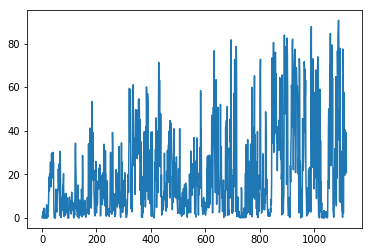

| Reward: 25 | Episode: 1120| Epsilon:0.08174975055927905 


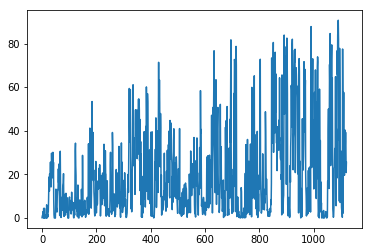

| Reward: 16 | Episode: 1121| Epsilon:0.08168029244789218 


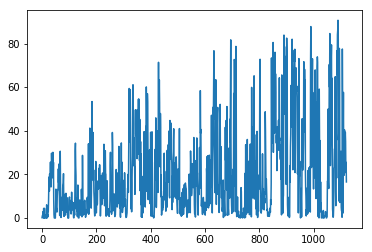

| Reward: 22 | Episode: 1122| Epsilon:0.08161497401819696 


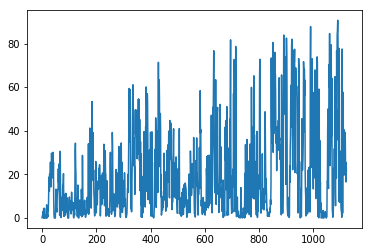

| Reward: 18 | Episode: 1123| Epsilon:0.08155949442366642 


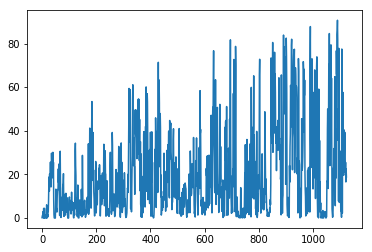

| Reward: 28 | Episode: 1124| Epsilon:0.08149753244662797 


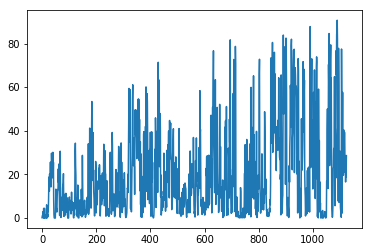

| Reward: 18 | Episode: 1125| Epsilon:0.08141200451993841 


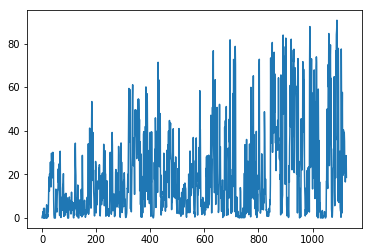

| Reward: 9 | Episode: 1126| Epsilon:0.08135259514665123 


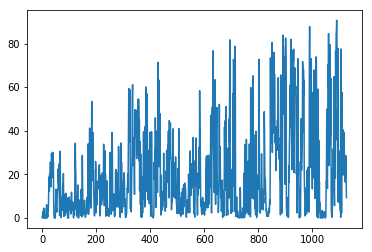

| Reward: 15 | Episode: 1127| Epsilon:0.08128591302862496 


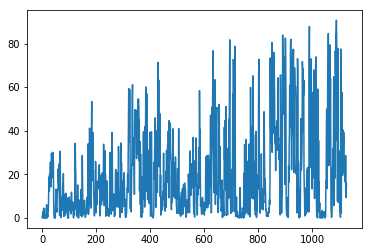

| Reward: 5 | Episode: 1128| Epsilon:0.0812209099778737 


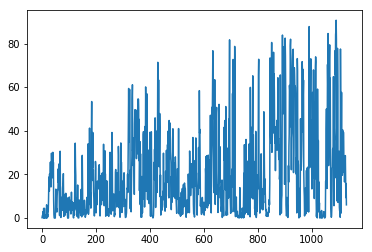

| Reward: 24 | Episode: 1129| Epsilon:0.08113486099706883 


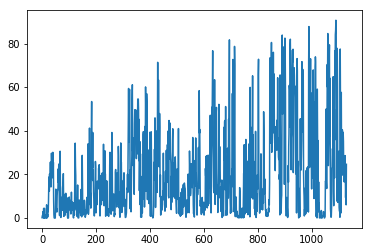

| Reward: 37 | Episode: 1130| Epsilon:0.08106349336891502 


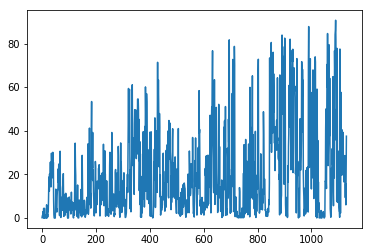

| Reward: 15 | Episode: 1131| Epsilon:0.0809970482183614 


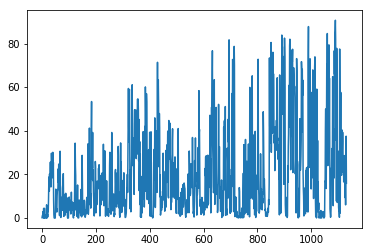

| Reward: 4 | Episode: 1132| Epsilon:0.08093146684543912 


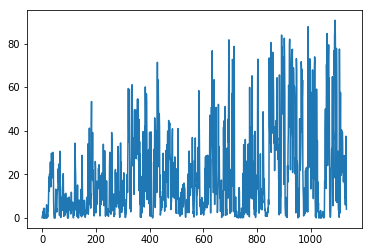

| Reward: 3 | Episode: 1133| Epsilon:0.0808643212615013 


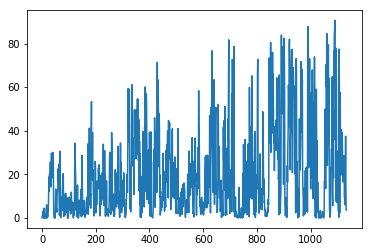

| Reward: 1 | Episode: 1134| Epsilon:0.08079399954477727 


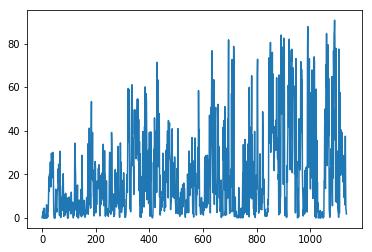

| Reward: 2 | Episode: 1135| Epsilon:0.08072777528968439 


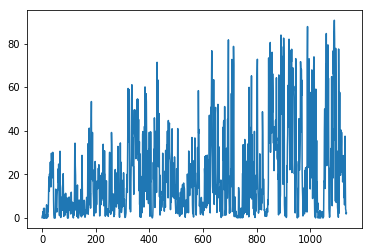

| Reward: 1 | Episode: 1136| Epsilon:0.0806712853383213 


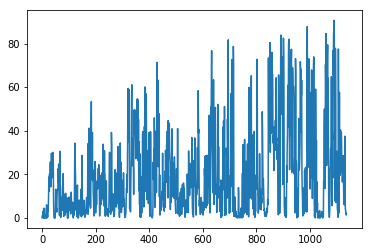

| Reward: 0 | Episode: 1137| Epsilon:0.08061564107269562 


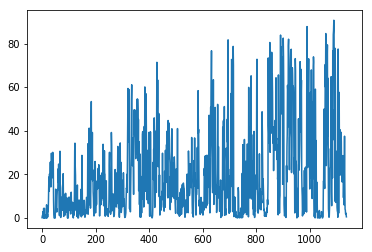

| Reward: 2 | Episode: 1138| Epsilon:0.08054875751670271 


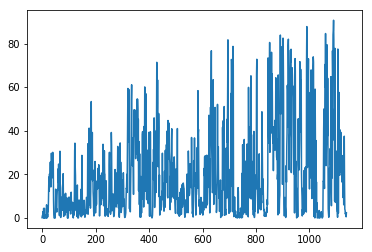

| Reward: 3 | Episode: 1139| Epsilon:0.08048675853609055 


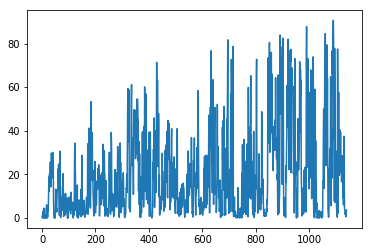

| Reward: 37 | Episode: 1140| Epsilon:0.08041837351715991 


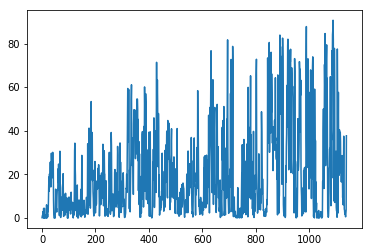

| Reward: 0 | Episode: 1141| Epsilon:0.08036611829788352 


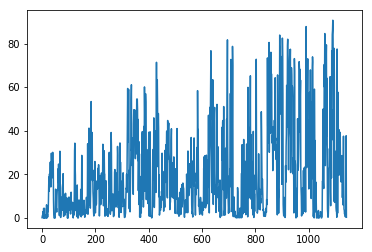

| Reward: 2 | Episode: 1142| Epsilon:0.08030666907202319 


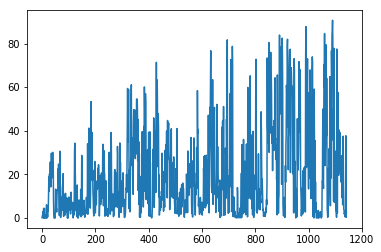

| Reward: 8 | Episode: 1143| Epsilon:0.08025368389254209 


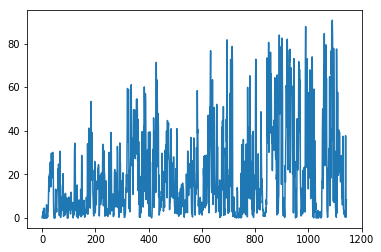

| Reward: 31 | Episode: 1144| Epsilon:0.08019351589460208 


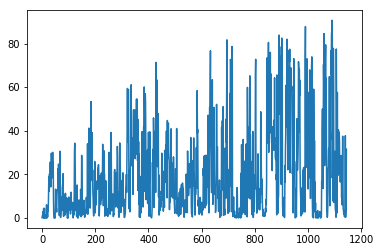

| Reward: 42 | Episode: 1145| Epsilon:0.080133393005968 


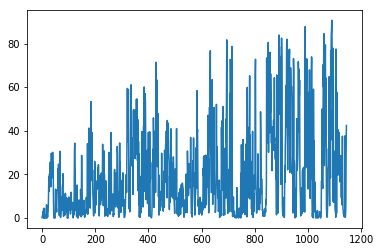

| Reward: 10 | Episode: 1146| Epsilon:0.08006931160713314 


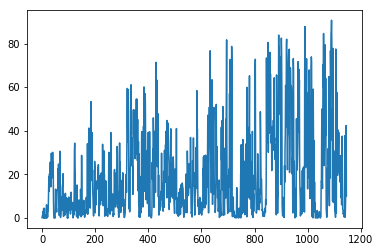

| Reward: 4 | Episode: 1147| Epsilon:0.08001568286784635 


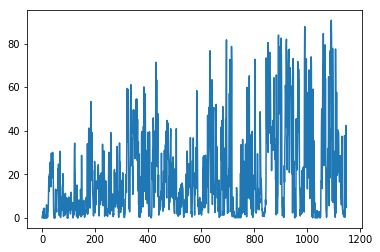

| Reward: 8 | Episode: 1148| Epsilon:0.07995569330464569 


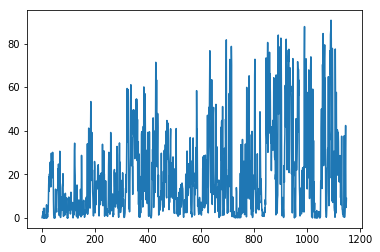

| Reward: 2 | Episode: 1149| Epsilon:0.07989015618234246 


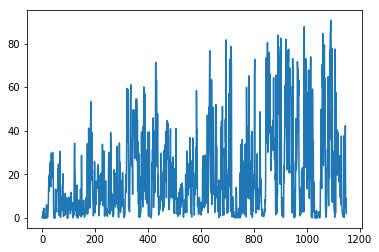

| Reward: 9 | Episode: 1150| Epsilon:0.07982706756679939 


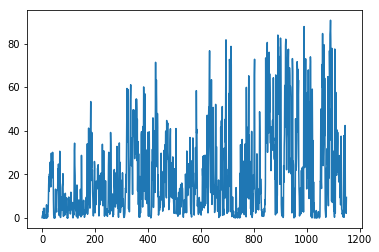

| Reward: 2 | Episode: 1151| Epsilon:0.07976083825853716 


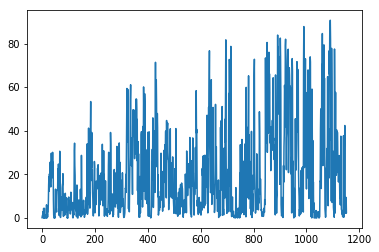

| Reward: 11 | Episode: 1152| Epsilon:0.07971140161857548 


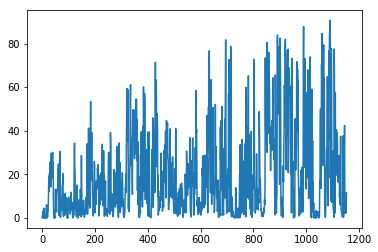

| Reward: 1 | Episode: 1153| Epsilon:0.0796349150100346 


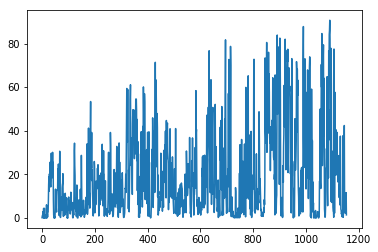

| Reward: 2 | Episode: 1154| Epsilon:0.07957998559685728 


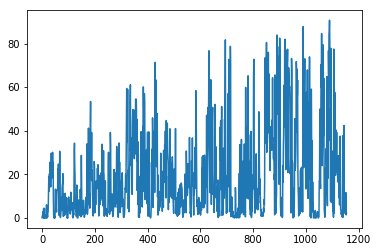

| Reward: 2 | Episode: 1155| Epsilon:0.07951396128257085 


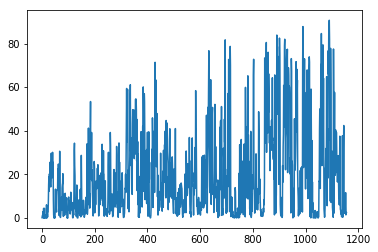

| Reward: 1 | Episode: 1156| Epsilon:0.07944640279411323 


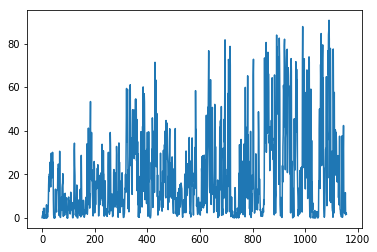

| Reward: 2 | Episode: 1157| Epsilon:0.07938684003303102 


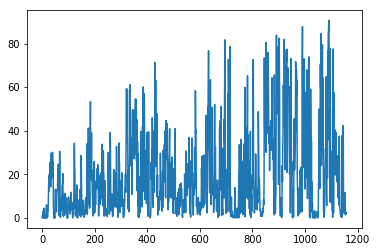

| Reward: 1 | Episode: 1158| Epsilon:0.0793368418249083 


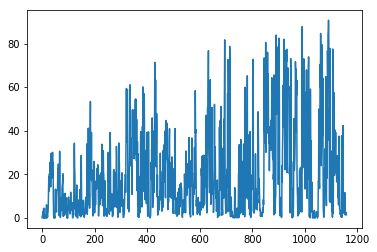

| Reward: 0 | Episode: 1159| Epsilon:0.07927260468139936 


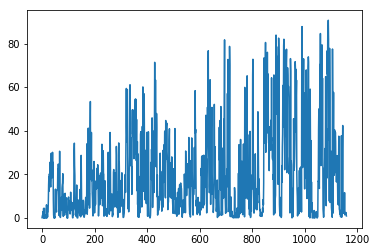

| Reward: 2 | Episode: 1160| Epsilon:0.07920604332034543 


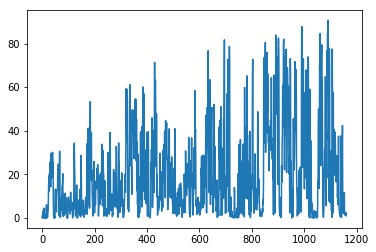

| Reward: 1 | Episode: 1161| Epsilon:0.07913241557412728 


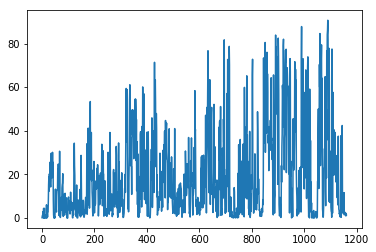

| Reward: 7 | Episode: 1162| Epsilon:0.07907150676249285 


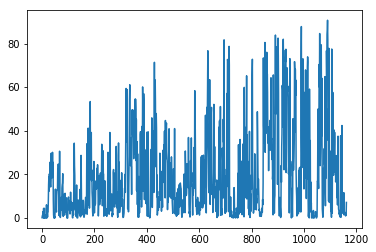

| Reward: 6 | Episode: 1163| Epsilon:0.07901143494717533 


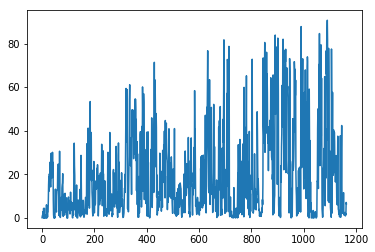

| Reward: 0 | Episode: 1164| Epsilon:0.07894351398371621 


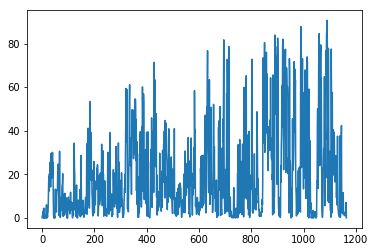

| Reward: 3 | Episode: 1165| Epsilon:0.07888196174354183 


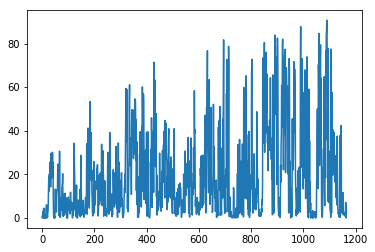

| Reward: 2 | Episode: 1166| Epsilon:0.07882124570809243 


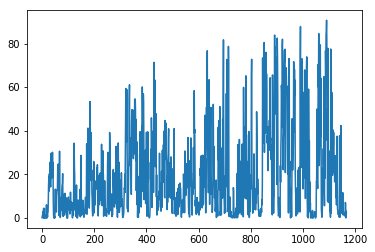

| Reward: 1 | Episode: 1167| Epsilon:0.07876372690804764 


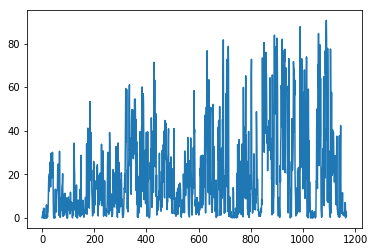

| Reward: 19 | Episode: 1168| Epsilon:0.07870388891772388 


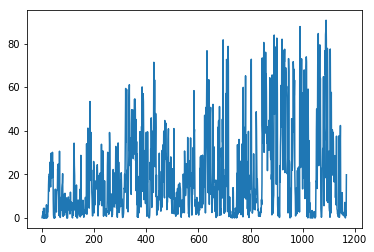

| Reward: 7 | Episode: 1169| Epsilon:0.07863308692936166 


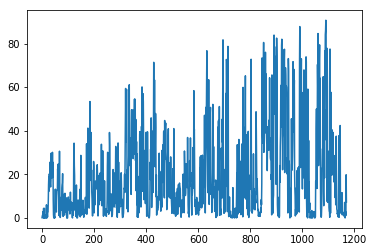

| Reward: 11 | Episode: 1170| Epsilon:0.0785670625403444 


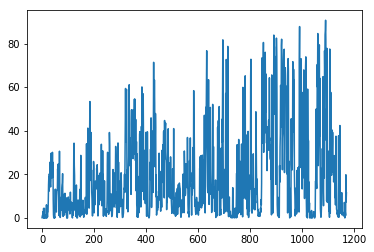

| Reward: 2 | Episode: 1171| Epsilon:0.07850815904049496 


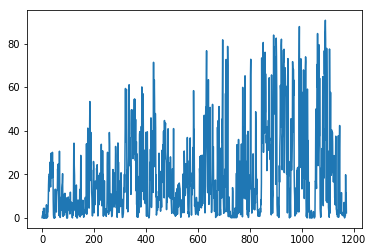

| Reward: 1 | Episode: 1172| Epsilon:0.07845086871145783 


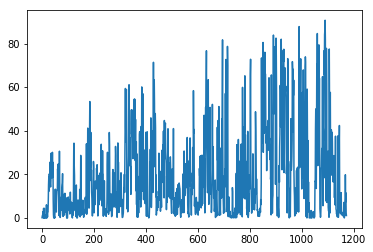

| Reward: 0 | Episode: 1173| Epsilon:0.07840224400494969 


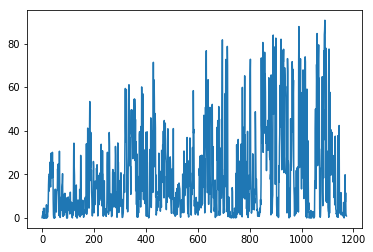

| Reward: 0 | Episode: 1174| Epsilon:0.07832074764915307 


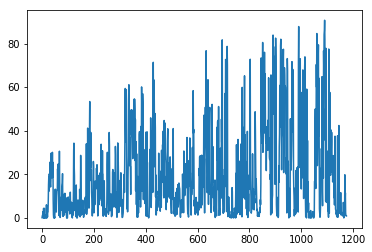

| Reward: 32 | Episode: 1175| Epsilon:0.07826359408119157 


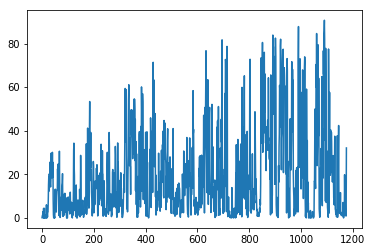

| Reward: 47 | Episode: 1176| Epsilon:0.07821039266174178 


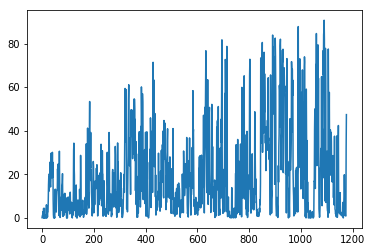

| Reward: 71 | Episode: 1177| Epsilon:0.07815097504778387 


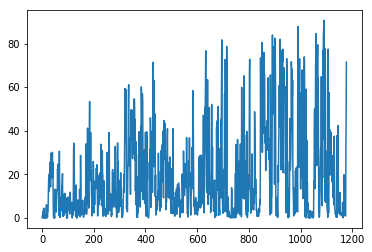

| Reward: 70 | Episode: 1178| Epsilon:0.078093164429762 


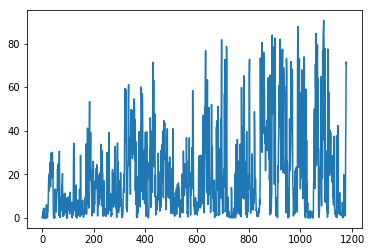

| Reward: 59 | Episode: 1179| Epsilon:0.07803227520694445 


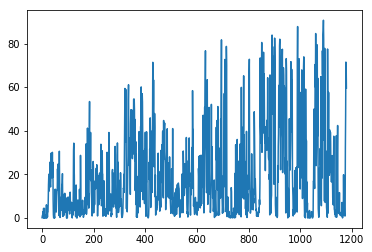

| Reward: 35 | Episode: 1180| Epsilon:0.07797923103164625 


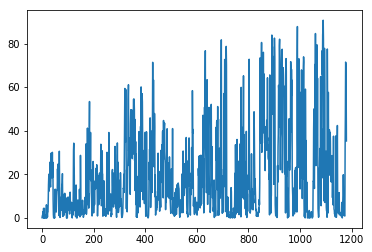

| Reward: 25 | Episode: 1181| Epsilon:0.07792310591214528 


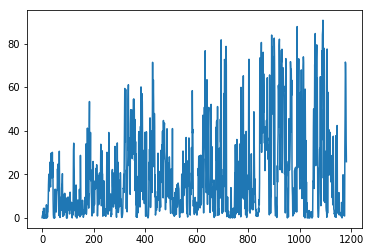

| Reward: 2 | Episode: 1182| Epsilon:0.07784911374341258 


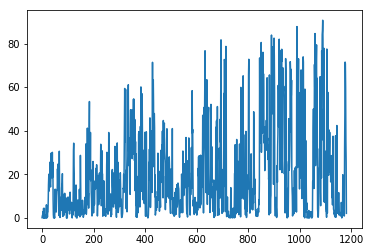

| Reward: 26 | Episode: 1183| Epsilon:0.07778997059849346 


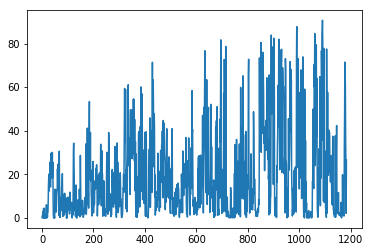

| Reward: 55 | Episode: 1184| Epsilon:0.07773709113514413 


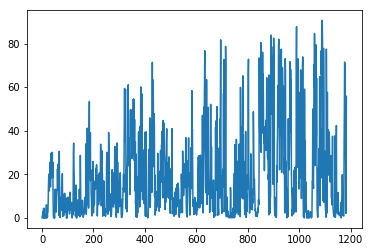

| Reward: 46 | Episode: 1185| Epsilon:0.07768269394060268 


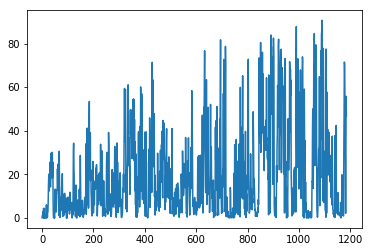

| Reward: 48 | Episode: 1186| Epsilon:0.07762445347185046 


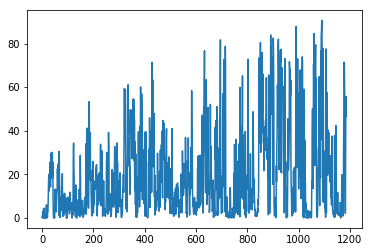

| Reward: 59 | Episode: 1187| Epsilon:0.07756005158393983 


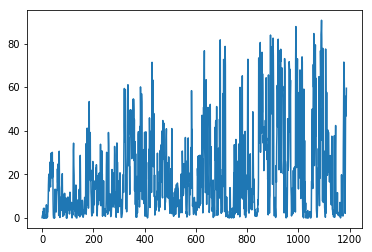

| Reward: 75 | Episode: 1188| Epsilon:0.07750422816652396 


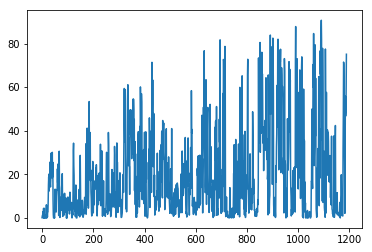

| Reward: 44 | Episode: 1189| Epsilon:0.07745076842752115 


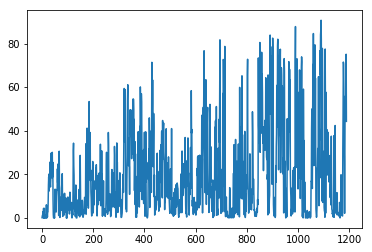

| Reward: 59 | Episode: 1190| Epsilon:0.07738496291663406 


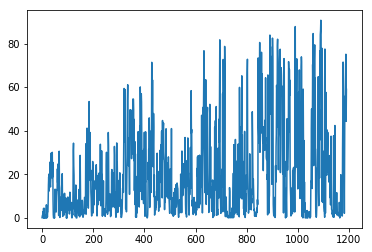

| Reward: 24 | Episode: 1191| Epsilon:0.07733081212682585 


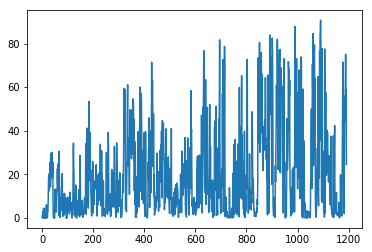

| Reward: 11 | Episode: 1192| Epsilon:0.07727283547181059 


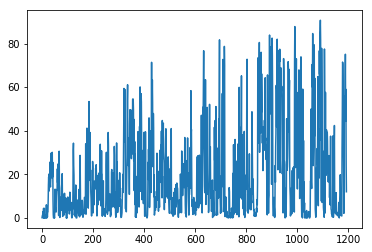

| Reward: 37 | Episode: 1193| Epsilon:0.07721490228320198 


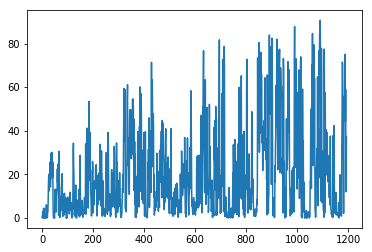

| Reward: 62 | Episode: 1194| Epsilon:0.07716164211119794 


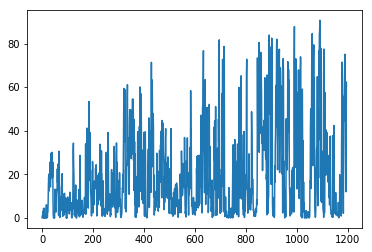

| Reward: 46 | Episode: 1195| Epsilon:0.07710225021862577 


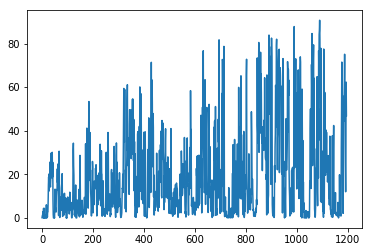

| Reward: 51 | Episode: 1196| Epsilon:0.07703134841374655 


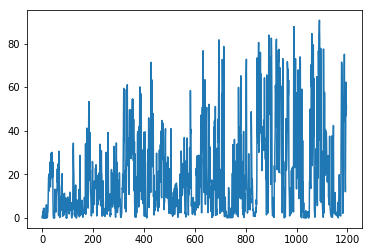

| Reward: 47 | Episode: 1197| Epsilon:0.07696435994989108 


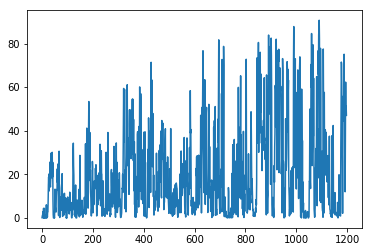

| Reward: 59 | Episode: 1198| Epsilon:0.07691281084185851 


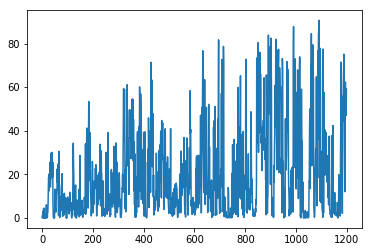

| Reward: 63 | Episode: 1199| Epsilon:0.07686129626033324 


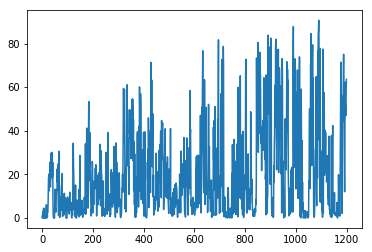

| Reward: 43 | Episode: 1200| Epsilon:0.07680136752485155 


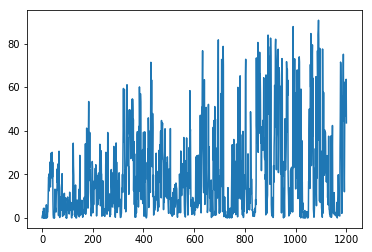

| Reward: 87 | Episode: 1201| Epsilon:0.07673150972123614 


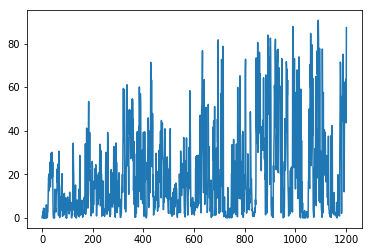

| Reward: 81 | Episode: 1202| Epsilon:0.0766739823767591 


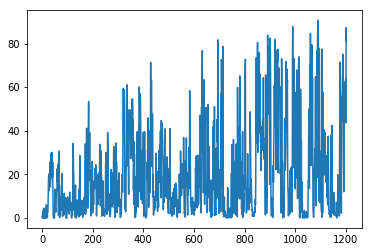

| Reward: 81 | Episode: 1203| Epsilon:0.07662799155600472 


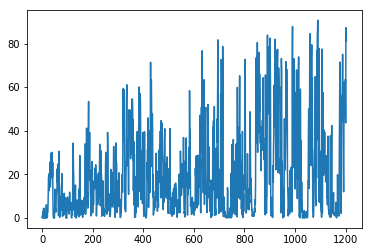

| Reward: 93 | Episode: 1204| Epsilon:0.07658509167932041 


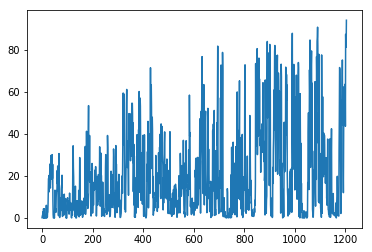

| Reward: 88 | Episode: 1205| Epsilon:0.0765192564844914 


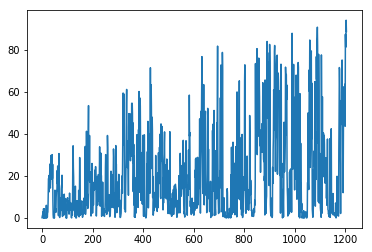

| Reward: 83 | Episode: 1206| Epsilon:0.07647106429407896 


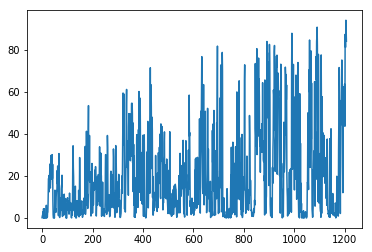

| Reward: 91 | Episode: 1207| Epsilon:0.07640303498424388 


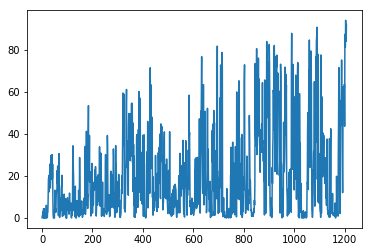

| Reward: 92 | Episode: 1208| Epsilon:0.07633888306167687 


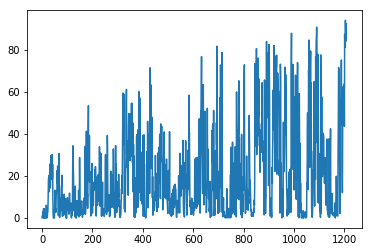

| Reward: 92 | Episode: 1209| Epsilon:0.07629156738697493 


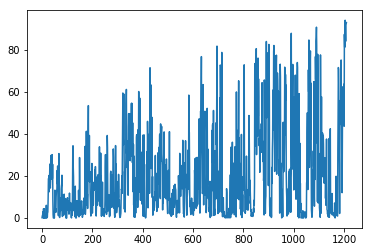

| Reward: 72 | Episode: 1210| Epsilon:0.07624275616104939 


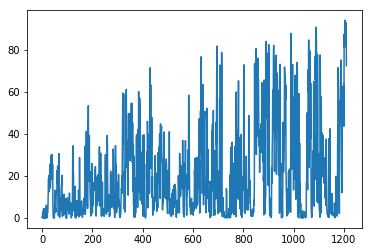

| Reward: 60 | Episode: 1211| Epsilon:0.07619169036804326 


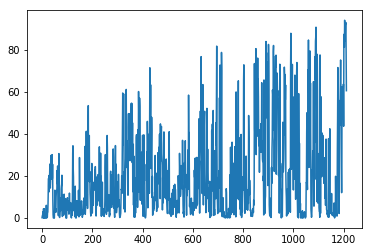

| Reward: 63 | Episode: 1212| Epsilon:0.07612999977845368 


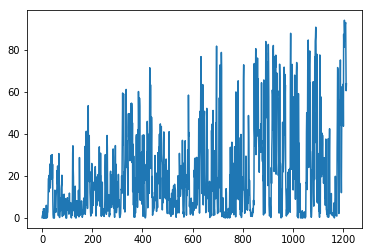

| Reward: 87 | Episode: 1213| Epsilon:0.07607064123467508 


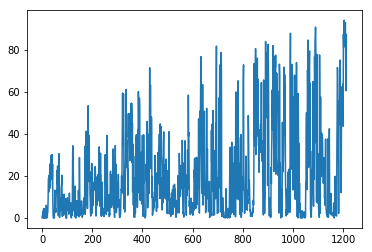

| Reward: 83 | Episode: 1214| Epsilon:0.07600600833933278 


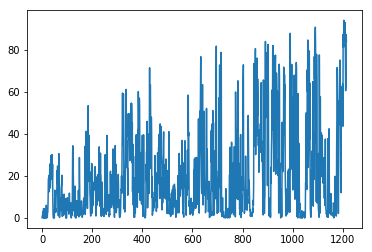

| Reward: 90 | Episode: 1215| Epsilon:0.0759497844174587 


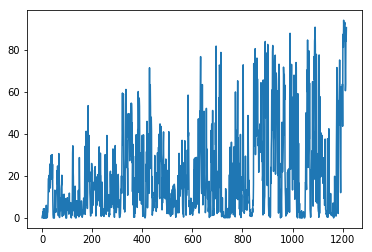

| Reward: 90 | Episode: 1216| Epsilon:0.07589587893970384 


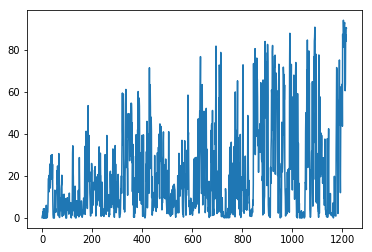

| Reward: 85 | Episode: 1217| Epsilon:0.07583594457286146 


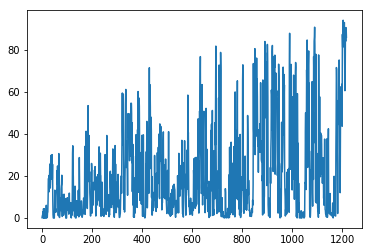

| Reward: 90 | Episode: 1218| Epsilon:0.07577151108591826 


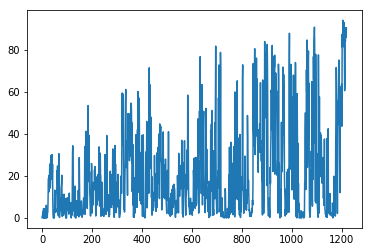

| Reward: 80 | Episode: 1219| Epsilon:0.07571167493137242 


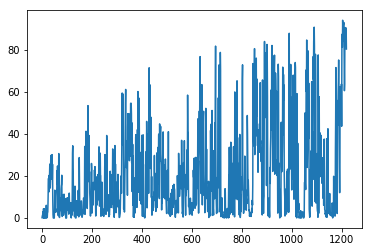

| Reward: 92 | Episode: 1220| Epsilon:0.07565415563093064 


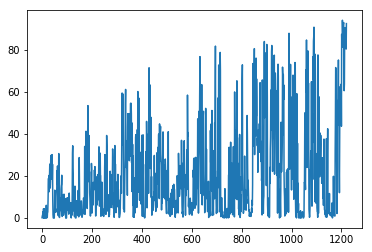

| Reward: 88 | Episode: 1221| Epsilon:0.07558912070094136 


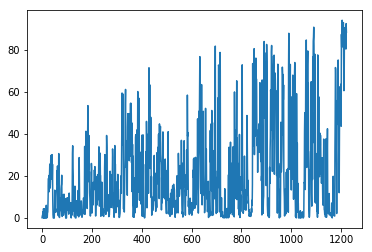

| Reward: 89 | Episode: 1222| Epsilon:0.07552565218271932 


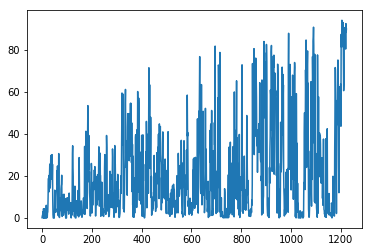

| Reward: 90 | Episode: 1223| Epsilon:0.075467519523821 


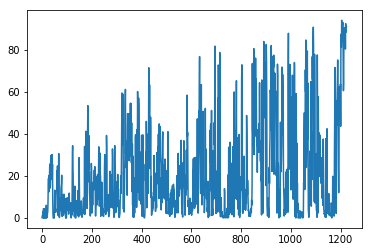

| Reward: 92 | Episode: 1224| Epsilon:0.07541621879826448 


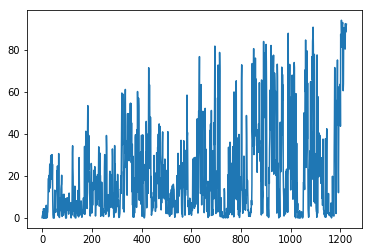

| Reward: 92 | Episode: 1225| Epsilon:0.07536872130621493 


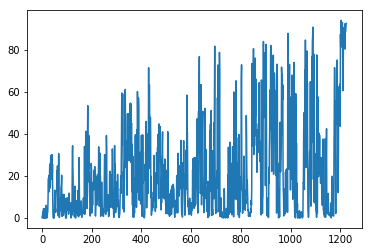

| Reward: 86 | Episode: 1226| Epsilon:0.0753107094381851 


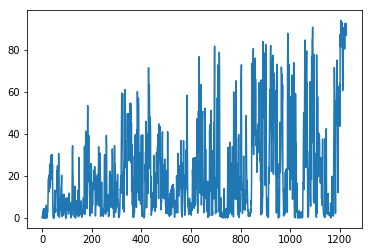

| Reward: 61 | Episode: 1227| Epsilon:0.07524672221364923 


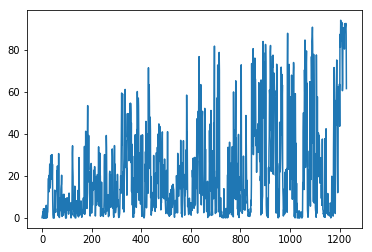

| Reward: 83 | Episode: 1228| Epsilon:0.07518730048066655 


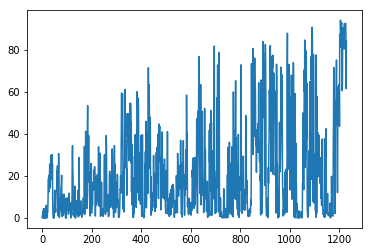

| Reward: 34 | Episode: 1229| Epsilon:0.07511966201391705 


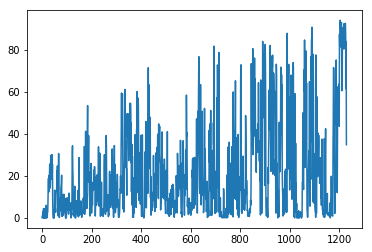

| Reward: 71 | Episode: 1230| Epsilon:0.07506709638779455 


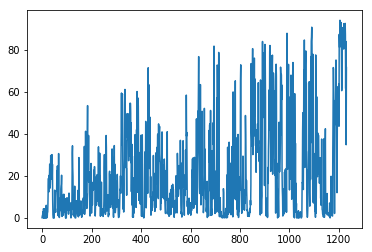

| Reward: 90 | Episode: 1231| Epsilon:0.07501531769809557 


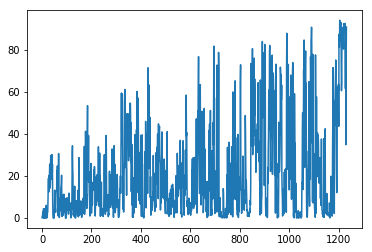

| Reward: 85 | Episode: 1232| Epsilon:0.07496207545954985 


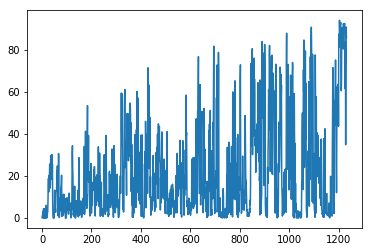

| Reward: 78 | Episode: 1233| Epsilon:0.07490812192105574 


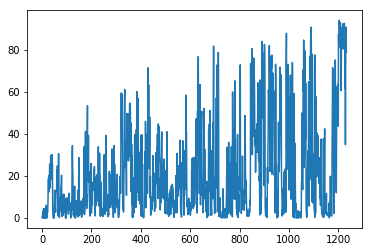

| Reward: 57 | Episode: 1234| Epsilon:0.07485570432192284 


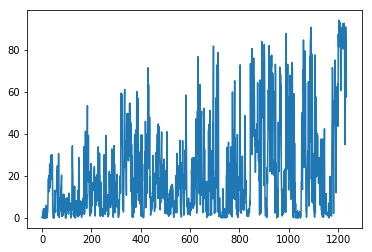

| Reward: 72 | Episode: 1235| Epsilon:0.07480033131439907 


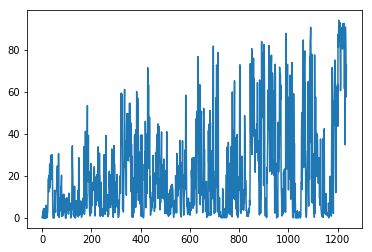

| Reward: 31 | Episode: 1236| Epsilon:0.07474275694039359 


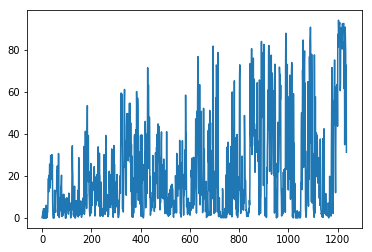

| Reward: 26 | Episode: 1237| Epsilon:0.07469194888832921 


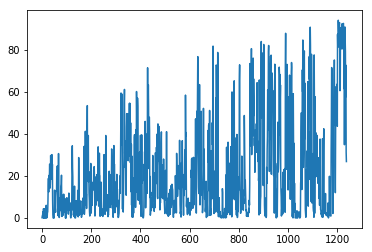

| Reward: 71 | Episode: 1238| Epsilon:0.07463296525539172 


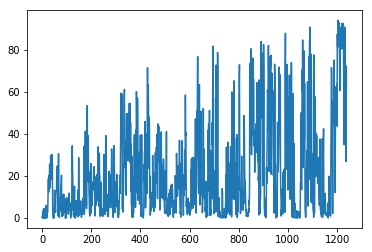

| Reward: 34 | Episode: 1239| Epsilon:0.07457551970429255 


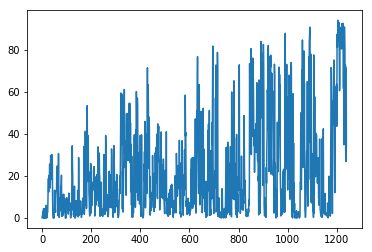

| Reward: 55 | Episode: 1240| Epsilon:0.07452035395772606 


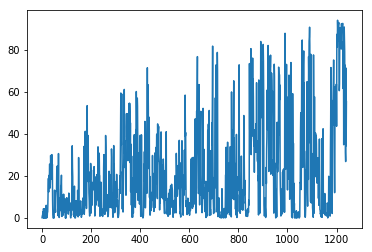

| Reward: 80 | Episode: 1241| Epsilon:0.07446299508438428 


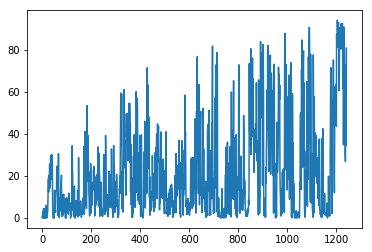

| Reward: 87 | Episode: 1242| Epsilon:0.07440642442484022 


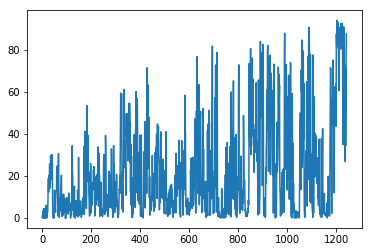

| Reward: 92 | Episode: 1243| Epsilon:0.07435658856817234 


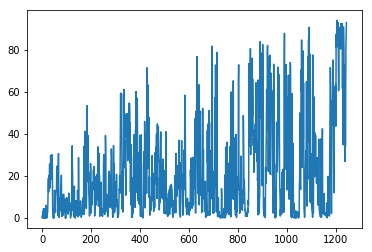

| Reward: 88 | Episode: 1244| Epsilon:0.07430529996222097 


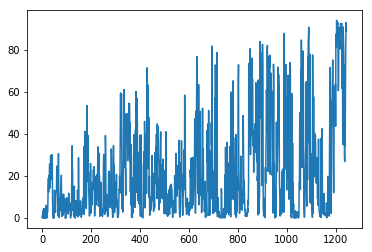

| Reward: 67 | Episode: 1245| Epsilon:0.07425033410529476 


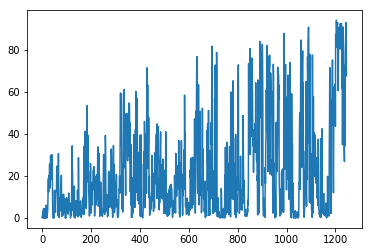

| Reward: 93 | Episode: 1246| Epsilon:0.07421099165817606 


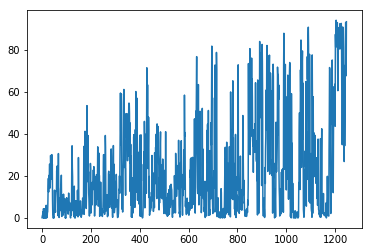

| Reward: 51 | Episode: 1247| Epsilon:0.07414942178228326 


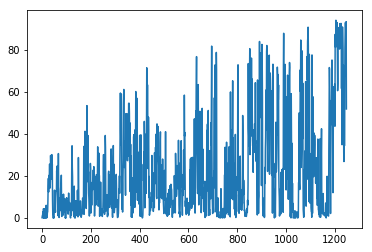

| Reward: 89 | Episode: 1248| Epsilon:0.07410346315963019 


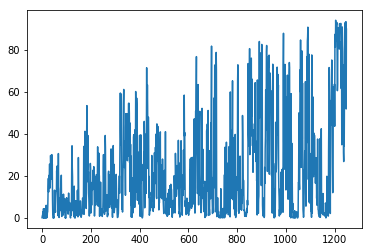

| Reward: 91 | Episode: 1249| Epsilon:0.07405234915084083 


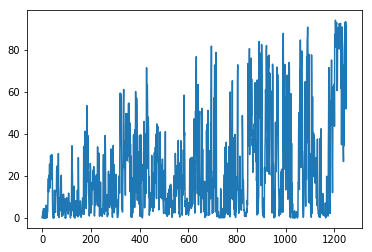

| Reward: 90 | Episode: 1250| Epsilon:0.07399017098514875 


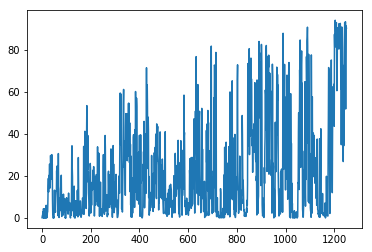

| Reward: 61 | Episode: 1251| Epsilon:0.07393322019760308 


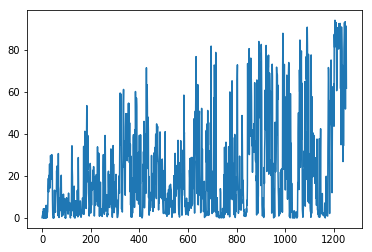

| Reward: 74 | Episode: 1252| Epsilon:0.07387705201602436 


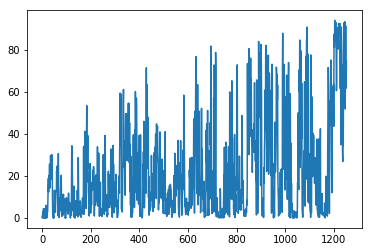

| Reward: 86 | Episode: 1253| Epsilon:0.07382240294693626 


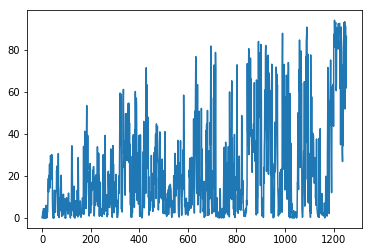

| Reward: 28 | Episode: 1254| Epsilon:0.07376779430340222 


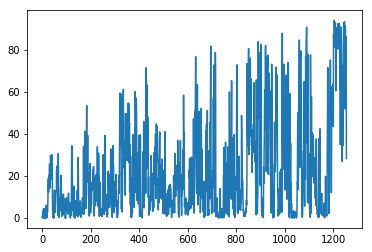

| Reward: 36 | Episode: 1255| Epsilon:0.0737051180060626 


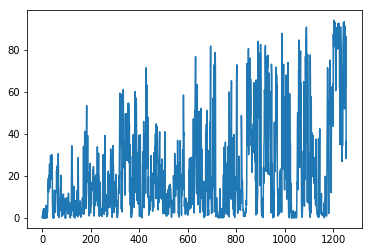

| Reward: 49 | Episode: 1256| Epsilon:0.07365133263504006 


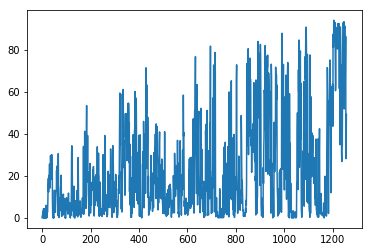

| Reward: 65 | Episode: 1257| Epsilon:0.07359464265390475 


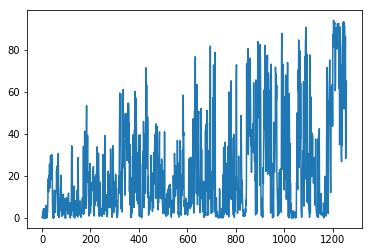

| Reward: 90 | Episode: 1258| Epsilon:0.07354020249148419 


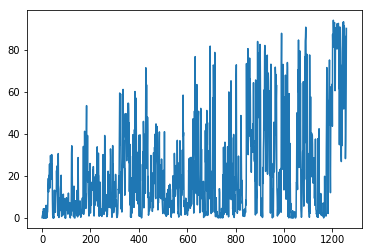

| Reward: 78 | Episode: 1259| Epsilon:0.07347698478876132 


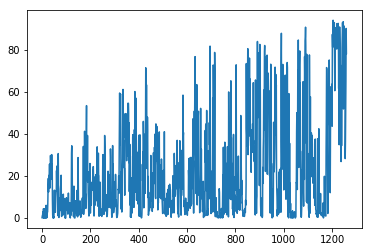

| Reward: 92 | Episode: 1260| Epsilon:0.07343144294991183 


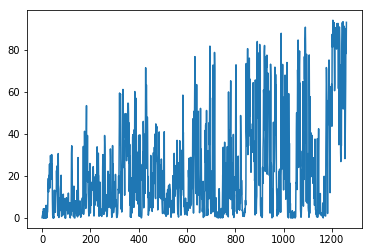

| Reward: 91 | Episode: 1261| Epsilon:0.07337418847028818 


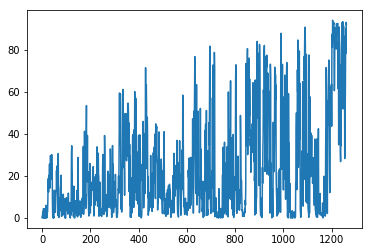

| Reward: 81 | Episode: 1262| Epsilon:0.07332797705861777 


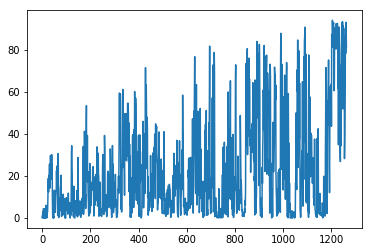

| Reward: 83 | Episode: 1263| Epsilon:0.07327080325132636 


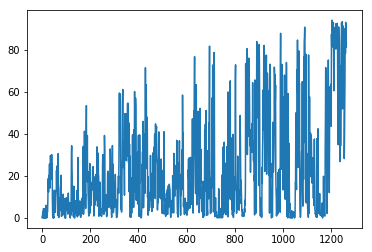

| Reward: 92 | Episode: 1264| Epsilon:0.07321660264261567 


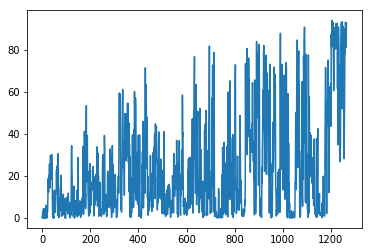

| Reward: 75 | Episode: 1265| Epsilon:0.07316244212771943 


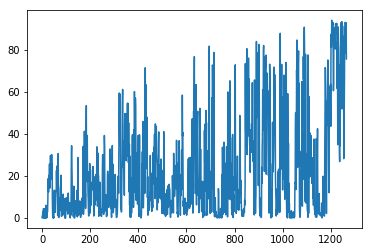

| Reward: 57 | Episode: 1266| Epsilon:0.0730966252227696 


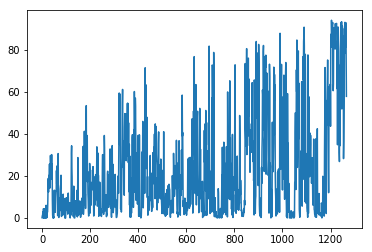

| Reward: 6 | Episode: 1267| Epsilon:0.07303744063341062 


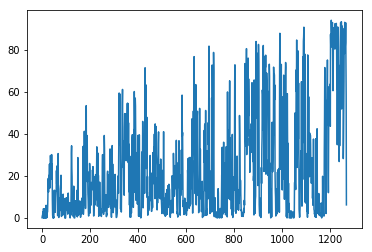

| Reward: 49 | Episode: 1268| Epsilon:0.07298195298906647 


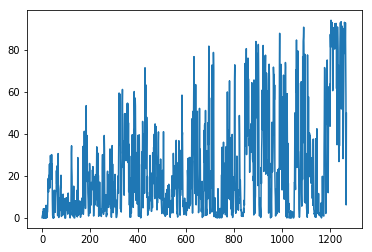

| Reward: 55 | Episode: 1269| Epsilon:0.07293234188266609 


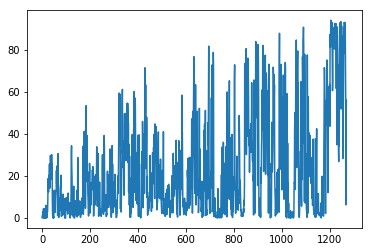

| Reward: 93 | Episode: 1270| Epsilon:0.0728769340834268 


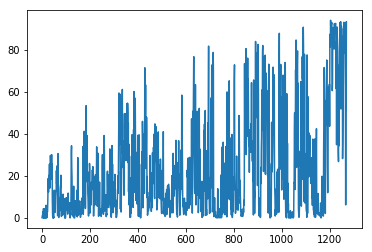

| Reward: 91 | Episode: 1271| Epsilon:0.07282156837832757 


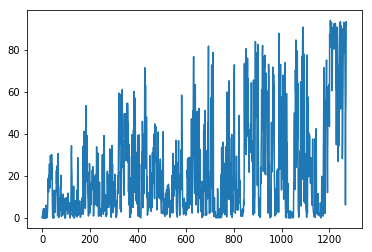

| Reward: 92 | Episode: 1272| Epsilon:0.07278371081730185 


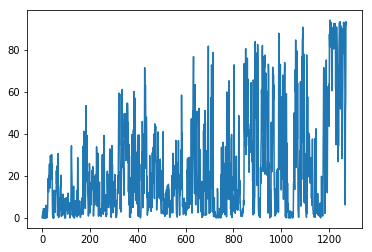

| Reward: 60 | Episode: 1273| Epsilon:0.07272623410466321 


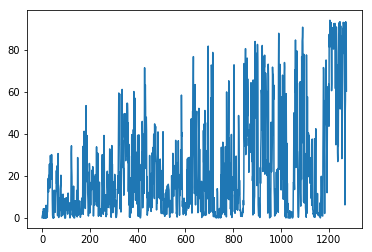

| Reward: 7 | Episode: 1274| Epsilon:0.07267388980059687 


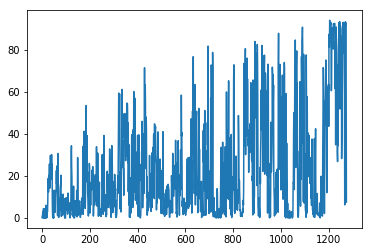

| Reward: 87 | Episode: 1275| Epsilon:0.07262303562450356 


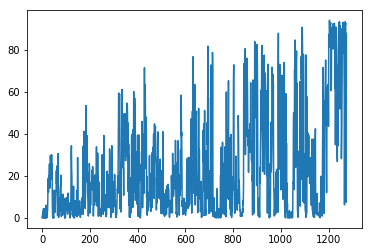

| Reward: 84 | Episode: 1276| Epsilon:0.07257003988931555 


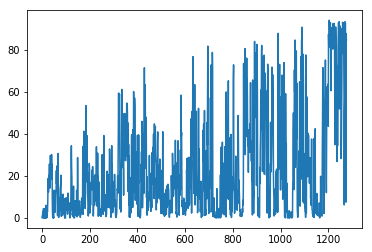

| Reward: 93 | Episode: 1277| Epsilon:0.07252651070779624 


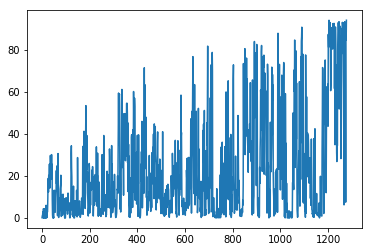

| Reward: 68 | Episode: 1278| Epsilon:0.0724714112246164 


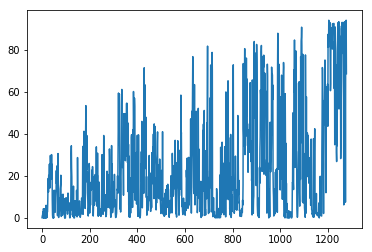

| Reward: 84 | Episode: 1279| Epsilon:0.0724257683863342 


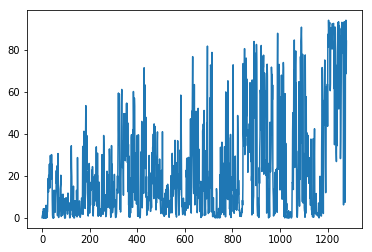

| Reward: 84 | Episode: 1280| Epsilon:0.0723823257421856 


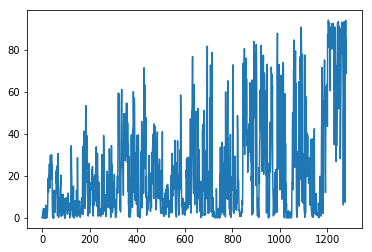

| Reward: 86 | Episode: 1281| Epsilon:0.07232516600012133 


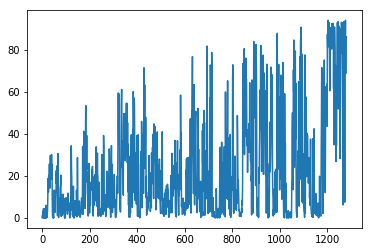

| Reward: 79 | Episode: 1282| Epsilon:0.07227021948155034 


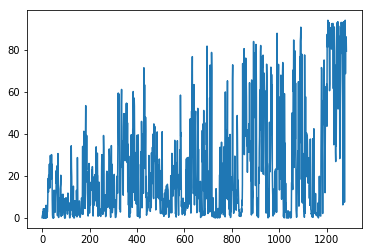

| Reward: 67 | Episode: 1283| Epsilon:0.0722210921918378 


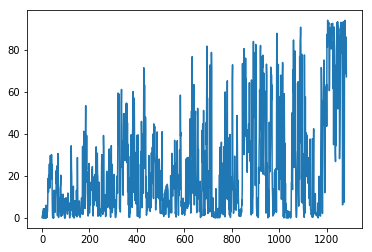

| Reward: 89 | Episode: 1284| Epsilon:0.07217272002469376 


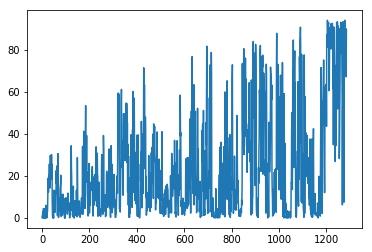

| Reward: 80 | Episode: 1285| Epsilon:0.07211933170104975 


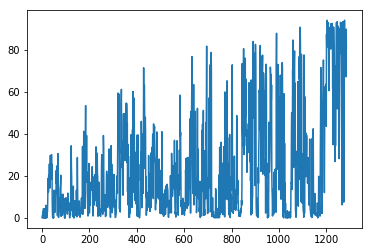

| Reward: 94 | Episode: 1286| Epsilon:0.07207391060412029 


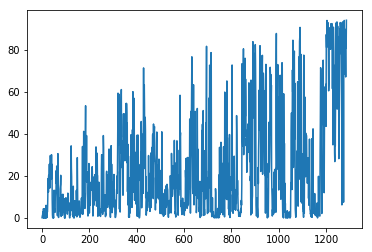

| Reward: 90 | Episode: 1287| Epsilon:0.07202491675973507 


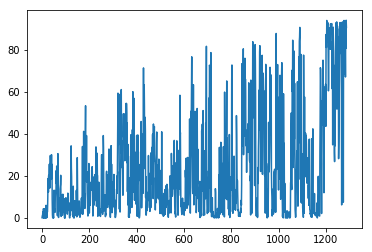

| Reward: 89 | Episode: 1288| Epsilon:0.07196516058228755 


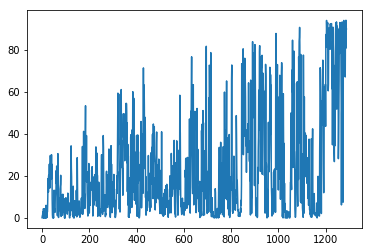

| Reward: 59 | Episode: 1289| Epsilon:0.07192702896229257 


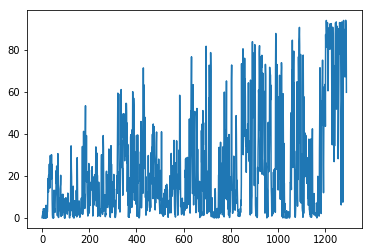

| Reward: 89 | Episode: 1290| Epsilon:0.07187454112910074 


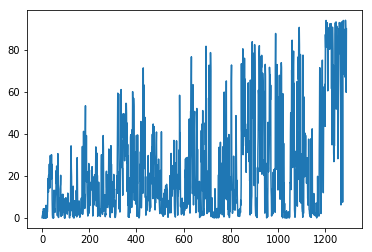

| Reward: 87 | Episode: 1291| Epsilon:0.07183142912375812 


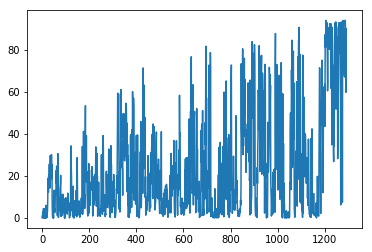

| Reward: 58 | Episode: 1292| Epsilon:0.07178044665508583 


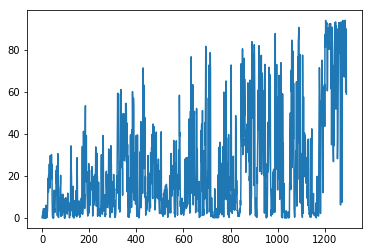

| Reward: 43 | Episode: 1293| Epsilon:0.07172591396801024 


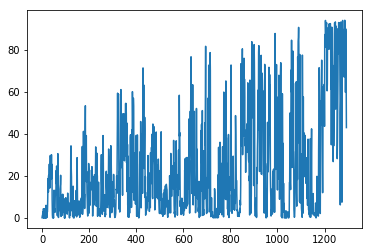

| Reward: 69 | Episode: 1294| Epsilon:0.07167142271023885 


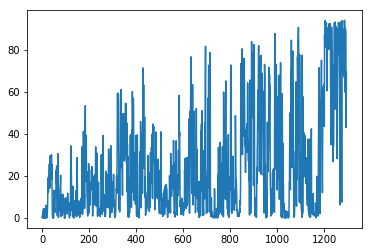

| Reward: 86 | Episode: 1295| Epsilon:0.07161840521123956 


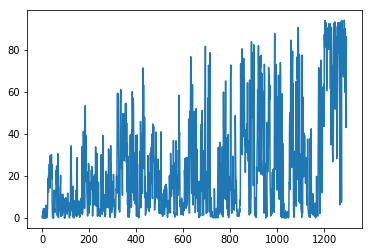

| Reward: 59 | Episode: 1296| Epsilon:0.07156041750127275 


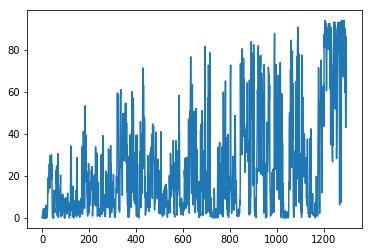

| Reward: 88 | Episode: 1297| Epsilon:0.0715124878401279 


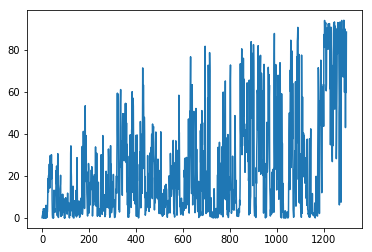

| Reward: 53 | Episode: 1298| Epsilon:0.07146244636499191 


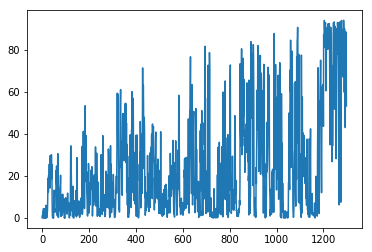

| Reward: 75 | Episode: 1299| Epsilon:0.07140815526752904 


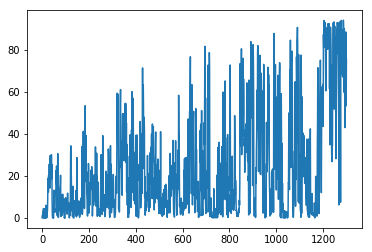

| Reward: 92 | Episode: 1300| Epsilon:0.07135533251534591 


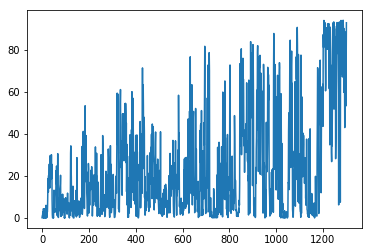

| Reward: 94 | Episode: 1301| Epsilon:0.07131181881796986 


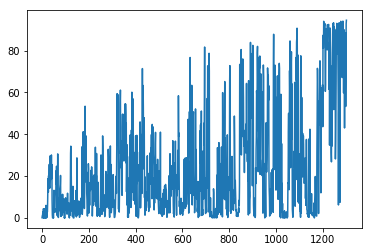

| Reward: 91 | Episode: 1302| Epsilon:0.07126334302243294 


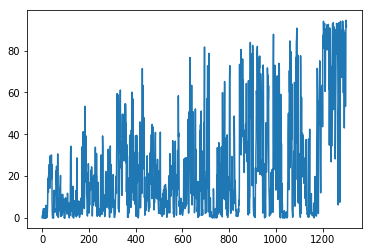

| Reward: 93 | Episode: 1303| Epsilon:0.07121774884662009 


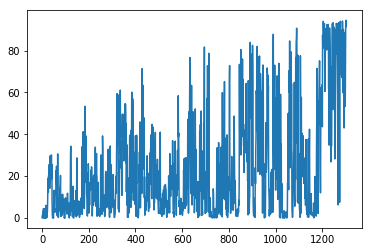

| Reward: 93 | Episode: 1304| Epsilon:0.07117289557084555 


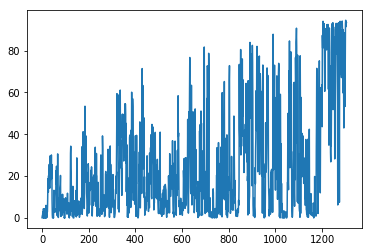

| Reward: 93 | Episode: 1305| Epsilon:0.07112807054387674 


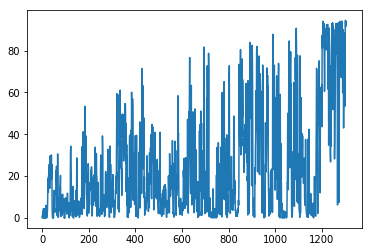

| Reward: 92 | Episode: 1306| Epsilon:0.07107474422420655 


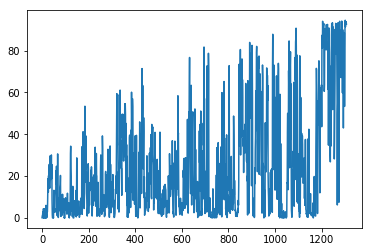

| Reward: 80 | Episode: 1307| Epsilon:0.07102358857083182 


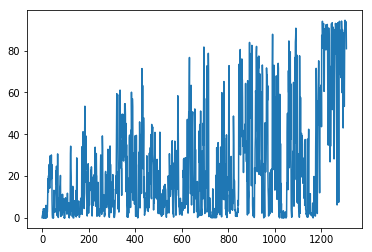

| Reward: 86 | Episode: 1308| Epsilon:0.07096537280884914 


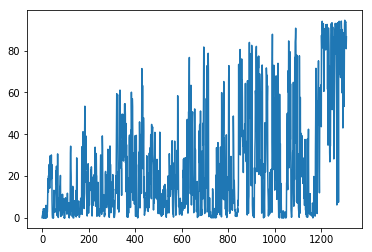

| Reward: 90 | Episode: 1309| Epsilon:0.07090436851881649 


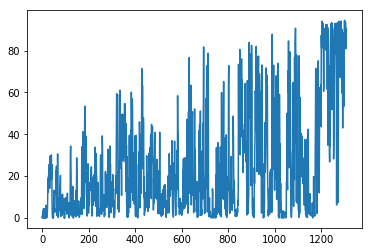

| Reward: 93 | Episode: 1310| Epsilon:0.07085971261145774 


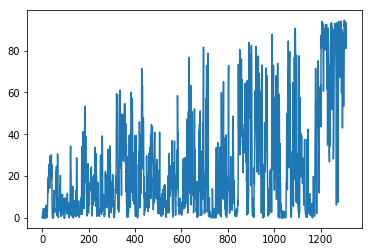

| Reward: 84 | Episode: 1311| Epsilon:0.07080871172589497 


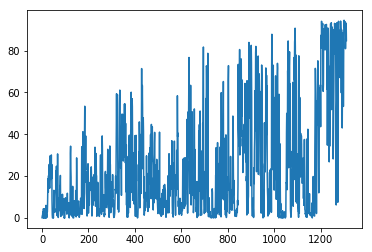

| Reward: 93 | Episode: 1312| Epsilon:0.07075987032281876 


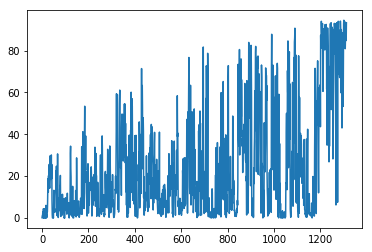

| Reward: 93 | Episode: 1313| Epsilon:0.07071530542110874 


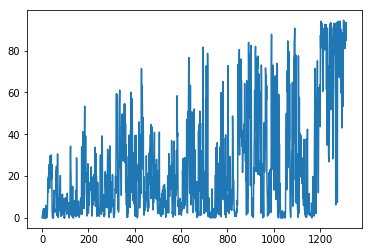

| Reward: 94 | Episode: 1314| Epsilon:0.07066864848472859 


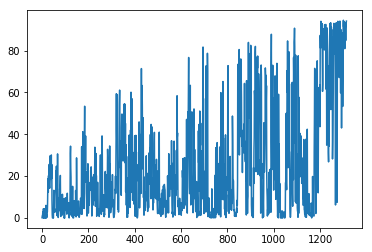

| Reward: 94 | Episode: 1315| Epsilon:0.07061566660414413 


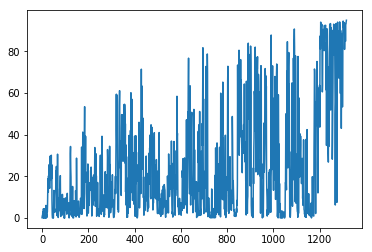

| Reward: 91 | Episode: 1316| Epsilon:0.07056343007957207 


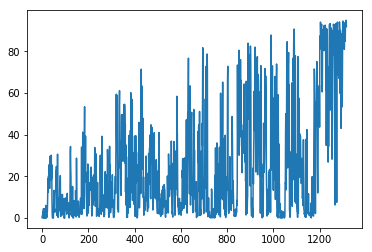

| Reward: 92 | Episode: 1317| Epsilon:0.07050911688010986 


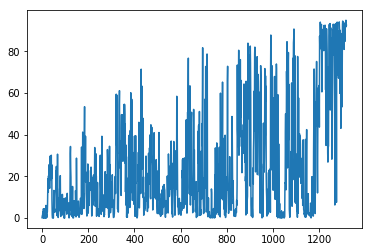

| Reward: 94 | Episode: 1318| Epsilon:0.07046541455825218 


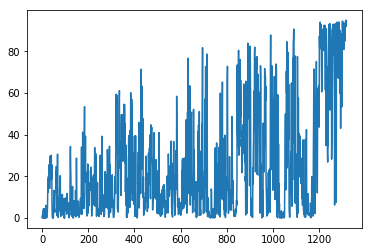

| Reward: 92 | Episode: 1319| Epsilon:0.07040695223707655 


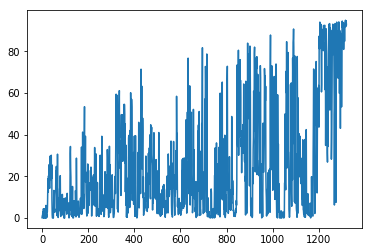

| Reward: 92 | Episode: 1320| Epsilon:0.07035909154473136 


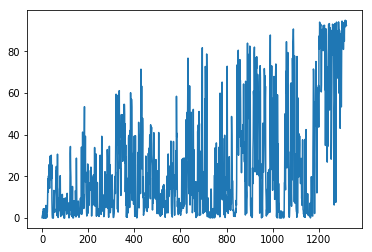

| Reward: 85 | Episode: 1321| Epsilon:0.07031266963311801 


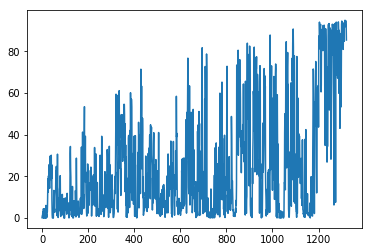

| Reward: 85 | Episode: 1322| Epsilon:0.07027260263127236 


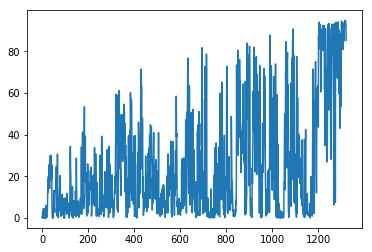

| Reward: 83 | Episode: 1323| Epsilon:0.07022483326606101 


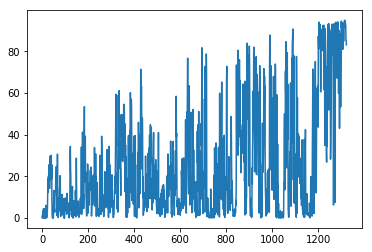

| Reward: 92 | Episode: 1324| Epsilon:0.07017569283822872 


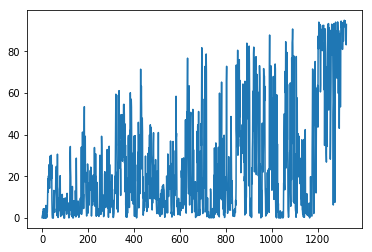

| Reward: 92 | Episode: 1325| Epsilon:0.07012448302026529 


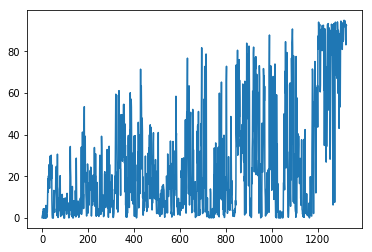

| Reward: 91 | Episode: 1326| Epsilon:0.0700684055874256 


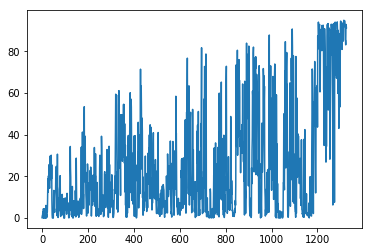

| Reward: 95 | Episode: 1327| Epsilon:0.07002917806888924 


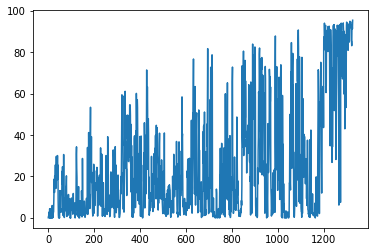

| Reward: 83 | Episode: 1328| Epsilon:0.06998787283354489 


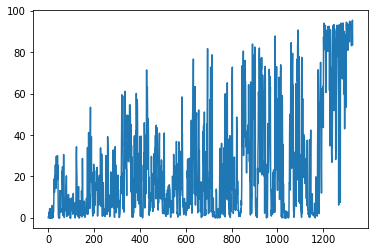

| Reward: 65 | Episode: 1329| Epsilon:0.06993400264479624 


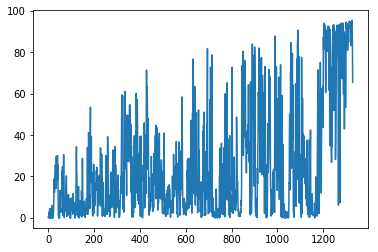

| Reward: 58 | Episode: 1330| Epsilon:0.06988786120069483 


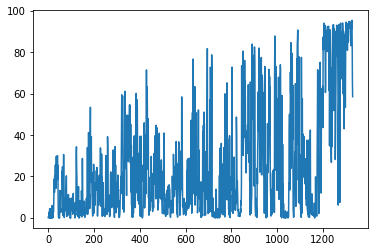

| Reward: 83 | Episode: 1331| Epsilon:0.06983755979980043 


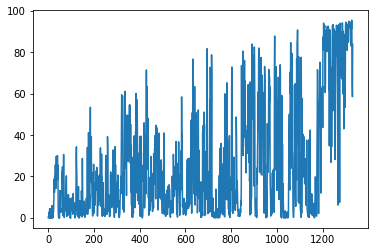

| Reward: 93 | Episode: 1332| Epsilon:0.06979217990909321 


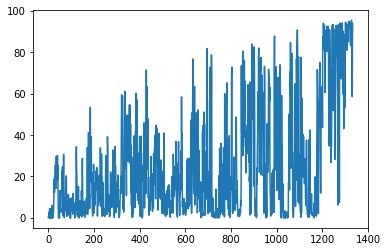

| Reward: 91 | Episode: 1333| Epsilon:0.0697412499548047 


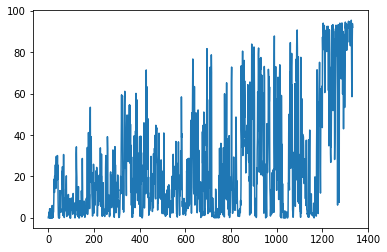

| Reward: 84 | Episode: 1334| Epsilon:0.06969105407654232 


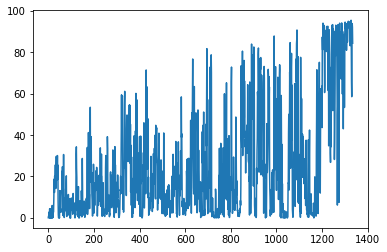

| Reward: 93 | Episode: 1335| Epsilon:0.0696492517770287 


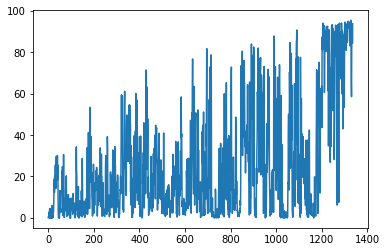

| Reward: 87 | Episode: 1336| Epsilon:0.06959773013846271 


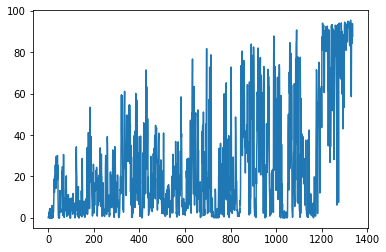

| Reward: 90 | Episode: 1337| Epsilon:0.06954207394151782 


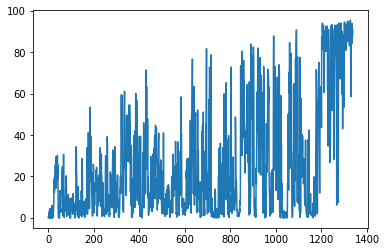

| Reward: 91 | Episode: 1338| Epsilon:0.06949132649887331 


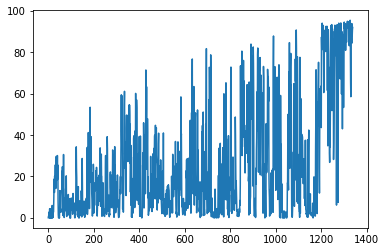

| Reward: 92 | Episode: 1339| Epsilon:0.06944339378261417 


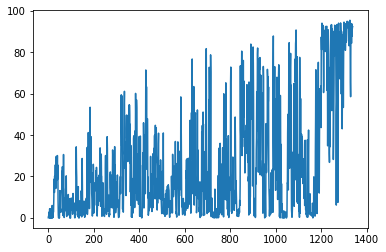

| Reward: 93 | Episode: 1340| Epsilon:0.06939965800406889 


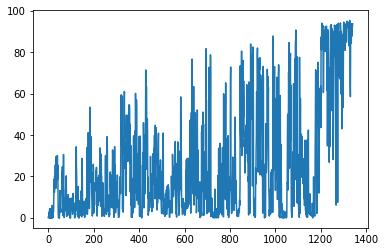

| Reward: 89 | Episode: 1341| Epsilon:0.06933791947747198 


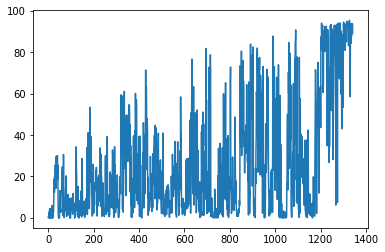

| Reward: 91 | Episode: 1342| Epsilon:0.06928593527445559 


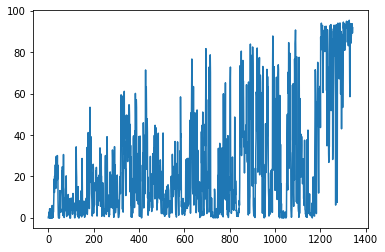

| Reward: 92 | Episode: 1343| Epsilon:0.06923122072710772 


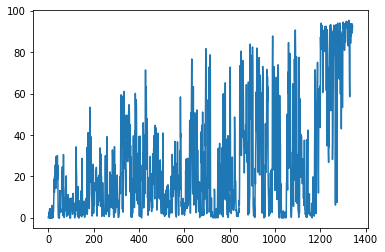

| Reward: 94 | Episode: 1344| Epsilon:0.06919246190318987 


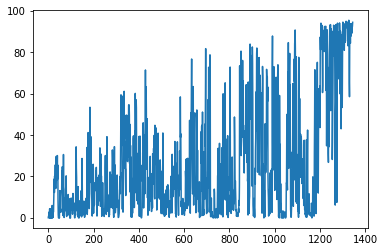

| Reward: 90 | Episode: 1345| Epsilon:0.06913436434909204 


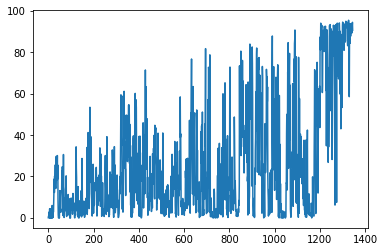

| Reward: 93 | Episode: 1346| Epsilon:0.06909082319874868 


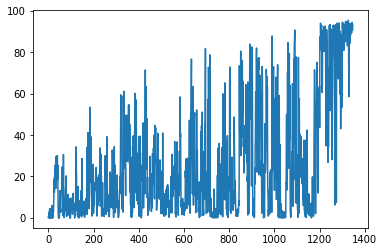

| Reward: 91 | Episode: 1347| Epsilon:0.06903695309937295 


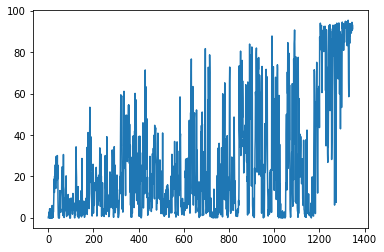

| Reward: 93 | Episode: 1348| Epsilon:0.06899209343652977 


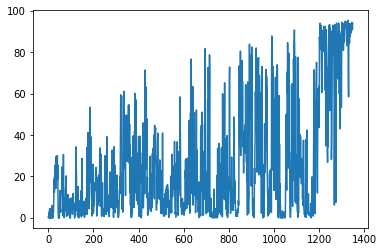

| Reward: 94 | Episode: 1349| Epsilon:0.06895415802865598 


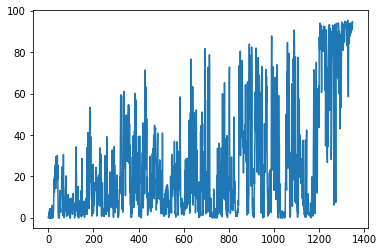

| Reward: 93 | Episode: 1350| Epsilon:0.06891141948730224 


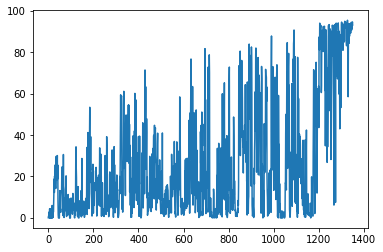

| Reward: 85 | Episode: 1351| Epsilon:0.06886595272878746 


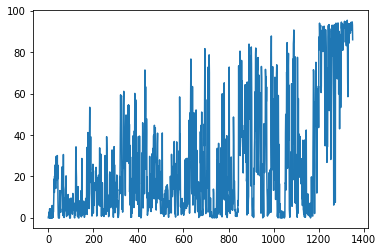

| Reward: 94 | Episode: 1352| Epsilon:0.06882464534406776 


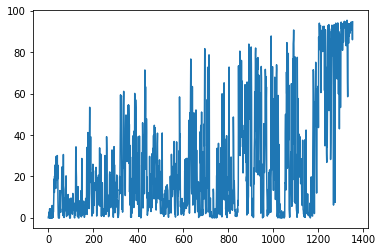

| Reward: 92 | Episode: 1353| Epsilon:0.06877442143580377 


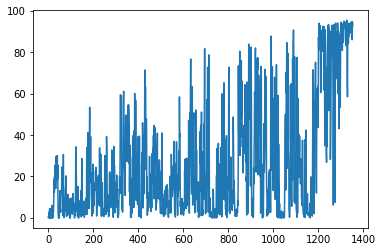

| Reward: 93 | Episode: 1354| Epsilon:0.06872973236394678 


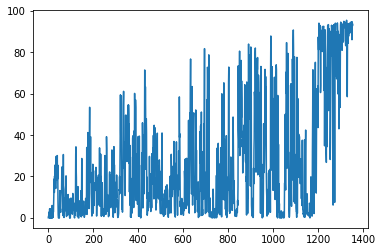

| Reward: 92 | Episode: 1355| Epsilon:0.06867889092144383 


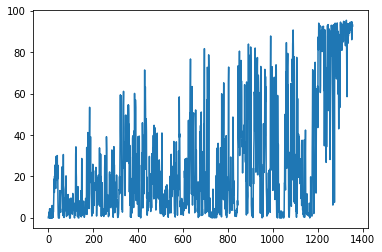

| Reward: 91 | Episode: 1356| Epsilon:0.06863975491276049 


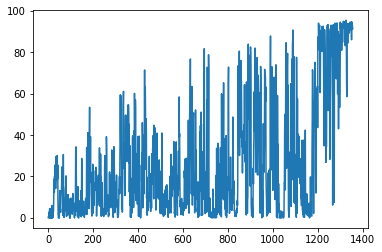

| Reward: 88 | Episode: 1357| Epsilon:0.06859309551211683 


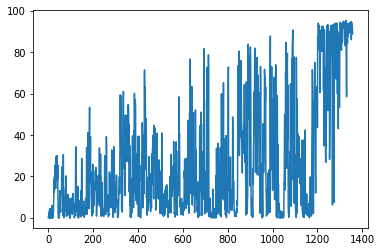

| Reward: 93 | Episode: 1358| Epsilon:0.06854646782923889 


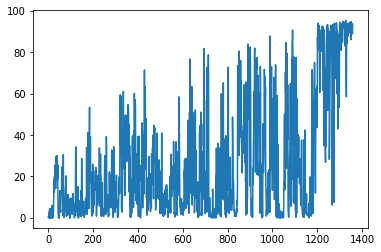

| Reward: 93 | Episode: 1359| Epsilon:0.06849987184256588 


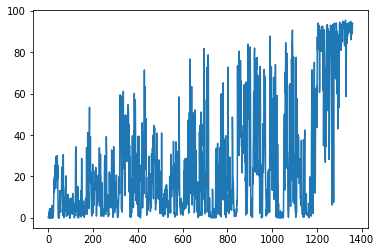

| Reward: 68 | Episode: 1360| Epsilon:0.06845125395186152 


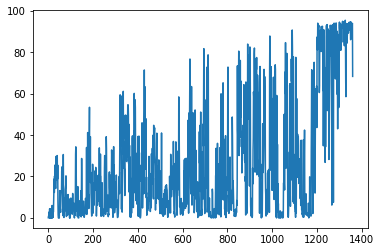

| Reward: 91 | Episode: 1361| Epsilon:0.06840335460132688 


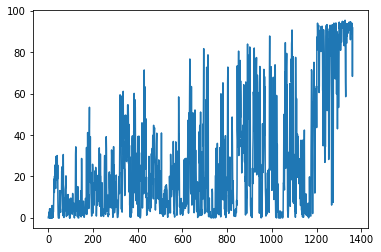

| Reward: 91 | Episode: 1362| Epsilon:0.06834455271079715 


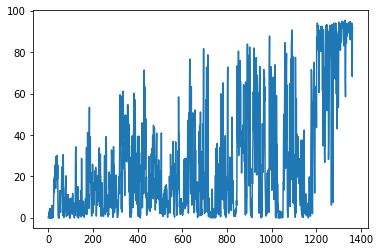

| Reward: 91 | Episode: 1363| Epsilon:0.06830082597247714 


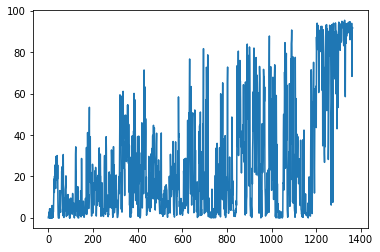

| Reward: 92 | Episode: 1364| Epsilon:0.06825098431472726 


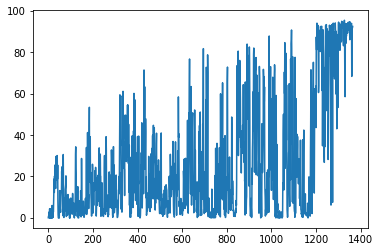

| Reward: 91 | Episode: 1365| Epsilon:0.06820390714365589 


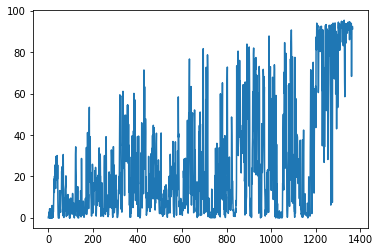

| Reward: 93 | Episode: 1366| Epsilon:0.0681650417999324 


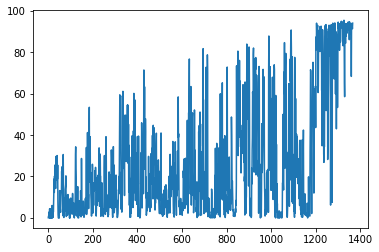

| Reward: 92 | Episode: 1367| Epsilon:0.06811598038875663 


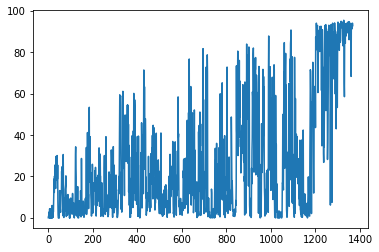

| Reward: 92 | Episode: 1368| Epsilon:0.06806491230105112 


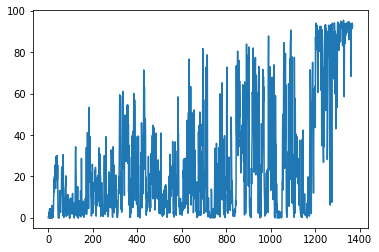

| Reward: 93 | Episode: 1369| Epsilon:0.06802340515797732 


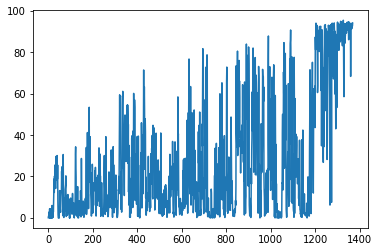

| Reward: 89 | Episode: 1370| Epsilon:0.06798940178693251 


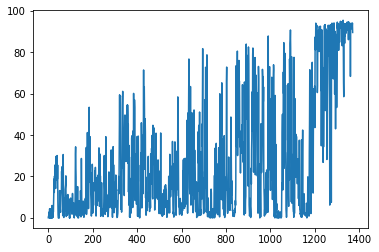

| Reward: 90 | Episode: 1371| Epsilon:0.06793571110168024 


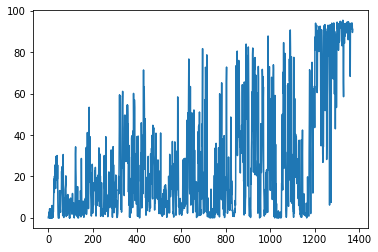

| Reward: 91 | Episode: 1372| Epsilon:0.06789088810145516 


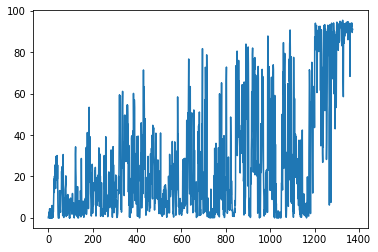

| Reward: 92 | Episode: 1373| Epsilon:0.06784202401088503 


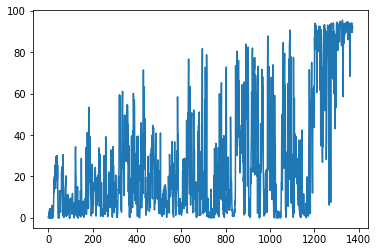

| Reward: 68 | Episode: 1374| Epsilon:0.06779726282404828 


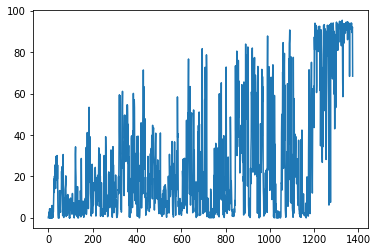

| Reward: 80 | Episode: 1375| Epsilon:0.06774711115720533 


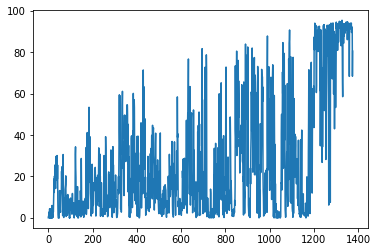

| Reward: 94 | Episode: 1376| Epsilon:0.06770173556837152 


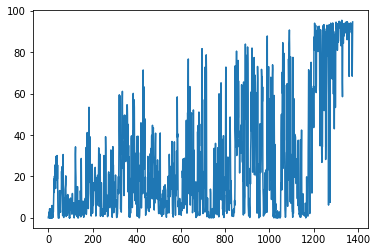

| Reward: 94 | Episode: 1377| Epsilon:0.06765233108921291 


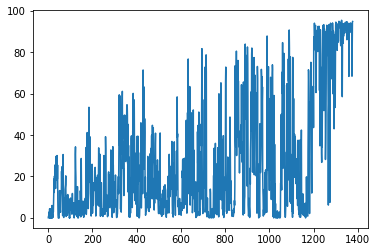

| Reward: 99 | Episode: 1378| Epsilon:0.06761107554519082 


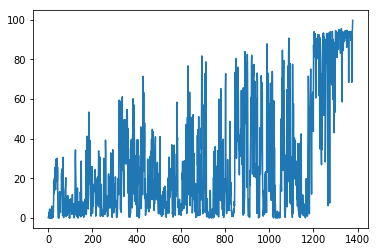

| Reward: 90 | Episode: 1379| Epsilon:0.06757187229539961 


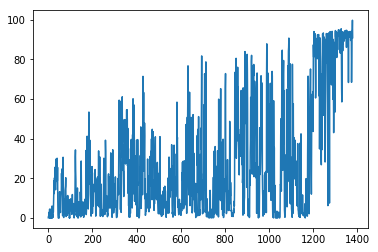

| Reward: 90 | Episode: 1380| Epsilon:0.06751986172032028 


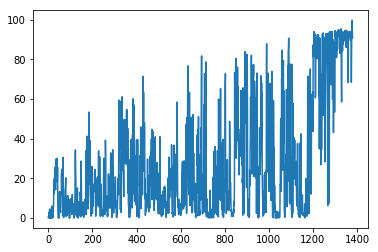

| Reward: 89 | Episode: 1381| Epsilon:0.0674780121715065 


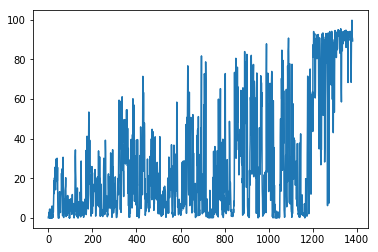

| Reward: 94 | Episode: 1382| Epsilon:0.06742742238297086 


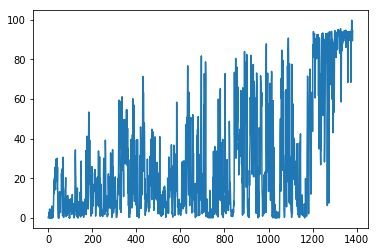

| Reward: 92 | Episode: 1383| Epsilon:0.06738091327646786 


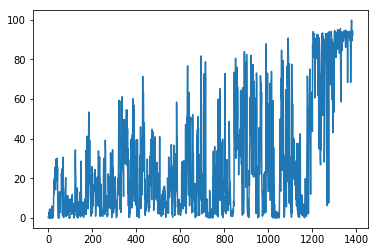

| Reward: 99 | Episode: 1384| Epsilon:0.0673344362503398 


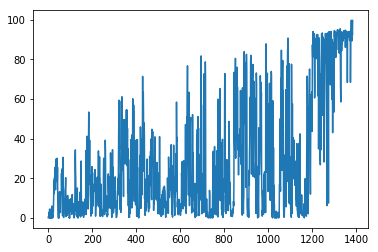

| Reward: 94 | Episode: 1385| Epsilon:0.06729606636628335 


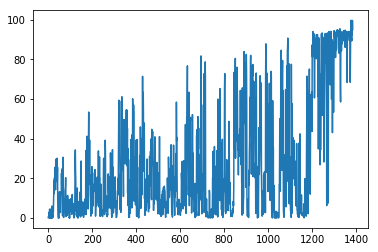

| Reward: 93 | Episode: 1386| Epsilon:0.06725570063556496 


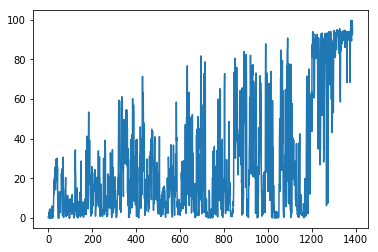

| Reward: 95 | Episode: 1387| Epsilon:0.06721670344448887 


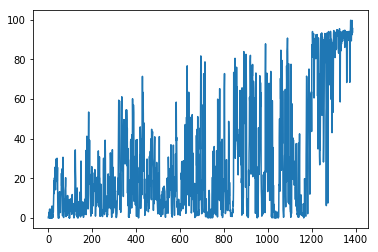

| Reward: 92 | Episode: 1388| Epsilon:0.06717302656538894 


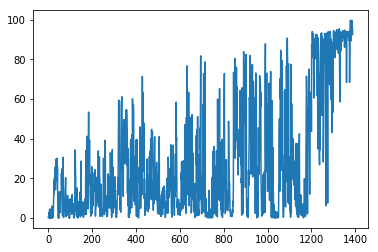

| Reward: 91 | Episode: 1389| Epsilon:0.06713743411617912 


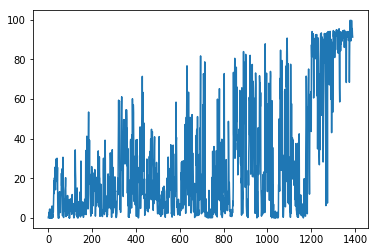

| Reward: 90 | Episode: 1390| Epsilon:0.06707770808321245 


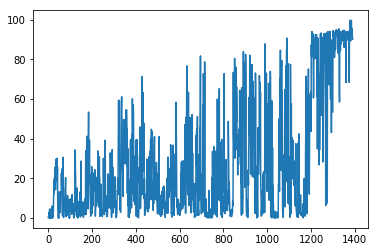

| Reward: 84 | Episode: 1391| Epsilon:0.06702406710779187 


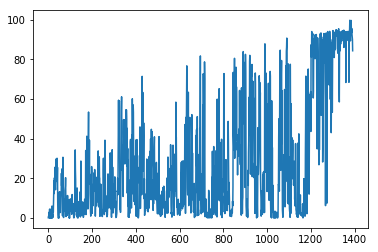

| Reward: 88 | Episode: 1392| Epsilon:0.06697850600688282 


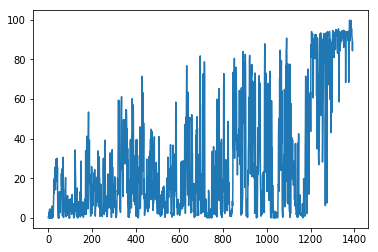

| Reward: 93 | Episode: 1393| Epsilon:0.0669356532631153 


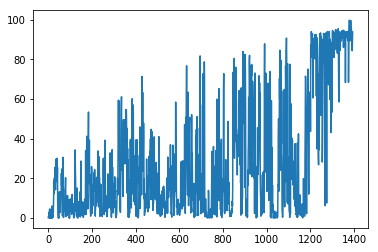

| Reward: 93 | Episode: 1394| Epsilon:0.06688747669752768 


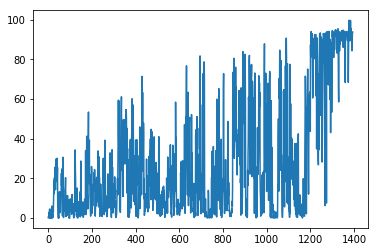

| Reward: 93 | Episode: 1395| Epsilon:0.06684134002690467 


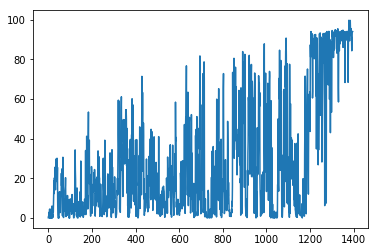

| Reward: 92 | Episode: 1396| Epsilon:0.06679256341043294 


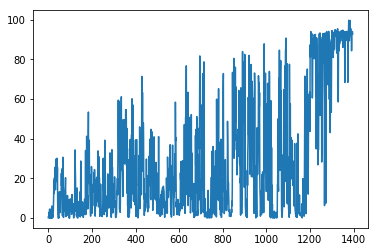

| Reward: 93 | Episode: 1397| Epsilon:0.06674782715758469 


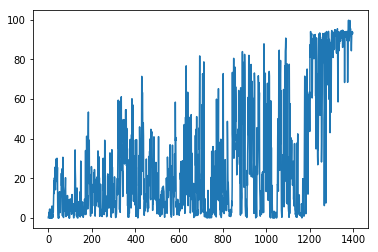

| Reward: 91 | Episode: 1398| Epsilon:0.06670312086813686 


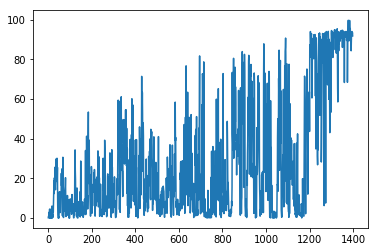

| Reward: 93 | Episode: 1399| Epsilon:0.066650445948609 


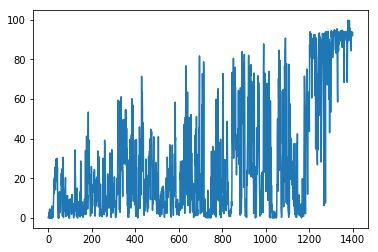

| Reward: 92 | Episode: 1400| Epsilon:0.06660114261657299 


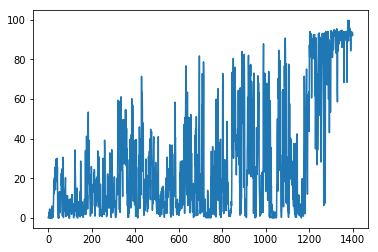

| Reward: 92 | Episode: 1401| Epsilon:0.06655387235189339 


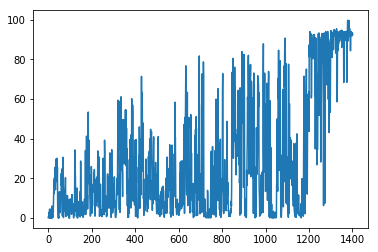

| Reward: 91 | Episode: 1402| Epsilon:0.06650730071036491 


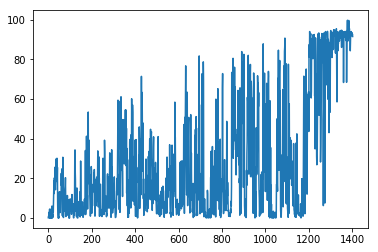

| Reward: 86 | Episode: 1403| Epsilon:0.06645943244915385 


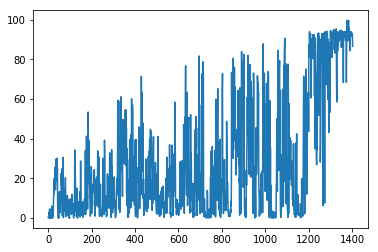

| Reward: 92 | Episode: 1404| Epsilon:0.0664122627634863 


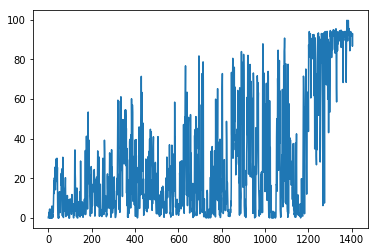

| Reward: 93 | Episode: 1405| Epsilon:0.06636977230126344 


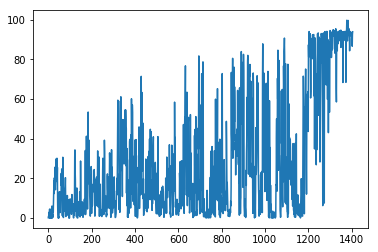

| Reward: 92 | Episode: 1406| Epsilon:0.06632531922499948 


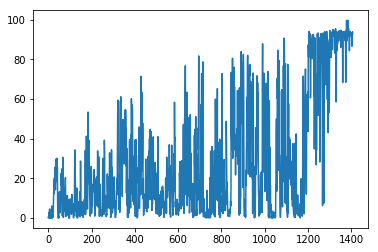

| Reward: 91 | Episode: 1407| Epsilon:0.0662828843891171 


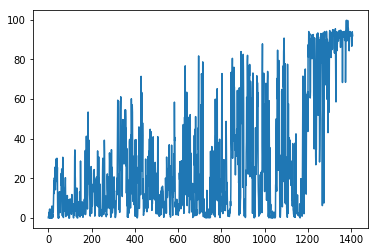

| Reward: 86 | Episode: 1408| Epsilon:0.06623716474538127 


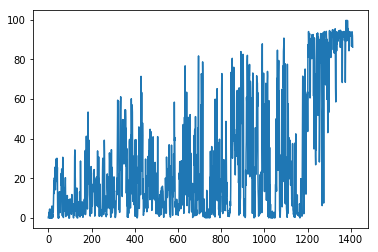

| Reward: 85 | Episode: 1409| Epsilon:0.06620074413925296 


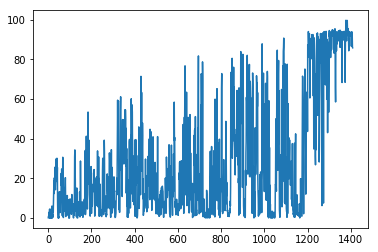

| Reward: 44 | Episode: 1410| Epsilon:0.06616302027879575 


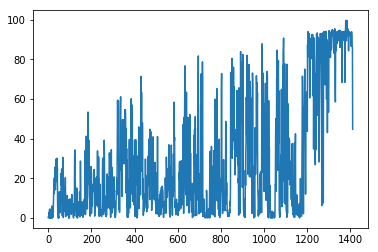

| Reward: 87 | Episode: 1411| Epsilon:0.0661200280746334 


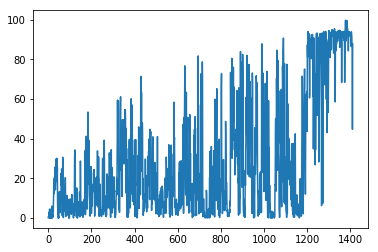

| Reward: 71 | Episode: 1412| Epsilon:0.06606847430355062 


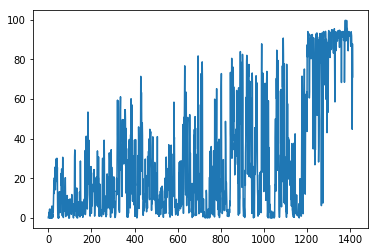

| Reward: 86 | Episode: 1413| Epsilon:0.06602488327917545 


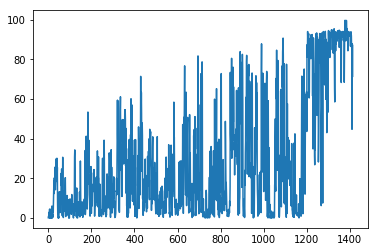

| Reward: 92 | Episode: 1414| Epsilon:0.06598396033435126 


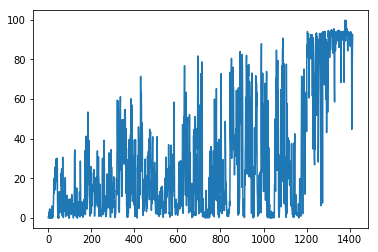

| Reward: 68 | Episode: 1415| Epsilon:0.065939106269164 


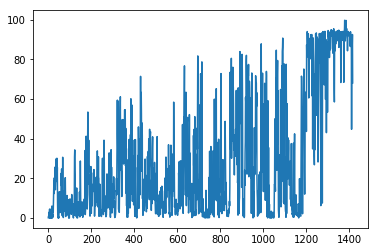

| Reward: 92 | Episode: 1416| Epsilon:0.06589691853172887 


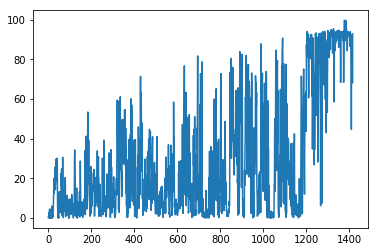

| Reward: 90 | Episode: 1417| Epsilon:0.06585080659925613 


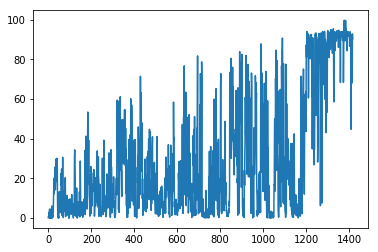

| Reward: 84 | Episode: 1418| Epsilon:0.06580143676345993 


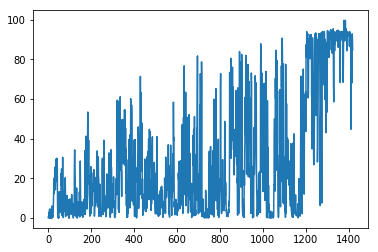

| Reward: 92 | Episode: 1419| Epsilon:0.06575802192659383 


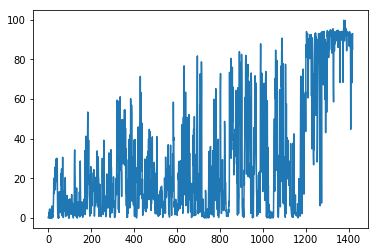

| Reward: 73 | Episode: 1420| Epsilon:0.06571463573420958 


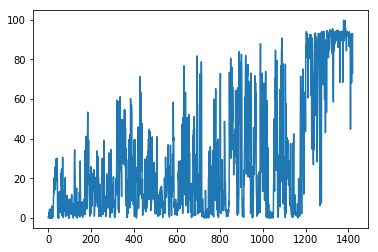

| Reward: 14 | Episode: 1421| Epsilon:0.06567193488675677 


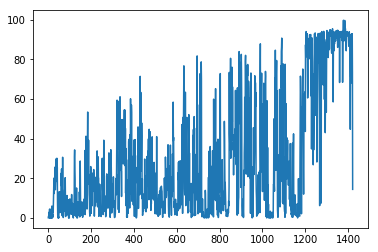

| Reward: 46 | Episode: 1422| Epsilon:0.06562860549335704 


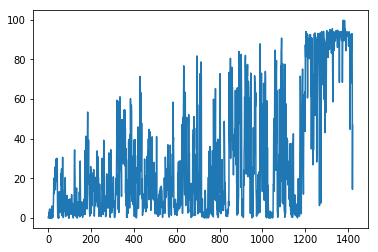

| Reward: 90 | Episode: 1423| Epsilon:0.0655990791171859 


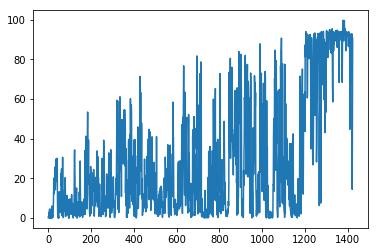

| Reward: 91 | Episode: 1424| Epsilon:0.06555317560039142 


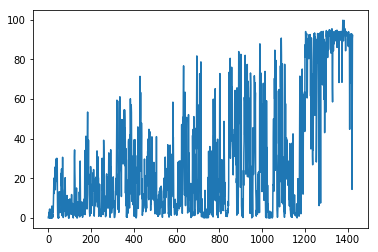

| Reward: 92 | Episode: 1425| Epsilon:0.06550206380405584 


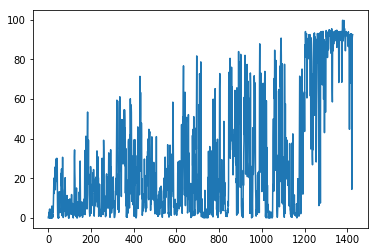

| Reward: 92 | Episode: 1426| Epsilon:0.06545622817455668 


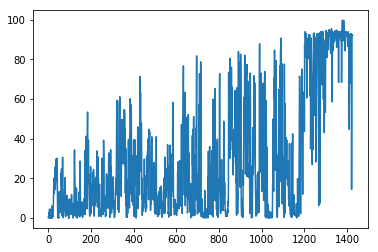

| Reward: 86 | Episode: 1427| Epsilon:0.06540977051468513 


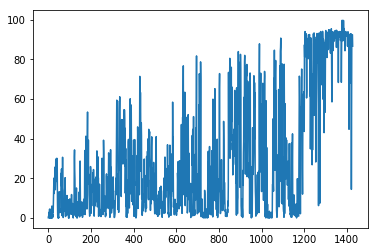

| Reward: 94 | Episode: 1428| Epsilon:0.06537053622766786 


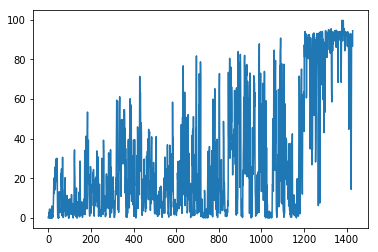

| Reward: 81 | Episode: 1429| Epsilon:0.06532544589017426 


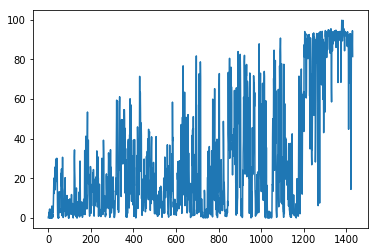

| Reward: 90 | Episode: 1430| Epsilon:0.06527908105323267 


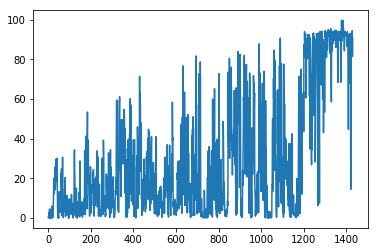

| Reward: 92 | Episode: 1431| Epsilon:0.06523079216090241 


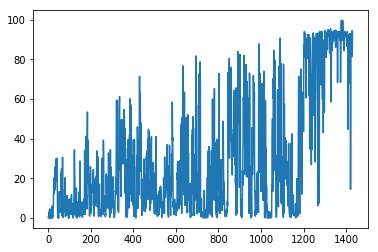

| Reward: 93 | Episode: 1432| Epsilon:0.06518645007853908 


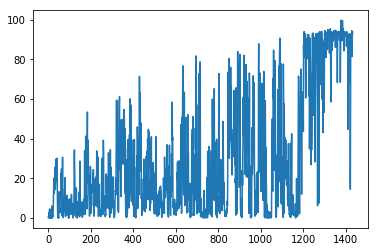

| Reward: 92 | Episode: 1433| Epsilon:0.0651375783258194 


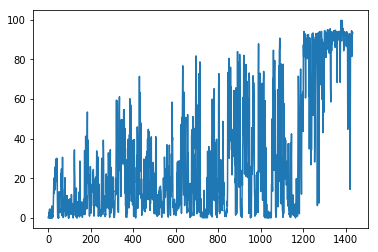

| Reward: 92 | Episode: 1434| Epsilon:0.06509590340471337 


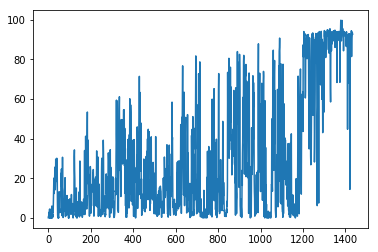

| Reward: 78 | Episode: 1435| Epsilon:0.06504840049838358 


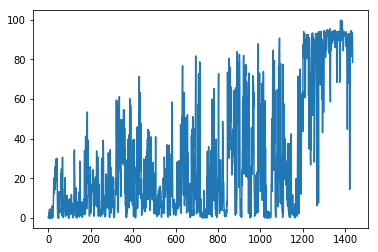

| Reward: 36 | Episode: 1436| Epsilon:0.06500743270743965 


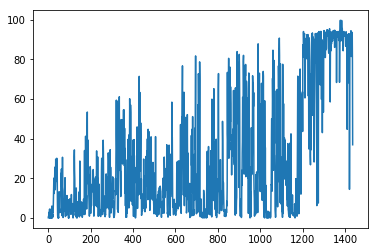

| Reward: 90 | Episode: 1437| Epsilon:0.06496389209755556 


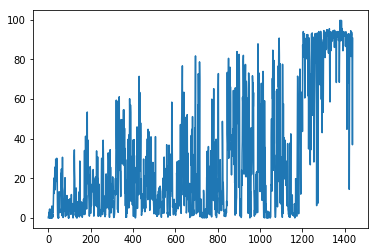

| Reward: 91 | Episode: 1438| Epsilon:0.06491648552479558 


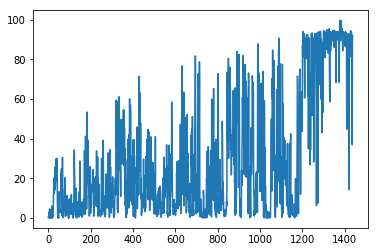

| Reward: 95 | Episode: 1439| Epsilon:0.0648768983460065 


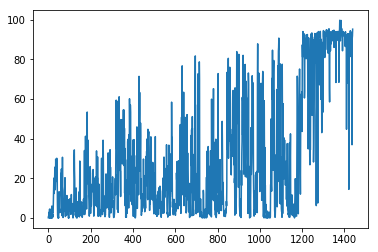

| Reward: 71 | Episode: 1440| Epsilon:0.06483928046711575 


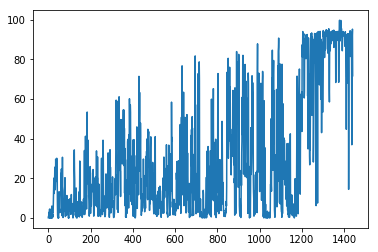

| Reward: 78 | Episode: 1441| Epsilon:0.06479909237188239 


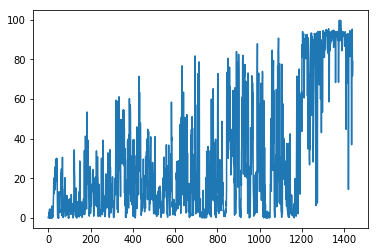

| Reward: 94 | Episode: 1442| Epsilon:0.06476281485741851 


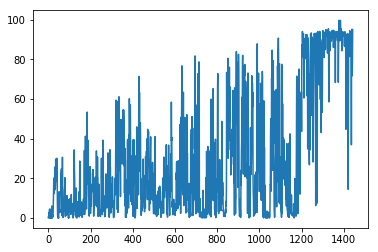

| Reward: 91 | Episode: 1443| Epsilon:0.06471490786266305 


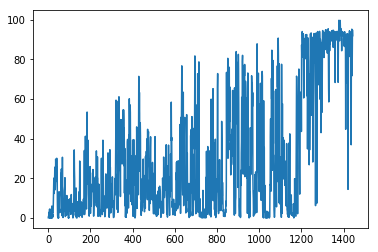

| Reward: 91 | Episode: 1444| Epsilon:0.06466638963578418 


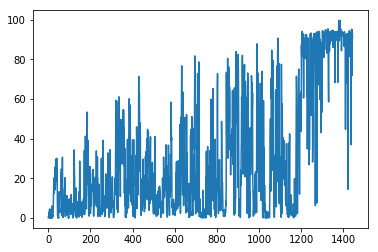

| Reward: 94 | Episode: 1445| Epsilon:0.06462824752821658 


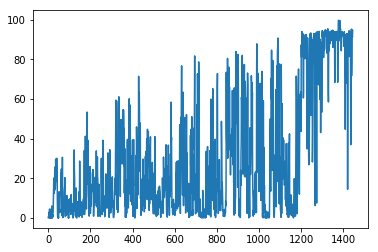

| Reward: 93 | Episode: 1446| Epsilon:0.06459141973990322 


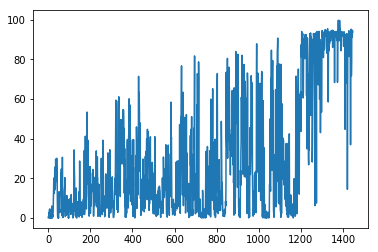

| Reward: 93 | Episode: 1447| Epsilon:0.0645468668100463 


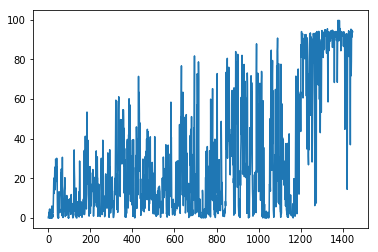

| Reward: 93 | Episode: 1448| Epsilon:0.06450492476954929 


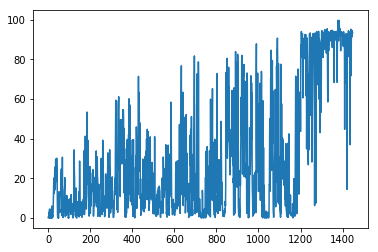

| Reward: 94 | Episode: 1449| Epsilon:0.06447203548095173 


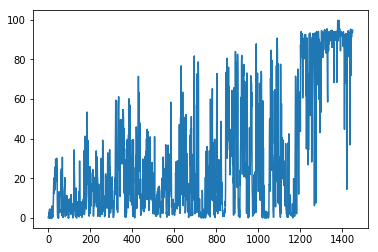

| Reward: 93 | Episode: 1450| Epsilon:0.06443078637312077 


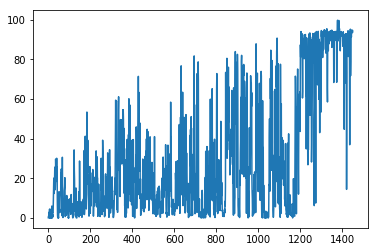

| Reward: 47 | Episode: 1451| Epsilon:0.06438634424261085 


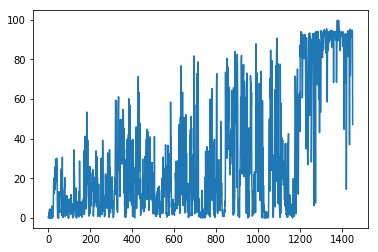

| Reward: 85 | Episode: 1452| Epsilon:0.06435029780354758 


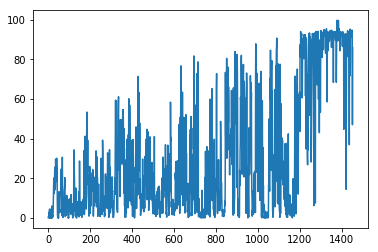

| Reward: 45 | Episode: 1453| Epsilon:0.06430912658329285 


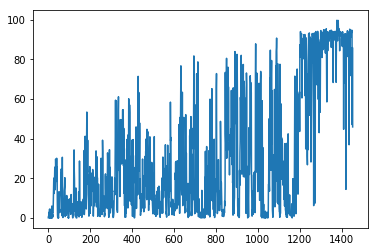

| Reward: 90 | Episode: 1454| Epsilon:0.06426605368414989 


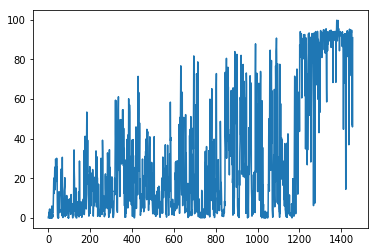

| Reward: 32 | Episode: 1455| Epsilon:0.06422493636315142 


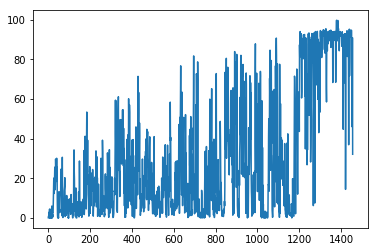

| Reward: 47 | Episode: 1456| Epsilon:0.06417614371110832 


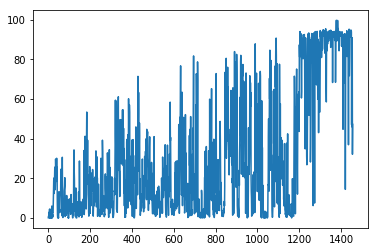

| Reward: 86 | Episode: 1457| Epsilon:0.06413893215409261 


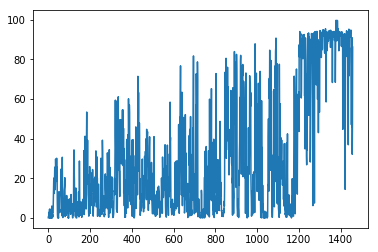

| Reward: 22 | Episode: 1458| Epsilon:0.06409853715062255 


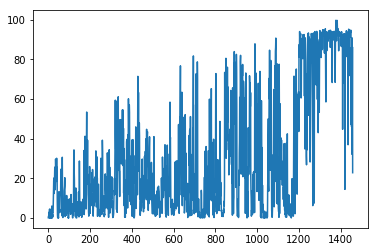

| Reward: 65 | Episode: 1459| Epsilon:0.06406329247214125 


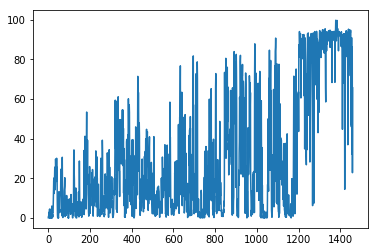

| Reward: 91 | Episode: 1460| Epsilon:0.06401590293505521 


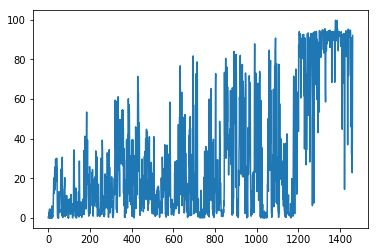

| Reward: 92 | Episode: 1461| Epsilon:0.06397750472191888 


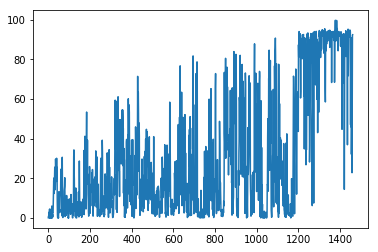

| Reward: 88 | Episode: 1462| Epsilon:0.06392953934281592 


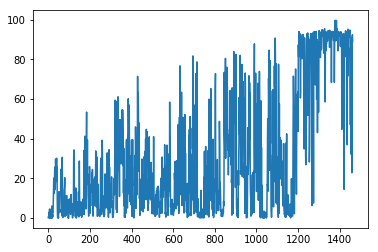

| Reward: 52 | Episode: 1463| Epsilon:0.06388672068321556 


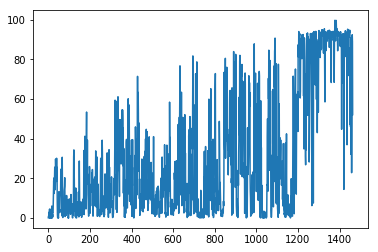

| Reward: 6 | Episode: 1464| Epsilon:0.06384329226334493 


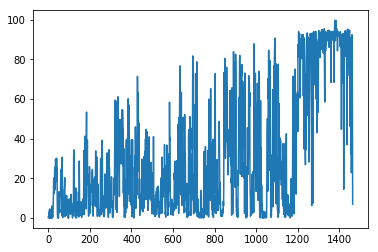

| Reward: 93 | Episode: 1465| Epsilon:0.06380308345527931 


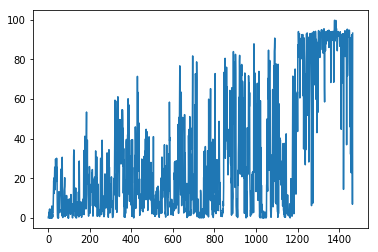

| Reward: 65 | Episode: 1466| Epsilon:0.06375716153945525 


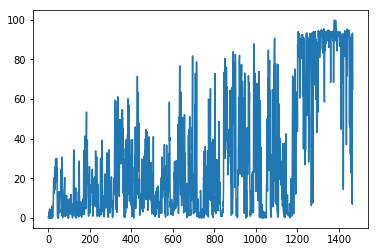

| Reward: 47 | Episode: 1467| Epsilon:0.06371509548583353 


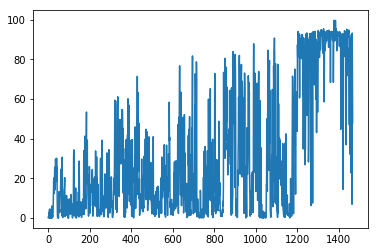

| Reward: 83 | Episode: 1468| Epsilon:0.06367751447907885 


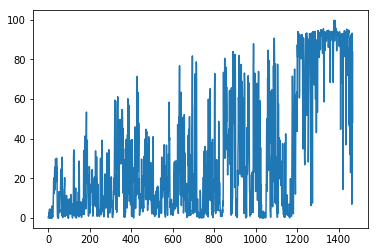

| Reward: 92 | Episode: 1469| Epsilon:0.06364122845689425 


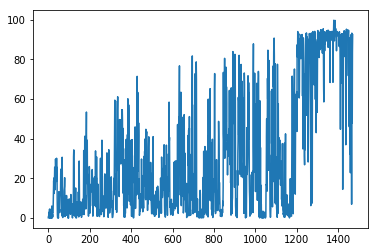

| Reward: 83 | Episode: 1470| Epsilon:0.06359669496284813 


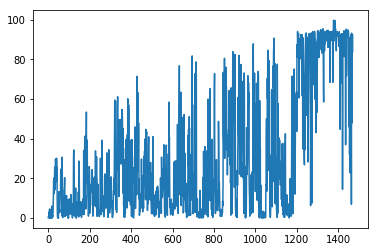

| Reward: 91 | Episode: 1471| Epsilon:0.06354965058192132 


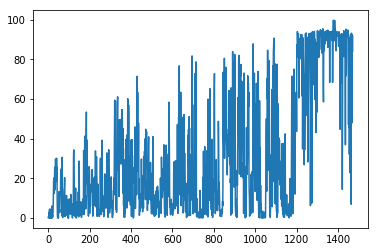

| Reward: 86 | Episode: 1472| Epsilon:0.06350772144102987 


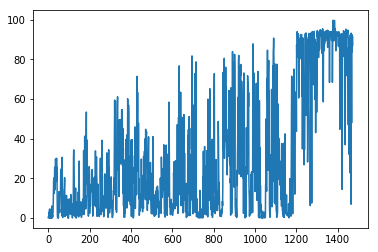

| Reward: 63 | Episode: 1473| Epsilon:0.06347089745846125 


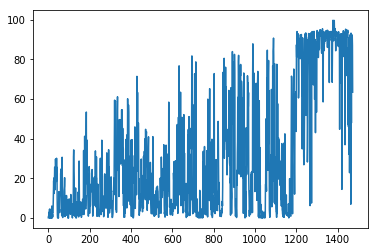

| Reward: 46 | Episode: 1474| Epsilon:0.06343409482771667 


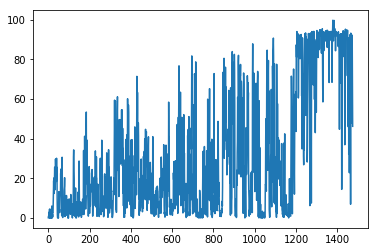

| Reward: 26 | Episode: 1475| Epsilon:0.06339921549386066 


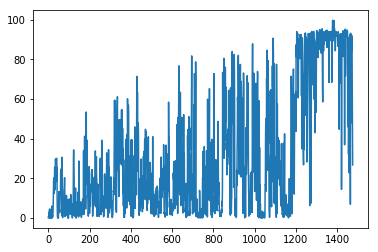

| Reward: 70 | Episode: 1476| Epsilon:0.06336118718405645 


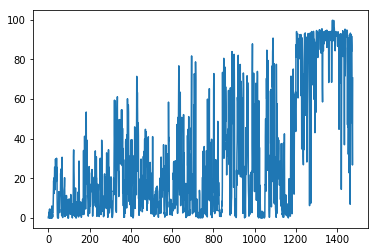

| Reward: 41 | Episode: 1477| Epsilon:0.06332571467510026 


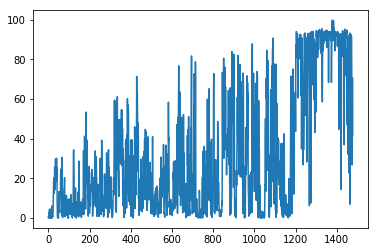

| Reward: 90 | Episode: 1478| Epsilon:0.06328266761154606 


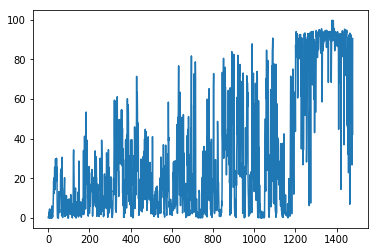

| Reward: 92 | Episode: 1479| Epsilon:0.06324660658906998 


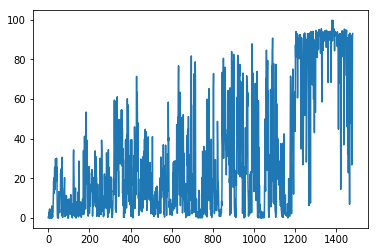

| Reward: 92 | Episode: 1480| Epsilon:0.06320108519438733 


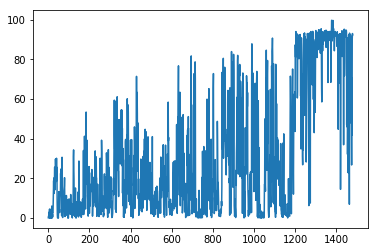

| Reward: 84 | Episode: 1481| Epsilon:0.06316696565089032 


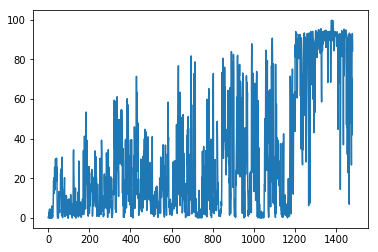

| Reward: 93 | Episode: 1482| Epsilon:0.06312844535912515 


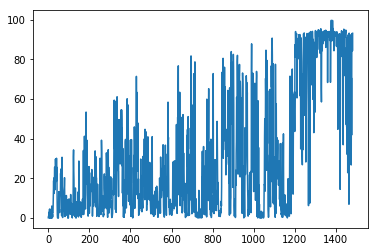

| Reward: 94 | Episode: 1483| Epsilon:0.0630836398467315 


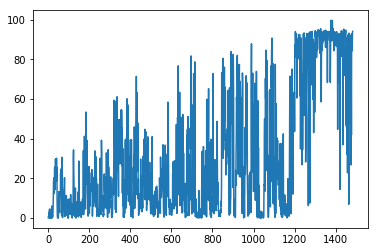

| Reward: 86 | Episode: 1484| Epsilon:0.0630533668143488 


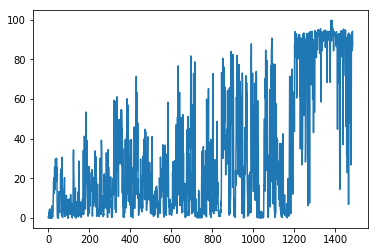

| Reward: 94 | Episode: 1485| Epsilon:0.06301428564793143 


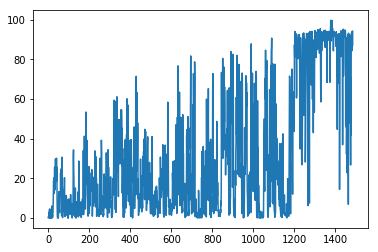

| Reward: 94 | Episode: 1486| Epsilon:0.06297585846303315 


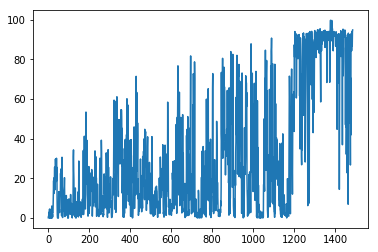

| Reward: 94 | Episode: 1487| Epsilon:0.06294374880332783 


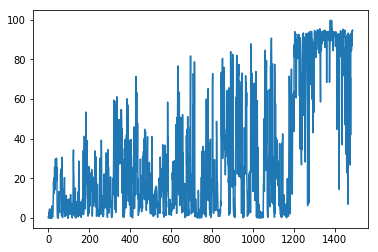

| Reward: 69 | Episode: 1488| Epsilon:0.06290536463299898 


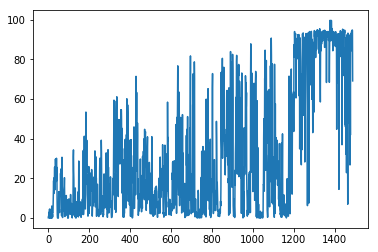

| Reward: 68 | Episode: 1489| Epsilon:0.06285946024443509 


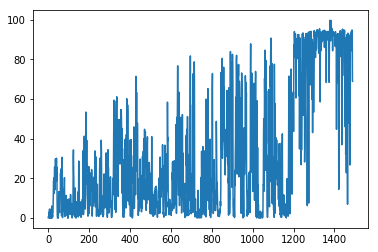

| Reward: 65 | Episode: 1490| Epsilon:0.06282929479297791 


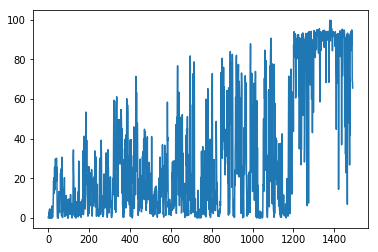

| Reward: 52 | Episode: 1491| Epsilon:0.06278156243086837 


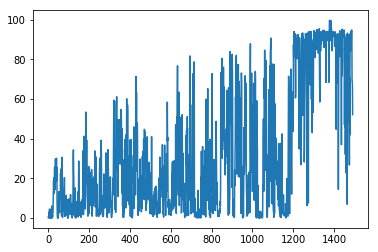

| Reward: 81 | Episode: 1492| Epsilon:0.062738257878057 


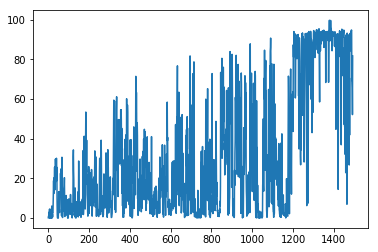

| Reward: 49 | Episode: 1493| Epsilon:0.06269811803843447 


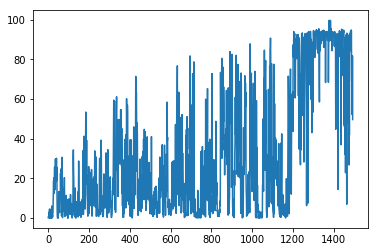

| Reward: 56 | Episode: 1494| Epsilon:0.06265173836178434 


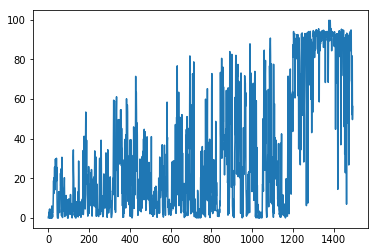

| Reward: 65 | Episode: 1495| Epsilon:0.06261165387721347 


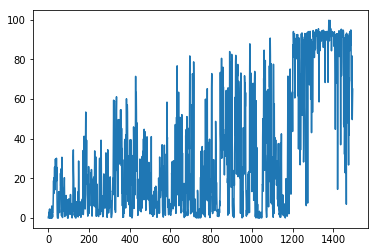

| Reward: 46 | Episode: 1496| Epsilon:0.0625841106717409 


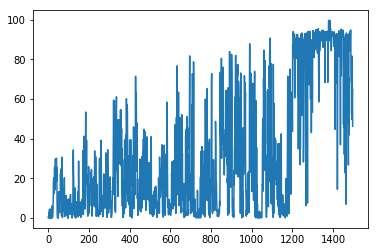

| Reward: 79 | Episode: 1497| Epsilon:0.06255032420621245 


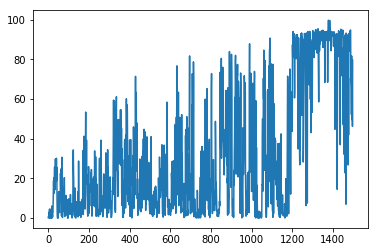

| Reward: 83 | Episode: 1498| Epsilon:0.0625121799529053 


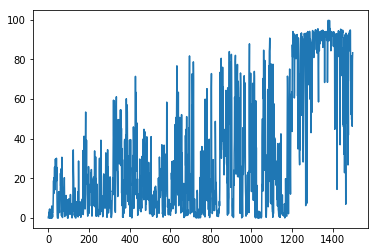

| Reward: 41 | Episode: 1499| Epsilon:0.06247031061078583 


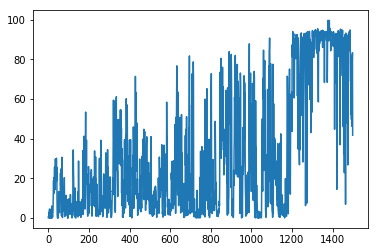

| Reward: 41 | Episode: 1500| Epsilon:0.06242534795083259 


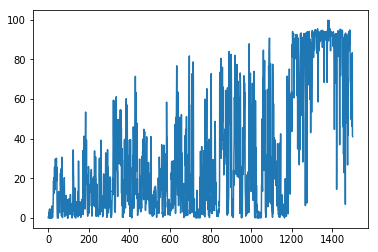

| Reward: 44 | Episode: 1501| Epsilon:0.062387903789212946 


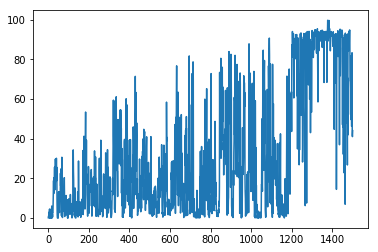

| Reward: 38 | Episode: 1502| Epsilon:0.06234923508405723 


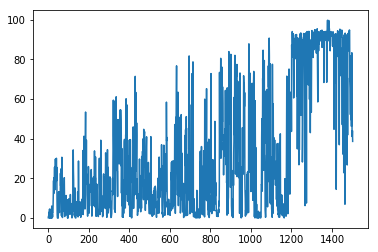

| Reward: 51 | Episode: 1503| Epsilon:0.062300621399424806 


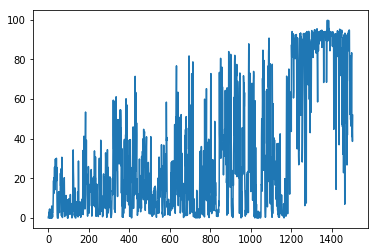

| Reward: 59 | Episode: 1504| Epsilon:0.06225889375477072 


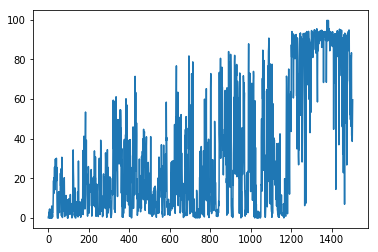

| Reward: 66 | Episode: 1505| Epsilon:0.06222714965566852 


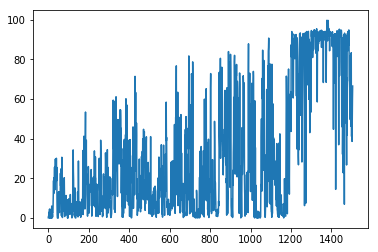

| Reward: 41 | Episode: 1506| Epsilon:0.06219169010999751 


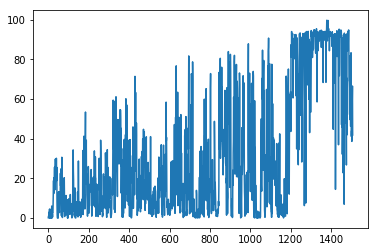

| Reward: 55 | Episode: 1507| Epsilon:0.06215189996358128 


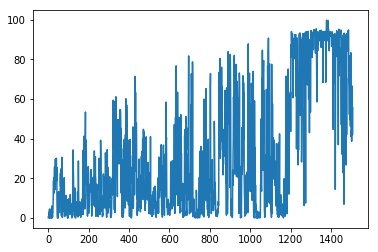

| Reward: 81 | Episode: 1508| Epsilon:0.06211524097477281 


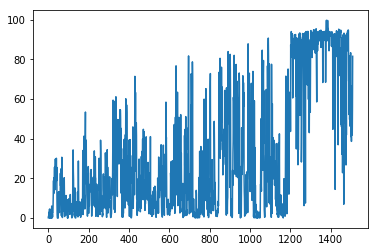

| Reward: 59 | Episode: 1509| Epsilon:0.062070533874222844 


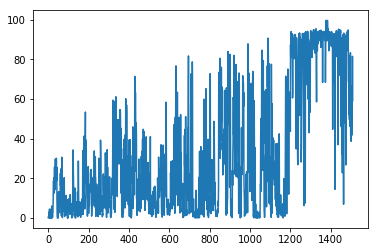

| Reward: 65 | Episode: 1510| Epsilon:0.06203640429643824 


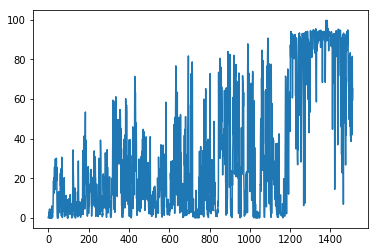

| Reward: 13 | Episode: 1511| Epsilon:0.06199609353450852 


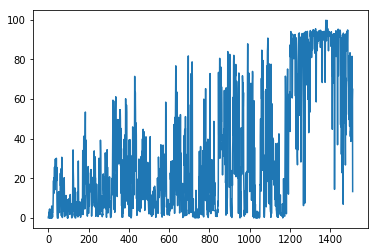

| Reward: 25 | Episode: 1512| Epsilon:0.06196076565395677 


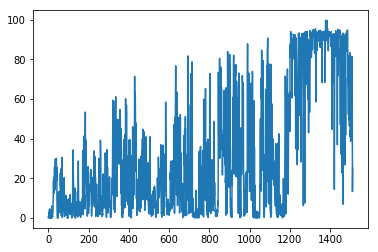

| Reward: 84 | Episode: 1513| Epsilon:0.06191740807813292 


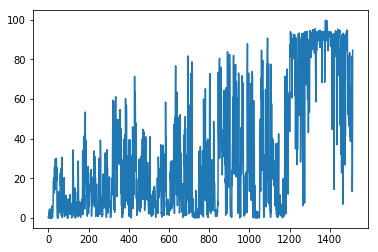

| Reward: 90 | Episode: 1514| Epsilon:0.06188645695776302 


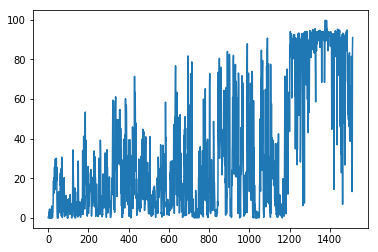

| Reward: 94 | Episode: 1515| Epsilon:0.06185119155256523 


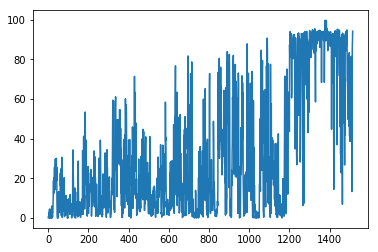

| Reward: 50 | Episode: 1516| Epsilon:0.06181038303039143 


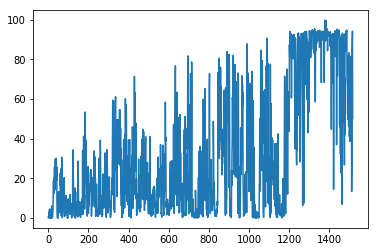

| Reward: 75 | Episode: 1517| Epsilon:0.06177639649694535 


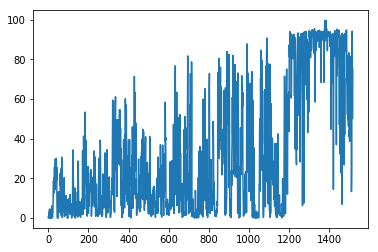

| Reward: 71 | Episode: 1518| Epsilon:0.06173934159135583 


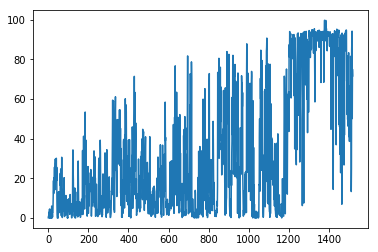

| Reward: 82 | Episode: 1519| Epsilon:0.06171094788330867 


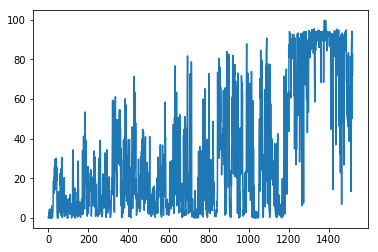

| Reward: 72 | Episode: 1520| Epsilon:0.06167084860036676 


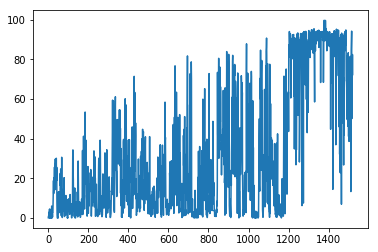

| Reward: 71 | Episode: 1521| Epsilon:0.0616289264688478 


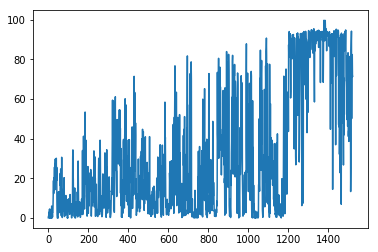

| Reward: 61 | Episode: 1522| Epsilon:0.06158888048276843 


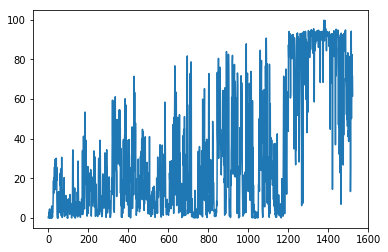

| Reward: 29 | Episode: 1523| Epsilon:0.06154578313677455 


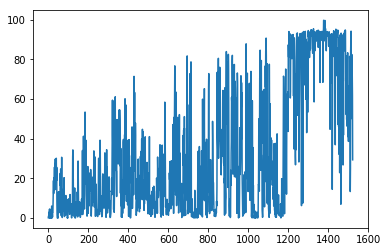

| Reward: 34 | Episode: 1524| Epsilon:0.0615064062406332 


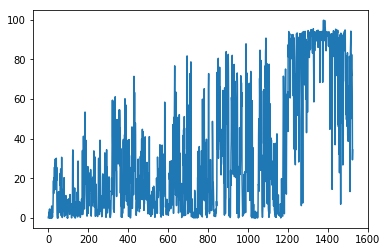

| Reward: 2 | Episode: 1525| Epsilon:0.06146889858628562 


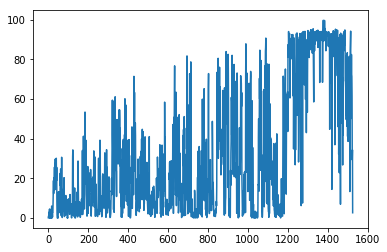

| Reward: 11 | Episode: 1526| Epsilon:0.06143264245145041 


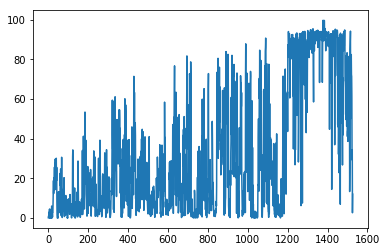

| Reward: 7 | Episode: 1527| Epsilon:0.06139824963060199 


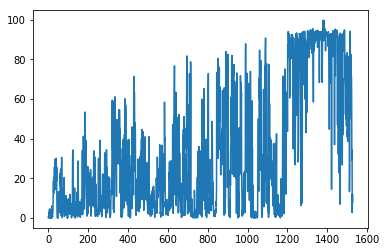

| Reward: 33 | Episode: 1528| Epsilon:0.061358967126168 


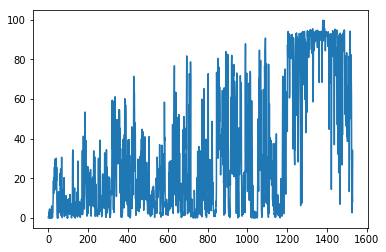

| Reward: 69 | Episode: 1529| Epsilon:0.061328908446960505 


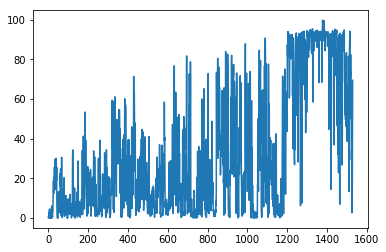

| Reward: 0 | Episode: 1530| Epsilon:0.061279251896453474 


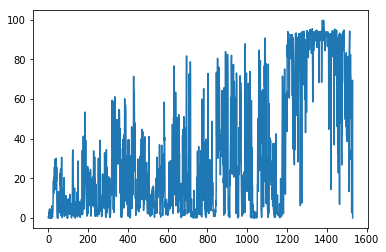

| Reward: 34 | Episode: 1531| Epsilon:0.06124127034586713 


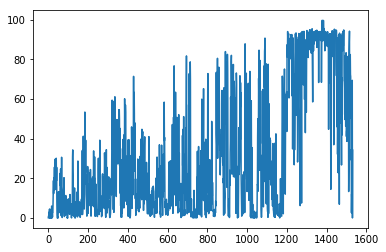

| Reward: 81 | Episode: 1532| Epsilon:0.061199028233322544 


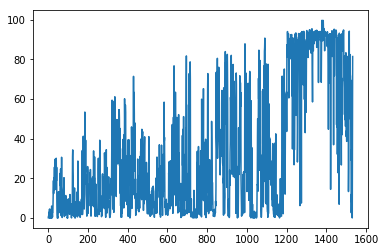

| Reward: 64 | Episode: 1533| Epsilon:0.06116782453052547 


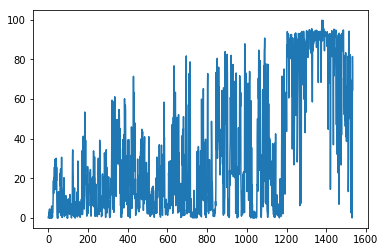

| Reward: 56 | Episode: 1534| Epsilon:0.06113541401101794 


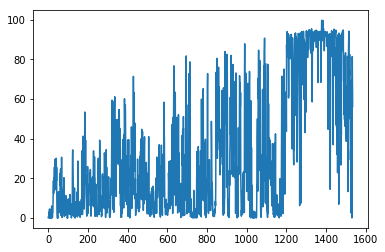

| Reward: 81 | Episode: 1535| Epsilon:0.06109202305572712 


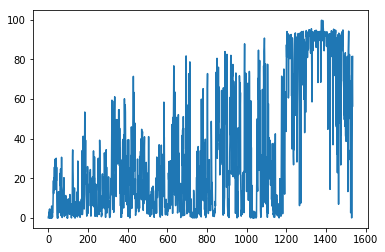

| Reward: 84 | Episode: 1536| Epsilon:0.06105171542195431 


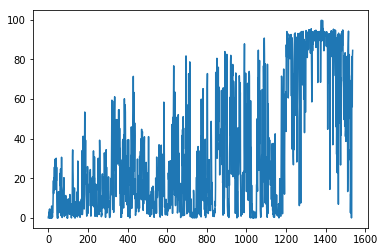

| Reward: 74 | Episode: 1537| Epsilon:0.06101753586159021 


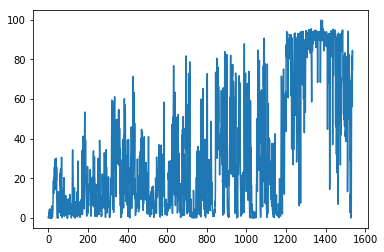

In [ ]:
with tf.Session() as sess:

    #env = gym.make('Pendulum-v0')
    #env = gym.make('MountainCarContinuous-v0')
    env = LASEnv('127.0.0.1', 19997)

    LASAgent = LASAgent_Actor_Critic(sess, env)

    #LASAgent.train()

    # Learning records
    episod_reward_memory = deque(maxlen = 10000)

    # Train parameters
    max_episodes = 50000
    max_episode_len = 1000
    render_env = False
    reward = 0
    done = False
    for i in range(max_episodes):
        observation = env.reset()   
        ep_reward = 0    
        for j in range(max_episode_len):

            if render_env == True:
                env.render()

            # Added exploration noise
            action = LASAgent.perceive_and_act(observation,reward,done)

            observation, reward, done, info = env.step(action[0])
            ep_reward += reward
            if done or j == (max_episode_len-1):
                print('| Reward: {:d} | Episode: {:d}| Epsilon:{} '.format(int(ep_reward),i,LASAgent.epsilon))
                episod_reward_memory.append(ep_reward)
                plot_cumulative_reward(episod_reward_memory)
                break

    #env.destroy()

In [4]:
env.destroy()